In [1]:
# !curl -O http://files.grouplens.org/datasets/movielens/ml-100k.zip

In [2]:
#! pip install snips

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib 
import snips as snp  # my snippets
%matplotlib inline

In [4]:
header = ['user_id', 'item_id', 'rating', 'timestamp']
df = pd.read_csv('E:/kaggle/AnimeRecommendations/ml-100k/u.data', sep='\t', names=header)
df.head()

,user_id,item_id,rating,timestamp
0,196,242,3,881250949
1,186,302,3,891717742
2,22,377,1,878887116
3,244,51,2,880606923
4,166,346,1,886397596


In [16]:
df.rating.value_counts()

4    34174
3    27145
5    21201
2    11370
1     6110
Name: rating, dtype: int64

In [5]:
n_u = len(df["user_id"].unique())
n_m = len(df["item_id"].unique())
sparsity = len(df)/(n_u*n_m)
print("sparsity of ratings is %.2f%%" %(sparsity*100))

sparsity of ratings is 6.30%


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 4 columns):
user_id      100000 non-null int64
item_id      100000 non-null int64
rating       100000 non-null int64
timestamp    100000 non-null int64
dtypes: int64(4)
memory usage: 3.1 MB


In [7]:
# Split the dataframe into a train and test set
from sklearn.model_selection import train_test_split
train_data, test_data = train_test_split(df,test_size=0.25)

train_data = pd.DataFrame(train_data)
test_data = pd.DataFrame(test_data)

In [8]:
print(train_data.shape,test_data.shape)

(75000, 4) (25000, 4)


In [9]:
train_data.itertuples()

In [10]:
R = np.zeros((n_u, n_m))
for line in train_data.itertuples():
    R[line[1]-1, line[2]-1] = line[3]  
    
T = np.zeros((n_u, n_m))
for line in test_data.itertuples():
    T[line[1]-1, line[2]-1] = line[3]

In [11]:
R

array([[0., 3., 0., ..., 0., 0., 0.],
       [4., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [5., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [14]:
R.shape

np.isnan(np.min(R))

False

In [13]:
T.shape

(943, 1682)

In [ ]:
import timeit
start_time = timeit.default_timer()

# Scoring Function: Root Mean Squared Error
def rmse_score(R, Q, P):
    I = R != 0  # Indicator function which is zero for missing data
    ME = I * (R - np.dot(P, Q.T))  # Errors between real and predicted ratings
    MSE = ME**2  
    return np.sqrt(np.sum(MSE)/np.sum(I))  # sum of squared errors

# Set parameters and initialize latent factors
f = 20  # Number of latent factor pairs
lmbda = 0.5 # Regularisation strength
gamma=0.01  # Learning rate
n_epochs = 50  # Number of loops through training data
P = 3 * np.random.rand(n_u, f) # Latent factors for users
Q = 3 * np.random.rand(n_m, f) # Latent factors for movies

# Stochastic GD
train_errors = []
test_errors = []
users,items = R.nonzero()      
for epoch in range(n_epochs):
    for u, i in zip(users,items):
        e = R[u, i] - np.dot(P[u, :], Q[i, :].T)  # Error for this observation
        P[u, :] += gamma * ( e * Q[i, :] - lmbda * P[u, :]) # Update this user's features
        Q[i, :] += gamma * ( e * P[u, :] - lmbda * Q[i, :])  # Update this movie's features
        print(e)
    train_errors.append(rmse_score(R,Q,P)) # Training RMSE for this pass
    test_errors.append(rmse_score(T,Q,P)) # Test RMSE for this pass

# Print how long it took
print("Run took %.2f seconds" % (timeit.default_timer() - start_time))
    
# Check performance by plotting train and test errors
fig, ax = plt.subplots()
ax.plot(train_errors, color="g", label='Training RMSE')
ax.plot(test_errors, color="r", label='Test RMSE')
snp.labs("Number of Epochs", "RMSE", "Error During Stochastic GD")
ax.legend()

-48.3038966579405
-7.858557950501744
-13.72678873611893
-2.1466315280528363
-3.2457243061446075
2.61275403076339
-10.877115669517359
6.848106197776926
-4.770965983391259
4.449433754944771
-3.3845234432029514
4.947661314909116
4.640546735547739
-4.374606601217334
6.2281563594667775
-1.2127804310509678
-1.3122571214318564
-2.7560434719223794
0.8669326612285664
3.7647640529588386
-8.079337044530593
-4.061989954070821
-0.528037016108188
2.3918046314539447
-2.722072850067791
2.7415548532033367
0.8574692440407778
0.5793496156336599
7.099954692568824
2.033021982393704
-8.85225733322699
1.363894643568759
2.964399896696473
1.3539911509033873
0.9363158343254914
-10.555425305131426
1.5511894635168795
2.9525754842853837
3.7956895235240453
-0.7033474500183781
4.172979164803765
-0.7295025740576637
0.48087096001335006
-3.7473059025749604
6.685814390499699
2.421461718631851
-4.650170173351741
4.9206205952640545
-0.8761088149338674
-5.185717286634603
-0.06900652697152854
-0.6800400744985047
0.418245392

0.3926930351970066
2.8877462738575224
1.8881108713984394
-3.2441033220264854
0.47560663365908695
-1.1995063974429527
-1.3991433386870047
-1.338096239745311
-0.7675539908270896
1.2973023299852464
2.9557651907933447
0.5483924429328937
-1.8386817199084806
-1.2647335240220032
3.2639902272347157
-0.737036127761038
-0.5512829978237441
-1.9350848050619147
1.8143845069426772
-0.4854624035179733
0.49610310713243155
2.1253653705905426
3.428563245889119
-0.41119042345006473
0.9643231316970384
-2.4863561628731405
-2.2355426224171584
-0.03408215646944068
2.2340342196574285
-0.53820070193124
0.29441674477729207
-0.3328992383938143
-0.12274572422708196
0.06741217379740139
-1.3645609702614827
0.6060286659266407
-1.6947309579823733
3.15062951579485
-1.60621717646928
1.0935897905785144
3.1885147575081847
-2.9244256921539424
-0.7698297204948352
3.192489542240539
-0.6524123907867976
-0.8555004010263838
0.16042158346824653
-0.27352847247991274
0.044595405595726056
0.9125996601171122
-2.9889984472128077
0.8

-4.104778404513301
-21.90005763253083
-13.625885421383558
-5.541200875754889
-5.7054691379071745
4.543917995396716
-4.940452620844092
-5.36245889622284
-0.46108037110690514
1.8881060065384396
-1.865732929285591
0.4475207780397792
-2.526115671811204
-0.14123117463609258
2.834542030246279
-0.5329622415733493
4.568136951775007
-2.4007045112889465
3.9525952680615157
-3.1385219043231416
-1.4736833219487417
0.41141674928841043
-0.41132449734940835
1.6117496678859258
-3.983026752944851
-3.5839453739344496
2.3316326325111554
7.732471931813617
-1.7917029613875917
-42.48355713978678
-17.083837604273555
-26.61019354615975
-8.97766913057411
-8.130618205294969
-9.416104400242318
0.10912534910441529
1.150290497752331
-1.728615020759663
-4.16960129339771
4.39559669097711
-1.0418683792036418
1.295265939153726
-5.077126771679239
4.158310994316132
-2.4889347599075196
0.5322822374599059
6.474289926661596
-4.118900706968265
-1.0409481853146278
4.757645601231098
-0.8307539686278762
4.223088767736442
-5.339

-5.7709652398191436
-3.3021260624267263
1.2045855959663476
0.01143931242828522
-1.6631302842229907
2.0327557221114634
-1.2790072895915356
-0.169181819598899
2.1018072271719475
3.0056157299619053
3.4413199779602257
1.4939704598902903
-1.0000248125724447
-1.317284584317127
-1.0413729445695736
-1.1346978146951106
2.9742998280431827
-1.7428120424205833
0.11736059392961629
-5.42090243178397
1.2727231229107145
2.9213719976043278
1.8335638053598933
3.133229997487745
1.0757335122045433
-3.7330204467472843
3.198482903995999
-5.415486148218488
0.49277852284800927
1.0368515666710572
0.025331780785864844
-1.2675588241263718
6.561272282064241
-2.4355959120358985
-1.989365960269562
1.8191236104564523
-0.39176139540200516
-2.8792160495108687
-1.526713849498397
1.5114315149137418
1.507067438290389
-3.3310716792985087
1.5252530383705478
-0.7371086460090313
1.8578475296197086
2.7091908027641294
2.1689127980298344
-1.6593628423386058
-3.3604948199862577
-1.0787060269400186
0.8750431906795288
-0.452577645

-1.120866665950282
3.7634187873801093
-5.580377926566374
-1.784927198938945
0.027722780486503007
-1.0469408194875705
-14.047154048274933
9.944449332947263
5.185570302797071
-12.512134501342754
0.4185391315046232
-27.7467398399301
-13.241388139516186
-13.701255244153892
8.598421157010122
-9.234684174948603
-10.917417447751209
5.114876903567944
-4.225586926729925
-0.6749008595606805
2.3873862764437908
0.10335036613706361
2.4047898296748267
2.9089910198035653
-7.7345374956528445
-0.05486571905326976
-0.9032661793434364
1.1195710093101972
-4.303902025080838
-1.0156756530058342
-3.0729941397409135
-0.9739810536549554
2.519892058958411
4.408239314760232
-1.169343866794346
7.527317246088893
-4.714782456110736
0.014253427417894926
-2.2877577261652595
-1.0786708887145067
0.9103523958847339
5.589920795881848
-3.871206220008678
0.5992949328874606
-1.0147404584233595
0.5652096914441183
2.009897788055627
-3.4755356755245455
0.9113381093842268
2.7810923667731613
3.0291643098340764
-4.666050244016889

-2.247887431001107
2.1256952928309936
0.8801912847222226
-1.1586268771594188
-0.4481004783250597
-1.6124231951034966
-2.9039007204303093
0.813932015188314
0.335483051943509
1.9174059011734954
2.1166892317219226
-0.7651016688609573
-0.6154986666218214
-0.4748548020325458
1.101391411700757
-2.594570783712305
0.05438608654153709
2.5094233611991026
0.5863029092809624
0.3441301637315468
-0.23517214823135113
0.1478407498052805
-0.8117774373956443
-0.04330263848403959
1.5781263230193634
2.567085224180384
-1.1818408403976566
0.9063274130210961
0.12365565362564901
-0.023030642732844164
-0.20229274250655394
0.09622806887265689
-1.1314215201423963
1.1021475943275618
1.283220469055116
-1.4693187736031152
0.4208068073580762
-0.12486057238534354
-0.8184462836933801
-1.8328793110481447
2.480984133849884
0.5133735712561691
0.4571979050700037
1.4823419331055714
0.4596997681283961
0.5505422776621778
0.5355331368235765
1.2215581696333846
-0.39843506397917583
-1.1993617734135844
-2.2991796088760665
-1.055

1.0398016023858383
-2.283869575688856
-1.2610832979928244
-1.2479535613137278
-2.890975183828944
2.667569257370886
-0.534221497411627
1.6587802321203706
0.5702463837022655
-0.03274123596804035
-4.306392168398881
-0.21745164731309785
4.041683450270477
-0.5270519258646278
-0.5028519367830286
-1.1718108988409384
0.2650502277577482
3.888557475872611
2.437570291347032
2.7456323558432794
-2.152921590773337
1.4299095662763825
2.8887448641521427
3.417862432740326
0.2266332853276598
-22.621377003057415
-24.525892032577282
-6.174217883712771
-11.273843976995138
0.27128681225154416
-13.736087901511482
0.5517713302377345
-8.124559792157434
11.575018585475021
6.211881770819891
1.8476996305542466
-5.879073172194442
-10.663374618448932
-3.259172219094184
-10.304873022696437
-3.8773574652598777
0.938757827755949
0.0084012005259404
2.518570180355276
-0.17696872135562458
-0.5880083479051894
1.965192975317212
-1.1116094767451248
0.23564508906179604
-2.737496445704
-0.5205437354166129
-1.004663267407918
0

1.008967688110527
-3.930550756684976
2.3352022711727347
4.498681892745952
-9.10022036609605
3.633091286969978
5.074553293009666
1.9111201929548485
-4.212894070133868
2.4301927882836107
-1.5415968669569455
-0.19622464926255123
5.4055168976318875
-1.1582722983457998
-4.576125857145248
2.33430074694024
0.4014429933550039
-0.9732980052994238
-1.6383679460628473
3.1640073670707567
1.639843603230812
-1.343552509726571
1.7548070309603783
-0.053905093999352616
-0.11155279585135247
1.5887601866408332
-2.9065701378583366
-0.19993974899087785
0.4604668850115514
-1.0441887559028462
-3.5546226836207966
1.1675977398282527
4.058167579997223
3.9391168052151326
-5.803755623292119
2.5698926482166513
0.039929353694656555
0.6021010530886652
-0.3376301742780088
1.1681059977525017
1.564924187420135
-4.17384849434757
4.433542367603516
7.1031504076611025
-1.7919296892789696
2.0634849064423033
0.5700047459364059
3.6686805401894813
0.322720851809998
3.2243181572248463
5.829582299553727
4.876919079027605
-0.8738

-6.651054233300206
-11.587815266281622
-0.2945177513812345
-3.0064760302783515
-9.958449911446738
-17.935049059412616
-8.143010958765503
-19.047495054063436
-16.415792467400443
-19.41457603622169
-16.408659231705556
-1.6672115788968673
0.9247502865114043
-11.251671609640752
-11.024513524418055
-8.565061370003022
-2.7572205566305303
-6.522140941246391
6.512678959722231
1.438709144534175
2.2794961560199924
1.9504924259903391
-1.5583106417067345
1.4076164351456715
-5.825895681685159
-1.051984507034149
-1.1947956859743156
9.68487847040264
-1.0025005649573324
-0.1798842596049397
-6.189156266479088
-46.98804581457357
-0.9075704487234457
-16.16406788481115
0.6467732396683976
-2.3733604786971405
4.154322382658193
4.017281581798571
0.9886290855663686
-15.28981105304798
-4.467488306123581
-12.413189953919183
-9.538442096634787
-9.096744908877366
-4.001834552648393
-6.618146221986898
-1.434793485231343
-3.117982250789389
2.80437569826522
0.27962384533494555
3.5775193678090305
1.6340893357205943
-

2.5002365497488044
-3.9088136599533687
5.436070632533163
-3.787474735280501
3.993129475203093
1.4449309504215053
1.3954761956867738
2.324666710229584
0.03237914718223811
-4.099535871616666
5.767688643998109
2.8458449947741933
6.578506033561967
-5.753586877035241
2.0485919959570023
2.928655862473424
2.5559517583670415
2.8102688065906856
-0.5869109118962519
-4.481798827573991
-5.934743903244503
7.349932337900613
3.923835654078808
1.8721500275130332
-1.6783288616837595
0.9184184499413339
-0.6690949256880154
2.4315862188824733
1.4718985841910124
1.388853596573438
0.5251571879153931
0.22337626611613492
0.39066810678280106
-0.43358743206060346
1.6796590173597283
-0.5585291856831365
-1.1765229881934998
-0.270820031301092
0.36767514914082344
3.218816475501185
-1.5125684599616127
-6.785964285194764
3.9790641593901075
0.9591529907826202
2.1160403972310764
-0.7806140971053921
-0.17966727523624026
1.9705160499228964
0.6044278061421959
0.2176505063159695
-0.41995699002488474
2.015166886597198
-1.12

-4.198872481768646
3.3344733314476076
-2.5622158580905126
1.759828848717043
-0.42151516822141843
-2.0529385101930426
-3.965019078923321
1.0884930401290918
4.900657806690276
-1.4496630556105696
2.346622546619127
-2.689730590791327
-1.8534139151788636
5.0214441653888695
0.30427958383273257
0.9682543370337129
-0.347679155844965
-0.49037240828781403
0.2782962230257944
1.6756571762031949
2.4009325760473965
-1.602998615587648
-2.3855540434041576
2.799328358285621
-1.372221431009332
0.5861678269678761
2.394851882515236
2.623319387567362
-2.474496733841157
1.5102434189463265
-3.2455704833734655
3.1064429690815203
3.3070767099386082
-3.0600403728594934
-2.3665992924486163
1.0571562947488085
1.4314617082860814
5.138573357627183
-1.8860420916967051
2.1105696096485635
-3.612217152345801
-0.6093042885596587
-2.352388817477866
0.7510364877301958
3.618919159266061
0.2411577054678542
0.3431196016587128
-1.9213134547547739
0.23639590220938
-1.614493198841119
1.8346964466028037
0.12066080086469011
1.855

0.8479977383798989
-2.2318795335614254
-7.233875916489067
5.469844668423486
4.577873690185883
0.5073191838180122
-1.1839992852312085
-4.537860832921311
-0.08746324274399431
-4.778706236245251
-2.167497071362786
3.8874483645196793
0.12181455415300113
-3.0818207037178
2.8453633975336863
-2.4102087208591847
-3.512865445356627
-0.8577361046242795
5.707316239201021
-2.581116137986095
1.8646840272170844
-3.1018886487509576
-2.6016247929610152
-1.5264965050923038
-0.8778589790593707
6.5979645033713545
-0.8889269187950015
-0.21126694178948657
-1.4551710529347366
0.9684646265230015
-3.7593070525851147
-2.2463116703881143
3.6413607000752775
-4.296772683923761
4.374690500230505
2.8507920091572796
0.10099463320043334
-0.8198480966744501
3.3320999054005322
0.5728170934313384
-2.4031842295459964
-3.8614115521116172
1.1843551958237004
-0.5573416917647807
-3.8667579514754014
-1.8649345817248797
3.952989657877742
-0.25084999549435416
12.267741617351826
-34.64234902843561
7.430258297101859
1.92241866393

0.4760421623626532
0.5618978341214484
-1.8478292743692286
-1.2464023661446428
2.3457061373489756
1.6568464825564324
0.9695301540666543
0.7213112511314597
-1.0208958906868855
-0.18490183627610257
-0.17146343623312177
-0.1095719496206069
2.9015087159733195
-0.8044953107955042
0.790086667945495
-2.0942623460833847
-0.5826565991567261
-4.815421622221822
-0.5663992665765551
3.4580907000642154
1.7651734865146942
-1.1906057996766855
-1.66223719956974
1.2553475538905323
0.6423103400669006
-2.090817828004555
1.6997209198297223
2.184213609762589
0.6527704505749448
0.7603491288285715
-3.6354162031529995
0.07485740633553206
0.08844642773091316
1.8428910713101256
0.3743560689049197
1.2241036254472522
1.0160330012105172
0.6746271873251368
-1.0790840103826742
1.560622864800393
0.7968991775552423
-0.9302508106929626
0.4400536392750647
-3.0125313558674645
2.499708837334277
1.0032583006723526
-0.3706643484677059
-1.4160228813806768
0.043943519186012026
0.18923993406277262
0.18189841864458067
0.761185597

0.46412042288663713
-1.2674530324512983
-0.009368716333961302
1.0294084458561703
-1.0515304319210719
-0.0778061419218572
1.8323697165231616
-0.4346108770341095
4.218572899030971
0.5041981467960124
0.28452390260771043
-0.47822921863755585
2.3781032973056018
4.717037323848453
-5.157880458623051
-1.847979413954631
1.532608731389017
4.613294991043165
3.738849204152385
1.6775253578618967
-0.6867127932688106
2.0982191890450816
-0.25492564996686085
-0.8456823331418972
-3.7309492525972603
-26.563725626411532
-0.2006085798515258
1.8138250864239334
1.9844378073548796
-1.0085709637256999
1.767540973551661
1.278380613809742
-0.2759937664525207
-2.1014931349544828
-11.936940905037288
-2.3756642339594816
2.0288853358130976
-1.5541172203190001
2.9120243781400017
2.255492591050864
1.590973919731471
-11.213500705669297
2.749927328476947
-0.3156830414140881
-0.637316750344258
-3.7011800244597985
4.698841819708887
0.33955175762317413
0.5686260677514152
-3.3799241751244615
-3.764368983593844
0.09973979412

1.2976018001011833
0.1526742525189455
0.14451051528331238
-3.0341082454595067
0.6447619537782736
-1.3258754689455108
-0.2539851147266523
1.4039235598700088
1.4609950311905426
-3.292472027643787
2.1504003669994716
-2.579542596836398
-0.45523370499027216
1.8344965296835145
2.5269971696652602
-0.5666906542024464
-1.0879733699180179
-2.69017226442965
-0.8872329599648747
-1.131487987196997
3.4282371985722917
-2.1355083776703214
0.7541302335615496
-5.447381961622185
-4.965825690691005
-5.639447668747533
-8.086134492076042
3.5493441906530414
-8.034101969103848
-23.014598997868546
2.3904327390141367
-20.12762121548426
-15.246734924905397
-12.24579382238959
-6.609269470487282
3.4710419248580995
-2.287120996858132
4.681893677339721
3.885362963615135
0.675807275870433
4.888367621292962
1.5686200860875221
1.7216196265897605
-2.8596499634132932
-0.2815233215320001
1.486998242057168
-3.1734716620994767
1.1827232922520388
-3.529715332900939
-3.424101248290162
2.4253040894209565
-0.8735488080538598
-6

3.0648672445418765
1.202672682121186
2.394919302490594
-2.1857751458092514
-1.1565290284796852
-0.3869415632750748
0.318454412659567
0.7694375053056008
-1.206059422691519
-0.7221893375894042
2.588009659234838
1.0339387744187878
-2.791609249596495
0.38122871066787845
-1.4145237148248384
3.9339415239200966
0.06525689492755937
-5.157559617086532
-4.528734536604787
-10.567679782910936
-3.0519272093590466
-3.2845177008183644
-8.571328773059195
1.4189580220840732
-0.7874845809678228
-4.799856050482671
-0.05785370692262326
-2.670782504085766
-2.4708367605612764
1.6739583726063065
-7.9942769577445745
-3.8171648535206106
-0.9614261428187021
-6.518683183918029
-1.661234372906648
-5.212313730698066
-7.298146573240889
-1.5312825935769014
-0.9043172491673661
-3.910502196831543
-15.623522663925144
1.3765598588196957
-17.714016490386342
-2.3103566769272366
0.14560147696064707
-2.593295805403816
-6.201872847535954
-6.587236329966052
-6.257717740681969
-3.4996078971109865
-1.0563832487753535
2.44158051

1.4886772182995687
2.4053788951462582
4.246062883917985
3.0786656136396795
-2.599315972188755
-2.6629981641824436
1.2036518258722912
1.6984333710120736
-7.7890686173641885
-2.7863463353027074
1.5719359908322832
3.054071774366456
-6.031762060013058
-1.327882465603837
-2.2316834710855575
-1.1274918845429989
-0.0391379319321965
2.3004336532910368
3.435889132773309
1.638253184811513
2.6980328938837097
1.3157162871442325
2.8017876031211326
1.9688286090004514
3.5613480461648583
-0.5056074935510639
0.46303390548839185
-0.22960226926886218
-1.4224797921510923
-3.554224814605682
-1.4092304981462163
-0.991997570502908
2.528408169781228
-0.10473673432854191
0.16179996949431796
-1.1633555003499922
-1.5611081559332884
1.2370606772385564
0.7377216592384475
-0.33122343456943737
-0.4324067748606186
0.5714672039907889
0.1825565542280696
-0.5084671654428856
1.9750687566248448
1.728136549184768
-0.06616577985562433
-3.383520028550863
0.6548827615459314
0.1680581764214064
2.883737179265389
1.2587746130655

1.022753979337356
-1.4343303506619645
1.6792008439153747
0.11852017421974015
1.294224563694925
1.4827491258658156
-2.603750223971926
1.1392313693093583
-2.103474521266701
0.051010648953601745
2.0472534466240417
-0.07432282548924585
-1.0169506269651034
5.558166515080185
-0.09689657321952794
1.3906707943041212
0.2776422390369766
-1.5344876269527914
0.9974325758853846
-0.2691733219720387
-13.957333407923278
1.9444701090542473
-6.487117028374689
-2.8714996695616852
3.5202051106605343
1.5620711472115199
-1.1565081862368363
-1.123136932715676
0.5858874284746043
1.8472797318064584
-0.6766928585576366
-13.22420842571081
2.0922583044962817
-3.8956256547238013
-3.5537132945546546
-6.271054837948567
-0.4419988194834552
-4.385982560865084
-2.458225770426602
-8.071120569714045
1.7179798325967601
0.4974141419235467
-3.435759032423591
-2.0082519876711817
-7.069503403148337
0.2639498910979926
-2.3494627702862516
0.07793510617689536
0.7424505250793088
4.078734411788426
-2.4837190098833695
1.09779250519

1.7934966281556846
1.8605315982893993
-4.583780264925389
-0.4209043139729358
1.5840092477105774
2.4638890619209732
1.7947274748497097
-0.1193402807454631
2.7127950237739915
0.9474004272929344
1.8319187831078212
3.0339250453140876
1.0993974657857017
1.0326641016384457
4.2024757934355845
-4.099758928627907
-0.04588636586302819
4.146952138471874
-0.6998284206547147
2.0204346544534855
-3.774410812136323
-0.8882254911369909
0.41033261843702507
-2.1609494973426884
-5.541869862852208
3.2113356354455673
0.43857348652342676
-0.5419673882389269
1.123991337707932
-1.1831702753966047
1.1634038457646825
-2.3363150040002063
0.7310078957768518
-0.37732080683395797
-0.7994179764633866
2.9785013872669532
-2.7831749522756866
4.287249274326933
0.9058596662036495
1.7589718093358406
-0.12479021553207348
3.101157274570402
1.0716380817008921
-4.579932252356818
1.0202176390957334
-0.5938230953403592
0.2588453750452051
-1.7006267016008305
1.3028486607424652
1.4149202076324543
0.4886381031608522
0.2610981198590

-4.45923870512234
-4.219099365383041
-9.376723062830683
-0.4447399843762545
-2.6491684446437906
2.3701536235498444
2.2997176298908526
-7.125741965335038
-8.935182913106013
0.03832539139061897
-6.204260654981223
-2.647376743296973
-8.72325327405157
0.5522693600802908
4.199342210881721
-6.654127407897008
1.753260489903365
-2.2223181963745597
-2.714716801256017
3.968922867510958
3.2657781133934036
2.3267373720770976
-1.3650701610393794
-0.14044465160498554
3.198176091393271
3.3093186448427954
3.214360359694728
-2.4034755094446014
1.715624718913718
3.7879251816841317
-0.6366796972151816
-0.8760331959782555
-5.876152223631925
0.6815219138591795
-6.971057190389001
0.9352011789303254
-5.904347382680795
3.4127968233850616
-2.473722266712297
-2.3464069480584726
2.752285975437484
3.0515243838829793
2.0286080140976073
0.27737628199144426
2.2029490999237553
-0.8391149405235439
1.046614760286789
-1.896231018526131
-0.25641902654056015
-4.437711789664028
2.0448860146780232
-0.36696393080556033
-1.22

-4.820134746644259
0.28782578843211226
-0.8646257779096409
-0.11778151431041772
-1.9751805000798344
2.970628208555495
1.9287556748795578
1.9089263319365974
-1.0981872193407742
-2.8641758589132458
2.221690671021558
3.025140675917724
-5.9551353904667135
-0.11501013355427947
-5.609784335777309
0.804907730410477
-0.5271745298602424
-1.4904843876348668
-3.5850858705028745
0.950722215770547
-1.5188974601232097
-18.67546785521928
-1.0073214869532565
-2.095801275673548
-10.065807518774676
-13.950957658165798
-5.943794231654412
-6.511610315202507
-21.102476509114965
-5.404193768842422
-5.505527195362017
-5.4332352485491135
-0.83797305050813
-4.303069436543446
3.1135776280138128
-0.8250790880897685
0.33464822312458464
2.5118781326080035
-1.4600654242486204
-3.423048417832721
-1.801617622145078
-5.055246506405812
1.9840196687363756
-1.4109834318611298
1.518764071503985
0.9842961675254056
-4.502679565825788
-5.983884826010895
2.4686622873156283
4.314739395698598
-3.7902343635676647
-11.24756898857

-0.4271382875856915
1.1109119670804786
-5.711893769619323
-0.9763273696832053
0.12481566449380654
-1.8811844051573203
4.514651421457158
0.3631677745332067
-0.3410903366410185
-2.343389198571918
0.9470761238209615
2.4895809358242262
-2.3017321060910487
-0.44090218651673396
0.6376443183733
0.4312997142160384
-1.6941419065447834
1.0187412442098456
-0.9607295548219081
-1.7229708446542737
-2.875921873935695
-3.452653622655334
-0.5961525293691565
-0.327422938226009
-1.409841365606236
2.3208046722889626
1.1235993992221762
1.8433148951597302
-0.02563370473735027
0.7665738186345736
-0.028030663998618977
5.288769456482726
-9.44228442823848
1.6136939733686386
1.105975571268666
-3.2895655383621545
-4.00495875347724
-1.9094981572005434
-6.005858422729673
-0.8174080278001297
-1.3439922342938564
-1.665953000598444
-0.6781092621059273
1.031500220562958
0.15424579489577317
-1.289582049952216
-0.47798817187350195
-2.758759620551057
0.02675487595767212
-2.267362698572981
-2.469327934781653
0.440752021496

0.9135374270943455
0.8611456884061468
1.763546937872726
0.5070874971246986
1.2239276121417308
2.131627171020912
0.6871462480864778
-2.46534584597934
-0.011989647390291402
-2.129827191238629
-8.94253554914663
-1.67954450394563
-6.4112366330197865
-0.48114890316383097
-1.9328021337480186
-3.589671374304128
-4.371564251796529
-0.6562909883377168
-5.9072354460174346
-36.96982546189554
-18.15466170319918
-4.596839344460847
1.9791107706789415
-3.027739963689676
-5.195487476850806
-5.284362122073663
0.057044125817361735
2.995287989686318
1.845740240417397
1.9520880795307525
1.727971690586343
-0.7439475791869903
-1.8700296203149565
-0.6090096956293349
1.502215122806734
-2.6670654141465118
-0.05589028394796358
-0.4296206319763769
-1.9254329321234986
2.2074938664519035
-4.711740917495449
4.647594601037336
-1.9717865603013953
1.2095773741609745
-0.8415266024237642
-0.6181916494184874
1.367997179047712
-1.0373487908761323
-0.5093074719579285
-1.2161826679801724
-1.0711631937215742
1.96773698693935

-30.926593218703573
-2.1009295167325774
-14.649044915727352
-14.556127063233532
-3.0024890175063366
-0.20328110419500334
-3.2129069236847725
-0.10015349341320068
-2.441172359226454
-3.826539863616838
-1.7234103585657667
1.155904425825871
1.2870137893566524
-0.852223338145067
-0.1260058930954191
-1.5093028805590887
-0.2747597254591332
-1.514975478962838
-1.3818511096430446
-0.7559405618047581
0.9426108404370628
-1.2782436662578238
1.8420320068693368
1.1959529676793117
3.7154354690365867
-0.999417807589686
0.2701855712024015
0.29816103892888
-4.000770971606308
2.150498912861071
-0.012195006787142582
0.2528510475696297
-3.5885114258875452
0.44258055438336186
-7.237885681708512
2.1284636402760637
4.353032812942896
1.2120332341418072
-1.1901732024697775
-1.704133272358412
1.5364272000643815
1.9637756940655313
4.711358402661264
-3.13937202373313
-5.248241699128645
2.193450118187191
0.7884797601630256
-3.712062317230882
1.398747300591703
-0.047865490556198154
-0.538157954655051
1.813818637869

-0.2470644156169488
1.8231366782744014
-1.8723810692690304
2.2430324145009033
0.1136314401181755
-17.02939614803302
2.119068365494491
-1.6501783803284442
-6.469190937358338
0.4306435962383621
-0.6242517618939383
1.9232959548238187
-4.056113177968102
-17.300848448870703
-7.715018823567172
-7.899767728417167
1.4206477223101492
-5.616226589174747
-2.689025268050111
-1.8451688453569215
0.7063339767313899
-2.436389420075205
2.515250001104751
-3.0240969090728758
-2.3206904330029934
1.455979910788142
-0.12661682817005016
-0.19443893819208213
-2.9978945920935747
-2.503118332715382
-2.243780681471769
1.1311144688173895
0.7912304672590365
-1.9141100069277126
0.4884880260237403
1.0909626169291085
0.9243951162683928
-1.9600368579128684
-0.467844008513139
2.0250346871154
0.522020020075991
-2.9339079068667715
0.5274076594466508
2.0117393784606348
3.6250784853283116
-4.281081601889986
0.6724248033240374
-2.7153505235796693
-1.2008786381496286
-0.27880357879332607
1.2064769893441367
0.6813377273044292

-3.343082922470807
-7.4662981892127895
-3.0024775699377857
-1.4336927202799696
-4.775476925859187
0.06162257877124677
-0.21217321750480167
0.3368781124518989
-12.702503627649996
-2.547761406261034
-6.295316866554391
-10.867148852412665
-1.263282941830556
-3.612790424862685
1.89605292734511
-0.9894128598584881
-2.4950441027315993
-5.1296409872737225
-0.15959812802036666
-3.4004811278600515
-1.6052610064120367
-0.1629265853046169
0.8634265385422513
-0.6034679854037197
1.0334503110294913
1.6043542812545826
3.0516642294568124
0.8711570824037524
3.508729549807767
0.663289807623058
2.5775119889499374
-1.0755991551925916
-0.5660128255339565
-0.8718912787262738
-0.2551932343414105
3.926920779782505
5.343914413068667
1.5812919214778525
-2.1559100081704985
2.8312052876878235
0.750225506006065
-0.22670363408114147
0.4961178408883322
-0.563587688137523
-7.409877841202572
-7.048244424472301
3.329347352451269
2.099654931531387
-2.22961187325188
-1.675101377519539
-2.6156017093216883
-0.6817440138481

-0.8808460414199839
-0.8575000768745982
0.42503156279686527
-1.0450126380475968
-1.0560214765623517
-1.5660076017951337
-1.01906833457853
0.5020264084025388
-0.8224716208033902
0.9976601690213887
-0.5118838007588478
-2.3457566433449992
-0.5449851931618634
-2.528949721165178
-0.7720917007022212
-3.507801835479052
-1.7169327810184472
-1.228136995276416
2.029878319214607
0.6049687630852825
0.3397949979685426
1.802256548333232
-2.315509825296319
1.6958581683012035
0.5490786451325649
-1.155138324638144
-7.310763156414868
-0.337950459798563
-3.7824744538042694
-5.155704458475263
-0.847875605994826
-17.452717913268618
-17.13990715120976
1.384894590147046
-8.606054079693607
-15.191860726733161
-12.258678269341281
-6.556342681533881
-5.71928240116358
-9.184399757009604
-4.309137236097264
-4.8357454205405475
-3.0022534401803407
-5.236175918232938
-9.52378042659391
-5.113086855914992
-3.9562673518451996
0.8190253179222111
0.47245233968199507
2.408794957746582
-0.4900082380931896
-0.04967447544453

4.018182953976444
0.6201315995145444
4.207460793034478
1.1570898291511957
1.6495825173055074
-0.0849551543889202
-0.2641545600915718
0.335060413955826
0.24518033163577213
-0.057143880783156575
-3.9122635738234246
-0.31831490129044404
-2.006075271580208
-4.561319279895171
-4.829602100126813
-3.8854497343382732
-3.974192567497827
-1.4135521957562842
2.2862014507093282
0.018482377313125298
-19.716279624437966
-1.0206823837575048
-1.2531391087863133
-8.471631028756697
-0.6772479348189036
-0.06821527379856107
-5.2987718070548
-2.0759500908513706
0.12649133145961322
-5.280968625006317
-21.069576695889246
-1.1381265827866205
-6.043552248952695
-7.70373270716679
-12.516708751128157
-9.63957615572393
-4.210962128166772
-6.086521609717874
5.273305323589746
3.4018297773957116
-0.6307296301680267
1.450583433812187
-2.734514835208919
6.136237311161594
0.9998592717972494
-0.7559735679787662
-4.831675352055216
2.5027789654852897
-0.3135714303193282
3.102440788138
2.8892409444929803
1.132963158137506


-0.990867143617475
-0.8555123056223977
-15.64963905800331
-0.11852689728310661
-4.934399960833979
-6.408846619131529
-3.8432782699903143
-7.2259044065597084
-8.404291298021887
1.0530910427795326
-3.794212609349053
-6.216262244174882
-1.4024403522424524
-3.716994573922216
-5.296428324086259
2.4222336120510897
-2.3080600501042454
-2.6503358138047943
2.435674984061116
0.9757040538110338
-2.1849268215088387
-0.8349832850755914
-0.5668037872243801
0.5558967056967452
0.21542445651584163
0.4126984877336337
-2.2328683332683754
-0.8708539570561813
-0.05044110483485342
-3.933312478059565
0.9892340338648786
0.40268059023660197
-0.806144725729967
4.137381111598504
0.37031437127229294
2.529858337194879
0.492314088411125
-1.7180704349335563
1.8421036764591041
0.32934130886639323
-3.1581819936179407
-1.3030436255265156
-0.7302513726862343
-0.7489828615529506
0.3513137207994692
-0.4446466065328716
0.7892952967749239
-0.00421131137574271
0.23269681969059075
-3.196239386344695
1.4819921651004249
0.43095

0.6982728347312248
-1.6107887049295484
-0.03588021904631056
1.267011547867209
0.130927150713275
0.50787449893016
-0.08276894384406397
1.7505548185916426
-0.9171185168540927
-1.1948844394082991
0.8055453869341753
-0.5243691708529146
0.8627056111816565
-1.1645923688902262
0.5514263342500652
-0.1703774892968215
0.5459403696975262
-0.6708204056418703
0.11753710575196852
-0.09868606033090632
0.4603144654038527
-0.49223465843389835
0.3614503422287454
0.2559270688447133
0.21567999082853628
-1.1631490813834064
-1.175177144852917
0.8173945001131555
-0.5663622090994487
0.08688469097301921
1.1774505585575488
0.3558395781785255
0.6869982577823173
0.16494767100354712
0.5254048374164433
0.2582086795916405
0.06854925518043498
-0.36237874614408083
0.08289431390356317
0.5982632430431138
-1.0212388450467564
0.05193091788212234
0.4386880326573097
-0.6312795515319376
0.829982557463258
-0.33466908370097004
-0.5040256249000095
-0.26436773204788544
0.40663494540861844
-0.7854041173698505
-0.85261552981145
0.

0.45933794458441435
0.2544659995513525
-0.1916650940155522
0.43417778372679283
-0.8568884059702677
-0.25721203217870636
0.2940046612159555
1.794593789363737
-2.6592009845788436
0.665626782915556
0.005152755971538525
4.305133114371329
1.6097382051493696
-3.3249196041926288
2.39069962509871
1.8483745404713972
1.7981111693593548
-2.0851351336805193
-0.25627933779770773
-0.6040936213051475
-2.0679997749071255
0.8905670688484539
1.9086596375591176
-2.2654530421762695
-1.7965310896796165
0.2737851830002289
0.43086611591228063
0.1081423011421121
-6.031965359160482
1.4037633193831327
-1.0247584379007622
0.7417453926207003
-0.6393148508989106
0.313613620344638
-2.674648350102691
3.4174854380510316
0.29050953997615725
3.368778218772925
-3.4071328969963357
-1.4821688260711081
-1.0467179189025178
-0.25543918080661676
1.0257572980554244
2.310336195984226
2.4407442129018766
-0.25431331131764345
-1.0917478860820382
-3.1089619389755914
-11.969856958783929
-7.436097118605353
-14.841526474272804
-15.773

-1.6378076708515152
-27.115735331644515
-7.403427234425816
-9.637034076584161
-15.52484862612788
-19.68812272266139
-4.217956450521719
-0.34847106556189633
-1.8094987836677117
-2.6531553550906066
0.4193707216612985
0.4395521743201414
-1.0248504277397839
1.5607536347644295
-2.1075756057854247
-0.767178299916349
0.28703072381047257
0.049292475903275346
1.1855143926017595
-2.1705189275707912
0.42088007342895395
-2.0898740154854307
2.4309008151092226
0.2503214532592084
-3.196232111463085
-0.3592948711322763
0.7005566845962683
1.1442748429646432
-0.9593838555549832
-1.1944680140831005
-0.8033150716243291
2.141579587719857
1.5084094106340764
-3.5631775923379685
0.5680401032723399
1.0700637153343735
-0.6168473393692793
-4.7351579549414
-2.3747205269238307
-5.115036931763083
1.535216541612526
-9.349529969176569
-8.345577221881788
-7.598191479299885
-21.999061358893318
-11.372581743178483
-12.060231650392872
-24.017231714937928
2.1383177989429014
2.3980365584225947
-0.3694045462900206
1.0934741

0.21007377944129235
-1.1758661643098645
-3.299245472473552
3.4307302959261197
-0.8277373894637297
0.8106371882814836
-1.5186994862563994
0.6647770362763996
1.8548564367245124
1.5027904661971858
1.2213576521377876
1.8566860971095096
1.8683728395329933
0.9858209428879467
1.1619496274107677
0.5675268544009673
0.6242840768626374
0.7852437154149454
0.6559380915706043
1.112689163980673
0.7534684703686612
1.6709468052527567
2.39687803686285
-0.8817742256424745
1.0602465370391885
0.31971220472326944
-1.127073785004555
0.18881959303975204
-1.933154733524522
1.3919210963238975
0.48232896823749183
-0.3638536536356618
0.6628642614880755
2.1114421241007593
2.1137883162369087
2.1710044036394898
1.0527370630097082
1.166148992108678
-0.13033731111477387
-2.157436211765587
0.7997712716060272
-1.7077237730849895
0.8261244378142485
1.5799922464821141
-1.346619467180881
-0.28795434015925103
1.2015941074593073
-1.0974160194008036
1.7307316715642234
1.0206894654313445
2.2878570015419877
-0.14924583810153358

0.1786825114774575
0.3956470580634779
0.026362106033457344
3.6210086705685383
0.1614879054369771
2.481624775459668
-1.0223866464259475
-0.541867447510656
-0.5887356805596946
0.13986639051092675
-0.14343615481470984
-1.2160231436572628
-2.5321191883723415
-1.7239013563833434
-3.8847351639595775
2.2659771167071554
-1.1428761843296753
-0.5336813711562538
2.6850434787354884
0.4566686288595849
0.27264102277602476
0.16147080250114598
1.1945657649846249
0.6562400500627348
-1.3433522040225405
-1.626503242699516
1.144167638437385
-1.0766904144137692
0.003576812744322755
-3.0470728887263254
2.313714466471416
0.7898526782101611
-0.9646172264134076
0.0928321223071249
0.0195310240900346
0.9604722402646586
0.0408759386201627
-1.3119467425769535
0.7038761191933087
-1.5959042988158174
2.22615003240003
2.222312780107187
-0.658133542283494
0.7000077322857887
-1.3786353950518642
-1.0232070652273766
1.047107979565717
-1.1317093123844266
3.287221756271375
2.1973478459736744
1.0197538476094303
0.98638816344

0.9475633701432544
0.1414933095869344
0.4466122213351289
-0.5959549490032447
-4.905547255657027
2.5199937128810017
2.881269637140848
0.1853861565314867
0.8437523409201519
0.012855290548575482
-1.70500629073437
3.8096886725493397
2.58116434417267
4.849925004782973
0.592754905101275
0.43870810750128086
-1.1405786119798513
-0.2827349488837587
2.3431304500512757
-0.9720671274756887
3.532262555107502
1.1755014597165112
-1.7125529004090723
-1.5673691059137242
0.88129577399613
0.7038458999268253
2.3683593633154234
-0.21230706144416622
1.782842079279157
3.280447518163341
2.899103765047644
-1.501896255759064
0.35920068211713785
0.43509457027285947
-1.7371139432884481
1.1265657162777298
0.11266890054852663
-1.579485530698114
-1.9015749948951015
1.2111368789965675
3.5194977339236284
-0.7670870106015015
2.7218973617427777
-1.0786628325973968
4.366980801590531
4.718862386176218
1.0608973584968848
-2.1558787782587547
0.027723873293373114
0.8742616930862668
-3.3929617906415057
0.04505169839885381
0.9

-0.20639959670873687
-0.38701846848623456
1.0686739178195288
-2.226205261154803
-2.3166726633408707
-0.03522697056519597
3.0262586417329924
-0.4415262803974569
1.0116114886749668
-0.8402033551575272
-2.4842195430091767
-1.4223534500179875
-1.4657528111402947
1.4305615779242542
-2.525337940319096
-1.1437831412685
-2.217657544803256
-0.3225405266464705
-1.2238769502301379
-0.0024831738203205944
-1.2268835622845007
-0.4629361671273706
-0.16325882141078685
-0.051740669149124674
2.5158049897068584
1.1168479966602476
-1.121218742440755
0.141320689408035
-3.3929841638278893
-1.3107195822394342
-0.1536300903727028
1.3330293323018938
-3.0103746283068666
-3.794855254870459
-1.7243943393685797
-4.535718659078409
-3.4488444375723386
-11.3231596286628
-24.952990464554368
-7.424622933764802
-12.89011242108432
0.46780815623615535
-8.70357806422935
-8.700433184213795
-1.3559282357186584
-7.120911315392069
-0.6763063266959914
-0.12302122100138213
2.9318015833865974
-0.21436038726741558
-7.9208120118523

-0.16826785505079656
0.3533154868059558
-0.46726039513120066
-0.6393794909270469
-0.019363097010181463
-1.0627913355330474
0.7850305293268116
-0.10877409823668316
-0.6684103294198112
-2.1229535906315706
-0.6244069024368626
-0.021888446042953813
-1.0992030066146152
-0.9108421061431606
-1.3194743574617052
0.1336485290510323
0.9437222700381893
1.797620256306967
-2.087891556460117
-1.3759894212187525
-0.4878610013468485
0.8523962936055343
0.0338869253254126
-0.06229398670863162
0.3507346059859753
-5.772639814744728
-0.9826382368885564
-0.25002563118985144
-0.8728414718375639
-0.3654881790191751
-13.465689356175218
-4.957962980541106
-1.3735342601984666
-1.8723113476791844
1.1999546543616075
0.016763163373435752
0.02111923269327809
-0.3382556323568089
0.1737584112395889
-8.00273090826213
-5.717842073465032
-1.1901582651438165
-6.173605588919244
-0.8892672365555958
1.5491342960877335
-4.47339950649999
0.6266118135534247
-3.763739651007306
0.9848576556082485
3.0720938720787383
-12.91149784320

-0.9978141286993045
0.2743121871074159
0.6515479978066416
-1.2685545278458141
1.523663093896352
0.47693101653353565
0.8543652449690131
1.0937959641518002
1.6903148414581786
-0.5992210526226325
-2.5632428299569336
-0.9935872666585948
1.018077565783515
1.6985148714167209
-1.1218758022002167
1.0814266510607502
2.318928732924726
-0.815380419656289
0.43525030592217195
-0.7723332285924105
-1.9684314987854354
-0.4900563614889215
0.4158861026179119
1.2727168121886112
2.6140987445646218
1.3706580489090623
-0.4056002243484724
0.8136195364622578
-14.250999497604035
2.6935223276572837
0.6462017984760777
2.167389709392759
-0.6320298112167819
-2.573577698160385
-1.4397320795585795
2.128276209668302
-0.20320940951675848
-1.3225567436523002
-3.6930791658061146
-6.027707573678761
2.8048651525098403
-4.1884779170613005
0.9903624718936594
-3.639156075446584
-0.6741810811330802
1.5250576069348254
-2.5959312242107404
-0.5695334456043364
2.766858796033953
0.520766854829497
-1.2098690338967417
0.114648130102

1.737994223783534
-4.9000639083059765
-1.5706521140693441
1.1788812356739746
1.0018568840570965
2.388527617412282
2.107360774760071
-4.616884228839329
-6.604390418455212
-10.716711678410512
-2.6008310993318773
-4.7010880823346675
-5.793042032059974
1.1543464242152655
1.255981937375676
-0.13184442126936524
-1.3799954112062882
-1.1038059394841948
0.8096134850399621
-1.6515885329591047
2.229255489410491
0.008287641518371913
1.4558202571890648
0.10978613649223057
2.4580710226997318
2.9161823663213977
3.7969303636887677
0.00577192441144625
-6.40387893839053
0.38205623516429466
1.3125111317976867
-0.45873357924254066
1.0994705664017932
0.10090848030563127
-3.0442862620837605
0.4246187080970234
3.366821118222087
-2.9653276525040644
-1.1701692947145323
-4.07670103441955
-1.849492426159614
-2.905180747669055
-3.9851403654571556
-3.186374894373113
-4.732714595419705
-3.2286102221695483
-0.35385809236829324
1.25016061717798
-0.7503839105896466
-2.5891113681659537
-0.5828036564072367
-3.9070164516

-1.3732146087060464
0.6265258819913764
-3.594121231035593
-1.833194593654727
-0.12863402549617664
-1.2776073858443437
-2.0209382436042134
-20.229920251689535
-0.6643251445644816
-2.0344254963730286
-1.5700458893374263
-3.162241498371716
-2.6659854475294047
0.6882612342998442
-0.48907228945314873
0.6487720508858894
-0.7324529222251961
-1.0777776721048271
-1.6947599776321347
-0.3575914351920457
-2.332444457361113
-1.2140420077508214
-1.7876096479172499
-1.5566231094958907
-3.9995960947797897
-3.013452356837356
-1.409290797617036
-2.1562597190533044
-1.9835584128467136
-1.6370512361786123
2.673082927351272
-1.3971422330162504
-2.8715317077209024
1.3518796519605516
-0.17468283621551528
-0.6457178859556034
0.08064561145381921
-0.9697853258292035
-1.9669611304508887
-1.7252353384463337
-4.434665347064428
-3.3842128713611306
-0.9034515648059829
-9.351494661193476
-4.203027908255505
-18.250033189491454
-11.584944984870342
-3.878056285446675
-1.5090830592587157
1.6162894039583073
-21.8980247843

4.73848955955795
3.3319775651996943
2.805312149284358
3.2686592576386317
3.835841659266484
3.744597374924879
0.4668569974314466
4.67762533791859
2.8029940268049565
4.70918357976796
4.6791576019372405
4.020124907517293
2.474280535955697
4.492361569246198
5.832117902696038
1.1897551467502598
3.7803799024103686
2.453262771534412
3.705834123143334
2.604904184518984
2.2326088260819468
1.0634645116328996
-0.30763581402476303
1.9145829183474117
-0.9797242436425528
3.6507315883266362
2.917544304389155
1.8402382135237245
4.6440247136278465
3.5761052286658286
4.280549432582026
4.6994818617193275
2.795667172306302
4.334102752656426
3.850425056567766
3.998315699920992
2.6478930387312296
4.360345113670723
3.207680374360048
3.9736426536172265
3.5567171506289506
4.752488042067153
3.9874101506486346
3.9478842583325195
1.8904936599908497
4.116389272377026
2.7335008142780937
2.715351172951008
1.7162220278686395
2.805790568308706
2.225403808528118
2.159915536751763
2.979125804600199
2.037250146401621
-1.

1.797178903969531
3.5513946138861696
0.9358131421985034
3.4782662110645735
1.1843627374288073
1.6686611060092922
1.67389927046302
0.6060197617381444
1.9939111113061534
0.37122201861670834
3.0053589565836214
3.679398440148713
3.1587151560026343
1.8596243084140496
2.2352316538360313
0.6167260055343051
3.1903846141682397
1.876144042291032
1.660686000733527
1.3803358137942334
1.8351664267635845
3.434823682575433
2.3984434212719608
1.2524569380605823
2.9849170096492514
1.2883510359097596
0.12976760534892073
-0.5961223637886297
0.9127062475289764
2.835036680710322
4.879913314727064
1.6584219298237568
-0.697084169845037
-0.4546694172504282
1.8253149618115314
1.46290833259783
0.00618499585820298
3.273817011331215
2.464439420703184
1.021722296928858
2.2409206030086573
3.0638794345825064
2.947597466930124
0.7969701853758715
2.3921369310900045
-4.627866933823881
0.46965512148757727
1.8033950528264928
1.4197443839632367
1.0637839006381111
-0.26172180088068053
1.7838277799764202
2.12290591392901
1.

3.5592248680349945
2.2310102848302873
3.351157674112379
4.8746395876778905
5.932040845204383
4.700422107320211
0.4465392878163996
4.4885671860442224
3.0208197754648007
2.3281979711544283
2.3218758923236553
-0.06063972985072574
1.551799231678022
-0.7310156157619394
2.3805136107756297
-2.7258421269055795
-1.8254968203406419
6.225982104126041
3.651114556319544
4.0387298052133165
1.8532918444868736
3.1674557575733853
4.931300494574532
3.7248497040028283
4.008945895086346
2.8834084715514696
3.412016484735548
3.229867443772198
3.032503295573507
3.7963875596045886
2.7734787210204352
3.4511648487066964
1.0661138664909724
3.20793184551046
3.8848429235097823
2.413844110788194
4.080756833160743
3.8589836468868595
5.071910069884131
2.209418286877143
0.7471840362926381
1.6696073638016957
2.0567164071943216
3.060010046105524
-4.127035130655575
-1.6171494212872215
2.745061622917029
2.753864232982046
-1.5214855165443968
7.286323594883278
1.5188451864978723
6.684252620584325
4.480405130455972
5.4283897

-2.1955000888528957
-1.315186611768966
0.5060200724769706
4.619341085340802
4.466284353505506
4.089909361747132
4.359179760966844
2.3313031388423284
1.431915185862445
4.446855710135534
4.284264118469206
3.1715059999105986
3.997160607023954
4.059787310235045
0.20696139325095486
3.3649278965048492
2.1586214700516146
2.8632412960082867
3.017211442301134
4.203703435791345
1.8701713980715713
1.0055355964122414
2.726323316687714
4.02292110159325
2.7946403882507114
3.5146236560168655
2.865445067285937
1.7035789988075543
3.907976307525691
4.567094666323878
3.7856730827003453
3.7207889036327195
3.330748147326606
2.2935147423553244
3.632254161369623
3.2319768118908874
1.216641912189917
3.0499162938099404
3.1801291205244757
1.2934480039381953
1.176048001927313
2.0560515685942047
2.557424390723481
1.9143201569170007
2.2915041519617367
2.3711956533663123
4.5084254381340205
1.528434269540277
1.1080566796608442
2.904971902408711
2.111804665335675
2.464953993961137
3.9109744958073973
3.106850174486196

0.5365260659571867
2.8402911889662628
0.01498748806486494
1.4870773785313536
3.088691255514737
3.147848251592773
1.623075325103839
1.2448139934358342
2.2119421989510157
1.865587166823917
-0.7370240005214366
0.9064104312927896
-4.465671945706524
2.1229685588505482
2.000750488709626
2.2324860196922165
-0.06508939674507674
0.4508505700635632
-6.173447322268216
2.579874208100923
2.1529181332074785
2.0266550813858393
-4.1812959464394455
-1.3253516988702314
-2.821756271400364
-0.7026188356607619
10.12318051244568
3.280643783833606
2.2133952869017035
4.066909550934559
3.927038034559169
7.979042133234778
4.803626620389604
7.955814545508717
4.054837237292909
1.6195291952934037
2.3405375419510244
3.615456999548907
3.3579734334783367
0.9114300003336566
2.76633747953108
3.691504045614463
5.387529217346533
4.9654194291709395
3.625860990341088
2.8744591411485017
2.659434893264556
4.730851583430971
3.3645177400734214
3.8558369049667665
2.0837965062109842
2.26897398955984
1.2496279896398328
2.12607866

2.030652228592915
0.24234064532493793
-0.6662515029435583
-1.5116216331280854
-1.248448880658409
-0.6104860317914058
1.7738881981212025
2.1462334662307607
-4.700416911167133
3.191083167125956
1.8832798887258102
1.4528403614129544
2.8062623264287603
-1.080449410044399
-2.630291278922643
2.4851563790956837
2.1080077926978547
4.320922820927641
1.3968802039722266
-1.191887174463245
1.4119741337938665
2.696845601953725
0.6715947775376643
2.0398341636200605
3.6334041314113135
1.0141360825097117
3.469279722384395
1.6769334248696084
-1.6751683256572445
-0.8714270407254325
-0.8588375926939977
-0.20565392107466707
1.0733994159959797
3.0331344662110507
-0.9586246335482631
3.281467702174491
2.5556343601803624
0.04866995476069702
-5.20415364287285
-0.19344317497773922
1.7174445550225368
-1.768265209652161
-1.2339347388668171
-0.6466741837092154
0.33353522241915634
2.677707933002937
-1.1709943076334186
0.4530173224322289
1.4550858357854888
3.0209306353761036
2.0077956712482825
0.09428424067894126
-1

-0.2642579528751252
1.4630016647615744
1.5251428140514174
-3.8405364427067985
1.7192448886510046
1.983853554553884
2.5760281685612574
2.785084066873269
0.015521856074078855
2.467261731438232
1.4040371979454123
0.4084758915406552
-0.5496373061098243
-1.2209902164079285
-2.337968880396625
-1.626211691013303
-1.2193540733957091
2.6342505298387437
-0.23275565838382795
3.3608359820457534
1.4598169971981592
2.7743349383591744
2.8515318237660834
-1.8933950261721488
-3.2139684147993215
2.122049959427426
2.3169728381639456
-2.8924820524038495
-0.2054833653129795
-0.04943917531337405
0.07335463964210209
0.9873144266692462
1.4259453304166954
-1.0772173404124445
-1.4506517046017855
0.11065118572464305
-0.6641288474127482
-0.06375473304789292
1.596576064106639
1.0752305551981445
1.4178897423380241
-0.7071817649413741
-1.09311563603939
-1.9099091735169669
0.47928253553158306
1.8078382636489723
0.776007010278494
-0.6362219241963212
0.2423001714013595
0.41053393015419304
-1.5522504595697932
-0.3529140

3.2056627158644915
7.408434529330493
0.7402088714155926
1.935861786344626
1.827226145399011
6.0742945257195196
5.036325343904007
4.579174688778378
2.502171281998656
3.895833745845342
1.5840007696786023
1.6336916589188304
1.2004845795131938
4.194187421976557
-0.7878928206107112
1.2630340981442325
3.0373318453298825
-0.3330794980787948
4.589174444676769
4.915612407312042
2.6125152912310305
4.101423735803345
2.376126436125362
3.4278084595017138
2.5409226702263537
4.24238055711862
1.6594893674650129
4.409547464535949
2.962915660106197
0.6890529252920317
3.630787942853259
4.603759624531026
3.1087894011353367
4.865767730330979
2.557227818403876
3.387884145823859
3.1092117407471065
2.965786972880126
3.379643244180468
0.4772609580277085
3.822059731149641
3.7471993861295045
7.530595956500448
5.796359376561886
4.6342482571045895
3.9699041398829813
1.919814874642454
3.6352969381383655
2.9950908653879003
3.0838097899064776
3.1066778669188206
3.479322339961808
2.3633710187013826
2.89975363418729
3.

2.774981407794468
2.285175593636971
3.027100682013902
2.368865534741179
2.246373717116431
1.5302247299070353
2.9448572440007776
2.8146681374841522
2.899846754901484
4.801505943310197
2.9755799725436303
2.957509592014329
-0.6515340000048662
-1.7868700476943458
-0.41942278543236533
-6.711477595790507
2.3375115733826286
4.486441259676483
4.223124161571379
4.616794603541789
4.241031066642616
4.0014875120779205
3.0253345288684157
5.236256661264847
3.4188518937827865
3.3131915516501653
3.8281830668210333
3.863730317934305
3.861644605941769
0.19186023293289134
3.332309025674598
3.5382596110383906
0.5199169376895384
4.135477390100468
3.4451382339762087
2.855402382541742
2.8144266849535873
4.5894185532594545
2.9613068554635493
0.11734271864662738
-1.0073788557262562
2.7964037981499374
3.002795349988869
2.7007103239718537
0.335775407212639
2.4810759969518243
0.818094792325649
3.2214278495165836
3.6387208578137584
-1.428121686013828
3.475496157261288
2.8913409128997865
2.8251176577085824
2.717600

0.6751183984700249
-1.055170145401073
-0.2539774712994385
0.5031927201870827
1.4233968973120525
0.7254027212603829
1.7245792074481252
0.7947762422785081
0.6860201049388248
0.8195035710975054
0.5989091143034608
1.206216338627859
0.5192419516032798
1.329612632942236
0.57379219565569
0.5812180406496985
-1.5977288758842363
-0.6840794843527651
1.0118136463531497
1.4876790364934398
1.229369402656734
0.5166516029241572
1.466912026806488
-1.2956334311268662
0.5489804068497763
1.2942498909787203
0.20568508755274628
2.9492817361656782
1.4119174079136387
2.2881291239187576
1.3988641545181864
1.2936354737642781
-5.70404153189212
0.06266176930672529
1.0710616960046995
0.07858624926302316
-0.6658574557182559
-3.253895095723557
-2.0717922883131674
-2.9057430266879796
-1.2917509712234727
-1.4189282954589686
-0.68541062029706
2.7740683753805584
0.9713956740698007
-0.6087479004643428
-3.1789961685727413
0.9326817729375794
2.052963963057577
0.3711217902663879
0.5893564721085123
0.13324366868250603
-1.091

1.4743013749393035
0.128683403800951
1.5308015210277741
-0.3525729519977361
-0.604131235448385
1.4197163720218295
1.7189768380358985
0.7991531848645832
1.129061072763399
2.499545554405274
0.14691003269182223
2.4028401499227465
0.9239717328042585
1.5461592445623653
0.4087181189624962
1.5885076874642259
2.481583229145418
1.8434303048871352
-5.214581328514141
-3.208538998591515
0.828311700662586
-1.114876706094269
-0.2073913608175424
2.6099724203210033
2.1850931183452698
4.397447985518605
2.8882029265997637
1.6192900069957232
3.7309136643439578
1.6904950202496523
3.0404739512817
2.6729790135448637
5.0117949036411265
4.714402984268728
2.7329340298617337
3.1961697726745797
4.244369777692225
1.1667838792460739
2.0405786193679627
1.990186631338168
2.4508397068862817
2.4929414105838528
2.661205382216043
2.2011838029304744
5.859375872920883
5.657035881082402
2.3300547244763274
1.8803428664705537
-0.04851151363157857
2.0532566904195386
3.5367237240308658
0.5762168813101707
1.8868931600472947
1.0

-1.03375823729575
-1.0298464376830339
-0.5849110137274236
4.50748487720209
2.917402684974772
2.0924932204196693
1.6861189507614132
4.616692172730264
2.336599561363939
1.7941888916860131
5.843992656606864
2.773466090258797
1.6063167603802746
3.5447431057069765
2.7745641400785366
2.045544481028554
2.006548027012456
3.722670388381042
2.722354874002001
2.9070627641999374
3.1891167361907113
2.9356372661305525
7.343346230380396
2.759821450318802
-0.3049524099190526
1.3632113827692325
2.664771337162997
1.7192293465812245
2.5336680598662524
1.6030812541292798
2.1259744514432923
2.3244472242132437
3.88137773315746
0.860174449741137
1.2233951506276455
2.5673132743456284
0.2233301187687995
0.9092274012092978
3.2980058969151154
1.9414410151495658
3.0472362111819327
0.3645724530566503
1.545320378134723
3.522148060064755
-3.1656154528836886
0.9033568045778093
-0.24246453230036735
0.8979465121281605
-3.411745559467036
-1.5597161094860592
-1.985937726304873
-1.2602729647440292
-0.3444246583017456
0.94

1.3871709029165167
-1.098291569149909
0.7385822615814619
0.21290037106246817
0.6123980281451242
-0.2913837239261312
-0.02138587368126732
1.4390866841277774
-1.269500485643984
1.8460956885230257
-0.09063825990692065
0.9390677674362415
-0.40426153720750024
-1.1508278870003457
-0.30843593503912814
0.953579137460514
0.034136815756110384
0.46119998541500973
-1.2482393546079704
-1.614283643532802
-0.948494254266085
0.36396534955931914
0.9549251322971049
-0.193335683050337
1.2357162201781298
-1.5765553480105519
1.8318701240636888
2.859243043784234
0.3740993713290859
0.6177197792225768
-0.3899100874263395
-0.5678329630416998
0.6360294849028314
0.3887658839649859
-2.643361576322758
-0.16768299495684325
-0.4975065230490623
-0.2335154101867749
0.5441929018317271
-0.9418939821657344
0.4556699551549861
-0.32944006719100916
0.5467679475505749
2.409710335096736
2.3906063534605506
1.5591757793540082
3.4875699200513095
2.3578459576692095
1.2907836511523878
2.058499741899176
0.09470918323305755
4.539851

-0.36777655407094567
0.9645682324357141
0.8294788378257874
3.7177745377937996
-5.571088859492883
-1.3380586059627615
2.8839942263107656
2.7607742602778904
0.34680378907594145
-0.9580217239064006
0.7326460569603936
-0.512397576400677
3.384128193972797
-2.7648782311321636
1.4325786207015483
2.0137912686194195
1.215374414634318
1.0578088239758943
3.6646570358977684
1.3778090341117926
1.7970950078988859
-0.6691931376986737
0.2835221839996105
0.5697535307271808
-1.822048903140498
-1.8823748998411567
0.8151238911897982
-2.356139859864517
1.019219236309501
2.1662636400082205
2.102463167247023
-1.9889185909976064
-0.950132319310228
4.637151687004107
1.9347483287748979
0.42188417886022656
2.51743123480561
1.1991105181775716
-0.841364869612697
0.5766423064112027
-0.06355036293376326
-2.4552121600913175
1.6802316911603499
1.9936246557050263
2.019595865094799
-0.011034604509202683
3.438144254291799
-1.387153728994356
3.3134673883077723
1.8921222796685688
0.21554740698930486
-1.5505646269422222
0.1

2.4841336097315603
0.9128842718320955
1.608021688394924
0.9109167116680088
2.455144725728204
0.786737963090629
-2.2808561919915364
1.2468117770116618
1.8129258723726975
-2.095854658037009
-0.501117852213457
0.8127637489012924
0.9265284761884418
1.2229651390631067
1.300230223077162
1.8110490545714777
1.5924950484610951
0.23865973618806802
0.4825520336523761
0.41427662696501777
1.1843902994418292
1.2342394828916454
-1.1171054275614987
-2.198202618068125
-0.2799806218551586
-4.331980995135354
0.5023674596466297
1.1648503597276898
-6.901270424549843
1.0444110809153884
0.2181629124389617
-2.1866446212639747
-2.8836780996556914
1.8119344441817709
-0.885000638391884
-3.568555353979564
1.9736133232243414
1.9774541895808257
4.5588237878220745
3.823288419052158
3.14580469619936
2.9742262929552963
0.5776980028757879
2.3461012319214714
2.7247515004252643
2.097479474531097
1.6696625872846353
3.297918977655766
2.4278040393985036
2.2146239351139094
2.1353342934692128
3.4413365214093483
2.933650179785

-0.5248338233090477
-2.851518538605469
1.982209773432368
0.8468231601716938
2.1973195230500364
0.255168025814831
2.290920358572902
-2.029171415731337
-1.5781566196532566
2.21212625968803
1.217476065185668
0.7240875872437491
1.2772983969800364
0.9582815248850345
2.3030287832939944
1.003565537043416
0.8030762301274703
-0.11053649195748694
-0.11605346491226154
-0.1909037523588486
0.797097938834467
-5.9074151795022924
1.4739326955123415
-0.8446538243385904
-0.7567045781110031
-0.23882856404474495
-5.718033317356161
1.876919645322623
2.644020685365287
-0.9259273240140748
-3.176401150304506
1.8622776008062423
2.7050281377366296
0.8627064299855496
-0.20231827599726637
0.7623553892687913
1.2635972895934344
1.102698358877606
1.0064572764637965
2.9221155806764822
1.7668989604177634
0.2570315278116535
0.7676978991650252
-0.15663398626419278
1.9974933453350308
0.24539884495404385
-3.772816313000595
0.630694436327742
1.7380354646379326
1.3064485203605267
2.5852331251297116
-1.528065258515587
-0.038

0.3891149188528322
1.8100446547474736
1.1810720402304185
-0.4018854451371041
0.4744527386033073
-0.11882312771196446
1.028504281539369
0.5749188473646409
-0.04835019514516503
0.7177167380681149
0.7930317460977756
-0.06733464821457247
0.9443191949934509
1.640849193911853
1.1663532816736333
0.8425863025590412
0.6404866286656796
1.1035673653328821
2.280633425474898
1.7561993315540585
-0.00407060575723639
-0.29643037218711976
1.23756495773637
1.1862485504365055
-0.38825549448035
0.019254735397518985
0.5103353726473068
0.7736071026219125
1.037235392923482
2.0044604212487265
-0.15602784644459922
0.8948323696943561
-1.3749640373014316
2.031203920420249
1.2576340129426162
0.5881887389690696
2.558278802239365
0.5345446554296469
-0.2686485289010232
0.284742655826709
0.9095285577718109
0.5759903964257713
0.6941085331445174
-0.4894631030976466
0.6143024782443192
0.7226230189800087
0.901322358751262
1.0119212460275384
1.1712178077923612
-0.2798241911521613
0.4846468319290982
0.9887927988139631
0.36

1.187320270097178
-0.4529122354784678
1.745157815584613
0.14765735449311013
2.1253883875782957
2.295660310093373
1.459880525739229
0.32936461330056943
-0.7008044275730816
-3.874693287004587
-0.29331230059577873
-6.513969601720252
2.354303480606463
-1.066702993735678
-2.1906073532666683
0.20078359092447684
-2.267773244566861
-3.4111800802797916
-0.6672699531661124
1.7368192527627726
-0.0019944379294611903
2.7933998545853966
2.1503000273567263
6.03161407066731
6.538660820185142
2.0766946631596737
0.8536653458019061
4.142919582766856
3.898894613378687
4.994598246457214
0.9855912180033894
1.4352700722341805
2.70357228812944
2.4130021373932045
1.7243367493516333
1.4679715936741355
-2.0640519858514548
-5.223749168789254
-1.3462122132100989
-2.0968093641394727
1.516982669004458
-4.092028832631283
-0.8548736953900811
3.537272290339632
0.5145800558368236
1.5167364185548058
-1.0145373207186417
-1.558637036604182
2.7031000849686047
0.9690412142122278
1.848805266141805
1.20667135320318
2.908303179

-4.2530684297611945
1.5573038202443286
2.4017212573068822
1.0440896021756512
-0.2833968040733197
2.097971016541334
-0.045530889586701484
0.5482367294994166
0.3510620815912917
4.319742518203573
1.137529834169209
8.78362727660198
0.8881668457151517
2.088546956280807
2.3359309655596623
6.643804422987832
2.613396254882791
1.468964443902733
2.5358238480676483
2.2230988315912352
0.945445995602604
3.7374146431680195
1.2971170494858146
3.9973629749795294
1.8166896026100974
0.7928808923794133
3.5716239774425924
2.321263229169766
0.05260546299089097
3.478844970036833
2.368718407928739
3.4096776060281577
0.3945975219713813
0.46046002975235134
2.2866189913215624
1.2838172712605946
0.434646554925076
1.332819010670071
-0.9784269289888545
1.6164531189165192
1.1686137998918458
1.6931517139508965
1.0751670837488492
-0.08397509927954738
3.021168689357596
1.9282385018182122
1.026799631922911
0.9368221206532592
2.5297168428688375
1.2913448851956675
2.344005438556145
1.6429581470408983
0.46673067431459714


-0.600061512843413
-0.9746405413060324
-0.5895935527129783
0.7905747470564779
1.5411367405545198
0.6581690322327787
-0.5115801097136377
0.29289509420072246
-0.6443556328602336
1.163977638129563
0.5561662539228855
1.6763013223099512
0.7901055109163839
0.18687841116430448
1.6679069332413174
2.2757877170805263
-0.2306981850542602
1.1001464260505496
2.2776234248919156
0.9487684795581082
-0.43681387374488123
-0.9174169595445347
0.2833241206215602
1.0176165800397836
-1.5827339647067404
-1.22818226035983
-3.289488360438016
0.1357330889525965
-1.0511936444752097
0.8472133694519517
0.41699335858810205
-0.9457208727766226
0.20389922767698865
-2.0997025958047235
1.0000371936982884
-2.1992450746408476
-0.24382847296960009
1.9237135474059408
0.08946199303346702
0.835819760359271
-0.4819820662709642
1.3969468671700622
-0.21252594775233424
-4.760184787836971
3.2241947584814876
2.6425044920698104
1.6519288605016746
1.7380548983118507
1.8358889398391787
3.7882783452046187
2.228987293079004
3.7066121385

1.286782301086546
0.8166914764996926
0.061895497832964
-0.43181372129907025
0.6381591998959477
0.048877233180343094
0.6852424873137557
0.02696315550257733
0.6376448495840199
2.0449365613648522
-5.444354236054011
-2.275848043200341
-6.097496003701061
1.1230818386633619
-2.6470979536595234
-0.9541105847554254
2.7598240983556845
1.6151850499145057
-3.004104983384744
0.8179714820021495
1.444542445760714
0.7342134556118554
-2.9407490922503143
1.6651796261788925
1.8544744150948453
2.445021852522647
1.81078552453135
-0.06516723726548168
2.478146422450853
1.8072586606239327
1.4224612926239626
0.35779052997673144
3.2010378599380402
2.2254295306951564
1.7302473756891814
-1.4438988438293587
-0.7662982567370955
-3.329327634942862
-2.401331860122127
-0.4007167281832231
0.15650076242648825
1.510280260985679
0.16698090347502514
-0.22696890503797684
1.8485698011011138
1.6856951107867006
1.378206618606062
-1.2637271748434635
2.2654136289262143
0.4941428783259898
-2.5689588299953687
2.9648500829088746
2

-1.8312251935217612
-0.5792760632121698
0.27122995750420165
-1.365743194456448
0.13115312684072178
1.8522256710637537
3.0551979446411206
0.008003437922523338
3.2497843599399365
2.984056511310831
3.1179312851707075
1.5321009565984398
3.248984907732704
0.444816193263906
1.909289728679632
2.004396135870694
2.597298275624081
2.975072688155563
1.5729621157827673
-0.02728023352440312
1.2993734742602578
1.242482312363102
2.5301323355266327
1.6580363662501973
1.019888951586109
1.9562415203699381
1.8059013685790486
0.9697804039459186
1.1123761410960136
-0.42239407860795364
1.0678362090256097
2.8614373094824623
1.8082351019197596
0.7312447881195103
1.933137380558958
2.021481018366779
0.724115965204021
1.4990388426049814
0.5583619559981647
1.0942418195897072
-0.25614062285214345
0.45124099196781575
2.296546583984564
-1.4610010513164289
2.760354809352816
1.9998886611772067
2.287640172017218
1.9387368310845448
2.475370505058128
2.137731773842806
-0.7803396426929261
0.11258342416108302
2.11102322411

-1.8944627393369968
-0.3046195864025858
-1.9323092874402952
0.3850310948687148
-2.1808358208755365
0.6205551212542222
-0.09611041004201848
1.9341446449898099
-0.7406972877413089
-4.112214260768022
-0.14355117263438832
-0.7661720598127917
1.1222102414084043
-0.29420622884018366
-0.35572004418147163
-0.05672819121829242
2.5897620045566896
4.310776713425611
0.17973822468124478
2.3248327708138925
1.2499193046414796
2.9977574219312775
2.965649250837387
3.4251908658690384
2.3923124344385975
1.5389001175192445
1.1848581545993095
3.0412472958336876
1.9666114742929182
2.0607448117331852
2.22060716541433
1.3035164002744812
1.5341489038929346
-0.5482126565827399
2.403355703468141
1.8375829841116849
2.101917389150687
-0.008655066674732481
2.2138337574427873
2.123201709608262
1.6827599284999546
-1.8885437025951592
1.1332768487925144
1.412479409051853
-1.098339319541564
0.8554637196042019
2.1995994440263202
1.9217546900692812
1.2533555061426296
-0.6393166630644722
0.5870465338777002
-0.5815991525483

1.9451027090662842
3.0773620231761565
2.8424162798985884
1.5139666390546047
0.8860666236193409
1.4933268443324352
5.698604464351309
-0.21188382048726018
1.3750123219935522
4.167155979292232
2.4571957042676447
3.640019873321461
14.966291422707775
-0.6769339864148005
2.3042376676160092
4.2853734047674195
-0.5439501772280071
0.37684884140830655
-4.21216498061513
-3.1264267878953937
2.8830909100312256
-1.9050541882190437
-0.390349958201905
3.622085999742244
3.626598825420907
4.044568393790233
3.417101287918808
3.277442459765033
2.8175502595240856
1.9359877910683774
2.721713331842417
2.088411589186983
2.5835582056308963
3.502985402330287
3.3845314337060968
3.2167949112148544
3.2970319830447257
4.134640363887202
1.3795868077844786
3.325766285822167
1.3990642215738807
3.033729801794726
2.9742297856770614
1.4065849115845204
2.512320519230393
1.34962515106365
2.033748859956095
1.5181231760268834
-0.9957666315645302
0.24819914954432254
1.5096596998390095
0.9721313195373016
1.8582871807698012
2.8

-0.934838116287164
-7.052803095290013
-0.28979501226602755
-0.9599542533906158
0.6244776103421765
-0.546805701659312
-2.1358545302223693
2.448263153254925
0.07751175018473422
0.6623826733882625
-2.0976167134685806
-3.408081064938054
-0.5708121997643847
0.14920269287964416
2.7387486551615003
1.9081383627019202
3.162378244316887
-1.7554626464470546
-0.23991577181069923
-0.7065960710957953
0.7715604353495591
-1.3882271190124609
2.217884920214131
-0.5719065732508346
1.9290004111258647
1.5398844105398606
0.6795572000082242
1.601794527102029
0.17368356178588806
-3.1443625077187463
0.11803427797490151
0.29078106093459066
1.523251257248746
-1.0904631455246978
-2.5451071675420414
0.7444674981156654
1.9395186427106683
-0.9119311728824666
0.9230816829161235
-0.29330069082698973
-4.693034322118344
3.0766539494883873
5.081000076521573
3.026957083326911
1.842365216699927
0.601593255789139
0.9464857746052646
3.6503875680229463
4.761491874629944
2.00862729313398
1.044608650133374
0.692145518432
4.1186

0.23026782588369343
1.1125845512417394
5.8865252481676915
0.0697702103208524
-0.02302450402907974
-1.9939260176152191
-0.935029889684933
1.0867297999150045
0.6202702584004438
0.4865155484082617
1.5605258126851556
1.932777720604439
1.3462470654762115
1.6089855537691076
1.4453884612010577
0.815123668622006
1.9591329869780454
0.8240052152842248
0.25559933544300595
1.8092875955778829
0.7153842487131978
0.2371977921248165
0.0294041379170511
0.7601548193923753
-1.6945721635786484
-0.16120503369807393
0.0938898685090841
-0.26616706166276405
0.9322552484747577
1.4823121804768005
0.485159967499845
0.8795753097820889
1.258148869240239
0.6304634853529567
-0.16279222982607067
-0.6312509376796873
-0.3157752399618081
-0.8395409417043478
1.0391227172002826
0.7761685902226967
0.40962132118956385
-0.36989240505260046
-0.3301706299894436
0.711687156947006
-0.3760353370598768
-1.9663591617506953
-0.5304687918567907
-0.36746674352680264
0.1515065578816639
-5.994559535093561
1.5776623036292086
1.2874705214

3.0846618160114287
0.40871221978614347
1.1889962594236971
1.9532909798737337
1.7642812796869731
0.7653956987440047
1.5368707095967538
0.9776130537988426
1.1469664378551192
1.223221098063374
2.364071409843478
-0.7904593389349204
1.1079465271184397
5.526494531898653
0.7251338555716442
-0.3090199228694872
1.5226452171150284
0.4549066717034056
5.919733538792681
3.0925260568816357
1.2070581083137752
1.5834975639721804
2.6064417850828354
2.202239876285479
2.899634348839925
-0.1499007085869728
0.5707474161590982
1.3950821590186706
1.3113479142006792
1.1786402156429832
1.432483510341347
1.1964993663094559
2.6841007392220226
1.6570420783181108
1.5654607017061801
0.30805172052421304
0.6088361802018594
-0.27973399882204486
-3.2241689633296504
-1.0076166103069557
-0.6782660945714456
-4.599075047511606
1.189556146873819
2.4393369223863806
-4.625786442138248
-0.8132911289095444
0.6485848220486732
0.7949477658584279
2.194808769976423
-0.3624031061076982
1.4037289502280044
1.2469641904913153
2.1842644

-0.14884681811514966
0.7344486822760348
1.318375918105506
1.7977994278941596
1.5821443741955123
1.0178921594432864
0.7697608775035087
0.05047158840477861
0.4101165793139354
-1.3277507117169343
2.3451105160999015
1.1707436240824194
0.7031512188630051
3.8776201033516156
0.6399852725402306
1.787324816095981
1.193777274396374
-0.23655872102292097
2.735801701851313
1.5394384789641582
0.9027448322843128
0.7430618159645901
0.32756777217174626
0.2411361226906128
1.2021282016071928
-0.8807544873662048
1.4003944364697505
1.3955852719194324
0.35671556901875423
1.3722697572635436
0.5614807856248807
1.3316686300400962
0.6445470543499257
-0.9372514892736508
-0.26143648908520145
0.9108391618499914
-0.37851418642233714
-2.0687391096419514
0.5815512621609678
0.9417482366974368
-3.5496792651503526
-0.8038014753053302
-1.1680044509699448
-2.0604719506115305
-1.426127576722994
0.33090545747234534
0.05606130170550827
0.4180725081015817
-1.7965928507960083
0.5582839522655441
-0.42703006601656757
0.240528401

1.3100868088317603
-0.2682154097163645
-0.590514003238356
-0.27256373612038276
0.07869232793548475
0.8256301732959015
-1.4645897917761124
2.108264172262623
-0.5538968403043505
-0.9768483597746993
-1.2556020049729746
1.6807330476107634
-3.878087625224632
-3.3159461305886975
-2.5728334063905294
-2.3593204899340625
-3.112461115569478
-2.774667099046745
-2.5724502938589815
-2.5018028983704106
-1.3620869864503273
-2.0099486764772383
-0.2740186801308102
1.1087709427874004
1.07767724752724
-2.189696211179214
-2.433223139843215
-1.4052488639532217
1.4446513910776058
3.6370884828160137
-2.8165709069974607
-2.536651331756465
0.11536070332700277
-1.0501586399710474
2.9375516109637045
-1.6655055896838347
2.0828157423856366
2.474806655440239
1.9797826191993675
1.8036735739472056
0.8393131223177073
0.7694830872565386
2.7337106780981317
0.712736799926295
1.9920372479383843
0.387594143326945
-0.38541465075339243
-1.2522363538448449
0.9615899228763651
1.1839514217239504
0.8937550380693069
-0.2446138482

1.3849343286835505
0.9342422018448135
1.4711748311042663
0.3854542081717556
0.6479570254743225
2.432203901247348
1.2439617009927222
1.662617380843217
-1.7594317513364492
0.7039582570113012
1.9680640380079573
0.3322394651638181
-2.3311876648123198
1.614475171670886
1.290328712698753
0.6930165707859883
2.157416789244034
1.1453012458420382
-3.0054394568980767
0.8072640900953285
-0.6837682103244371
-0.5155807853414047
2.5760644162018735
-2.1060883633293157
-0.2570450872649319
-4.214100632214425
0.6865960114384055
-2.8216528900866678
1.970528504499736
-3.500581711923309
-2.330758254528961
1.006344669289521
-0.06584010912597638
-0.3721671835746223
2.0793121608952307
1.7155229430140149
0.8574138212867481
0.010385523748735803
0.47205956083379874
1.6659181866079193
-0.4768969830588303
-1.296823707849164
1.105971038882274
3.554492961890255
8.439776015184446
-6.119512198437345
2.1479034595408697
3.5540001002404917
1.689501021348233
2.3882661458565018
2.9337736421814284
2.1502216455020626
0.241267

2.471087930843056
2.541176620876479
-0.7724246912166024
3.075031962004841
3.0481491004221106
2.1753489776086568
2.848978070045106
1.49677507395378
1.575892109422572
0.43401322797043385
1.9832446927102536
-1.1277501378931016
2.5714520846785542
2.8311620596563296
1.3349159770365224
1.4764414071438159
-2.1483823761999536
1.6016431470867643
1.0903686873024072
-0.08956641156043066
1.4644639433098954
1.1518796921106205
5.33373817737795
1.7908405947096178
4.949170237416771
0.44425551919376005
-0.4495307853571209
1.019846171703683
-0.1624359963542954
1.0056287322226236
0.9527172090600766
-0.8533660233835616
0.45897928554998035
0.2333755952159664
0.9925196417436268
0.44919926283015554
1.3052734878469678
0.38968999325603004
-1.4368667869388263
2.133321561826464
0.6663578539031132
0.48638869733481727
0.994977077070347
-0.9490104245031965
-0.8359635609001828
-1.3490365272224212
-0.8658332728699563
0.8795574958627776
1.299305922386866
1.760072881119779
-2.091051804377574
0.9587852087661934
1.804468

-0.09945565957863955
-2.127836485041745
1.9902449046413961
0.6950067128944419
0.29737660888016193
3.5928771136342985
2.530327201083052
3.2862764697407703
1.4661916071559689
2.8198151987047
3.9850820247978644
3.2276326238613877
4.035252081856837
0.5486730338096693
2.687336972183847
0.5765838243622372
2.286806268504538
2.721700494837939
4.26049590166852
3.3084415763172186
2.920158010223174
1.2555885648926775
-1.0442257935097166
0.7322318648536457
-0.3545919206060484
-6.723890960337414
0.3764145471497917
-3.662797142589543
5.0335541830675306
0.8524088180738422
4.64376468818709
4.396493013179112
3.9548910073685675
3.087134350912215
2.8434129187786894
3.564886231256068
2.1887983140575864
3.2344140389467975
3.379240321019478
2.994134345721103
2.7763134827838094
2.9515461680902186
2.453402563664133
2.470243734597586
3.147180407842882
2.3713381455026923
-0.1842070743280524
2.434540327277071
0.27623319374379607
2.4878950758373755
-0.040368260066875106
1.6609122610564162
1.8686129691240936
-1.44

0.02174328529952252
3.504129176770953
1.7835748357292216
0.9879864410894207
1.9832294905943253
1.6488472395154776
1.3873620385902177
1.3368094058479278
2.39848755397041
0.9571450836725686
-1.0711081100176498
-0.015077921405142192
0.5793245900958053
0.44950738127685996
1.1745525963324044
2.046628872978114
1.7398856485222494
-2.117548382100053
1.816923870062701
2.313655081382477
0.0742528002123719
-0.22743341436851328
1.3468422603711574
0.8653670858318603
1.8475805402623733
-1.484014916124191
-0.07847313012446344
-0.7063457432029043
1.5095589222197368
1.052763805658289
-5.016718619911604
0.12735562770663433
-0.8790677699068077
-0.006996764669687572
-3.8864413171240297
-0.09251505464192
-2.128515432723315
0.05780968516566265
-3.382475728051358
-0.04899579043893265
0.7534976805704847
3.1647154414364502
3.0157421049804007
1.5625044120388973
3.5557904719519997
1.8979055178851865
2.675030312657767
1.1737234007983548
3.435856702948631
3.3804589223004
1.899142344519202
1.486079087356484
2.20169

0.9489699839045449
0.20151176976211627
0.2787716233320867
1.480159676489924
0.7194733945437699
-0.2283017698714418
-0.26224767252052494
0.9508311943852403
-1.5623241220264479
0.36647702444021846
-0.7923651273238974
-0.6495369793561423
0.8698066196784309
-2.518333170261892
-7.428897387394507
0.41033997412095236
0.788341372424445
-0.7695011296824541
-3.8264468875375144
1.3355659129437303
-3.6081495165169413
1.8571533458951515
1.3176684708429371
1.8612905702729299
-0.12940748981095673
0.1506792890906059
-3.402641721972979
-0.7017647703207572
-0.10673778948044976
-0.7613798362048412
0.045124315234636114
-1.5504303940003856
2.787012231451964
-0.7155353062813248
-3.5750507278846353
-0.6914888620367599
-3.272210098649765
-3.2800454415599436
-0.13308722904907988
-0.7782925996549506
2.288817886714171
1.3500652460577487
6.057874009601393
-1.9360654595325206
-0.48314789165277094
1.0468327834096893
3.0429844860594866
-0.8281518556919387
-2.2096062872847138
-1.7219177414147122
-2.0161615530730073
-

1.8060600166900262
0.17741553570787127
2.654248465710614
1.5899359151372416
0.39368176098400953
0.2549197797328704
3.455144130791214
0.5466426746475461
0.6514685020572779
-0.9614655904191127
0.5337308271327426
2.0247647309702694
0.600226396297888
-0.408060064489419
-0.26970922547672194
-1.0398524553195365
-0.7717659341737928
1.714705011805144
1.0745077197656157
0.3847637573084288
-1.6129066625248365
0.06969975933726058
0.4574352656059162
0.9240480727848066
0.16697313548577064
-0.9505912417174036
1.7299078268445118
1.3621376220148855
-1.0639801874121186
-1.7800524073539892
0.833974750210333
-0.0033075242343327815
0.5600247658181434
-1.706714795403876
-2.5730057955886894
-1.5272577396603602
-0.09521280447361313
-2.7552329218883864
-0.05602282909866574
0.07607859112840698
-0.771461776309323
1.4773102466427348
-0.12800977634771016
0.8760125424945095
1.9034726977703444
-1.1546299554520054
-1.650022660838701
0.26185929148527354
0.024300639290615322
-0.31017742605474385
-0.8721769995781035
2.

0.2518529009150092
0.05356598858977213
1.0332476449926054
1.507036471936435
0.6560873491415689
0.877029487450681
-1.657766603946325
0.14378901619563011
1.4037715948150038
-0.4129215884573174
0.02577039215412169
-0.7170910692853512
-0.3067854960181293
-1.2654650942655428
-0.3629879851987474
-0.4219203069219897
-2.7018102338676755
0.36276975800041233
1.653077864151796
-0.4238869569052284
0.38284455115865157
0.6620178351624415
-0.7516594521692692
0.1669058454736203
-7.5291313181437935
1.7654389651216675
1.89016247420677
-0.7558488115854267
0.9290068354359655
1.199233290224531
-2.3155203297819025
2.7263353065477007
1.2580169341460672
3.134899206019043
0.7616667554918242
0.9132685393293114
-2.240027772847357
0.17143346164149165
0.9319104393206268
-0.7968460871129524
2.0893459191834367
1.4651257777474012
-1.0042595577409483
-1.456125653936545
0.709864432817346
0.008070387552450597
2.460928545985749
0.7083246785804609
2.208842988275415
1.8472093389650022
2.3573556809568528
-0.515822734163506


1.2957619255911643
0.24183693602136724
1.5298817585949025
0.9668077310132812
-0.8085750961643008
-0.9307688313426454
-1.7585496161471283
-2.282373895683417
-1.964468245804789
0.30013707398848943
-1.5519357792539568
0.5382187152149536
-0.9226099691677412
0.28029528609780874
-2.484234489447001
-1.653680829222349
0.6956815174436368
0.7888697970879912
-2.9474981796398394
0.8183198526596067
-0.8885561650034486
3.5692947510013235
3.148949929785356
4.110073875826291
1.230794553888506
2.402068220463679
2.166595136940783
3.411365026983665
2.378326743327685
5.059438976120513
2.5593758518201
1.9436902584462343
2.26026612360866
2.011749912555606
2.1981194971121716
0.5139593946123586
2.2342812761631134
1.9673457854332979
2.064501929545321
2.779282006878966
2.700876528068715
1.3015729877132656
1.990932429324967
2.160642272158296
1.5583696797341524
2.60448917407549
1.906312108408284
0.36674885309546124
2.625176135365228
1.4442994352284806
2.4740804497039037
2.0090210955827987
2.0165538933005926
-0.17

0.8259592852958244
-0.15122650420206796
0.9323203270644975
-0.035934588030324566
0.8666528362326513
0.02579260142571238
1.386814437390799
-0.3508391801863695
0.05482844200690806
1.0704786364201961
2.0349031027040505
0.9905608381156674
-0.04543495521687557
1.1679613055296665
-0.7843166166369921
2.1724059751578744
0.1887932589932908
0.45122340860433496
1.197058199433247
-1.2729736462723564
0.4803879031250209
2.5315243454148053
0.3232957248139078
1.2006681592399717
2.1253648128073777
2.200479444031087
0.2378735781248773
1.2091830906639602
0.5594631096655491
-0.6866172463350322
0.6884118016581986
-0.9146193695492812
0.16227181062940899
1.8793146894041457
1.0115372522237769
0.5166910842702812
1.4083181016485877
1.7594478809195824
-0.4781089820747364
-0.4734781625333091
1.051311880889794
0.8376036566083975
0.34575903317281775
1.2351759077535274
1.4947656632685704
0.7651964951772539
0.131008676973134
0.923721875304409
0.20811796651827486
0.5687359028519197
0.9274211399086489
0.559069259536467

0.6881415725534294
1.6288190272219043
1.1971892919504592
0.1922805856131644
1.583481022331326
1.7677643637836638
1.3277427423441992
-0.20324402505041483
-0.05360065582523976
0.5623473765533551
2.1604444433001744
-0.3653192370710445
0.7801710539374858
-0.21152990004258143
-0.21254789715767153
1.6368518477227223
-1.2670583828089064
0.8658218217605427
0.7108964788794596
-0.1768051609257668
-0.2124510449243413
1.2228927966253158
0.8759952222266953
0.611486260410504
0.9262094513717307
2.6945844975344495
0.20440438263949767
0.49185459566066125
1.6272963436537413
1.5670418953057714
-0.21856670226456432
-2.0468106073504657
-1.0959227589510916
0.7843749160697775
0.8081674111643267
1.6974218579316809
0.2745679354926063
2.967545426901225
0.2565016123741448
1.2671530239203888
0.26164619490997243
-0.46541046853656254
0.1945044479379998
1.2385957435910475
1.3169617491826222
2.4645151664902216
2.728365778131478
0.366541715191004
1.7671378677491245
-2.0416123178168224
1.8682566123743087
0.908285751452

1.2125835463263614
-0.5051966991272354
1.0211112187516456
0.9889461374919364
0.6055943653353548
-0.1977672386516871
1.7319357653355691
0.0285323464809224
1.837661059308675
-0.8052374905755588
0.13262805360706542
-1.3430407641671307
-0.5169456025994861
1.0260291332313738
0.8043983092088034
0.1847334980219415
1.0878018002393013
0.9207981980865796
-0.9437924732978642
-1.0103159744522383
1.2343280635095715
-0.7218133822738295
-1.3076042794178546
1.5658986774975734
0.08524078960902148
1.880763051114199
0.9144475927680435
1.0732078952567505
0.07932391977315056
-4.7404616267542865
0.3099305158009482
-2.3799668785147112
-3.1055263196637206
0.6872684650288061
1.3667463903563388
1.1149631093108106
-1.365787627893488
-0.03181141678433086
0.13400351014914058
-1.417933511996123
0.8780656162859781
0.6486070784152647
0.46985452686736373
-0.8279459655562071
1.3139152596649732
1.2965833731135672
1.8134817952808957
0.7639880345820398
-5.394822606128004
-2.75483336776486
1.7702984280719898
-1.67473644839

-2.5256117304975803
-1.6215487712839671
-1.7186066896635417
-1.223783368339939
0.8653276465900621
-1.2547075788859354
-1.7461759636206438
-2.8114869827353344
-0.850242732965441
-0.38630808367466685
-0.30846251865465213
-1.5623673046383644
-0.5779638378929697
-1.6626248485808315
-0.16801653285857743
-0.756985889598913
-1.7618936155698792
-0.5819443652506782
-1.8065783148655483
-1.3444440945898428
-0.6921592282195714
-0.4082425227199957
0.035367130141674696
-3.293156670546745
-2.33574015259608
-0.32364459382064936
-1.3440625729486584
1.339145298584218
0.7225977564533377
-0.5298582513380783
-1.402786166838867
-1.374277373268244
-0.6005914985166942
-2.081612251971345
-0.9444929368645703
-2.381848298921046
-1.237424369616953
-1.588064377983308
-0.49921537980627484
-1.9828565912154783
-3.6534357778517617
-5.866037177054424
-3.869901900870607
-3.4824936657357703
-5.015419890134151
-3.1236836121351104
-3.0170633338167674
-3.6195241985775723
-3.1818153254418107
-1.4583905171929068
-1.5518866140

3.581897684482345
0.41820060015585714
0.40085634440086704
0.8578316631960239
2.3228813726348547
2.462496505156612
-2.195505105125842
2.9390249780016413
1.4232198396306985
1.9783023379912645
3.4505337504741846
2.540248114741505
0.39368160758321036
2.1386694736061584
3.188633716448427
-1.5588063043722524
0.9584395297463111
0.9592181752086577
2.1387899519638736
-1.3956658501983128
2.214791016020907
-1.6750777097066805
-3.0251780225539946
0.31021166716027393
-1.3037732567838693
1.285803719661339
1.148981251288203
0.6462766782243059
1.6340565938864362
1.581228342228648
2.5120870009813436
2.8906104072333916
1.5768041806745354
2.744730392909295
1.761984963356943
1.7520198234863273
-0.08312385059763905
1.2619031404517758
0.4946219368726257
1.2318118753724985
0.15271430815122766
1.0298189908481037
1.206011295893648
1.134750675458048
-0.5327397614830858
0.10813783735061477
0.13750685366161441
0.07627404674012173
-0.32947494873164906
0.716983378320692
-1.189630233502375
-0.8217917501625589
0.8342

2.516347553994625
2.552151388864384
2.0157755382634575
1.182831457402885
3.1594557844606856
2.668271036064559
1.398920423866313
-0.7534295703722611
1.5946865402314514
1.1654886798186808
-0.23662940675769883
-0.9221356398330873
-0.02763084093934154
1.7685179795416968
1.6944952507314714
-0.4308957474848021
-0.1657357082577775
1.4778312089653385
1.1651535144584297
1.944860549080846
-0.23551923791160378
-0.20570950216563855
1.2537414445351893
-1.3350476097194055
3.5273322740033306
-1.3020296369986388
-0.6878246403318551
0.7140639153620496
1.3156571875454868
-3.1369529469407533
0.056210924417855246
-4.19850706218198
-1.2891029523903659
-1.9296661523259528
-1.5518135253700507
-1.8492110169788591
-3.8718069039414207
-0.9703183147170944
2.568100834936224
1.9130355332558118
4.283443845384925
3.6901550556199094
3.663236895359912
3.885371516082119
3.115764342523443
3.906317812554013
2.5316623811438967
2.825835186531024
2.697227667606129
0.08982363365482593
3.3415194863555007
1.9451287311916499
2.

0.6393531456688404
-0.17655584019964543
1.2475092769349798
-1.8866410921772996
0.11375296663633172
-1.3523685073557816
-0.4991505352136594
-1.8275076492234503
-0.3814112572835393
-2.107710540351847
-0.2022345396063221
-1.8971244915890164
0.8685482946484138
1.4238902949395058
-0.1415886836673117
1.5634864509428348
0.20407148197519076
0.40534370719755586
1.6453219068005245
-0.802649965105525
2.6173180640212714
-1.514222454576184
-2.6416069168434237
-1.0151612081543941
-4.30001653190795
2.924412011001051
1.1544200012497372
0.4682996321391917
0.5240626501503036
-0.36983629396303286
-1.044044839767139
-4.471527423183857
-0.4316109707109579
-1.2525153727374718
2.4601825355778497
1.2791528552429723
-1.3994416205722455
-2.505173163147858
0.8021935554631998
-1.7103707325500355
1.467210808095624
3.0646239081630906
-0.6231429159477733
-0.19576209553295065
0.5359652418125034
1.8021881407813876
4.710954217017532
2.2883933368500893
3.370066075189883
3.6199565401822626
3.4836761502653086
3.0527046250

1.3146550357026028
0.5459555505882232
0.9131885212397899
1.346524438846823
2.2072143485292686
0.8249751101868497
0.544183611856401
-0.21923710541463315
1.1316363473206823
0.2128588700507592
0.6260968027303466
0.6523674873522634
-0.2596597674624972
0.40909905526734613
0.5095993441034499
1.3630905665027448
0.5544211770910574
1.190867542467716
0.37099793093563527
-2.8001038485870176
-0.8672405996341341
1.5657240556634822
0.42595913450219314
1.217942766365474
0.5859326745718194
1.1030817910158701
0.33216943138055877
0.7654062216722757
-0.02371250572647199
0.3397844122349962
-0.6013603775399288
0.3821557497929704
-1.0073444500040063
-0.03140914758285174
0.35211871746653856
1.451032873639762
0.6087135169839399
1.2233449545785025
1.467338165933013
0.15530538023463114
1.0918163328978565
0.42359222834079846
1.5609754318359936
0.31893243776998403
0.5106813335342988
0.35110114549071625
-0.4110999338135377
0.6396719764298666
0.46503829932063345
1.2944740472107839
0.6161724685567513
-5.100858451601

1.9466579782740783
-0.2057160163146845
0.525242837080115
0.7957946067861918
-2.3123252669575294
-1.6819211776638614
2.6286165164387394
0.6819646728704822
2.2461136052307125
-1.4044573777252358
-0.8413384041329515
0.9701859038678795
0.4850405620898326
0.16931620163092864
-3.657281505577698
1.351470458951939
1.4697820193049513
1.1544593588567744
-0.8330522813997829
0.5253969868237962
-0.793581311539187
-0.18757891517979886
-1.3324609688719944
-0.5598515633902998
-1.5618593512486756
0.3318124281556445
0.44516468919935104
-0.09004054321108867
0.29781024199588657
0.6900134254791297
-0.145208278003905
-1.1528076545874502
-0.9955133226541282
-1.1777054606952841
0.9729885762974684
0.5647202430965699
-0.14414825134455178
0.6766116952034706
-1.0103317965422232
-0.17955569862537324
0.11485743443112284
0.010007471241794796
0.5120354831862519
0.09834435179707146
0.16211334988599813
-1.6750909626547301
4.31135637504152
3.952904226020123
3.275687769138701
2.652356897879729
3.7733807286851047
1.754472

0.7336635405861012
1.7536577940367497
0.7766496274232271
-0.16890464263806226
0.7937994560026458
1.6468816923623262
-0.16742220607183977
0.5544464501056812
1.6857416621061567
0.43348381338611564
-0.28708017517398154
1.8023282961332865
1.5984946243402183
1.451236057164408
0.45243194788387564
0.45811833272967206
0.23705132095957127
0.8622252326726141
-0.0476292407348069
-0.2831370741928745
1.9034800192106553
1.4686151152548819
1.0017520736148815
-0.2295978831447103
0.2655962837413228
0.7669833247851905
0.44362355599654135
1.1207290813506299
0.6356552595979901
0.9276301034943666
0.7725507132570968
1.4887860825799866
0.4802020058002423
0.6583629143447247
0.2492636413320488
-0.386671465106069
0.955696319000348
1.0122466650633508
0.6972374848415006
0.03376616870851823
0.14578793453143968
0.865848669862237
1.0814479323812916
1.2561660307212301
0.7884558293556645
2.1093987120418256
0.7259186626859631
2.0990513119191343
1.1637390562655296
1.2503105684191138
1.141158564211992
0.2151451501203061


-0.9024183206392911
-0.03664200564201847
0.5361581059110052
-2.119557680840566
6.648706899753523
1.968776477849078
2.118129549269258
1.2585987670051013
2.928629636456238
3.989240157508655
1.023456065052015
1.584963799434095
2.244071308096334
1.7763371857413826
1.4998402991298956
0.2940298372268515
1.8047363480057506
2.6646034320789846
1.803540670925213
0.6560357332546243
1.5920247187022911
1.1590158454730213
-0.04610964536364737
1.362409813975954
-0.20474902038830844
-1.6662840317493286
3.3447747080229338
1.4800265471199694
1.4701124646771329
0.21008530205724085
2.485392545230788
0.7221469106735352
-0.034595638664910666
1.7364655261992632
-1.4000666898829675
-2.0946704110730554
-0.6191665959921995
-2.0008802790916773
0.9240621270551395
4.162459142511126
2.4121972461954053
2.5017045195636456
2.0576535784361645
2.9201705054057823
4.415222705100829
2.284611786424782
-1.5782337335445136
2.818877569268258
-1.8091246137068984
3.096219875780686
2.7460320085245673
3.3607017940081816
2.53671023

3.572884169440235
1.6450116159181665
0.9558334125736874
1.2731764541071025
2.4345107522753056
0.795478685238951
2.7547425487941215
2.4073859533918465
-0.14953266696515222
1.662918660840912
2.901226427629581
1.176055669914124
-0.18034179271391126
2.822660248643434
-1.350329220243828
2.919898496337332
1.9063535778597753
0.6541958953007629
0.6119311813187291
-1.051401190562299
1.9922314804682628
0.5745332387957607
1.2245154783507992
1.3953862630103013
-1.4106161113789182
1.1151092257446606
2.7482381398148523
0.056270556675403594
2.8828189497811656
1.050151737484077
-1.1677617232886042
0.6021832884830314
1.418149968678978
0.11292477585724914
-0.28673527768758333
-3.680042212237696
1.522231763989911
1.7010267457287194
0.19348016743553154
0.19467824287918223
-1.680163614898917
-1.6589644866266164
-3.0495041608123206
0.3164917638593847
-0.8748286107626937
1.4254971774078047
-5.030900457129897
2.475370934747364
2.6534645413094813
-2.2321129226747276
0.23925948241056427
-1.4924510578537848
1.04

0.16669829938820246
-5.128925415312115
0.556566188679188
0.19042480306115017
-0.2466906702434586
1.7457345653336231
1.3238770519518477
-0.5900780266632086
2.16015671513751
-1.4849298792360486
-3.0965549263017262
-1.3563594471659925
-0.12795176090815108
-0.19017927334279783
-0.3526400053594174
0.896246084987641
-1.4239116355837584
-3.7076607739132195
-2.3487177636852703
3.6835603641469836
1.5391486605964442
3.5849996323027686
2.4415025752823705
3.349912368300114
0.2181755247819468
2.6601883871353165
0.7913373382738573
2.4813166721024595
1.6023294297120696
2.162223671232792
1.6906281832571386
0.7380225427993885
2.3404998989704824
2.101385033099314
1.076470611800527
1.0619885186561249
1.086632525395858
0.0024077400928996795
1.9521951037250194
0.3585284618183353
2.022513473326019
1.1813020806642127
1.0518632458210035
0.20055589643434257
-1.3767462771652648
-0.4547654059206656
-0.4586726686549585
0.7214826485953969
1.7943333338070881
2.1694465250226824
1.9885672172528865
1.1902705639353055


-0.1233229292011595
2.0623941705297684
2.042207443256058
0.46058737445551623
0.5230696752013952
1.0531858558870684
-1.0965740338278556
0.38041597317502873
0.6335148969613362
1.2550431700391078
1.094949466091205
0.27933523782973424
-0.2572875950878255
1.1470557362348544
1.501986760348668
-0.8712333893648792
0.7231686620204187
1.2539324118658013
-0.7651325663681448
-0.27726744191601993
0.5198883663746967
-0.6101328970804625
0.5111226082443237
0.8941264652869094
2.1330591585122924
0.9056872150621258
1.4500752203696923
0.6138794480435332
-0.5640691211267388
1.5846935463032574
0.16793081757948158
0.2431816657013175
1.0850945035031434
0.6349492800607304
-0.9717550330109206
0.7798786625495264
0.7544832371523555
0.0695203204477366
0.513830131249029
0.1570005013640925
-0.1922728035566723
-0.07853362324391933
0.2785165940594103
-0.9736973379806968
1.25749322825998
0.9910158437314154
1.789223097170939
0.736941439944856
0.28783986236376125
0.9750828079724707
0.7358253203761436
0.717739922273612
0.

0.5709197627518701
0.3845093249724405
-1.121896198972249
0.8419693050314905
-0.15351366855321924
-2.000863397786385
1.4483616812720417
1.4822792616385811
2.1332980433379483
-0.5642766525484677
2.1136969271884203
0.9156901111040265
-2.0033663774133386
0.41366725952686956
1.3925007516298056
-1.0391762004602754
-1.6387414917071004
-0.24962832387735023
-0.9090599139884645
-1.2927503339465218
-2.5127658898304492
0.4424285641199348
-0.9793745374631189
0.02266822276625513
2.2576998468551825
-1.4917799752524958
-1.5768907523893523
1.2861827856537813
1.5963839299270752
0.15850854598364794
-0.2870688052627477
0.44903829433569076
0.7646245556439131
0.9579859991460857
2.06209368783712
-1.209560736191742
1.261307007363953
2.165880848542174
2.7597334755340226
1.583902864908537
1.3162190828910312
-0.003704103461423358
1.0765741284593955
-0.606778133842707
0.5821637282512926
0.7023305369377053
2.684598442439908
1.5314802484446512
-1.565031345290059
-2.119942902849722
-0.18368938339457763
0.61456506893

-0.5952813028458923
1.393453458234418
-0.3805813109489322
1.2309736976821737
1.3939139669636424
1.020727469786764
0.23083704950516193
0.3573342255651095
1.3277182822706717
-0.27102531548982967
0.7566586046433503
0.15792213482595052
0.7778070512894457
0.12511225732708642
0.827014989238867
0.7817406888257148
0.10015126990783152
-0.40107428689361946
1.1856905769497383
1.3728168200457649
-0.21426704228960158
-2.9943389287203956
-0.10329362309771373
-0.4757854103209702
1.0847317226265192
1.7598280511195488
-2.269360698918007
0.7867267778506362
-0.6337800178353623
1.2141097112761041
-0.3702780137508266
-0.1941730783110418
0.43217477928671943
-3.114101384782895
-0.6227702810034659
0.2569734558678396
-1.3935251027639568
0.625318828283552
0.09526211925079098
0.008140115504281509
-2.409458931042513
-1.8174827329405212
-1.10627464176524
3.7083974512513023
0.012343371421049909
-1.2605525436190979
-1.0819970123434794
-0.16506221145452038
1.1788208438996008
-0.7553303501251998
3.7943727452964255
3.2

1.1082147373235047
-1.1965168571280511
0.06417170289394836
-6.874757445213752
2.102902303388193
0.5803201137295741
1.7812103759317126
1.3404024886715047
0.9977220533895679
1.0062085992223406
0.6696425782985207
0.8666546464923126
1.491199057722827
2.1519054148043155
2.085561526589859
0.8881807416090997
1.0414142948266951
2.249315782224583
0.7403316559621347
0.9593798843354953
0.8212517919215627
-2.269854474069484
0.018432187741955097
0.5674878832868719
1.1460724266796483
-4.366636597494859
0.1070799463709049
-0.023845809258649986
1.2693459134332787
1.7594192796364716
-0.022153679454784303
-2.414737281312882
-1.8690283523496287
-1.6828375265976185
-0.2688835205224618
-1.3375952777862206
2.0880164186721064
1.016716127184942
-0.4638533541550043
-0.2339405544505464
1.9553251014697768
-0.4944899745107736
1.0179880944015276
1.4288164190329056
2.832153751668202
-3.215071678640677
1.3829658486053575
-0.37346972932980904
2.2192603086670104
2.205673839602156
0.3904902788307103
1.8234451803072833


0.09265467533511229
0.8532131711754749
-0.24780595356870538
-0.20517605081257173
-0.5566049062206884
0.29037083890970106
0.13449183165950096
0.6901853732198178
-5.901248832408103
0.7115282067159678
1.382341223148335
1.774388540911798
0.2739382499845413
-0.08826459134252351
-2.2011261879313473
-1.467922660541614
1.3056308819108609
-0.3625804044193157
1.7107851774794978
0.41966413862369034
1.7997838329717863
0.429373313008381
2.1795306158654366
0.6808676391277282
0.5195283705973011
-0.3651513588382298
0.1239537401500228
-2.2131821717661904
-3.8876869177827906
0.3512052154428553
1.7618203769710927
-2.471144549615145
0.03744544437895625
1.5606442393727584
1.0481371819910807
1.0784029297562203
-0.8248352798329366
-2.5574116405102743
-0.6655798122630667
0.1901591879453015
-0.8077054937485038
-1.9041329487790577
-2.2504396267462887
-0.1913045057850331
2.836230525016018
2.5806347145303805
2.63067902757751
1.325575311607959
3.368253769522461
2.9987646296463955
-0.5267899351777654
1.832917791090

-3.1131681218986067
-0.6849020077067127
3.4445168812627642
2.315724837763314
2.944807956663539
1.9900631791049546
1.7204547677163133
1.988663827636696
-0.48392624147576857
3.6303026349278076
2.364723248834542
1.1199858607822724
1.5962105199335836
-1.0229745379507764
1.7900441329305785
0.3731501551943577
-4.728077398618577
2.7916722473617237
2.528220408905564
2.2913434697071624
3.5532337576229
1.0688836686366305
2.9863291343695235
1.323515867365714
2.284645547732037
2.0591014027701635
2.6603756391266407
1.2421104383651111
-0.04098767351517463
2.266148919559189
2.055477963907676
0.6587984686815789
0.9373378057472812
1.313605331719633
1.9073336519031985
1.4269770038058662
1.2581844470395804
1.1487400086960555
1.7933061477664163
2.313259816447659
2.4804643422140575
0.7395643023951659
1.002541437112889
0.24055969623799145
0.47695577616461593
1.9718416043920723
0.840787488914776
1.420531933014836
1.112535194401583
0.6410663092478193
1.346037014655221
1.2480890030146363
0.3735871371720165
0.2

1.1984163411607192
0.17042561672468537
-0.0810225704850005
-0.6218295658000712
0.016435106556973
0.006515118960769506
1.239607217490183
0.42725707232820787
-0.8600362078750043
-0.9880903182964471
-1.2262178633104828
0.5882439415518212
-0.9928814053911852
0.6010576939433481
0.060936642801713514
0.432243061987883
-0.4926945923273838
-0.2662582236331099
1.3263189089405452
-1.1447101634156445
-0.035441881007035825
1.6381260036505672
-0.6944269094733242
1.6454446193171766
1.6852128135298932
0.7893629403111815
1.633937380212299
-0.5409144020303107
0.4660136973118947
0.06549773830024286
-0.13291079588610089
0.5976735491066174
-5.726082880414694
0.8988017356473859
0.2326919960080276
2.506013625825786
0.46122168603940583
0.9376189787563973
-0.3518892194668104
-0.7841470051048631
-3.4772583573935743
-3.0998777650221445
1.0655763175941835
1.5265018304862643
1.3248769245918264
0.08491874275762434
0.020690358282861254
-0.06316610809855527
1.2937986987704684
0.5660420308637208
-0.5064976404606485
0.

-0.44168315050754625
0.5632771566464325
-1.0581861802827106
0.43705039415069136
-1.7532359124052368
1.9230585038721513
-0.25473593538746364
1.5110080779533566
1.8041736914221511
0.03527651770264928
-0.5191890589127972
0.270427824238594
2.169242199397091
1.6252068006740603
1.7741634648318696
1.4568783417440603
-2.4963965083923196
-1.6401853603639789
-1.6252856895577916
1.2232337908114208
2.0055824549660963
2.0887319064204277
-1.5804838627658642
1.8869133055937883
-1.7721128924530287
0.8140842191904483
-1.4924027863031024
-1.0213315506339846
2.1784439299775413
0.9237345107040698
2.425475106833101
-0.16534181175472984
0.8421011213430081
-1.3322064181476678
0.5002490994258095
0.20558447863687945
0.7322360593148942
1.4285131737845935
-0.675422243001869
-1.116405381654686
-1.2288059734840706
-0.08889735865715664
-0.9218018633837746
1.9686743463372074
1.0065146564936467
2.499648609914964
0.48715736003437904
0.9712513519437436
1.3606167644295537
1.3489365751854692
1.9869153990808384
-0.6211749

0.7748055980557771
1.4144097101520434
1.6570741208974091
0.6560128453932395
0.3244528912828777
0.07942036255328677
1.1269321687687917
0.672628550675892
-1.0039670520572237
-3.1780420944892542
0.33057204797825346
-1.3149697756868979
1.5702440318306925
-2.925866358403935
1.3670584488656559
-1.6032181039123543
1.6032714661397556
0.3081199341150054
2.098975568448829
2.6801329703723407
-0.8012024301789014
1.2884569084926225
1.4805179775690047
-0.34598308622533924
0.10693016160590263
0.05657178546858699
-0.48112266132015513
0.4863766558191758
-0.6008528412793992
0.12271205790741035
1.8337330041176645
0.6078161737717869
0.941492814237181
0.17141619588190027
-0.8002130586603879
-0.1771933313669516
0.3932730403507554
-0.1774200046252865
-3.160240414606932
-0.33013715129935806
1.0622001837725903
0.4083854778120162
1.25259488810046
-1.2001996006985234
0.3538865142324976
0.3869626970550817
-0.11973545890769488
0.7992760758696527
0.5919767622824903
-2.312515500683066
0.39402725338087485
0.147873564

3.049449472899566
1.922374469513898
1.8272563666359591
1.855796172606345
1.9380149927321377
0.7275641374412327
0.6228052150057293
1.830805454482742
-0.3365451375017807
1.7382938259838139
1.4719583393315707
0.8542528680608261
0.9289509427553053
0.7828926224920458
-0.9405289665412608
-0.7110371176663501
0.8067069553321025
1.0037363794017051
0.9572637153537897
0.4158812218805541
1.1423512986182747
1.3584944554987382
0.4164550597583312
0.3278518580183212
-0.1631559669989251
0.9913532149943758
1.0939116448389659
2.0733627763280045
-0.9614365850141531
0.12838344617988717
1.524473586161716
0.1524855980245321
-2.62006886922261
0.6918300445230208
0.07091534208041472
1.5177426967784915
0.8390517595509488
1.6274781227084083
2.0617331190682338
0.9173314860848363
1.9594298791833067
0.8276900814579689
0.4765459609557654
0.689342336509692
0.19627495409265627
-1.327329870725964
-0.322626294378229
0.8944542828179323
-0.41543817851426246
-0.8969118546015689
0.19802885246020763
0.3758396617370905
1.49480

-0.26128331657635595
0.6433536199767569
0.26886902601988893
0.5400721753337407
-0.04962626596754127
1.616286158758105
1.4050075501764714
0.8448890475698536
0.6505935795959754
1.4958901303627998
0.6362325097176464
0.8803565625135334
-0.28709975372636265
0.8375954289104244
0.9296699564815079
0.33435814551234655
0.08155480401487303
1.7644836013287497
0.5378430673507539
1.099712723346216
0.7179411738735673
0.4592456471204964
1.0782139266347261
0.08973184619175845
1.3371532773799206
1.4881422414296654
0.09180180465623611
0.5687555989513826
0.2293559857820684
0.661680233494887
-0.43957230517767787
-1.526829509324343
-2.583040787648687
-1.119850579582729
-0.5251951214965329
-1.3265817391633927
0.2609272665959228
0.42515418399132354
0.0015506183806959228
-0.4177471976119156
-1.2136069125959237
-0.4081028127851756
-0.1885864237488235
-0.19733667369812835
-1.2969717128238858
-0.4621812179396425
0.32287399863521404
0.6893394753285635
-1.357248121007263
1.5119651515425288
1.0400622508572228
0.9362

2.544347540401951
1.2656206754049877
0.005026115268637055
1.677769565304617
-1.5254262619350762
1.6458940473335537
0.8475631635375072
0.43545414480856115
1.3407291273138293
1.6623735223029787
1.5338026127744944
0.4056677970794831
1.2445246001813848
0.659407378128277
1.5691683874396967
1.2664040829423997
0.2820795459581853
-0.38104486585136854
0.28849027753512146
-6.343804484835244
-0.5447205005954769
-3.1628449797067857
0.0894913660907406
-2.634002424894817
1.0425708495780333
-2.214358902276703
-0.48977287705083583
-0.635571933288317
0.6304285366082798
-0.5641366221937192
0.01717143618800243
2.3922487832364694
0.8423475886080247
-0.23554014277226543
1.1571342199590045
0.7205900721410075
2.0074770124046637
1.5848987500648342
-1.6882764609272591
0.9542215985491422
-1.5458579435525888
1.2336762985003062
-0.8046585927453798
-0.3831167993269684
0.7401767199244031
-0.032045712090344125
1.5122763632837088
1.5016903339263465
1.402734396586431
1.850314681770267
1.0300439756606012
1.205619449636

0.7398521005426453
0.14262265553594577
0.018100659648553563
-0.25237878603387465
-2.9922400080570526
0.1020175773423424
0.3502707816383106
0.6747283957927381
0.0452816983322788
-0.27357511680589663
-0.16187282305546358
1.6816765688832946
-1.5762625264711296
-0.025451126650290146
-0.15587579944274488
-0.14283781626428516
0.30680181011878727
1.2500584624463156
1.2065945091929757
-1.5858624924288716
-1.2051547614392897
-0.14254945975974387
-1.784415195438127
-0.6102853770454038
-2.7203995580393867
-0.32608724438213077
-0.81308425034526
1.4915723911972139
-0.8694054635925461
-5.589537861332547
-0.8170505050036496
-0.9505425575301816
0.6656985073789157
-1.2029017663172974
-0.7064330182509266
-0.2403655179492894
2.2569430272277606
4.03685202088797
-0.13140858226938734
1.7253916827332363
0.9848009518508825
2.5566540070736408
2.5506414799186437
2.690325607924592
1.9540810613587745
0.6592658283025714
0.9053931512496982
2.280019720554222
1.6797979185292968
1.8615254071426728
1.8799247370194703
0

0.4926827533058513
-0.8069814406076734
0.03173435525329138
1.2927234230884
-1.5310258813754722
-0.08237317839476255
-0.03206992189933899
-2.5919309565739574
-2.510211861041185
-1.60973163488228
-4.503310827538444
1.585078224719136
-1.7023535803546332
-2.6463469964448834
-2.438628139913993
-2.976618121415516
-0.7215190685955069
1.336921984238007
0.3817937652586494
0.47209406345455696
0.6281763655540957
1.8408826319045595
1.1327308408521857
1.429078539817918
3.0268528868584204
2.0484548284964355
2.4978620441424995
1.255967013682763
2.095147207543028
2.0646495839218733
1.37102744861661
2.828434615294083
1.241568762190885
2.3129087994925093
1.6967449781234887
0.619390308076341
2.0407431775751936
1.178574727964761
0.13733861885445386
2.742579232166729
2.703758362348113
1.5859673892906003
2.6472319994117397
1.8845609305217152
1.6354512869688898
1.4892660428535067
2.4349013479733306
1.183878695733152
2.229924361738055
1.2747447718757492
0.5209343316056274
0.022720704338841102
1.52305169568347

2.759813257286016
3.156959781940511
1.1421808866813827
2.8321085718093446
2.187024666645786
2.8726457652985413
1.6109381242762053
1.0563607128958359
1.5084256762027253
1.4969051945405276
1.5391236183719608
0.6431529973734564
0.9825056595186914
2.9035098369915975
1.4711906442294724
0.4210032801117629
-0.5974906192766811
1.3296117186227545
2.1894727214996266
1.2896253430841003
2.219039300262412
1.3513872047029545
2.211805887223704
3.7275341808198093
0.048521299881206126
0.03879332113051248
1.1703622067053088
-1.0520274877513978
1.3025962487898446
-0.771828853770526
0.6966555429985393
1.9723542552201985
-0.4527721205030799
1.5198319106969667
1.621832427379398
2.002503350934857
1.6207314753527675
0.5928269173512941
2.4491736060983254
1.361136438777836
1.379248833658636
0.4002656599823662
1.3674509880520498
0.8970319988386457
0.016642236843914304
2.0634770761229735
0.25725809802398825
-1.5318358034119615
1.2281392718152118
0.3845102458868297
-0.15927737417477683
1.1677263647432126
1.6364941

-0.07254317073833239
1.417856511523186
1.4686129656576972
1.5712724004672665
0.32989836437004083
1.6891691104704378
1.0789580535894734
0.4079530479696287
2.068504003997125
1.5219340978921672
1.080497930449002
1.8327546384483346
-0.9226657932569653
1.9552420526841026
1.1060803478098498
-0.9470908454495008
0.02506141192829947
0.14696085567393036
1.8280087347209952
0.7968647142521115
-0.05591424172173287
1.8202954284850836
0.6585113301311347
-0.1334306633927751
-1.0847576396951086
1.9301265171405468
1.8237385614756487
0.7467279800110749
1.8810213549617951
1.5613284686021287
1.4259999901843345
0.5052546451528408
0.626723201096206
-0.10946135646463562
0.5283051759869757
-0.2447470679581123
0.31101473901340837
-0.14760782304664666
1.8788995121481404
1.3211012623207683
0.5723722359504921
0.7334235832931926
0.5971733857239085
1.2733763567345004
1.7358462475233587
1.2904244538916574
0.8994309447380227
-1.077090505798159
0.8083106084038048
-0.6652222897962954
0.3916312594410778
1.32089951831039


1.4171779367300794
-0.43166183903632716
2.682056658485112
2.0714498009195434
1.902771153227207
1.875620497269649
1.9070780458189969
0.8359687378048557
0.7088640057072411
1.7503688530045975
1.1931744787558176
0.697669126618349
2.4458999797822596
-1.8475923157530985
-1.8045352745683454
1.9226015064359543
3.345863608027733
2.2022452193632427
-1.9648936168671085
0.7984311426895538
0.7661063627512457
-0.6862322294446095
-0.6950073032988744
-0.11974020478615177
-0.6728764180960001
2.739481117586657
-0.3424667152881504
1.7245174463267183
0.5399212453301425
-3.430119441026455
-2.789530371734842
1.8935440312380307
0.6665426420177423
2.57597693043254
2.0743365604566715
-4.833333012015327
-5.432541027854938
-3.1023557097230015
-5.4756129177589825
-3.2173466240863613
-2.7702514557112723
-3.2001037412822644
-1.1793533453627676
-1.8231530815636159
-2.0981383650302714
-3.3648821942010407
-2.5342436614620816
-1.9841870727355473
-1.610517358040929
1.3230262791356546
-2.2290260746507773
-0.1944747015167

1.3457223073834568
-1.577410955447652
-3.0222392124574373
2.0277622186628204
-3.452485734591546
0.5280283177766805
-0.038830323805134626
0.3537644093024306
1.5344699811279732
0.4146421306796859
-0.8116111879763519
-2.1829695225095413
-0.8556819793273878
-1.7734734057465094
0.5675433179027607
-2.242026616649359
-3.097242029328182
-2.674043260976571
-4.676328438496722
-3.6716613223486254
-3.0754857384268526
-1.4271939958636946
-0.5539995825351589
-1.1395296046254444
-0.23383791584183733
-1.7318676257284196
-1.3485268772445171
-0.5257952776796158
0.7446367225456101
-0.67658929266464
-0.5353812508924478
0.7783103975393133
2.0308339742186092
0.024852736011980348
0.7676064458745402
1.4785740356226662
0.5072029932948325
1.8623118111180097
-0.4127511039344718
0.570056088871242
1.87013963864651
0.3060727392031448
1.2276556758145083
1.7866183387086472
1.5419899256536915
1.2339551849077912
2.130648709371061
1.4208110134148333
0.49108235500203534
2.563896490785843
0.4032774626151392
1.204940555490

-0.6256238780459444
-0.7592083496657187
3.483279193389871
2.3691791533081403
-0.88451475205706
-0.45830119775573785
1.0762009859510744
-0.3603313747410941
2.421860675174214
-0.046440757927272536
0.5956250099904312
2.6505836304582
1.5470215540318628
-1.288346280825242
0.4253686457868736
2.57949589304751
-1.913706670219932
2.12934630394802
3.6802928399328048
-0.3920136992932468
-0.69661957828164
-0.31963635436433924
-2.419005464932524
-0.9250134461846646
-0.845092876317016
0.40711987480911205
-1.7659312176171573
-0.49908476326950435
0.2549158153189044
0.17383908155067918
0.33677864150885206
1.8333461744291188
-1.3537556514496396
-0.7762783960251269
0.36245322599166574
0.46336202280209715
-1.607560360688983
-0.19550012470902933
1.2195373371661393
0.8416960802774294
1.3260226204545176
0.8257925786156828
-0.4664602991724647
2.123520936973277
1.7599951632805304
1.8957343421774713
0.23489758554764517
0.6100199978003715
0.3254978487144671
0.555435127938571
-0.303733888047816
-2.301897293535518

-0.4565946757620072
1.6502453410479538
2.604396446468068
1.7303117967935813
1.1558307189854369
-1.1361097640121205
2.532679729813647
0.3842580128883246
2.0325578648581395
2.215236842731058
-0.4663937563228595
0.3363230061940605
1.5935260426507192
1.7986962181350155
0.22428970767120182
1.9762547360625478
1.2346908608902964
-0.1657770191600516
2.1830405510380335
-0.9833168822799285
1.2553935162716154
0.7477840760158831
1.4394750239573693
-0.040854603438908565
0.7064880909997164
2.246187420369795
1.3256515019752557
1.2610878992786563
-1.7131739598773272
0.9913714586156979
0.8806412121640417
0.7083361533077159
-1.5058195483486694
1.8128138011821715
1.3652607167281432
0.31270510434297716
1.3674295450834881
1.388177042441637
-2.338914645074735
1.0036934814455685
-0.17597955281364408
-0.3500040534800486
1.8804825883260459
-0.4742574574783367
0.10825295127243084
-3.6450389654346136
0.3699190211129284
-1.6083187081863812
1.7839945181146355
-3.274640690984281
-2.2572032477980404
0.63654593703866

-1.538336735983056
-1.7065965780245396
-0.567450311923436
1.2485793903362186
0.6450416251879576
1.1953247146621964
-1.8376483969337158
-1.7215469986932384
1.4179963628999617
0.38058956961740087
1.3847732510133461
-1.1986233551545808
-1.9109905782729202
1.2153785553181455
0.4447030763194544
-0.11654440992070558
1.3980544955191267
0.6328847756868985
0.6006768555787674
0.11698419410994187
-0.16248055781830884
-0.019358733005978124
2.683163467005508
1.149707936378488
-2.1921460496111065
0.1482159161520724
1.443529371193752
1.3252222322022238
0.27918040941955
1.9752702549772487
0.744730309002704
-2.858289584046796
2.008743922589227
1.9360834878102824
2.7837834029932504
1.738136828862644
1.0365045028334117
1.178157203785297
1.1696679352844308
1.6482712366171404
1.9260345569919606
1.5808643315388835
3.131608294750319
0.15418968361732377
0.8440910153137384
1.2688900694717713
0.5195469138694251
0.9704107202176258
0.9686931818568696
-0.25131594525716894
0.868851890036717
0.258397460086053
1.0356

1.42263125792671
0.8334906100994361
2.1905076288144745
2.316040068790613
1.8046735743653994
0.6228905194725547
1.2529874630027527
1.7908307716905427
0.5177997084445174
0.34790069498960285
1.896765995764988
0.4916543838335192
1.2661884176451603
0.5692663939929119
1.5378918118857827
1.1011956966857053
1.2947168363231603
-0.06641942849719573
0.9547989526773395
0.5063282527159676
1.2555673701613213
0.7769445172570042
0.5636287763205914
0.3992781978013391
0.12450551027230983
0.13761469289241024
1.976582781670921
0.9556793612697843
1.280039219877473
-0.7045965570869388
0.42819343521839315
-0.6307349029322644
1.2719814593218453
0.2896735275499429
1.3372245602411814
0.408648767051603
0.7806721013170357
0.8543731661769982
1.169318280270308
1.0374484113870297
0.03134053872642095
2.0165438514465412
0.8312421241848345
-1.1369529108025436
1.0140853863013577
1.9429472842054292
0.7380005371511915
-1.1330375533986077
1.6626462769826507
1.9454139254484657
0.628021960434948
0.9361128557044749
-0.2785495

-0.2505759154025742
-0.44277795284829136
1.7293199027081627
1.0508608585164247
0.4708941757755136
0.8750691690426677
1.575788543335948
-0.166243440949712
0.7866989891282601
0.5741436620482112
-0.28002585033187977
2.15149415777492
0.9280216651308892
0.5418640289813776
2.258737246758855
1.646894312953552
0.4586945570864627
-0.39736688320398095
-0.29914307537530904
0.3220250616168725
0.848360290302768
0.4511219844247192
0.6223740722526685
0.38614226251672434
0.8742297469352769
-0.3487598006121515
0.03162361095827748
2.0436802512310375
1.6080490786374866
2.384103412778396
-0.5737077992465167
1.1419348751996186
-0.7996332997090292
0.14383320786131693
-1.0859604660224331
1.0824885799424981
0.17167434764600342
-2.1901710105020102
-1.1565455403511589
-0.4747100527312691
-1.4077679643026038
-0.01787555800368068
-0.36951627733068904
0.42552171568428054
0.3255878427789236
0.3274897013637821
0.6138809446678204
0.43911136877865253
1.6193434022670963
-1.8172626403261773
-1.1853658447462347
-0.012098

1.9138624821459285
1.7494175913795142
2.853590782017784
0.038140566674968124
0.3977923785155246
-1.07186273109403
-1.787336894580406
0.9488482217571468
0.059931409544073944
-1.380474015268875
-2.6691383690551858
-1.1036027712841632
0.9731794454770699
-0.9648166832979541
-1.674412934281583
-0.4693586233245166
1.523330881740292
-0.3404846421724761
-0.12430560361036669
0.6550932041522932
-1.3548465161021763
0.10262242103626029
1.5363239187116946
-0.7148425739945261
-1.8102589305309396
0.35927664466713827
-0.3355368743829734
1.35412720326587
0.8686635435160128
-0.2806215056358998
1.3443077458309522
1.0646084387186754
2.785937029541437
1.2588793938839178
-1.2377862398905224
-0.8320477468687231
0.31199873368449005
0.5784390167206626
1.0267008187604754
-0.6465954624451986
0.5675123194361049
0.20413706167382317
0.18741257641652842
0.14506465618605935
-0.13157128537579865
-0.8243866534543662
1.837321827058811
1.041027790067969
0.07848594138196852
-0.31209167164558904
2.1908535365816784
1.259828

-2.1917110284817287
-2.4719398630657565
-4.046257240200094
-2.660449387122018
-0.34020506796306016
1.8606231099112924
0.085306079094706
-1.155727405142203
-1.1458800997994154
-0.23679066475450172
-2.767337346588858
3.904460891568923
1.8581666460281807
0.5204784226051926
3.7144514941738773
2.453579015027472
3.557536863899579
1.9923423539324498
-0.604053919900579
3.5640181195531597
-0.07648071125621891
1.6978562148455016
1.4205623862797756
2.322029716732927
2.8900179826463233
1.7358524790933068
-1.11113078173353
2.0233144426606446
0.7315144914572143
-0.3434943043979497
1.4889138500725074
-0.492164846124731
0.9547599860814631
-0.7522380908251471
3.2310732379798632
2.1273025672016295
0.869287306561489
2.0186693205594297
1.995489522623422
-0.8490000991512521
1.7864300280088345
2.2318200549784937
1.508799359391324
-0.007707241230278328
-0.6748518044391298
2.104211951737601
2.302262203868161
2.06980782609497
-0.6860424123742908
1.3478948165707436
1.8945375035976972
1.4210843324758646
-0.32078

-1.4235247219785636
-0.15453417938805059
0.015927303114065428
-0.01883923606037019
0.3550918243433119
0.7750152485731636
-0.2293511477205703
0.16868949623697915
1.1639075632746052
0.689634385662218
0.3901966348817867
-1.4479467394973966
0.07349438389441953
1.0882561466031664
0.20742198796072264
-0.8513055799526756
-0.3924866330011061
0.07485037401363881
0.7406122107161512
-0.8158195739641414
0.6833030922003327
0.2049580081933584
0.46914196667799546
0.32491645458782337
0.6223625508911166
-1.1447696914255872
0.02690718985834284
-0.06627516379377418
1.5705194026544982
-0.3446604969428799
1.1956162836446538
-1.4516533283959525
-1.5761960972364606
0.046805602727134854
0.0964827177350136
-0.2493475082624026
0.03404480883098859
1.0387019038186074
1.4120594671122733
0.4405388534025021
0.06655504890851738
-0.12396953515628484
-1.3566780436830719
0.5707076949469299
-2.083428404505354
-0.11063529130810856
1.1575601925320222
1.2625859386480693
0.6033491478534501
-1.2271479027568932
-2.047678744716

1.167919749501587
1.008625184970637
1.1511898109560494
1.2866136574201859
-0.39547747034227854
0.7106149325302114
-0.5600965355429501
0.9474429255189092
0.984629470965273
1.000022994371487
0.7158533633961381
1.9063646622826953
1.4171895850835963
1.279422135623765
0.11342129511122323
-0.1480003563236152
-0.1664286672701989
0.5216147007384544
1.0052680666012912
-1.2668779443871285
-1.1041549037366458
0.6300426185653478
-1.8609339732835792
-1.114531493058358
0.5579445658074134
0.5046926441471435
-1.0085929391874426
-3.2919371229725085
-1.0917711819523603
-1.6516917891135003
-1.1211831051048584
0.7497708648098538
-1.0918850876018542
0.2102325122566051
-0.9772861836263305
2.768140435944339
2.4836616749769562
2.766100303365482
3.304143734186945
2.161911758790567
2.546545861047324
3.240362146576353
1.076710469122632
3.5506612517282257
1.7731053634547274
2.5074667122641485
2.5535785869962253
2.2982799842606507
1.2415369883683733
1.1044139744356327
2.208050219705364
-0.3236643655231095
1.064770

0.19294253231598013
1.6886669506860943
1.03008912399041
0.8586518463425614
1.577416257827966
0.5440572770276249
0.6381838908960864
2.5013008267948225
0.29567799522903737
1.761136620131269
3.3226291518064466
0.33100317379368827
-0.5917307238141207
1.386926773289592
-0.9287284501460729
-0.5891731571880405
0.04237566153827532
0.7937071862067775
-0.16344168310676155
-0.40879443276364835
-0.34463765717571393
-0.005089704701298103
-0.30856559168632725
-0.3953251840184069
0.8354187614943589
-0.3248763573836242
-0.5892342361816532
1.6918849364801947
-0.5603471922471144
1.6174643421855897
-0.5752264796172311
-3.9417313781067618
0.31769012452949985
1.8710625282305804
-0.06467439368328876
-1.091013916738441
0.2104816321412315
1.4105068089183876
0.9097770878566012
-0.06815684598240068
0.23171355956081596
0.6334523114700343
-0.21148542619535826
-0.2473284006178611
-0.2496227104846258
0.15904444039549137
0.1802522619868645
0.9579005909040967
0.8694708410251186
0.6818032763391564
0.8126795901392416
0

1.1268571390058202
-0.8261413919418326
1.5525699331053833
0.747343623447601
1.5991347493264914
2.117634394598777
-0.5693498199144162
-3.2292033534838733
-0.6470743938687638
-3.1247701630754223
-0.1443759852718154
2.1864323023761365
1.8310597871311827
-1.1747783000794616
-1.6893439148277078
-1.1964949046076496
-3.2672670936892727
-1.4085109119511658
1.333807989130356
-1.2359759456942712
-1.4895915365504195
0.9073862716634502
0.6134258906994332
1.8648257341702887
2.600943674577107
1.7940882652632615
-0.8171831701278114
0.8832129662304951
-0.2914354293267265
2.6887553891120084
2.77770889358596
0.8327262127580233
2.339273041032907
-0.607507747588302
2.2256432605067173
1.8644894475149414
2.064516432675619
1.4290426945872596
0.6814748539277651
-0.6242961210989739
0.7434277719790359
1.3261172845010993
1.2260726678610654
1.8677006636084892
1.0822854274004106
2.1034781999834182
-1.0458931554093436
2.419804996391213
0.5445678771970694
-1.2763108142743929
-1.525800031094393
2.471522330050767
-0.1

0.12565780364674684
-1.3335949822245476
1.752968222550241
0.44266611649201115
0.6667844305286055
-1.6064300662389783
-1.6056068223431526
-0.7923479836890346
-0.9799845968138898
-0.13293920038472073
-2.7557541188468386
-1.1495044394604816
0.8616472649636631
-0.3476596763204647
-3.5737414327485144
0.7477700953574713
1.7084260742052448
-0.6209371290279329
0.026160086694392515
-0.02648817139170223
-0.05032864151075955
0.9198701416465385
1.9749858125615445
0.5898338541292638
2.752381737204695
0.7738237315264218
1.0926302958508378
0.9653255032043293
0.3615634348082297
0.7807692008934755
-0.24524379556136822
-1.6738023128760275
3.3342831432607167
1.6887490392232936
1.7097739834599222
1.2932648857736
2.7240832176330416
3.19944067275736
2.695291918631146
2.355346541582554
2.3518949308640513
0.5519591888942932
0.5327460421020298
2.2424695696123793
2.2426335939518176
1.4980701197207402
0.4556243184073079
1.6519322608427687
2.853767507089533
-0.15839924967159558
2.3243954856599336
1.38980960804902

-0.5180174859030156
1.768864022851452
1.4242345575214768
-0.2804028668076066
-0.1284531747454496
-0.08295395081177892
2.2511942535856853
0.8560930314363007
-1.1683355741226293
0.49556710540851334
-0.11586982532134593
-1.1015511506076057
-1.776432975327026
0.08177956612110515
0.6929632303764421
0.7095848962503424
-0.5950101482090107
0.23337566055691328
0.635819119406829
-1.6689057104388683
0.4293828561556472
-0.5813507452466462
-0.5143217321540092
3.874161110867449
0.9616979182186314
2.8860919067804103
2.791441096417538
2.780439848014942
2.669965161023068
0.8121723234593174
1.9130658845444195
1.5740019749004648
2.580851431109965
2.1534464459383686
1.267982431265923
2.5867978067760475
2.1346710574308334
2.110361087104936
-0.1624914624563898
-1.9013884271420305
1.5382861641498602
1.0194001033896551
1.9931980975443677
0.47635361306123913
1.7179117353770086
0.9086435993845323
0.917372283441483
1.6318540608990157
1.9605820882049185
0.24675382733332052
2.1115136191921864
1.9140403227247322
0.

-1.2923319196662488
0.5380295446921366
0.31440854421443376
1.4517539430028616
1.3939100208770512
1.0447744940185926
1.0939545545388927
0.20414028749595392
0.24185754511321145
-0.5742263621811547
2.556073648449165
0.04350374678981073
-0.10321545272908939
2.7694799844201334
2.5726035118699873
1.0919404124520775
-1.7661264202456959
0.7881205795131576
-0.12873639030834472
-1.225932524219095
-1.3572751770403784
-0.2705142853309246
-0.6824779752684331
-0.025760844115687576
0.9088748682771994
-0.10096971746584948
-0.007436781476439336
-1.1687551841593695
0.4259223899508635
1.1976921513817018
1.0013308098252658
0.1331347330660071
0.4751430527194911
-0.5238700050036083
0.7058105322926238
0.2155533169844266
-0.5327394918913955
-0.4075152343913402
-1.226987731980687
-0.6724478861130958
0.2348536195789861
0.6666164361216129
0.631050272121537
-2.2785656239787815
-1.3256683638877318
0.4684521474566492
-0.5644058348258669
1.9269236052452925
2.5290194725130615
-0.28665217967028367
-0.5641777944743822


2.399539515579627
-0.27788941392303723
-0.6387889380810794
0.010230425983704272
2.3957607931085887
1.0694113132105567
-3.129500590231494
2.065904595782398
0.30767089548054116
0.7039616529518353
2.3725191021104624
2.295883050717414
-0.013563724092377605
2.3294272525201363
2.3679562229090996
-1.804623099412046
-0.004059211821273223
0.15269054449750064
1.254692349582835
-0.8168136233571763
0.36434330428324757
-1.7809375631237199
-1.8417281137050954
0.35466464784364726
-1.0094920384395918
0.9014226513393195
0.6397655676566374
0.18127962350227467
1.4088063332139482
1.6375144505515689
1.7185794437033541
1.9868528512933716
1.7399036323938026
1.7259777849056688
0.9346318041147419
0.4304040886706155
-0.14654164776084322
1.1690960724452215
-0.029296082727338302
1.1791853986664407
0.025768466680776037
0.6472775318501487
0.8902006168604899
0.13923379002473402
-0.4954058349946524
0.2964253037143809
0.2990468181711252
0.19719375574240683
-0.29131384646773206
0.4409712473531422
-1.0343621506555651
-0

0.966147697289105
0.28269717006180084
-0.8938473039889487
-0.7586288948611484
0.3758720253060237
0.7251998263298645
3.352180395479345
1.862028223896997
3.1047503109485657
1.8196795135082335
1.6245716550762292
-0.8088552056486089
0.9470226440417022
0.6635276330192008
1.8677096747539905
1.282982987382634
0.05065367311432212
1.6624169620359626
0.8222028837263857
3.5676355579257413
2.2390594580772385
2.20435876278108
1.6285135010129466
0.7821910711449096
2.6245389965983055
2.1427648685090612
1.068485065066278
-1.0790675201542275
1.1779362239338074
0.8828997922335811
-0.30663663352590165
-1.282149525562942
0.34431389306566285
1.496282133948843
1.5859452154293052
-0.6921846951074011
-0.25970664025572976
1.7101922889197514
1.1021945807310178
1.6701737286234524
-0.40060741965037483
-0.5804240514309957
0.9699364364887981
-1.3852148663198305
2.9062598319207167
-1.441255735909905
-0.6414113632500054
1.170614641831774
0.8750126755198373
-2.622550755605973
0.0415001495366063
-2.8107511107672973
-1.

-1.2038143875343632
1.717673188378816
1.5545545274137158
-0.3366489249843889
-1.3611558628896039
-0.3763707449120526
-0.9064417593562011
0.5556434956428689
-1.486823332050632
-0.48874761359795427
0.9493716174269582
0.3436159765226523
1.1895857683291533
0.5296447150619361
-0.693654143843073
1.3603930427517694
2.0244224606952415
1.4948543560255487
0.3485494878757627
-0.9833879710214823
1.8551782176910097
0.6959892789306275
-0.15453758141547969
0.9463080874265652
-2.0153469790438847
0.24138102469353218
-0.7928606987226834
-0.1363248815137732
-1.2984949578373124
-0.31417155684384834
-1.2431363152667032
-0.14000768632565563
-0.9545584985811431
0.888757644175679
1.2335835101832107
0.7431506115094275
1.664663271783279
0.4813427228278333
0.9000116065702288
1.1330635456449265
-0.46947287263424453
2.332440432396297
-0.3059119162727466
-1.7818233120896165
-0.2510710560650016
-4.05816571062601
2.419648686887419
1.0319996677325718
0.0070311440339345666
0.338305005680386
-0.2708970345216599
-0.78148

0.8806836637763729
0.5928061150022321
-0.1596370112738228
0.9644382057320291
0.22360263723007812
0.6501474158078411
0.8983509386006259
-0.2691927429770571
0.4192840417709922
0.46659221107947335
1.2688618950838162
0.5157985124758859
1.252066548550356
0.31135883053233115
-0.9653605542462111
-0.9510090807321783
1.2967219344123313
0.2752990401266979
0.9930955431252766
0.4082645629690713
1.2579160480362517
0.40375876763656393
1.0859511832534752
0.4921415737470749
0.13450114905205357
-0.7430752030324408
0.16592198583481554
-0.8852003300342757
0.3951102694470867
0.3846746142462161
1.36975684071261
0.5562601773896851
0.8336431893156053
1.3366031606010393
0.02279505324594311
1.1205265706609895
0.3088039590981184
1.2380493982727403
0.3083489945946849
0.41233228655876264
0.27863038332677714
-0.09505398855622182
0.8857476324069706
0.2751999306447104
1.2059023406962286
0.6248348691226235
-4.295491752500647
-2.0315225337263048
0.8509534889112382
-0.8137524927072435
0.46133668278908857
0.146938489004

-1.3116667074490769
0.7473972776538162
1.2495140023821496
0.1432346896605745
-0.7409976088025063
-0.8857515154871782
0.8413470901092861
-2.962210614512797
1.6645960053160214
1.19842246431535
1.1078025355682781
0.9831518063450941
1.271608402971176
-0.3666154764555696
-0.42935910745312533
1.0497650674926868
-0.06954299108608009
-1.0272226908606026
-0.6836904646194357
0.9157425169576259
1.598033258312793
0.9001214049833841
1.2525846895262678
1.8913222052567527
0.910054728570822
-0.5793785452347198
0.6963392547753573
1.9635509112448442
0.763861758349142
1.8512748839650328
1.4688473304500906
-1.4026681647266201
-2.488875595249242
-3.7979748305581964
0.036456166245120825
-1.3049390070713995
0.2909051212293079
0.26305646180655184
0.2510718439370483
0.8597801270821863
-2.499181830231443
-0.40216948666326235
1.7250923139705843
0.7070394284104293
0.8685725295537239
-0.04054121878666983
-2.172612976199515
-0.6844305922719087
-2.299599032634255
-1.2125593913737749
-0.9661033247787119
0.43339541618

-0.30447812147665854
0.2351554159918665
1.9542943965348494
1.8995155229094314
1.116431224953832
1.7872464562620332
1.7671736935308644
0.04841824269282613
0.42998754711104725
1.6407817202449362
0.47014527109214743
1.4275218257280855
1.6134539509314498
-0.3603348480840971
-0.4283327154172012
-0.48173028099609816
0.7705860353846208
-1.3695624834754758
1.6820856445625885
-0.39067784390467164
1.7805797169506103
-0.08750372040482546
0.4635518429771417
1.6167209522037655
1.5310076236720183
0.6559488990552014
0.47964110997922216
1.469411264338616
1.3684830052603547
-1.2887971965791158
0.8632541666732143
-0.32716217755219823
1.6505182487518688
-0.6277311701174271
1.81224117675115
0.4149952185666752
1.549113384994837
-0.44543544199505014
0.7464491250059879
1.109390642644465
0.9157404469213937
-0.7815236436976072
0.6223338037724417
1.0659327397058265
1.0834298684221793
-1.4734605216480734
-1.2081654362225573
1.8122068816531183
-0.18147114598385627
-0.0963641973134175
1.6892157456259236
-0.3124407

0.15781849216650334
-3.0551830737620733
-2.388016325857973
-1.303791733163023
-3.9891346942910664
1.5886130878680729
-1.903406773082212
2.7792710815623707
0.8416327944429725
-2.056016487798491
-0.8173825564830004
-0.9635216356693093
0.4439495987882909
0.12439411296766911
1.5875921755057218
1.2071205294078415
-0.597557586193445
-0.4917261356695919
-0.945376762372538
-0.6835434939552583
0.16161629129969013
-1.3024656163953914
-0.2821299097707257
0.6610081051137437
-2.314453473369591
5.010375157239369
1.6180337173303838
1.8204255499469406
0.4395457860866149
2.1744823179178745
3.1120072298925097
0.7518184968810053
1.346887869621948
2.001971687248747
1.5403231002252395
1.0231128087591437
-0.15255961903111004
1.487191490898136
2.366887701735115
1.5074500215168882
0.10056644103859247
1.213653422836275
0.9164902841978306
-0.19262423990869726
0.9868708999355706
-0.47458753468771153
-0.9409854462829781
3.087925095266132
1.1240238615150906
0.8299775731533927
-0.25467459867974007
2.102888988070375

3.335817021501195
1.2825101314802112
3.255535000264245
3.369363581171314
2.9893634639047617
-0.7508039809854696
1.2902793962964503
1.6121822172513784
0.4381556845932678
1.9228593477912006
2.791083261320093
1.9280237748331581
0.7262645299896162
2.713803630582978
2.442207677660421
2.0378909262695544
-0.7370539134093863
2.657504139311884
1.9930487319942918
2.372652972621585
3.3202924944643115
1.51768544258287
0.6244177746010506
1.0992557039069966
2.250428018266816
0.5041794666498349
2.3987163023762257
2.2181746885330798
-0.290212030867683
1.4252877967519502
2.392366509406383
0.8938158683987303
-0.3872193817185603
2.4171635747600115
-1.6356029102610639
2.7827653040472065
1.7773199125270533
0.447311465001047
0.4440887874098527
-1.2023988312048264
2.016161577195481
0.7763906629349919
1.1000484707856435
1.4039780267021227
-1.3674317741710467
0.9528007846147952
2.4897195147107825
-0.10495284246398207
2.6410998168509927
0.9419316708003533
-1.336536730300781
0.44924039137468963
1.332715923604468

1.4176012458862641
1.4148874061787993
-1.4366164271710593
1.5083821700982725
1.4786750602658847
1.4228174492671695
1.2928567589921816
0.36412860741360786
1.1917317684908726
-0.46923419258735244
1.7746213618211897
-1.748771872173419
1.2655518390780172
1.5342431925830944
-0.03496311098781346
0.4002702350571017
0.6525333563717188
0.1754458283204503
-1.0085557283936817
0.6677798429185495
0.7996984702665819
1.5786297523472346
-0.2514419855418959
-0.8515253894815387
1.8776249116876205
2.3656111205405232
-0.16325448675548948
-1.6444429068174138
0.5705229580034219
1.0233358307196525
0.6439962455038053
-0.2605691964114678
-0.9199186924922214
1.581849174798358
1.7208613332196738
-0.13301611324360962
1.4906714279681883
2.197833152919446
1.1239673152751024
1.1100928162486774
1.0738091034243662
1.18524177949473
0.21982412487127245
1.1841048999321533
1.099817293241217
-0.5773079993266723
1.0124760381596833
1.0526795875085115
0.1802109355293755
0.8350325745908744
0.7060873820513249
-0.535220500303254

0.23748435834291337
1.2648867506077157
-0.14064437030302823
-0.36610195847815286
-0.16423332616361908
-0.2986813803300583
1.3064498678848384
1.317434766454665
0.3898403862303286
1.5167082626823323
0.357805234907163
1.8339932127368437
0.3354440873440816
1.4208255591556687
0.3498417118007455
0.2018809319203103
1.4700941531025782
0.6193806483020774
0.44835661014222605
-0.5668237520143138
1.4255391457034028
0.5041903413898128
0.5742046357494468
0.3189761101384625
1.4053807237927778
0.4053952163618475
0.18195726558678693
0.6205556965580747
-0.25010484165924396
-0.42303203848695503
-0.5853650611928636
0.4984353916893425
0.6333076009996952
-1.0966294721532588
-0.16155636080772062
0.7273787480635674
0.8035486416416915
1.0333332000546598
1.7295793021216106
0.24303656601204748
0.12170433337937059
-0.2593743232573593
1.560154054369943
-0.11039294260516863
-0.6590745842958663
1.6262054784189695
1.0406472496961872
0.2925777269251868
0.09556871963870339
1.0394203833943187
-0.21027281526787522
1.2936

2.449480907875366
2.548788520620649
1.7191876822045553
0.3071438850474699
1.9125136540415606
1.646273181428459
1.1433577490592333
0.6582271169721894
-0.0453174556670195
0.010106597197817813
2.324615939110216
1.7234596643937117
2.3116401413351895
1.6204460627794885
0.7983592947247389
1.5594698846575619
1.3139991576651089
0.5169080675724387
0.3085269225234928
-0.1335873997203909
-0.6970220146948005
0.7835528021534666
-0.3489759204235048
1.3646793280079699
2.6588149571379165
0.7910121084139337
-1.0878107008784594
1.2897148615025622
1.1798297128895814
1.3770458735432811
2.5149096460902403
1.1421588822837099
1.8104825124021415
2.749398902984879
3.2935743914116404
0.805981968677747
-0.15308447018386806
0.7463785815086155
2.6553426163063683
-0.20478442303649302
-0.3378659235654382
-0.0500521179066995
-0.937132216958708
-1.5547267819155088
3.4225925209564823
2.3574091416718046
1.305823919204704
1.249232069804644
1.793851850293866
0.8919318259799973
1.2997572394719348
1.0721826478645209
1.88743

1.2328450000004731
1.263383152096293
-1.0982475592985876
0.6809622748149984
1.869249464785291
-0.7811517901968559
1.0226191214445937
0.33663374239773525
0.6203580956943884
1.4383493249322274
0.36655424523786273
0.3600068163053587
0.4693608256458548
-0.4748327511655046
-4.829581531832842
2.772109363505806
0.5193496812987157
0.0438426627339088
-0.37607478187409127
0.5685650337331154
0.8245860275607835
1.4313951312509685
1.412821876460856
-0.17822364395772006
-0.5784520018740951
1.8451307568135422
0.44103102560460705
0.5395532103348808
-1.5334701801695516
-0.6568391756171572
-2.074460551667528
0.08362218977372482
-0.8453202820231578
-0.966541009536606
0.6647974629866829
0.8252894201181777
0.7460930667573775
-0.8116164303047664
0.7972474809201233
-2.074381806548653
0.3515847375065586
-1.4454915541997724
0.4765862378122425
0.6244477520680021
0.850731371160582
-0.3274587475729511
-0.201900646854285
1.2039473782377093
-0.8141208755358171
1.5537091913287655
-0.1663572777804485
0.43662316548497

-1.7693289446233758
0.9891595649883058
-2.0434918739520924
0.03877880386048682
1.963688906704844
0.3382530868800879
-0.2838863588520475
0.43071538131640397
0.23723552826837402
-2.112062116892696
0.7757987758842724
-0.9105264105773312
1.8620850365211825
2.227540847302219
-0.1276224511863564
1.8225104912627277
2.1133407506104462
-1.6118126423036472
-1.0033104419720154
1.770022454401726
1.7634357298575685
0.40320170294440416
0.21037605622246103
0.4725975332158203
1.5314176953185807
0.2379509852807482
1.1625413703964256
-1.8876134790311507
2.4651948574021008
-1.0492181227304522
-1.5659477866754248
-0.2630527510671876
1.6810319548133466
1.3670872662756999
1.3630671908552827
-3.2490987071985558
-1.2243982004611778
0.758303768008302
1.3972595818289153
2.1464426999614243
2.1510695788312066
0.024375091332718313
0.673891435162802
-0.16965276270090168
2.44946657977315
-5.1759002739463345
-2.368019254074353
2.1607051927358487
1.2246538209662488
1.20272804255678
-0.49217695836450304
0.2600913792537

-1.117406096240022
-5.895652604410595
0.6354811138103305
-0.4458189191058679
-0.25576798574105286
2.3610977043743624
1.468702473249658
0.4835719013621862
-1.700286527959042
0.5620967383342923
0.9952820160282858
-1.4216116669803354
1.3123925093675681
1.1735892429740982
-0.612029875932893
0.06627133681709196
1.476497979872308
-1.3888131221041369
-0.0034504851630319244
0.8746726698178051
2.290229701819607
2.48640118966609
2.7876786706622547
2.6032349650948508
3.340859328865374
3.294239749974436
1.9432372965912732
1.5939517678855402
2.120861918306458
0.9627269276795332
2.273262980486055
2.348877561155819
2.298211481525641
0.828202765442577
1.6208962277882066
1.681464844847513
0.06736667766937421
0.14734789708623053
0.20611156828534494
3.3883539473312076
1.5459576717229382
1.4653346895812054
2.308503493762803
-0.6590719247166756
1.6293354276676428
0.41563110370203926
1.5605856887029632
-0.5474509184415837
1.347930958865164
1.0185608461675932
2.5755412430110116
1.118028671388509
0.7930063776

1.8986273262666984
1.6213835681706525
1.3549257750301846
0.8009729713215465
1.0801361243008825
0.09966782639273397
0.4652302698655024
-2.3566301811837405
0.6668152036564123
0.9879746835358887
-2.007248755367582
-0.16342787842814177
-0.6986558422021103
1.6425112338768932
1.5685709079683612
0.9086901777021956
1.4027496942631235
0.22240676028822648
0.8665802549658235
0.6084071220407994
1.6692406909017228
-1.5317531931610988
-0.6280024406994693
1.4081521043059753
0.7081949817333206
0.6514405640725558
-0.8458481456776741
1.00512317840808
-3.800615827981706
1.1189646065691834
0.9094262871256511
1.4677052951445186
0.28536073983665755
-0.16724455281043005
0.8854461979138053
0.7521741896303205
0.21198883596950546
0.630929223445241
1.6490787637255622
1.5347969943645041
0.08543401985993437
-2.921417918776286
-1.4471251279420319
-4.029317124912167
-3.2520593367684123
-0.4293661479041333
1.601279615865221
-1.856935587893271
1.675021498591231
1.9529944739805014
1.8214340972076402
0.45533806307812164

1.6089466081993082
1.3457975024027644
1.8075071046666178
1.1943591664248236
1.1403076722280812
1.9660285115462997
0.3010901493043221
-2.1095325403532423
0.16453066500818325
0.10746740733133198
0.5284356972004662
0.30711433863277193
-2.5741363595068005
0.7012596986332476
1.1778813207048526
1.4293823263409573
0.8847697120899154
1.066944407614121
0.8602227438503762
1.2718981908144902
0.7157662135786271
1.1472078528609488
1.800643655266331
0.12374014763255836
0.3851429754321529
1.914988108275561
0.19271907810092248
0.989446788397975
2.2319356727949784
-0.4171512261032686
1.558049604774025
0.5695239282441689
0.6339357270267891
-1.140218126869918
1.0439090939626414
1.1571604714546089
0.8096586027892148
-0.4757652052399095
0.25157592624314695
1.1367680516379188
0.0067819111087157324
1.750497381972103
0.3724306268954196
-0.3102967819765188
0.6557574068152654
-0.22539661165597646
0.7596742649352697
0.7896572577173915
-0.18532304294682644
0.7408083263118508
0.6765357656335773
-0.1271550922814506

1.6831019822833047
-0.6507855539510721
0.18733875567766534
-3.005969550276082
-0.1929141264301819
1.7814595935714266
0.9369805281441828
2.135924339818308
1.884460282956577
2.5002939197700815
1.3214999615198177
1.8429044025368215
1.6113623041900103
1.8504150765510818
0.6886967960895944
1.9048516552347854
1.565729816650311
1.7109413103209206
1.2439304262575872
0.6504222941122935
2.2748138911257647
1.5700132852683124
1.2885243420202053
2.3602192064808984
0.8426971713810976
1.1725502984670775
0.8097575885643415
1.7726072259791268
-0.0635853115852325
0.7223273888756507
1.9032396865962546
1.0878447767982404
0.0899871628958735
-0.29748347052629365
1.9471273726066984
0.0798299586603437
1.3578166714103297
0.13192184803229923
1.3648044107797181
2.014516934362316
0.638683967750433
0.9517819951873077
-0.5943968296355426
1.3615423852697721
0.22849167111899105
1.1758682319313922
1.9271230550148033
0.9587818970836439
0.75838540056189
-0.28571930795506706
-0.3158242285043529
0.06265612343966298
-1.348

1.6268739404573176
1.6273519323484278
1.8763846630370349
1.7881495670698309
2.028030173540441
1.8138112970286517
1.698776441157733
1.3060234775639459
-0.35592642276450714
0.8715192999538748
1.688508577766513
-0.5542517995630889
1.1922051485088816
1.531180687311899
1.6799631986738857
-0.8564025693346342
2.615320030447217
1.903435208264165
-0.46428142677236695
1.4668282540990685
0.29844947415472856
-0.7591623663025526
-1.4754495349839267
1.3996755468147355
1.2472063968324658
0.27225390584920905
0.2725237835223342
0.8925427825618888
1.1241964917502791
1.2559466143286433
1.43127604009474
-0.7357215355131883
0.9772860810131903
1.1236067450832996
-0.5422743776189298
-2.6400788234126606
1.2171748607091275
0.8785233474512966
1.2921940503129488
0.8457714139907138
-4.62939036369575
1.0412686080085094
0.3348140689837429
-0.14928767769027296
-0.5224762951040178
1.3040210633616818
-0.5252429372328464
0.011195306276468031
-0.31896425727932254
0.8616858829263947
0.2963866263783639
1.9893043012455716


-1.3883802706153592
0.7789468619346893
0.044270389962539625
-1.389119513125363
0.7116916917912794
1.5981539085733867
0.6951386218982698
-1.17809939091046
1.6936164219162428
1.687323777409293
2.728895206785392
1.4930475212104692
0.29607140298443957
1.5535484629955967
2.5900129383969945
1.434496855566051
-1.0178737932800908
-0.9938868018771314
0.6315144531907055
0.26733731614671186
-0.3113810428286028
1.4151920831818403
1.6800202966784896
-0.09648286494992897
0.6051693328382015
-1.087309644522077
0.08417260319290065
1.043544041241446
2.32782992416013
-0.015097929156277168
1.7479789431587869
-0.54139593980821
1.1102932532765237
1.7918482791546992
0.6927965688101372
0.5783890375269154
-0.7466338132204897
-0.3037611569615324
-0.8307840043402068
1.4024147767879174
1.554679208032534
-1.1151217369660094
-1.1919104156010052
-0.7332439429710003
0.2052020407952515
1.2093091350850838
0.12432005060837881
0.1846142935406987
0.5158130881673912
-0.4377338241816293
1.4564685539506108
0.5671652583607729

0.020084058638547564
1.5468385112584544
0.09553727390381184
-0.28722951545454034
1.5970809340003753
0.7754554726489182
-0.7413839837401621
0.8080420025761397
0.4635857367324596
-1.0180903446749907
2.0857686523930394
2.2483241177713547
0.7990515755932259
1.1562972173593904
-0.12986994039455757
0.19385757728864128
1.243746336770836
1.8545779211444824
0.40085010271249333
1.2514273815183747
1.0914274287406704
-0.0201162440867515
0.14752119206643544
-0.6030707046906763
0.7091354755914523
0.9962292244580899
0.9453717391261796
0.8154257055796466
0.09092362598819825
0.6858614402875647
0.7462960645000667
0.746532056588125
1.2426023525455374
-0.13223003897426544
0.37927564070242603
1.0257857340350252
-0.5536096993977395
-0.04167488554833865
-0.6171051904879037
0.3423301098182967
1.3118986161012378
0.45650151550324747
-0.15300968354912703
-0.49691168956896625
0.5371440233226017
-0.026013993460299645
0.786045516047071
-0.05391018987975471
0.656211043783955
2.0785042427875053
-0.6119745135633439
-0

3.5751358167573675
2.4806066580429524
1.3954064727128754
-0.40920030729320267
2.3362883046362892
-0.5852244582887831
0.6678509693514114
-0.4248093086224709
1.4192478383490554
0.5376984374610836
2.5103266994810927
2.0589431609538575
0.2642800698025003
1.2914148139137391
1.1891473424577523
0.03846449513263117
2.156087620006126
-0.4827264541409062
0.12253206412910989
0.4851457886623167
-0.860362258696787
0.38050753268802495
0.19013682488406536
-0.847686706737371
1.061597070274705
0.3109000815309204
1.2159308861078146
-0.45732251337430263
0.24139167150398855
-0.5347548224749141
0.371820492772581
1.32980477098749
-0.3341588363850887
0.1686942460219547
-0.7031594525285918
-0.9023374930834469
-0.6684912110818528
0.14920397630655202
-0.28450051276095323
-0.222161910635561
0.5588656343037885
0.787878308454228
0.36950122053642454
-0.1518540577480767
3.327180749170095
0.16587515610175818
0.14073868418937163
3.1810387763071963
0.9137477786251624
0.7769177035536181
1.1009349787145766
0.056539280695

1.5924916975111403
0.7003721866214612
-0.914270165985235
0.5890434709949388
-0.7642309164103605
1.7290614699637423
1.8759245899676946
0.8664342763328872
0.7566075812269779
1.3597136269595507
0.12578320111495422
0.9205530983950632
0.15319801001669475
-3.626144650915556
1.4892665401608354
0.014322790980692446
-2.4277036926722566
-1.8379235457906011
0.1745597483432002
-1.1485137340260252
-1.752966587394436
2.172485269683996
-0.5119225212668432
-0.05389172340476378
-0.32023015987337455
-0.2764528482788786
1.3973419209672984
-0.050558994825802284
-0.09697180983494835
1.1263397945584108
0.0643033078488151
-0.2748255181786625
1.1482496094721357
0.6069087602815868
1.0531907991575435
1.599663769989819
1.190029833625604
1.6085739874642018
-1.2376709533536836
-0.4068828245198137
-0.22531133842092288
-0.660185368984731
-0.5605910647262862
-0.3102220379159908
-0.1481336112680598
0.10686216309557262
-2.2621776857743034
0.9321025076071701
2.076186992485165
1.8266730408435254
1.1965942914161953
0.9424

-1.148840873266273
1.1474427690156777
0.735307761634147
0.18429435013434503
-0.7830418653022728
0.2808901543473459
0.4187494274542001
0.43007372985240355
1.0762161386226379
0.008959811396254125
1.0284793013508366
0.8813330461293116
1.1672254554117032
-0.9747463489115624
1.1099707689118206
0.1645066653566878
1.0067444767699705
1.1059215711939445
1.8372633941782777
-0.21573913479519868
0.1592008276750434
-1.0315996156052298
0.9136145944426968
-0.8352973814686653
1.3030185902467815
1.1094029045086353
1.0902918761909275
1.12079270740825
2.118620714324877
-0.993406811131881
1.2878777885738564
0.873193721732791
1.087364166116358
0.21941712943219294
1.1214709955313857
-2.1257341805662104
1.2439246969369857
1.1508405385237355
0.686089431296133
1.1067791552212034
-1.0426464849649366
0.31073845566317004
1.2256057056325855
-1.6684834182961383
-0.6108105242220612
-1.2902145623755734
0.683436877778127
1.7193123615653594
0.7082229224446253
0.8142561100951031
-0.9523201891107558
1.603878246119676
1.4

0.812421665569647
-0.2830811953214303
0.08077923446260105
1.8061590557018548
-0.7737023450073606
0.6112557937932799
-0.5712583536631719
0.42761565140113955
0.8664268797321579
0.7916796654836649
-0.8700592790598014
0.74110036859238
1.0353234416638317
0.468411113753588
1.4270952798825034
2.079416343242706
1.6042107946737394
0.6370847224447536
1.3130648870578066
0.6098279362426844
1.7208791514151942
0.06861638792752256
1.5096836528094766
1.2275405287065606
1.4070082930713763
1.0165291018069786
0.7724119995297594
1.0891784166767016
0.144884484766858
0.060679971822718226
-1.192007767924654
-2.282029070743338
-3.8553832461331794
0.7886241712504409
-0.700333834416039
0.7395930445692835
0.25612584422960083
0.9317203405324292
2.0283219755851114
-0.5715492754307707
-0.7395796829034955
-0.16506469938702883
-0.6318693056604276
1.5140826749287468
-1.2532391021371767
-0.11800225246618457
1.1622458744709778
-1.8563170014763264
-0.8521133306388382
1.4526950709394926
0.5911671628489481
0.03234299957201

1.7778600504278503
2.2850442651501837
-0.45041633000638304
1.4392858631450616
1.1384423161946629
1.4403083488645252
0.37919724734227245
1.1226601940500167
1.1271040676214958
2.0195532586426563
1.8681856984299259
0.8565853420424347
0.2716940978448352
2.536746458428719
0.3486649882906372
1.676876358636041
0.1551851349602087
0.7205024194720835
-0.47937218228616363
1.6725559765319131
-1.1303859395719038
0.9315227198577185
0.48084661301971554
0.8601801956706479
-0.4446679635871069
1.4447257629043513
-0.019920918439848556
-0.3262490955276407
1.385400311958639
-1.0441440370719248
0.7199131710682654
-1.4698296177286467
0.5500157230880993
-0.3033770473767139
-0.2624782484603454
1.4954086911045623
-0.2103933729810583
-1.0701770974642226
0.9167779733784016
-1.0020583369999612
0.9454666906580025
0.8049217785956087
-0.23766251714476372
-1.0509290625818348
0.21297520030360895
1.742259749071959
0.743029871850704
1.8290734355810692
0.4487750291488659
1.550628626373391
2.357345253044574
2.4233089528991

0.04661074765304285
0.446527929011725
0.3772397717409701
2.1575310185842094
1.4766588008387913
0.7294908434461749
0.881227725117673
1.4133374769352853
1.9026074155163335
0.15273145140844946
0.5784502591216123
0.41649453585606144
-1.937647694873721
1.3282639655102075
-0.6568905851420341
-0.2882285480726834
-1.3729680990701132
0.2671678171482723
0.2829309235113784
-0.3694612429848356
1.4873579723169383
0.3774842149376645
-0.4097518546553278
1.7502167183882884
0.47642362572365515
1.48397633936656
-0.7051130493771813
-1.789234848853658
0.5327014790976947
1.1497715608526171
0.4535852358009467
-1.2480743099185645
0.6061362907558663
0.7569329438797263
0.3847601870211008
2.4946163916617543
1.4485869218481593
-0.8058407144114619
0.32961838420579426
1.3955644325365375
-0.1854123679460722
-1.4210107845105417
0.5343967468955997
-0.25839064401541867
0.5268198625471303
1.5405887650989074
-0.04363978742712504
1.4037864758651786
1.5699822808739166
0.8672479544962743
0.47561213579047834
0.5656616057170

0.9679923145216307
0.3672066221230068
1.8884614280182679
1.9321561220952415
-5.15267814725971
0.36380580199986445
0.5717680980300273
0.25970729989288177
0.4908760921963742
-1.379402519581935
0.4375478374669233
0.04701150734563386
1.174379755514503
1.7780762294299044
-1.8360182984599476
2.0331658161599453
-0.2143878839438056
-1.2811506442964733
-3.1134094631514033
0.5002039602645558
2.353573781807613
-1.1738311908190346
-0.7279082865303139
-3.4365490777364904
1.1440457206330417
0.28192962808545197
1.7049883698220611
-1.0597030322664462
-0.7089864082998965
1.0714774119948132
0.7339889579395527
1.3213720058910203
1.1279905844793285
-0.4180522590612794
-1.8766226536547
-0.8048360591625183
-0.32647939121020375
0.7788915317660057
2.367083195654093
2.6454928378995852
1.8062557421205359
1.393448102112981
0.6740035724645748
0.9017759216015815
-3.001659795288007
-1.0513817370258098
1.2127093443527235
-1.154889427365728
0.9027083730475955
-0.14505265164744507
-1.2856411723271526
1.298323177358812

-0.7998813686156749
-0.45790494956569194
1.5016576535058852
-2.233792823261468
1.808333926098931
1.6983091468306926
-0.4737601857768725
0.4988866479909948
-0.2563689823268347
0.6860555287372034
0.7699183287901432
-1.1556522967865654
-1.8141317686005873
1.7644168980816248
1.2593865709264302
-0.18021237100887966
0.9787624989528423
1.0530347115146972
-0.05524448166862195
1.5095218883458967
1.4042042356155404
-0.19402663790588992
-0.6693557218380848
2.238085112458511
2.093882009046254
3.020216421054187
1.9296493168510715
1.0428697354893677
1.9233455868428408
2.530304486689783
2.4614273275396936
2.341309598541149
1.1543440721217786
0.5210948983672452
1.3007081393621425
1.1424648940989095
0.6413676784068132
1.4919792683079045
1.22455196013355
1.240276400983694
0.07938003556958373
1.4461507315680482
0.8712856970821536
1.2087559206471523
1.3662963097979866
0.537139961562576
0.4997863286548756
1.2251791399666834
0.26480220076049954
1.0111388789948403
1.0482092033889954
1.1311089930699487
0.3414

-1.3825679292502309
-0.7715822585669327
0.12361003425333594
2.2244975858548512
1.282313670809092
0.8575327468400684
-0.5059319153071669
-1.5566330116957254
1.2144496841276862
-0.5374685540239925
-1.2888402701964172
-0.7412363262381414
1.4421194353558864
2.0824048664532784
1.6120831814208132
1.2225054851287105
0.3144548416398045
-2.9965793620908707
0.5031937515273808
0.2900513614385454
-1.532164294312258
-1.8717918762354815
-0.6072869179785321
1.2513988746697173
0.5284551784661418
1.2550416464398388
-2.2132442042446536
-1.8652829843704155
1.3435239306811342
0.48351388819143226
0.9974167028083905
-1.484971936967768
-2.20487965550047
1.4418541541295933
0.6043115176839065
0.15191281565590975
1.600983372522041
0.985077155989079
0.8789651415321944
0.3631435389509914
-0.06818604365039427
0.650880810266687
2.188896252768937
1.2950553698699032
-1.9910595444295067
0.40324483292053026
1.5499527714693069
1.4206214316975032
0.4802004536565212
1.1103971118283926
0.8158699935065816
-1.853661569609157

0.13550680590594344
0.9928786245377239
0.8932791408427638
1.092144545145386
1.1775463979289156
-0.8444519933515386
0.9537430049071478
0.14473571474499725
0.6984022247606525
0.6440176753047533
0.8143685620560221
-1.223996871848719
-2.227846110213645
-5.0498530476911885
-1.7585276956132407
-1.7052536097142372
3.5209517791138834
2.3613646063739955
2.0811035926954453
2.227804375564895
1.2590277560902408
0.7358258457433027
1.8911235420663997
2.282538450247034
1.5867384371622562
0.459805117955149
1.2018637300532924
1.7043523526784572
0.5095001083119879
0.3053668286323816
1.738779234108066
0.4431763064340686
1.2532196571630543
0.4999126983975355
1.5170135261676854
1.0863345485923181
1.2386009591727687
-0.0950695390041929
0.8714856498856727
0.457576563887363
1.0749873705378268
0.7297951832117833
0.5079199441881368
0.31662877363653674
0.08919740679944788
0.1471342193907974
1.93368119103916
0.9740408609829756
1.183814885501639
-0.7147521617131813
0.40111438052512005
-0.644313185019751
1.27575821

1.1606795919491728
-0.39517415728577276
-1.2108874578216238
-0.9593466713156986
1.542973711965729
0.7763536372997537
0.42802368368529464
-0.469246838987206
1.0644372849530879
1.2078468533158222
0.3707759277193947
-1.2950117324943635
-0.40849467124922567
0.5363299148702021
0.5228010528455487
0.26348581894977396
-0.32725589634356833
0.4398750121213517
0.067890791201072
-1.0976139422662676
0.6118926996308112
-0.00034939230592190285
-0.30238696865266235
-1.0212465299338525
-0.33534004134491013
-2.385011572706947
-1.9244198761004832
-0.047566953322940364
1.6854307618069062
1.6308650110819358
-0.07776644358834117
-0.3330791058682596
-1.9594627036272616
0.21799956415810584
-0.17396347558925784
-1.3106730698018536
-1.6395535500219776
-0.7589142316846615
-0.6123496047358086
-1.2346859993981987
-1.6307893484669886
-2.267910743721303
-0.41991366473334324
-0.14130235661435364
-2.0467956908154754
-1.8474807502766364
-1.75476969836323
-0.10514806194688742
-1.469137728858973
0.4389118656682749
-0.345

0.66620533415806
-0.043094545111718396
0.6092432159637018
-0.35299597313755315
0.9765491233713748
2.4716997466071784
0.3448538592653754
1.4541884261423115
-0.9531041514444976
1.8984695707077917
-4.05812013962778
0.06166557977094245
-0.15538379643295164
0.8018876790282112
2.7287072337906366
2.529330220447921
0.4834023011964588
-0.13972387296821331
0.07830244171579093
0.9233799425179288
1.3925692781308379
1.1642341332873984
0.44640406906675745
-0.1720248350662379
1.4441129039758973
0.74592729159738
0.410866144003196
-0.5327367309217816
-0.4173808732852211
-4.11646088838586
-0.3296671065697283
0.9113751054441517
0.7185575506831112
-0.09256898851839601
-0.6877678484606369
1.7002745491114597
1.9975932820476334
0.9282727305943621
0.6611613417102467
0.6903898588014625
-1.4019629441336776
0.858566614623629
0.3453203571724406
2.5572099404339
1.0147953262213267
2.8962504843095656
1.4062783873408486
1.4243413179938451
-0.4692695776164064
-0.9730889432298575
-0.7566106594407671
1.6711003855709108


-1.1298050387362073
0.1158916380510866
1.1493980360866667
0.4266878526091329
0.6926471379290904
0.18967149433911867
1.2515490810695251
1.1316209606449141
0.9666203007207175
2.134437649020872
-2.189820505556577
0.807661958289914
1.5237129208486437
-0.23782224574379907
1.4207171309782511
-0.9144809901072461
-0.16222896831465405
-0.2766005444513331
1.081947617853157
2.061515154654046
0.6625731322547148
1.1250909778792417
-1.087773104679345
2.0546426164564418
1.1252206371806746
0.930909308523364
0.4554457260084641
0.28485583925850744
0.5158609070718834
0.3015627413274258
0.7760982272000874
0.8683248951166629
1.1415103121435104
2.67371553113584
0.44598003546099996
1.2531448814207957
-0.15244596111513253
0.3045475426666995
0.9717640593142871
-0.5852162653378796
1.3821080794987193
-0.8255570909509902
1.1634638704998057
-0.5690000965965751
0.18002498848648152
0.6069010197899045
0.6076473359393173
0.23333260736202233
1.0443614386414364
0.8297180148777548
0.6829439762288265
0.9504383216845413
-1

1.7714209272789136
3.0975981398431514
0.02340138277428694
1.2234641942050262
1.9627134409821014
0.9154842243163821
1.769566897821902
1.064869641635005
0.15865603763255876
1.82402087206354
0.7215393602118718
1.1293772128789712
0.6640855924698963
0.634862771054725
1.4843144033247437
0.8086853966365521
-0.0230712499969834
0.633593129457874
2.3679717778922784
0.3384448282224455
0.904513299957844
0.6635920920553886
1.5449180650311582
0.19011213939459748
-0.6664793167261016
0.3141369428471634
-0.34403299492389205
0.493357430128027
1.5136589287744489
0.42861907098902785
1.5978543323871728
0.4780464369275519
1.3703513857711327
0.8700254353017414
-0.4914321328791691
-0.1938863474701944
0.8510167828393276
1.1659073830108482
1.0547612831665214
0.04368094679600132
1.0069894701984632
0.2897033620474141
1.2128347090344138
1.2635142008539644
0.3652794632255105
0.1666507542776281
1.239254714489089
0.12458693537804333
0.23340629846058825
1.24807305230601
0.07679222384134832
1.2440116716408225
-0.062825

-1.2580911323628232
-0.6762680380536272
-1.3930249667315024
-0.21839305493396388
-1.208771636929776
-0.47897657328963783
0.10065772460196776
1.2227242850065991
-0.9168925921826707
-0.6654284117052249
-1.1953837962717921
1.6601818217355095
0.4506769481148303
-0.591033538951053
-0.07989040144374915
-1.6445204397570583
1.1483464702960147
0.5247943651135407
0.2571027508596373
-1.605484585141478
0.2428099447018659
0.22000164637704067
1.2556018502755104
-1.8687296934810718
0.22322918906400346
0.4082867446955616
-1.1225567885145047
-0.023394186622263113
-0.7899530644299091
-0.9768142167885161
0.7424114444780141
-2.288319453135623
-0.8339039075474322
1.4635887922540975
1.1327182891807253
0.02519964800310781
0.34549308129146716
1.5497246869703005
-2.2468040394841613
2.1731831956903367
0.6075811625229424
1.1400481868770402
0.8510229216617606
1.2318013318807042
1.0529429136057629
0.24876072057174436
1.74155640716187
1.5137679667526385
0.8488620010745658
0.9330499168521493
-1.555605147302071
-2.19

1.709953394420845
-1.0806873783552824
1.4527807326903384
1.3475890274025408
-0.3093936036432883
1.5377267336979727
-0.045202668160564397
2.913657271415279
-0.3844350337158833
-0.2756769353137263
0.826182713618909
0.7042182137989523
0.41033168748017657
1.3670496396809266
0.8952316273201886
1.1508744560580617
1.5859240142370448
1.5340648611472587
-1.4677510169509551
-0.27245827832633207
1.2422947587553645
2.1808595790240304
0.9778952688483296
0.3271404635492843
-0.8592628375993967
1.4056965449401546
1.2433957906422828
1.1910788006313595
1.187071412750202
0.24065655097302008
1.158830525054963
0.19978137270234253
0.17222977702819975
0.2255750254487534
0.5815892345655636
1.6296608379569228
2.4169367489488582
-1.2435263768784868
1.286739785325833
-1.19299776108255
-0.7192379063247492
2.4833751132008315
-1.0289923710757156
0.3498538664718489
2.936176387607948
-0.6420242969171905
3.232194362827292
2.8235979261634263
0.08812455498720961
0.4518081498285418
-0.9826968159891445
0.36194550030698425

0.4133121574992362
0.12108552234636205
1.087717077106083
1.4096213532926782
0.0470962219524198
1.779727389902797
1.1878390246613728
1.0572805271937433
1.3298955007886137
0.29105067713745303
0.34923628075866064
0.24939957865400242
1.7362922464742798
0.9153671742485763
1.1213258330955083
-0.09220001907914188
-1.7022239585350185
0.31314801242147805
-1.32552612230785
0.9762550104402319
-0.10028772781280093
0.07676818326475532
-1.3321227677279772
-4.8612400351650304
-5.057702100449848
-1.1448265895275034
-1.8019750853070011
-0.5664456884078177
-1.338434417450884
-1.0138773252760878
-0.5676039233989254
-0.004484673136296635
-0.3689207751850341
0.12756974512995267
0.8248665306247798
-0.4795677319585421
0.31052261431158534
0.6941701134979601
0.5125426757459532
-0.10340496682725853
-0.4069874853140458
2.2619407032778613
2.627406108879658
1.2850586517136078
1.2598359026966088
1.6678045898102476
1.79779097355794
2.199820727913245
0.8198959611755248
0.03234799368526975
0.9697836026072135
1.2136607

2.112524182332816
3.2297974402622587
1.8784194652039483
1.6861642036083175
1.5635270414963829
1.5731233886984604
1.6882707984322938
2.0406190701394875
2.13151942135833
0.910817189840393
0.2859071879737174
1.2897425840931156
1.2064166597304946
0.2955216095755686
-1.51543049920567
1.678628831292936
1.3754753987072341
0.3940809629090598
0.5411733644131438
0.4573040573348033
1.2926408628213655
0.7885359685914031
2.1241597436614783
0.4665147343970393
0.8448182200313448
0.8219921706804421
-0.268576539978016
1.9825304580122762
1.803828551256446
2.364662727511798
0.8333665354475355
0.7470964930443009
0.8151700409028835
1.061067617555656
0.8618386567354475
0.7773329830147455
0.9642504245528443
0.32269354092567015
0.5949001475278628
-0.0758162278741521
1.4050958281723407
1.1476515841089525
0.09084085545990828
0.1841470181859295
0.8163654986601316
1.0074179809850632
1.0371620079234471
0.289560572894243
0.30101798096959786
-0.1502184773251276
2.5696117522218156
1.0572348267733953
0.589506424898477

1.4288966296661005
0.0004005406103382292
0.9346384302346005
0.8844520628882577
1.74642637168352
0.5844737235547397
-0.19341554584414533
0.8591298191486909
1.485311632754271
1.4234772216300682
0.8035079711814621
-0.9488366978231788
-0.7974854278540136
-0.20978543597492472
-0.4242675807564842
1.7536708158296679
0.46248226904298484
-0.4845534743740254
0.3499357337829272
0.17791159826530833
1.512522015693591
1.8773946269481279
-0.22389927481021665
-0.22248925336128522
0.745728638430768
-0.5103315659707635
-0.7887871189076425
-0.7497742858316432
0.19818843255792462
0.5390295449986193
-0.46070413834129864
-0.4765170659143374
0.9263423925116738
-1.628743933885401
-0.11625128363986725
-0.0422158779789128
0.3702479524566229
-3.7596034610567637
-0.41636849952076904
0.5598421954457526
-0.5803816006545226
0.6403960159969753
-0.8194883626184435
-0.5612343061045721
0.5852461463339744
-1.9737622543426836
0.8651606317174307
0.591329592624124
0.19235296970298288
1.2508453918802256
1.9748706310368833
-1

1.8663476940849741
-0.4004819705126028
-0.6301917233599479
-0.26381308047459795
2.2180639219685423
0.6325245800565789
-3.020193185356649
1.7500984550111287
-0.15615123630502747
0.7490274878346117
1.962715262160187
2.0808287666874947
-0.12966080898147592
2.3046380260555974
1.9524617308038565
-1.854642385409032
-0.011666229418073826
-0.10011160450875423
1.001722682121839
-0.6562391215620753
-0.2454653347028959
-1.7042519322192584
-1.46174977687771
0.3316775390700051
-0.733621844274051
0.9453463304602368
0.503568950444873
-0.1219088710171925
1.5470518801490654
1.4539569912842567
1.6353609280086325
1.6847796854161246
1.5237930021958594
1.3405525504049995
0.7704076986254091
0.2530278710313687
-0.0008061568621147153
1.3678582181639372
0.06987847200589092
1.0535179041203873
0.18933960349711887
0.6916866427068804
0.870893191121187
-0.11207357249505989
-0.362577745566834
0.5213768592231967
0.46241739976774454
0.36794120440201805
-0.18846483789964896
0.4912573088654377
-0.8788835744684489
-0.537

-5.977485433912616
-3.3568409314676577
-4.363321898461521
0.041271655572180044
2.8062628948847506
2.1836217174457597
-1.5511133994133175
-0.3291658060650158
3.120841392548945
-0.169888286374424
2.0679609961187086
1.7451547868704131
0.27313620664359606
3.484546525013507
3.3236901447176272
-0.5891694444670903
2.587924092452713
1.9774453044119298
1.1546821864064485
0.4519781847438322
2.2475352619669327
1.8471986955285344
0.6773836922916137
0.7401543385218181
2.78990307146974
2.478843505448835
2.521510843225748
-1.5090344842523047
0.7659964982546028
1.5900388824886846
2.539595556979834
1.9485780854223953
1.5025915622557182
2.454979059509676
1.1257213311704097
2.2564200379208574
2.3087718008519946
2.0554768950148765
-2.0144597575575
0.29436200794828693
2.0656543493428856
1.7627729925665125
1.9818934715410377
2.018588837000747
0.9797131195013842
0.5271905025592689
1.8148008667257676
0.7114536931060766
0.5144768019995016
1.5662930481622146
-0.31139414929522724
1.78985382324249
0.7262582031409

1.6229182878685666
1.7053673641254887
1.4014046545215613
1.1909158478746447
-0.08362809249477365
1.0435524941092718
-0.48473798233079357
2.0051534239915423
1.088260781522406
1.6356461644962916
0.6290145425743816
0.7994571571615028
-0.05713675737163815
1.0158898736864863
0.37002933230274015
0.10142321250564423
2.356301606375256
1.4271529376104288
1.186278604859222
0.8044617994935783
1.9468348693333355
1.2232021124362342
0.7514077360401679
0.688064811778136
-0.49816376935388895
0.460194065605946
-0.6465351185066313
0.9504329435319998
-1.3725259561007537
0.4466320378834929
-0.6162944450172505
0.5592348024752418
0.04826549825370652
-0.886674745976249
0.5424812322876527
1.474153403536989
0.7037376809190321
0.47407393098392037
0.3113524573268327
-0.2171298060315534
-0.6388784232511133
0.24606852310244642
-0.3075158874317907
-0.46392956773567917
0.15364259105257982
-0.3247340818888773
0.31822202398344235
-1.8639205928687748
1.53293004466778
0.7609631799555681
0.511861580625677
0.3908063135632

2.1169404009725294
1.2246249694505797
0.1423201903066822
2.0898834655092897
1.2395777768444702
2.3872395841527667
0.9595622253130549
1.1736289129995692
-0.11784303394230111
2.1942265769440605
2.323881049727297
2.387756523154329
0.19852826337552898
-0.11164636934962502
2.0099913904121776
0.08497999288269753
0.4785455573102757
1.3790478095729393
0.5404778475522618
1.5288734743115784
1.6220108320628
2.1144264558457606
2.4831666672598267
1.1935191865066872
1.6860472328388827
0.5356838860443869
1.126179450132549
1.4161556270074334
-0.29255111375723697
0.9937739080118675
-1.6064232293525489
-1.2603728204306028
1.1956178984579
0.35512183425437716
1.4498671604351703
0.6847416059441
0.5315575983741696
-0.18961025042294022
1.8712215490506239
0.22468624719658248
-0.7045356740888815
2.26121509785997
0.16515703531008707
-1.7840244915004928
-0.6544194442198896
-1.1641945942917444
0.5543541539625405
-1.4949980096393078
0.3421815136821813
0.12817479006275478
0.8177500678544032
0.4646343122186156
-0.59

0.6598144727855382
0.9227239033555104
1.2135370191628594
-1.9110348543473328
-0.3891619756112217
-1.8052042635658951
1.0880977973999333
0.44519782801446794
1.5515305163156423
0.8318867973589619
0.30679818029102046
-3.8387101446897987
1.738496716308176
0.9561585931205157
1.7876804248006768
-2.0769143264661825
-2.1360918097265875
-4.563979517044032
-1.0468426171775929
4.132332176125265
2.506512919004531
0.4755947739160806
1.178819040276456
3.138684811975021
1.7080508860154597
2.0455232873289217
1.6749854089775837
2.3998995008096315
0.005210711723724781
1.4599823622517452
1.8159602796548597
2.557259223581104
-0.15366429144715443
0.6070519924940356
2.496583589088096
2.5053180706688556
2.265599695862153
2.1409326594174924
1.2355402103557633
1.1231947276290692
2.0735009583580424
2.087420026566801
2.2431303840022507
1.0364011328261329
1.1318396422688002
0.069034863669859
0.9688419899075296
0.4955931565186429
2.1721279450154864
-0.46811134597683735
1.0580428255129988
-0.5150507680913834
0.1114

1.198451861639792
-0.21692933943261838
-0.29292289026518636
2.365714256597344
2.6600814191093516
-0.09893456287406277
0.8257815926230112
1.0487854898551623
0.6394612249324267
0.931324193732034
-1.5370885133777232
1.7880023121024697
0.11267922813435738
1.2433540026489522
1.180820388585099
1.1941583596045446
0.6329960812375339
0.28970373003472094
-0.32196995202516954
-0.10100259974912884
-0.27606386022471874
0.08522641769716799
1.9043126102294758
1.7914338581629639
1.0840280252429695
1.7594463029180893
1.7759984763603063
0.03412881109966115
0.44145209736758506
1.6101077655763305
0.46478747576149715
1.427709385956737
1.6472326024797703
-0.3800601889670445
-0.4207888447238517
-0.48707919684173007
0.6830422219233858
-1.3922036538159253
1.6889833836288117
-0.3845612532713458
1.7901784964157166
-0.08506755969132973
0.48216857256305
1.6405878388096546
1.5305059565964134
0.6549441999530092
0.4790149664616252
1.5005062900086141
1.3597007322833106
-1.2986085130867187
0.8698854600633057
-0.3281906

2.0810662160752194
1.053761015818857
-1.7508595418754829
0.660446248518304
-0.6713756544188234
2.1237164373636896
1.634835710711522
-0.6069734816138448
-1.23360058291353
0.9467336682312473
1.9854722279022416
-1.1158069756667537
0.7154512625097436
1.820964858308049
2.1131053480710693
-0.07858851159139135
0.6320072094813121
-1.2971981428430457
-0.7393623450753357
-0.5551537624800025
0.25220828316343713
1.0641305193496517
0.1709159526732833
1.5977972627449586
2.1402857944923217
0.025186450937733085
0.012183282020750141
0.7738242156640114
-2.06910987965073
-1.9701901263648747
-1.475947994107556
1.5597491297286439
1.1450107970508911
-0.3648213648634
2.7741219105486787
2.44892791058039
2.3192000120980065
1.2449570743814244
2.4121166028267558
2.258553380440458
0.9367781683447349
1.04656382319218
1.236198487915531
2.0865039715822253
2.1989982495347165
-0.41177837065536504
1.3016573448416806
1.318707565271299
2.212966221031446
-0.2554967225946623
1.3246941479112566
0.264100968768771
2.671247976

0.14628320915654536
-0.31900077809503724
2.324530608840176
-0.08604520562396267
0.1633392439154564
-0.21224928081384986
0.2638991749483295
-0.21446321114789146
-0.26591756569234404
-1.317941245909906
-1.3779284666097293
0.3211780928345722
1.9579270772372839
1.6356614833046867
0.07927416430153422
0.04833439349994606
0.8855965674162349
-2.071805723667647
-0.0707011756776601
0.12237936525201354
-0.3227788126760238
0.15325637453220864
0.15202249039962545
-2.455616749643225
-1.599344545183345
-1.7638218968323125
0.9643435873555584
0.7150465526567267
0.9417030828502408
-0.17694919887670268
0.7572638828224036
1.101473133395614
0.9820017305553468
1.56397929345587
1.540023099403454
1.7549566559005383
0.6473917221719487
1.6180437746608325
-0.706461496843823
0.8894330151626271
0.6283591368208818
1.0862762850055327
1.0358687561320008
-1.2104792283008434
1.201226210593605
1.430488106098755
3.5184140824784054
3.2871226573774623
2.104313146658101
1.9863562994027353
2.8545936836448647
2.24678798136096

1.0306661520441462
0.7819788163017516
0.4369973428208822
-1.040243593163324
0.3803459582125912
-0.24742506568198808
1.3199534539295001
0.47272621359612144
1.4122035994539202
0.22690373217608428
0.37165709976509653
0.6921005493779502
0.7586703039499167
0.308376030279196
-0.46134986410139467
-0.1100928413157618
0.5836891181794734
1.2712444573876311
1.3850812401890047
0.3527167417264492
0.8833362009654735
0.7197156340443454
1.0268535220887745
1.7107417480888993
-0.07148144481149732
-0.07738145505991767
-0.21980916018693275
0.8990549680066646
0.1217794810479873
-0.7542878582075296
1.7813373041882512
1.1077899747821407
0.3306332663860543
1.6412159280653427
0.8180688046393678
1.0195275085293694
0.45613005948908825
0.430759866983081
0.09193000810788376
1.4229256241563997
0.5827673161823355
-0.4992243998548038
1.2624527929505787
1.0703663724686967
0.1327728583183263
-0.18350653449103937
0.9252708200108444
-0.9314229769163331
0.254672010223028
-0.5394800440847982
-1.2670366382729537
-0.59778780

-0.7639479838117404
-0.0025558991145624432
0.37382772253991803
0.05315315304111756
-1.7830175649531643
0.0453291546962169
-0.8135138051598707
-0.9828507884629429
-1.0168596867378046
0.20265680472616898
-1.6159243885260413
-2.1550879055127847
-2.9909647173217806
-0.9187490963274021
1.4163762428654985
0.6064103262639815
0.3460429338985578
0.25402109505753856
-2.0459805340029638
-0.7944481634442755
1.2174695436996794
-0.8730799819384436
-0.20889506610591235
-0.8099057252625395
2.9619908946708042
2.8142712945168906
1.628310723903378
1.1211827076533694
1.6391346273358174
0.6176807419056427
1.5923477280853189
3.4098785370128866
1.5344528979865526
3.29934229669002
3.0176692519038384
1.0652365787045497
1.0582270133467344
2.908322796078214
0.9063424198497207
0.744240062086905
1.9759770868919282
1.2271502453802845
1.6530200102086963
1.310914553666831
1.591244820080406
1.9839429909371717
1.7663916866390639
1.7744452464064553
1.6271388644324247
0.5013615060066399
1.9594816736160334
0.2984332224451

-1.568829869771295
-0.4838817753179807
1.7404836768345033
1.1046254374897688
-0.5740102829093914
-0.1565549797321366
-0.013476952693959099
0.7916461009544058
-0.08472125125636154
1.404488414539523
0.9440983491043529
0.8460285521503836
0.3827838268090895
-1.9751049844160269
1.146591238408099
0.9419123353464438
0.669162615264252
0.6226120716304622
1.5905148669287499
1.5410111744449555
-0.18924969476140907
-0.36462631450802707
0.6956548987610951
0.6689333701724101
0.5426365708922307
0.5976628425360659
1.7808094433011394
-1.405827579562792
0.808325025026174
0.5405331586099367
1.6398845888153843
0.6384379320098188
-0.117772137305034
0.782213483492705
-0.3874049404989339
0.8204132942763867
0.5920264280804242
1.382301705858278
0.6902239349723187
0.4384695889913228
1.2670831258378459
0.7141896589109207
0.47106940664579255
-1.6174162353750328
0.17573632476512646
0.3096716354302611
0.37377996031363026
1.1846579236003092
1.309614493124959
-0.8350751092622897
-1.2744943812519658
0.8632921598835082

1.6404436410466574
1.9591792734971207
-0.9010983761510407
1.4518101413531488
0.6404733301795829
0.6777551493657406
-0.39154155436556515
-0.2235062473152265
1.6553813635266406
-0.27432668627757684
-0.2092879453028047
-1.1482165434585951
2.0280068376879123
-0.09399991130462304
1.0976180718784034
0.8950427777452834
0.28945047657468725
-0.02092685967729846
-0.8231280263555067
-1.8333664165645196
-0.9968778080266398
1.7078820368153909
1.9195547420961616
1.5413417387578052
2.0308532385948332
0.9210155057216802
-0.3009473750197431
-0.979325330862375
0.46315953681535715
1.1247351660240414
2.064120543140873
1.9195348899222209
1.7260155854438004
1.1654478955371195
1.0711946607076888
1.3398445096161327
0.982026157620965
0.3095235995694887
1.609886015296052
0.21782822581560968
1.2552984706447177
1.5817574430865005
1.6194312622370863
0.771093451348932
1.8058069122903002
1.128670709752058
1.1119154620852312
0.8998715135236015
0.5330692209473971
0.11912587198145941
0.8573290735963441
1.13637854283185

1.9025637212715116
1.9158853429214826
-0.28478934951287327
0.9252430372753948
1.63364614485746
-1.087384740409476
1.8156034359316129
1.809989984728713
0.6936119578977031
0.42325975435512175
0.4400821728971964
1.8377246756113257
1.6979190847244978
0.7000725242168713
1.6027877011476779
0.6325477378882312
1.522476486772037
-0.06069802245560085
-0.0795222827824249
-0.446927172004135
0.8174687384788522
0.6391222422804637
0.8434392555192822
-0.10405637666855672
0.050175706070128445
-0.7347934428156861
0.8191534521847541
0.7282845173168626
1.6293113182831682
-0.5121858253079883
-0.21274071789372906
0.6666372577426811
0.9845998735418906
-1.199772212417849
0.8973459071941101
0.29793436097170334
0.24806741849131342
1.0135347516481739
1.455536773456124
-0.5766377918935728
1.6054375006545603
-0.14411879118064608
-0.15740646137126735
-0.3455542838967145
0.3761067941819296
-0.7696229098106908
-1.1269958509589104
0.2750728695242195
1.1052064279088967
1.472424911138778
2.19954073019335
0.8466341366169

1.1867474559571387
0.6793956663324394
-0.6458460708539162
0.005726552906139659
1.0555666200028035
-3.952057919105733
0.001823924021923995
1.9506091918511528
-0.9488701999764197
1.5280739780912551
1.2991832687684761
-2.474693119488337
1.0029805238785066
0.7802405620215738
1.5618970717977936
2.5384727461295427
1.6821957876437739
1.2217548090385688
0.5148026936952839
2.490309158794962
1.8876513709473657
-2.779232824344599
2.5926515574920472
0.9789558920305317
1.6117178264010654
1.1789693463103577
1.2119066205538314
1.0182199514521324
0.34186210277555995
1.8920901245543535
0.18422039493458975
1.1394187613533648
-0.8326838917854369
0.27601719923179147
1.4711276645018918
-1.765816068723121
-3.0047531132771983
2.425667842478851
0.6020163511972125
-0.029505579091479994
-2.6038364735350257
-1.5081806919710754
-0.20745952922480093
2.130912398103695
1.1674281705345493
1.841741121077507
1.8516107885869246
-0.46100118524803735
2.4038627679431173
-0.37616527223573604
-0.6227731678143069
0.9908652521

-0.8104970517051857
0.8812228399223683
-0.8395674402398585
-0.7910552029845808
-0.039224758921736935
0.5274242230400636
2.1036264532856017
-1.1960563904308303
-0.07692161069101999
0.5190834683757428
1.733025810594135
-0.832062509439778
1.2261862764724105
-0.0829057278866725
1.7154341814743708
1.1439522458274105
1.5752733684540026
1.0822543024984141
0.06482962766613687
0.7781349571968339
0.16211449901608432
1.9820386817052045
-0.582471338765929
0.470482344380839
0.3379593054625323
1.5873393876217627
-1.7947650577070289
0.501144242483476
1.0167753209723247
1.5294731666048902
-0.33145074740007274
1.254832686717751
-1.0697315622522323
0.20404874424380992
1.8548031641761606
-0.8646521329935397
1.2140660267864836
1.5456569672723566
0.5894996260704892
-0.38780215109983196
1.5403817817625916
-1.2959537977505793
-1.1328366685090874
2.169412690803231
-0.13950840768702966
0.5999396698823141
1.703548721065812
0.7243441756989735
1.7817701089364895
1.7297220641486293
0.1713951428538949
-0.2510776166

1.687978735425995
1.4952683690265909
-0.32167017141455645
0.04933199976564717
2.52519115349037
1.2835382408349298
0.4842336312833244
1.4021696155551986
2.3818344913059932
-1.5079298800716234
1.6255118321632596
-1.372564321554619
0.4722940376205509
2.5354704523715403
0.46310081384609436
2.4174153979006094
2.3088466143030946
1.2215911591854622
1.2461317021583516
0.15487717491106734
0.17269580491612402
2.169673285916956
1.1778561246163957
-0.09297485404106887
-0.6692084720449394
1.0083134969982597
0.09258225756788363
-0.7929554750810155
1.0284895690671516
2.032561163275411
1.036743391102009
-0.8329620541413325
0.04880871063946568
0.35262448934808877
-1.032957088245046
0.8640229552562415
-0.9813606840584983
1.146852595472097
0.836289429427032
1.3283703072215896
-0.6169891832023362
-0.958311173682878
0.7064555476294707
-0.7368210811460947
0.5901575244455883
1.000320311170261
-0.37433066413003946
-0.38865504849866284
1.9699619073905303
2.0621926551287264
2.2144392646253497
1.9746083699662211

-1.0910055181700713
0.5447122523854979
-2.680453187911354
0.41142267372914976
1.7930954503881793
-1.3346774815731175
-1.0053626686671038
-2.78791159426045
-1.0010833985772436
-2.2581560353983843
-0.8592075105792785
0.32475861702044817
-1.3599116535487425
0.03313597209406938
1.418034300984571
2.3810694785488997
1.6036161321347229
2.1488434302467363
2.945922969226551
2.8157176448840406
2.6157780730926543
1.8146087374506759
0.26208751773092853
0.7408484888420661
0.9684038649924194
2.1450874310485935
2.063749021160345
0.43030223080632624
1.8800793547901637
-0.7953037602459743
0.3342419367501117
0.32123782149801183
0.5164684879487149
1.232963487656911
1.1938646428991335
0.3064890033900962
1.1633886898948393
1.1254454527884148
0.12646683534139536
0.8308171687519703
1.8934006309869358
-0.1833620451696385
1.3800925945772362
0.6988001740069696
1.1726698395952613
0.3792287304458162
-0.9831261435889467
1.9081761501444805
0.2479675309469096
1.5797164717079522
0.8748132099415393
0.6435035714045121


0.5989120800267274
0.7203131123205004
0.45608142001210705
0.5684053109014156
1.7106516585638447
0.909464720550476
0.8027897393901537
0.8034100704429763
-2.658960659580094
0.8241310951371914
0.5815465733176381
1.5343613622253987
-0.9873779605554631
1.8601487986518412
0.5369737781055681
-0.12112796217650734
-2.375211277492057
1.8590946850161099
0.18687159389682417
0.884772319408206
1.1377855561012291
1.511955975695746
0.649099113662075
1.857532046920026
-3.0418502567342207
-1.9120087786917885
0.021857332916323635
0.5251746703834956
0.9452497744943567
-3.4326776388282383
0.9720805113763729
-2.970979648299961
1.505800953808163
-4.651377107143745
-3.4210351561216967
3.0030664479066727
-0.2801227148484404
0.8736307677979829
0.31447059933001364
0.1190199565573562
-0.12291613454125017
-0.4044724766772019
2.6253879569710143
-0.5044452400414001
-0.5476307953325887
2.3372934605936813
0.6991412461623125
1.3028775187336263
1.491373577190386
3.462890595918906
2.528419300527291
2.976020846010969
1.49

2.12594754340821
1.7060209195339295
1.5796274207828942
1.3109513406638569
-1.0982953967275875
0.36645531352396343
0.8495952297413085
-0.5610158803272283
0.45415292593541867
1.5220948783261519
1.1895526389800746
0.24684899287551065
0.20893581762715963
1.6412220987654242
1.3201651887854084
0.7566515741584063
-0.8208258716201318
0.6617832423583745
-0.9205780844070439
1.1104057570000743
-0.06424729844412713
-0.34859487502598885
1.108499590479275
1.0869183486365177
-2.112999269646246
1.1254919782918273
-0.34429555425960956
0.619881362228555
0.13825977587746663
0.5952841554100137
1.3612273132997372
1.7948910322588176
1.6144043963010506
-0.8988824196029561
1.578527016602497
1.3493030910120427
0.3297930088958356
-1.2080782731475876
-1.9759394878514693
2.0738312141567503
0.9713008326638106
2.015040404268643
2.2576956352692408
0.17097696074405588
1.2636256957550454
1.7705618962225795
0.042622482884742574
-1.0250286735114296
1.499694799626977
-0.37926550840525763
1.9525369907898193
1.389340342810

-0.10312613655012082
-1.8530135784597985
-2.4205088202618223
-0.4286170642140763
0.43866668063568115
0.006503176950734435
3.9660661265247645
-0.030097107680675972
1.8593637946789907
-1.2341292725695214
-1.5241529725129257
-0.9351241028442208
0.9694263950168209
0.1208992140063283
0.1494481753298258
-0.004183964893897274
3.1974405649992867
0.1867821899096297
-1.1824286065927705
0.06900137764629943
0.08514669083278059
0.28102569870741034
0.07747487836741451
0.05097032960165859
0.2269916269878014
3.062416214446056
0.06632920409863796
2.1917598379838474
3.926479577554933
-1.6173964079074348
3.841675263140379
3.57839534224506
-0.3667281621686027
-1.4966367590498324
-0.1852887498581075
-0.8498694785521508
0.9349646868478563
-2.533241186181506
0.1378729531766073
-0.10063206703785221
2.010425364575056
-0.039745624911491584
0.0506303562920718
-0.8666919593609685
-0.03943158429319471
-0.4249011930323374
-1.9613105138543552
-0.6627294423102836
0.466488128178456
0.43503162040220333
2.61965146653226

1.3776336399293272
0.6033164811190046
1.606829313695242
2.004430235103455
-0.3152890145812295
-0.8045642414327197
1.2258145173291464
-0.6872791634391375
0.8916146511104435
-0.14065783666332266
-0.9814067280022076
-1.019591594382522
0.24344609079223378
-0.5480206375466112
-0.18376611985231506
-0.3633052113334547
0.798086258901737
2.165092984533622
-0.8734567170933794
0.16613192658280163
-0.44682908780186814
0.7668090281963864
1.4738303074934267
-1.2978636661455512
-0.6975243033260594
0.32994125776176597
0.19564945361016095
0.8199418205731472
0.362312108803037
-1.1981162279927333
-2.7935613281115295
-0.2172579524608409
0.3815475012516294
-0.6218103171402354
0.7138783380766771
-0.088679770724438
-1.161649315418594
-0.4503048173675106
-0.011345589054309269
-4.715843586706953
0.4794027027712304
-0.42226544927176524
1.7944186682484027
0.2781036371610526
1.7112166552876822
1.4538929283436892
-1.6642181644276843
1.1704721948094325
0.37023529791656573
-1.1127073946586945
0.26285907696873334
-1.

0.43658460899817664
0.7678005220747655
0.8567042767442699
0.5569686075132401
1.0592454331197927
-2.835761859887432
1.0368471362068705
0.8072335400554755
1.0606161286486877
-0.1859038850686825
-0.1206712579308693
1.7034483233871165
0.9935978036618591
0.7165755064010852
0.8423393129718315
-0.24681724601868993
1.087559158215888
0.305573769690886
1.7979837915682837
0.51262974653869
-0.494806710255272
0.5633313947927032
0.8835217584201711
0.7072988159950304
1.071595499603867
0.1257444972938082
0.2664587632240294
0.6691819056949107
0.249425809558125
0.8963899518482883
0.36756885187574184
1.7748863874738339
0.6124622078659963
1.0989328286591542
0.878542080264884
1.0101075970490916
1.067090958617671
-0.05846022913904392
-0.17198109103726456
1.2271777180450623
-1.3272431318247477
1.5054115306153637
0.25393655217713107
0.08731446376284957
-0.6343326660650703
1.2748873011675679
-0.696392704715389
0.5871245416653004
1.169881012476254
-0.9047326963831801
1.4641192189739045
0.15739668413948138
0.646

0.8735982938684277
1.3658186621087873
1.2554344489011786
1.2431602690962937
1.4630125088246047
1.2082208148216451
1.966435835272875
1.2025548042087535
1.0149070992294256
1.2374247175447053
1.1603733975641664
0.7800737217635447
0.5679367729178999
0.43582947886072976
0.35817369924231546
1.000338530886025
0.7908994199738277
-4.75059005370294
-0.013004857497227462
0.11840460904533945
2.0559782230376573
1.0461810293086118
0.8405939819551889
1.3696157389535495
0.7881664509743063
0.6922609480228497
1.4253984473351484
-0.4150137754186485
1.0661707855635383
-0.16908416610683563
-0.16869839818153398
1.9616254728111047
0.9155034526433057
-1.0707987695499468
0.09778459035381148
1.2325664400072807
1.0334669283450069
-0.9610433383505459
0.19913460520857162
1.4886181338686777
2.190306720682374
1.4870801075505966
0.9804342837850095
-0.8556750261649748
0.8424968141855453
0.438920992883145
0.5127250935142778
1.1613583504741842
0.3602206087211903
-0.7894361595930217
2.1326639178187152
0.902639006023978
2

-0.6605177220224228
-1.1726333776810849
0.5353344090307632
1.5234403165333417
2.1543006549070673
0.449933692742186
0.901106539642635
1.118940723815153
2.011930625232079
1.623781418934081
1.8726981366992046
0.7943123661159794
1.3148469524998356
1.4490140146273758
1.3635373939175417
1.5398680173629455
0.48122103741724853
0.6816054808191634
1.237288752038248
2.2470313162360664
-0.5913279921026864
0.16900690526064022
1.541675629987779
0.26283426585467895
1.6801674874715613
-0.4391962564113232
2.0020029575299425
-0.11320154365629742
0.4006201471828499
-2.763379594575015
-2.291191518950516
1.2537063560260213
0.5149979238830498
0.053758008723938655
0.6748360794502579
1.6573824303698372
1.965429517646756
0.4736024347515513
-0.8824598659874145
1.6118218593846132
1.8742449610697087
0.023620076437621318
-0.09068275610121734
1.5377146291219628
0.9688729165355969
-1.093117269545501
-0.46061426346760337
0.5240216747751747
1.248090373477429
0.3730284838162454
-0.16319425470979887
1.299519547469271
0.

-0.32723341272179285
0.5958985245774415
-0.31097925634565904
1.9089902208739984
-0.48817368756817636
-1.0683224827920426
2.6287966209889673
0.3591184348459362
-0.12246844219871589
-0.32524636576486854
1.0036064158546045
0.7321661125858769
0.3817270307418794
1.552256853927351
2.1000858577828008
-0.3274074725323355
-1.1844542753372744
1.243070762830731
0.26733927510323374
0.5290813802195977
2.457866279339279
1.017749512968666
1.5011623972865213
0.7145283608636337
0.5329954744248058
0.5739711985999598
1.1723866965488332
-1.5114252663675085
0.3231770905074858
0.16983984392077645
-0.2208359988193802
0.3561745849238207
1.2630239480853849
0.3783677642587171
0.3880295807864944
0.7851783011144371
2.570780163261357
1.3773402630930907
-0.5120895717346805
0.44772636248173425
0.9694292793322825
0.29085956257844225
1.4904767029875021
0.4293387169739984
1.268434557682812
-0.8072205169312574
1.111571159151799
0.7529706351945293
-0.4920905606593706
0.9488868854623091
0.9111346126483473
0.87882990246257

-0.7944049107243449
0.3620031894693474
0.3507687469099867
0.854370484029987
0.8239475997864112
0.4561617823901041
0.39396837359922143
-1.3146505347874262
-0.36882244787592366
-0.16319615530280718
-0.7209160891044553
0.27996202837079043
0.7022717937438832
0.1715313502828799
0.18660426895145577
1.1362660362696055
0.7195317159077605
1.0108561643015292
0.9792751556744523
0.499690831400152
0.13478287330814398
0.8884192588867803
0.41958648076542193
1.1842634681319701
0.798808521579268
0.8178977398864129
0.8390280319726813
1.3096293756418906
0.03556626361599946
0.7021560138192746
0.7393426783786441
1.2975779981115476
-0.36825000750523795
0.877599567542477
1.04064927005277
-0.40087512790955193
0.6545636512632917
0.9871295652197407
0.004241905371005217
0.5317917862104977
1.090894523415796
0.5493663608281913
0.9622876754215515
3.4624343865985168
1.563741389240639
0.8124897897483656
1.6902845073563761
3.042584605726163
2.435877984391113
1.2887880541878047
2.1039996008883732
2.834072875642928
0.78

0.12958391427811655
0.5580479420473741
0.6240246806748884
0.4700422808986855
0.6548151770501756
0.0556537305501319
0.16860829011404732
0.2482150976194819
-1.5499365109866279
-0.6523894394714702
-1.8840655963955681
-3.9161328614574087
-3.5527184277814188
1.144725317401357
2.070816583153978
1.9462163887173092
1.9238925858751674
1.2714376271845071
1.4274426356539318
0.7340530794309714
1.6092868276746124
2.231215395505135
2.062919376663335
-0.7407720052402023
1.304290585197628
2.2430682689273773
1.1892057548554478
-1.9596523018373313
2.14840988427504
1.2947084686417436
1.996152298339383
0.14480937587327158
2.0376271627439158
1.2630685160985955
1.8959495999557747
-0.11720822494814254
0.8292710764177467
-2.2157291179500436
2.1731038919069308
1.0759862749676676
0.8692625180933806
2.1212687241173476
-2.0372474520721355
2.0798291654871055
0.8414612229970628
1.6938444416464358
1.6916134747340323
1.9485710139510415
0.500472932885724
-0.5338935450302129
0.7924014213574564
-0.3068392785718608
-0.07

0.7558420342991545
2.060369241397591
1.8987415600896376
0.663526332233471
0.15250851363063322
0.8538283889885987
0.5166942715294072
-0.10245422516973912
-0.27967259007199097
0.7922817150320531
2.0994378567131466
-1.1247240251141055
0.9099636141114971
1.1979962895546112
-1.5702508868942076
2.0000650266525506
1.1410516832139246
-2.019304368746959
0.27549097730744165
-1.0194757189881152
2.02731051572602
-1.0897650417653368
2.041263319584181
1.4995714354006502
-1.759430287934598
-1.774826644996398
0.44986176096771846
-1.2779615600711942
0.8366402037585141
1.9221677897874758
0.6198641594389365
-0.8537013595384155
1.2542322431409807
0.46556199391737163
-1.5493310903368633
0.09604685005414404
-0.1482012558952368
-0.621476986921031
2.0828123448348554
1.3828209637683893
1.3616072856615444
-1.3744016676180664
0.6641642487625692
1.1835169901312632
0.8870769570593593
0.8788458723871888
0.6415713448932756
0.8771563398137481
1.211939459818221
1.0446734986038884
0.02227667214871243
-1.583089616463931

0.0322713532760841
-1.323498767429781
-1.192057727991183
-1.2188370553752939
-3.1711419801477465
-1.240555580196152
-0.6969768829797234
-1.0136497803623792
-0.8252625700460394
-1.0762372789859063
2.2192396117316204
-1.4780274822645394
-1.5163549308522142
0.5104947132182618
1.0378048761365748
1.1058821419460454
0.5855640108331928
0.09168501229380377
-0.3099057599909738
1.4229306156532808
-0.7251305923508893
-0.4360971897357464
1.4970251546121953
-2.214527540587574
1.8579963252941392
1.7475877901842436
-0.4856998336582006
0.5470809635918785
-0.2658148189510836
0.7559877317384647
0.7635915317531312
-1.2083315978093925
-1.8154177808634224
1.7792892606456343
1.286706998860157
-0.13401025140697786
0.8412303793569427
0.8444663068263649
0.0042306067297386285
1.5842760339914301
1.4584984658370463
-0.14145748549210913
-0.7043898672835378
1.8954186109721531
1.7814697488141173
2.713384631001456
1.6581332232198727
0.7901607405250992
1.718582429204294
2.2321241997654804
2.3807377615539753
2.13198891

-1.9730047887788906
-0.15689894034485263
0.21503215381809193
-0.44153208841200176
1.124222453452654
0.6437111926159931
1.1165668737045453
2.5772808212700236
-0.8446941092197173
1.2544846445015034
-0.9381646243446209
0.4523824143973485
-3.139316215695236
-0.7151806612132656
1.5217406120839776
-0.9778320023769966
0.9621217833876448
0.005265878676433466
-0.1368255600527708
-0.3384250042621302
-1.2491083360393507
-0.4649786855277922
-0.02619419616513241
1.948215108291374
1.2075869316514412
0.7846700207036501
-0.7037565973962732
-1.542196135721225
0.9619596594027189
-0.5615792919789353
-1.44649873177812
-1.073310661952231
1.2681324315326363
1.8978708305875438
1.6965155873334878
1.1329395964263838
0.33645889278014773
-2.865055111221018
0.057873417856689535
0.13767887950821134
-1.4482413994065144
-1.8885052822415247
-0.5523580245784796
1.1682549043948738
0.37070289071739637
1.3226097629714202
-2.6626528669646365
-2.010226900512256
1.3043603464118267
0.583145361734299
0.565071361176579
-1.7932

1.1253710441710667
1.1181830436588642
0.943640714212421
1.3911995433982103
0.6716971586083456
-0.1293336483702925
1.3933102989105324
0.17364848156468593
-0.3565620518234933
-1.1075421372187289
-0.2228819328210525
1.5487430331769536
1.3043717256456575
-0.3865968269008664
-0.9730783452741125
0.9461668668212013
0.259598452236113
0.13000435005682887
-0.9197827297912151
-0.10790972408184052
0.11471976758382318
1.0171792672088342
0.910789097254086
1.1591734795716908
1.2363611199751379
-0.3145441814047616
1.0458141898329911
0.18732977937229922
0.8213440085224395
0.8512708176332522
1.0515409379901515
-0.5511817795212863
-1.7719788391229883
-4.655570697411354
-1.4894206333327666
-1.6646147975482801
3.32932628965028
2.164264184997032
1.9076782603188693
2.079372895051469
1.1043743828126034
0.6046648048148215
1.7020438890141474
2.1738752731511863
1.4279864937190014
0.305115232429475
1.1088161873093787
1.6306624368782967
0.4461863246171327
0.23394316112804336
1.6689487896339257
0.3741494663799956
1

1.2991290267613373
0.2631002076754996
1.5044749917079265
0.3561725553441031
1.5728988159887178
0.5022504196839188
0.616368588301774
1.7660252438913817
1.7754898970371134
-0.7152011684830102
0.2604454384981221
1.263529262863078
0.8416086158121416
0.4153045138646245
0.7271256793327843
0.5096432410409117
-0.975900175071885
1.6045892617418573
0.1655127326916488
0.5947046223805224
1.1737325267153889
-0.34948786718838853
-1.2064815479884077
-0.9378630163526611
1.5663109125181292
0.7830706606045119
0.45502247030648624
-0.4062230875945776
1.0723436116132956
1.161157345591242
0.4140873031999277
-1.2849068130876011
-0.4206850123488146
0.5847729232767414
0.7536023236848375
0.3611807547169903
0.21418630837592412
0.5272575834460942
0.06805447997155856
-0.6685553475188413
0.6367802958925228
0.21986155663374518
-0.18537815402966196
-0.6334404137184371
0.4291596064935952
-1.8827585734173677
-1.4969111966113982
0.04829353998468111
1.568736079784249
1.4638271475091607
-0.23203742205429512
0.205815587100

0.8322510995644903
1.32435639617669
-0.34476451620770465
-0.813224917942386
0.8806443439003466
1.2337693305599018
0.321399853385234
-0.21175205636847805
0.6901428185110059
0.363125939059632
-0.22274661740550705
-0.5163848040530663
0.06948221399494647
-0.41253885750330976
-0.10551154209620295
1.4109575496649374
0.2831976829492313
0.823042619499895
-3.4796364697881446
-0.08278107029963877
0.6177901701617232
-0.08047560926487352
0.5082052786901046
-0.43724940909996857
0.8938284846789046
2.397693866739833
0.24503969443159335
1.3822387509243943
-1.0263324875677013
1.951744622184194
-3.321986981295713
0.03546946599954959
-0.18073091902370475
0.6332241646753323
2.5928177380803654
2.4028690500769705
0.33720932813825666
-0.2521138564110976
-0.07126126916064379
0.7590900225727335
1.2707462595973293
1.013714626694382
0.37718767782341356
-0.1711245844666962
1.56668708686023
0.6432028002876331
0.28024388835591907
-0.39213895046795333
-0.45516602537313045
-3.302279894778321
-0.27968344841352044
0.72

-0.5478047487528155
-0.8753648971227559
0.5187971808286278
0.7670550726542191
0.8042578816581702
1.6326980563429618
1.2599712217112016
0.7806017886569734
-0.2707902026981772
-1.484718563797606
-0.49232773006269026
1.6948232433361001
1.5936607203887743
1.04761122897211
-0.7467734710261325
0.7644716656857371
0.8116389070226573
-0.7128004945558999
2.259570191989875
0.20069442243232238
-1.250749415459321
0.04480562805543986
1.073910705900015
0.4015677092988952
0.6557826146795063
0.06990903773253976
1.2566444029677224
1.1144837664994958
0.9455401819823881
2.1531459705287985
-2.268928730618904
0.7868913125294021
1.470247690554642
-0.29340246848339735
1.355574212352881
-0.9359235761759628
-0.3076994567661462
-0.28225228708692995
1.091867685989092
2.0524287449145113
0.9297789200757638
1.1613587477405405
-1.0606743121071616
2.1148047983274005
1.1918962812173008
0.9417471877325898
0.47373954021336706
0.3121006508279893
0.5994314288776108
0.3708571657246944
0.8033821631254865
0.8930978589296075
1

0.5148033868561672
0.7319853171735726
0.37610302060722134
1.8015274136116735
0.8378176821047072
0.0597472758602966
3.6766073549743226
-0.24613197744375714
0.7942345875597541
0.6645874087750574
1.0369562894280815
-0.18529040476015357
-1.5542084931263673
1.356306326177084
1.2592686902211283
2.3071503640954503
-0.844138083056529
1.4446934968440202
0.4417889813075786
0.32089576636183414
1.5879278864400108
2.9770354305935536
-0.02488736553158022
1.095525729191801
1.7968610431719254
0.782215677557418
1.673851136309505
1.0040206856126863
0.05782783964376015
1.7915620504794658
0.6939849234539199
1.0895098690461504
0.6376889816789202
0.6026999313349819
1.4278499958172661
0.8180308348837646
-0.0768385300892751
0.5962865045045018
2.3138494788651727
0.3418585763577566
0.7777585664235502
0.6002995029359006
1.4897033906673882
0.2464759432107264
-0.6756972853435506
0.29736727142299646
-0.3564867596269883
0.47602682648227734
1.4861753208284187
0.3081507588991794
1.5705670054313585
0.47765275186462297


-0.6492296977189929
-0.052616306187012185
-1.355169786971702
0.7716148676611088
-0.2685729316111214
-0.6740124602229125
-1.3573710331656743
0.5038201910577449
0.014310875463443118
-0.42892222076687325
0.23742294694136268
-0.10835405378385055
-1.6070715773068476
-0.8863768316623304
-0.46633866459452733
-1.3476070897291965
0.447210812248358
0.9840009855675689
-0.5931600436931883
-0.9787863706889026
-0.4642881874073792
0.03611185149980756
-0.6395606809779011
0.3883148371387102
-0.9902207461062531
-0.322652378397164
0.6752305949622914
1.3453793556747944
-0.6972282586662226
-0.4417256330043857
-0.7794812990822533
1.6431149314112057
0.5586885845332206
-0.09237407123877173
0.21591351691504812
-1.2605464296930946
0.9921944041332211
0.545273347593755
0.1525038569983841
-1.3870493496551202
0.2598797815869571
0.24740251192671892
1.2955824846847097
-1.9153447391044223
0.4318011800709316
0.8040529010621871
-0.7576499590179742
0.010508199564454923
-0.41700213495356575
-0.7985900798089762
1.017183572

1.9032210813871688
-0.4360319627716347
0.4660772206134416
0.2971263817472187
-0.5523927837154643
-0.6766832888481855
-2.609969450833206
0.43635651153152955
1.1551955298580427
1.0246954599701585
1.8016803927649425
0.7569784719349819
1.1369159040978034
1.1945008027457804
-0.09698225042596231
-0.061902329337502504
0.9553934968912285
1.913473129990296
2.0316646951496713
1.5365254028364483
1.6549462971711209
-1.2497846902007526
1.4470862965531195
1.3300023384614121
-0.3628413903743981
1.0946256953073277
-0.07353271678132245
2.855503055330699
-0.45527118836658165
-0.3690903731475117
0.7744410899127407
0.6765823009363032
0.4036122689359751
1.3871632605104454
0.7803331063182783
1.0892700304764555
1.5522934015287717
1.5186139184459275
-1.4534876178965437
-0.290103419385483
1.2389775332084283
2.172892386418148
0.9812809409706036
0.3362141670419305
-0.8466676959351611
1.2886644893399248
1.256822836995556
1.2054088554106972
1.1867473455457538
0.24004798568321029
1.162002711206366
0.191508306284116

0.9596158234673915
0.8830816821544039
0.7188384129227448
0.33613217540643303
1.4591821726577772
1.6878426310435284
-0.6850588667946775
0.35937488627185754
0.6696853876708078
1.3011363462063157
0.11384356428124454
1.8180591147720682
1.0063651352677572
1.3639269451538265
0.8427427443818152
1.6070079337071927
0.5251230597981382
0.9954747051361874
0.39511528117824746
1.1773903972361803
0.3641247084678798
0.16819179331430334
1.0517764159941367
1.2735176587872106
0.08141154704540998
1.7293127819918972
1.1554591461811188
1.124545996685658
1.3320103258565483
0.38058945235858577
0.3682843528805444
0.23074108167655805
1.7746141958573864
0.986890444413314
1.2053251655013044
-0.0719388758586641
-1.6274918473795408
0.3331414309034644
-0.8273713021801834
1.5963499013403508
0.2674448674378249
0.33166156296348914
-0.7002876775225104
-4.454607512235608
-5.089455421244136
-0.38507045159837894
-1.0931122621901253
-0.07804413019875334
-0.7477648649614697
-0.6054455212812755
-0.1820216970859434
0.236658639

1.431407881128429
0.5178506266059908
-2.9191910002217956
0.08061343457817927
0.5515810691391616
0.7797551992945628
0.5220633041348179
0.5534155309462312
0.8816210106548459
0.5923342556754969
-3.6353635624802916
0.6907877476199231
-0.9567913972787649
-1.5828986027148062
-2.6184659497571303
2.5137741769431283
2.989196806123547
2.189271247830776
1.1965054495788254
1.2759791979764912
1.9790369295437396
3.162027347088669
1.8560250194012031
1.625833436927138
1.4213280011481642
1.5046094295137182
1.4831261546826329
2.000799138628407
2.0504834389474347
0.8300479911420076
0.311937124705429
1.2855609397827803
1.1452924736636376
0.25611659688597754
-1.5610987581818487
1.5312781726961289
1.3304336214226935
0.36024034018223494
0.4994803615215062
0.4056558802067478
1.2578368698785471
0.8262935187373994
2.092013127960476
0.48818527890518393
0.8242015462970809
0.8354849704592975
-0.31293658804072955
1.9977015500575774
1.8548327519081589
2.3489680310390293
0.8721019773188328
0.833952914951892
0.7846178

0.17184230462616945
0.5573846530884508
-0.22283555203836336
1.2894417853351454
0.4176385975299697
0.5742125993424994
1.1991453122366793
1.050346017525178
-0.20111815852094495
-0.528727803984784
-0.27655846162265885
-0.5082340509949597
0.40010505596048107
1.4217912827937091
1.7879912110053544
0.15548498978830194
-0.5505465504567031
0.8069930903759754
1.119498872378475
2.1892880452342234
1.348979705832126
-0.059300123996691045
0.8672911321918582
0.9650822489485931
1.8026080023011137
0.636264898099709
-0.15028115332437997
0.8857645435448602
1.5813950584670686
1.486616900184898
0.8667717261134209
-0.9314952265946257
-0.7163131258481901
-0.21446637649663725
-0.4201521587799917
1.7887485950537565
0.5026630992835646
-0.4188812650741962
0.3869269834546234
0.3142436888711435
1.635575036094247
1.9471940966323502
-0.20205537514091443
-0.13390185209860217
0.9151898045376754
-0.5883942675344263
-0.6123662712344369
-0.8476512789676058
0.05393676449087437
0.5783625477554986
-0.3205730052198055
-0.355

1.6416499925928045
-0.3717706016311615
-0.5157518298226655
-0.37488318590921343
2.0951609942918905
0.5078506592514929
-2.887256217121714
1.6503479403083183
-0.35491748024909775
0.8775608648594977
1.8182115261111207
1.9415690808326111
-0.1526805256525443
2.18671036162488
1.7245660479415936
-1.8395261354600367
0.07237350504271944
-0.17416209545292638
0.9237100249231638
-0.5836074354359662
-0.5706762084924959
-1.6408067482934086
-1.328987813917836
0.27582946579679657
-0.5762517220208823
1.0108157057986347
0.4313322548251364
-0.3460743571978888
1.6570910054679509
1.30030149884943
1.6628152233890319
1.5702128270552924
1.3054064894666384
1.2135604814620025
0.7600147124976973
0.2793604176951612
0.09605188251657282
1.4902055995357055
0.16806236202504632
0.9626724046839694
0.30056908201194377
0.7628321480766793
0.9097706250445015
-0.18950411047943483
-0.27445170959043086
0.6393201271602056
0.5600829466635129
0.47097947070938906
-0.1118816169221084
0.5444477690377165
-0.7918700202299735
-0.46837

0.5830938618808874
1.2642684242514513
0.4039856236095001
0.7855506641350747
1.1996520429657989
1.3188143708022775
0.387270742089707
-0.24733923922775602
-0.09945330194394852
0.11687140855430478
1.4746903368908106
1.1965430658150176
1.115075649274246
1.5583581443676984
-0.7138526521456949
-0.25736892832248603
1.0756520571665718
0.08445183832564229
-0.22485083861777877
-0.15845989935185756
-4.566024885042218
1.2637259260058498
-0.15915861567434497
0.9838040060053377
1.8706330181160649
1.8274495108813347
1.7613048867552883
-0.07311196992768454
0.9971230608047605
0.9435245376266992
2.3948995569228466
-1.0087452992389503
0.8112584841224253
2.738049095957365
-0.6988277660971165
1.5312101333711174
1.0009893579567166
1.4933774890800486
0.6996239593317712
-0.8091320803070163
0.6512888505159529
-0.30350622089447143
-1.2661529208732798
-0.978681082336998
-0.21264929424397616
0.39298753613799575
3.0051560587127595
1.6256967813235361
2.734595014403687
1.6871126136888677
1.4045639219455106
-1.042888

0.18242369766230926
-1.3995593976548575
0.5867480228177198
1.1181750625204323
2.1050248182276614
0.3900306171672314
0.6540369931357395
1.6946086878546782
0.8427071698749184
-0.20672752051436127
0.8263690290362424
0.05457451614880515
0.6331694045070932
0.5016068430143337
1.4181782306286803
1.4044166313551756
1.3908164256984494
-0.4456261438005882
-0.7330965062256465
1.6869932640144114
1.5790231724795216
0.6524787454882408
0.89215936130483
0.6621885066292865
-0.18045545455650558
1.4705339948619152
1.0985247000227316
0.18545652061921736
-1.0602644336788316
-4.201445795843821
-0.9309158656201215
1.0418916449094875
0.12023094853276306
0.9591672050624478
1.7924403862573028
1.7037124221807103
2.509898514129084
1.7055582440695254
0.5732183776688053
0.7234349379879028
0.6163149310785618
-0.3280619460126677
2.4502911312414795
3.4448949221762666
0.30799942565547145
-0.9200958316892547
0.24650215065458103
2.542478837354523
0.41628555227433806
2.131961030641502
2.9507637514561145
1.8432659139982546

0.9085153632732701
0.7871450587514239
1.4896688792587813
0.4316593088032996
-0.24922322376754913
0.6143493040949553
-0.3648836349459934
1.3580370279084448
-0.6189229122739146
-1.2179456310533059
0.13418515942079567
-1.0437217797025191
0.31114356496688034
-0.06673085219438413
0.17643259986488635
0.04062691444686628
0.864688278659461
-0.12765044580853324
-0.48022384311702737
-0.7141062725596923
0.7292973742419431
0.615391677751755
0.8470125553335746
1.471715076789236
0.7451041011510138
-0.8373637344908249
1.5302137969442668
0.1987813165235277
0.5490850346149023
0.6538462692436773
1.0755783542139823
1.5680353897795465
1.8340858461893506
0.181401921223324
1.1649035591260803
1.2217307360877756
1.2441822584467306
1.913415167376812
-0.1199777840829861
0.15676110001078358
0.7250129213777798
0.904361242874141
1.022621954580547
-1.5343297351526886
3.196964263115615
3.1125450116934212
2.648831668310957
2.6239158348823235
2.447540702210481
2.5705170946972884
1.715039504862061
1.260015708978572
1.5

1.8831046024015623
1.932704677536437
0.9794916345426996
0.7125944886070377
1.6484266245208827
1.0433969329146566
2.4644010500998204
1.773450254936693
1.4647547916566306
0.44979697040859046
0.8774905819487433
1.906952958650233
1.4941158014937614
-0.1304586915817021
2.2321215657247278
1.301071704175265
-0.38040455831530195
0.26354383118019964
2.0494373818719684
1.2030189183836937
-0.22989347713535357
-0.2970255400174615
2.341470349513082
2.653831495113769
-0.09512016861823902
0.8209599153572498
1.0573212587912257
0.6237973203517457
0.9108745625244818
-1.5554233747777286
1.674951537452873
-0.029362366695828257
1.2320275133143204
1.101099312709834
1.1753514323715875
0.6066738701586001
0.20146573405425494
-0.3044736073946277
-0.09371572145865947
-0.2627844670297588
0.0376609264323875
1.8457253702008178
1.7284365917665436
1.07800953852532
1.7542726550948693
1.7775197019286946
0.028067483755118694
0.45326350083353173
1.598316724706999
0.4695300208749611
1.4414175202514916
1.6633696721124265
-

0.5620906058954449
1.1139245083314973
0.5573362261524286
0.9462373572686946
0.6394816846549194
1.1131164075014963
-0.6311045873429579
-2.291785324467574
0.7143663213090958
0.5612272326504746
-2.2350593860269417
0.5386746434803023
0.3913740987411978
1.7155051692814465
1.7365506938141029
-1.99795842896661
1.5780287667703456
0.5351770280288966
1.6536890715202013
1.9763748767261622
0.2595039736947422
-0.222896852106111
1.1315666880683013
-0.23315132841920994
0.6058960633070374
-0.5100083388865428
-0.2617550133597364
1.3929796632604277
1.7050088017750928
-0.41431877580680077
2.066939840746418
0.38470196586733074
-0.0323347916023633
0.7938752662066992
-0.2889718550481346
0.4780696056111977
1.476831577515488
-0.6563591832061606
0.010930581671734885
1.1243114162952024
-1.7195689704538868
-2.1269717495934977
-2.087987343940588
-4.013488915271287
1.0971391786537787
-1.2707491216121882
2.3485816588314505
0.5895940401497248
-2.7133534070501026
-1.647060643952754
-1.1318876992967604
0.1717710675323

-0.6676376639464618
1.589292522154841
0.7378899463807693
1.1876956531928675
-0.9089863518192169
0.25908173373601207
-0.1121699930138984
-0.2559515916310682
0.7272125277500838
-0.03275867187239179
1.234966428524337
0.28947392611944167
-0.16377346954129912
0.9518910000919703
1.2052236633405902
0.44186234025699367
-0.63775969248409
-0.3241115936440697
1.5905433938447713
1.0603785991158272
1.3164729802884474
-1.0943691276939531
0.6558907368911981
-1.551750014763802
2.0235337169110887
-1.2053822227364215
-4.048162938761312
-3.8322260954827403
-0.028098840711877848
1.3130671396671287
-0.013845022508900406
1.8236470800992794
-0.3018496603484335
0.15173602190351732
-0.02314438611073033
1.4628238773060405
0.39485766344722206
1.9276286611826143
-2.6088192865016566
2.585176654261673
0.4067995722317148
2.4861554445751404
2.6658954665117953
2.403822281479097
-1.3113262718933454
0.7622770711448545
1.2049598484573432
0.09533879753005636
1.5759417659470314
2.3602812053251316
1.582941576496287
0.397276

-0.4406806850007494
1.2859480601564597
0.3114543016809326
1.8283829870064867
1.3503799133559058
1.4560580484519479
1.2098918762751856
0.15722942321911093
2.133273379809108
1.989769563294291
-0.032987897508157005
0.1473388695399187
0.010312205185618595
0.016769274617522978
1.999269385657497
0.3477286025490498
2.0556901299894346
1.2187296070147822
0.9128637998579876
0.022369416051526425
-1.471634498930709
-0.5718694588491715
-0.5381543721307489
0.32777384879192484
1.5021833217157168
2.1796095065934287
1.8154733688450548
0.8815525029277569
1.0031946904651807
1.1252700465211722
2.169495383789605
0.21581178650872435
1.3943195412662606
0.5605064554750974
1.6073575207189377
1.522844532421753
1.394269771888725
1.7777697880015046
0.5155312305263835
1.4516322578371743
1.4676081646133365
-1.4374907088483466
1.4993615730301233
1.50141631519528
1.4303349336980045
1.3258647588172767
0.37717863575421573
1.2463609317573998
-0.46192673610177204
1.5907273707615395
-1.800945061055772
1.2919629961627224
1

0.635470551791423
2.2114843234621504
0.044437195669736695
-0.19493676502726887
1.3653355882937888
0.24390524489089138
0.9395627877276072
0.6464071870593129
1.7257289934515612
0.36470256993908823
0.5298688410082901
0.20004373256249375
0.8248080375236309
0.6377674380933849
1.5575552745593817
0.5214546824862412
0.47256646429593685
0.674389857778726
0.7082701087109928
-0.20891328528997644
0.28926118675245105
0.1173956831166798
1.6643734142387476
0.5530794764086133
0.4363055623321528
-0.34839457747803726
-1.12171593098119
-0.4171350694462559
0.8303097955849914
-0.5271896437692005
-2.568940510054616
0.27864375648192663
1.4760257998512598
1.2231020595731117
-0.17115975051875676
-3.0937108939975637
-2.2275252846090527
-0.621303689067255
-0.9215447720249603
0.2554219803562612
1.2078368569102222
-0.1311580154334413
-0.3380435910189754
-0.1265292216627003
-0.3029771741986407
1.3313896256951372
1.2481061429219862
0.27571993581947174
1.4763002094355642
0.2462506118432044
1.764244173191961
0.1055534

1.3988237820903757
1.550634477620589
1.3184585982714694
0.9023704714386431
1.3024300191715241
-0.42884335841675636
1.040045282715758
1.215702505770683
1.1357980327083022
1.2848805788563418
1.2173212806611007
-1.2063747271749392
0.9220042467798146
0.25409882101463
0.739053793512392
1.1015001583442467
0.9680994816857647
0.6559298687769077
1.0258520521982728
1.1101574186817982
0.8821551716360485
0.8828391357891441
1.0680336856190604
-2.3854358271575875
-0.10492919332515527
0.8558571329004732
-1.3682137657706654
-0.3679124289148836
0.3289671907173233
0.8233808457171312
0.2356708239658687
0.39799536572146366
-3.2125006371149247
0.9557713539261616
-0.8278986529769501
-3.035379550043128
-2.564577491651491
-0.8239356315627244
1.3447063812581512
1.3860414522650846
2.0410577154117333
1.164114595174457
-0.31168267804849314
1.204553828574828
0.8657348474639694
0.44563681780848086
0.3298556163977815
-0.6018131068989234
-0.260023307475334
1.9067249011282863
1.380531898053373
2.089832421420159
1.6650

0.518094819487473
0.4925579962292099
-0.1778747476224991
1.6668890762819792
1.2612467547613915
-1.8630290291825693
1.2752295269808798
0.48259009455282476
0.9025650167009425
0.6317723205247026
-1.1975331666032387
-0.257728225621511
-2.6233989121099652
-1.2598786174555867
-0.5536386738557884
0.07366100390117358
-0.7112422693550307
0.02508756596140338
-2.727250113425379
1.476766400673502
-0.6047424376834283
2.0448398478279604
0.30732055489152454
1.3683381181463732
1.2953131821336026
1.0722670867216864
0.3309851292913093
-0.6688060136179745
-3.209104024462336
0.9185759012353794
0.6371387648961635
-1.0542972236312256
2.1957467263987827
1.2307638453346033
0.7626682891973036
1.1100131472823005
2.0338946725568006
1.7751550879985971
1.0973733481709478
1.0031378081205946
0.9750553623438218
-0.8511751734064446
0.5901053272975236
1.693694074140514
-0.4676558020629056
0.8572301809456673
0.2385278089097329
0.721065886842243
1.6610274406616004
0.14665374838198453
0.15185490819188763
0.828181901667926

0.29682345001443666
1.6441909380741522
-0.2456050280231694
1.3441628137247799
-0.24256168268728118
1.6643550170642807
-1.159600949759012
0.5784595544521558
1.8496283707063634
1.2152759289652262
-0.31709220773817837
0.826502342872462
0.45546282868876187
1.6166914836048565
1.2736868818994007
-1.2767654680036564
0.5427214084015972
1.1481479792758003
1.8142324638796041
2.2393090147894243
0.2693240357732858
2.007557203113892
2.2890261758613546
1.3403211186480273
1.0276107613249934
-1.4619285746844959
0.937978533689769
2.1805153249759033
2.5360769334593147
0.48504393863346085
1.0932257575526871
0.767356178729119
-0.17203253063902935
2.0986372194704495
1.4421619863752726
1.3248505768362393
0.2875211840691003
-4.5953626236512815
0.9611842499485976
-0.8777909718318426
1.186939537920868
-1.8620956319099364
-0.09786623086262791
1.73909885779136
0.19096777010065136
-0.44565728427121787
0.473425251209715
0.17173900703658695
-2.31513749182027
0.603798715235146
-1.103265230528792
1.6689398382942588
2

-0.2770565415295967
0.8319794595578358
1.2650362272306568
1.576604778236542
0.4561352065094173
0.476165308182825
-0.04566277028704002
-2.4604178064136613
-0.05750267020309563
0.8409360211804118
-0.41829020260520444
-0.14510268664972692
0.0016705573757027636
0.7823135325496073
1.9301845204741959
1.1584725481490743
-0.07285882429871915
0.6108344803047938
-0.36339162693361615
0.7703263704036125
-1.4023915750172344
-0.9274744045667949
-0.8357754635832295
-0.3328917628459749
-0.01607234787645373
0.7400422011346341
1.3424714355051721
-0.1552697713711475
-1.166583615476649
0.5379983243064292
1.8514397299196608
1.161387837787617
0.5721815817898408
0.8773633879320522
0.14491924720199334
0.8815496428088911
2.2156521162726763
-1.165418841502433
-1.2192925376956385
-0.7171686181454824
-5.778078467147714
0.1067833030081573
-0.3078288734352137
0.07400749975820853
1.1252760582608823
1.5526909205861128
0.6555075591529054
-1.4025217477361824
0.10015811442991307
1.294359544902965
-0.904703960102506
1.40

2.088311941360023
2.681612931655253
0.20992393588228175
0.15836101778613543
2.150198322029195
1.4862445072707935
0.6335627847936758
0.7391222195512803
0.7111918513165909
1.8307429885926672
0.5295130539940156
-0.0006063238474434129
1.6499346636760488
-0.2631304487653434
1.5546688145310101
1.5029824865593575
0.5107572099125344
0.7328793155370503
0.5601137582295062
0.5090411874670169
-1.8047016854784346
1.9982112327285537
-0.44209274237051854
-0.18746574568549734
1.2199457947424621
1.8045788508484089
0.6796030516781983
1.6062406359560422
0.5668232848308947
0.7723552131368638
0.11401489920768704
0.0874783973566382
-0.24018121688671634
0.343274788194476
1.3728676280708219
1.095716882974315
-1.2067166857023097
0.12948530587709906
1.427891675194331
1.6105526565562425
1.4275338058447753
1.2194271412319724
0.6891133507014962
1.047023238398355
0.09262250856206222
0.576831639769579
-2.2880547865785523
0.6926715417929055
0.9951587477798904
-1.6931710834958862
-0.1216453607774044
-0.716675494281081

-0.06773473483787207
-0.21371265697100572
0.09127408522177616
0.7494514162617159
1.2996429089000854
1.6156061204866603
1.7187400103648471
1.3668663308653666
0.627220073668088
1.0699533411747302
1.1445504206826138
0.5264816331305529
1.510815959192085
-0.5353155031420034
0.761047903853731
0.5059499687553748
0.7480446685644848
0.3593984525510616
0.36152252534887985
1.3268974581108526
-0.03100345938432625
1.7182891035450485
-0.2716553026240969
0.5407893602136733
1.1266757146242172
0.2240872172353523
1.0720026308563853
1.0663072218311225
0.10179069780164962
1.2908199002975889
0.9919863085269114
1.1728879124848088
0.22891063214196095
1.2599405229594263
0.08105290285886557
0.07688076133014121
0.3150571254186869
1.0747798047501496
0.4813789065944283
1.159882216001864
0.04883530541401093
-0.6448891379672483
0.3483081509547974
1.0410278881753645
1.1946907570641767
0.9551389418401612
1.309481524540645
0.3355139208451545
0.040286867023987316
1.1596868055485485
0.5642773466803446
0.0246586271182369

1.3421542204696078
-4.345146006744741
-1.8778319177279008
1.0279369770906328
0.14240992647776296
0.7054649724635125
-0.3402183791779638
0.3683870404047076
-0.46727745207880766
-0.29917165916624366
-0.6097061175734759
2.1743165316180333
-0.31240301189067
-0.3519041898899058
1.2802707683325028
1.6741302789005434
2.0846510791375756
0.7701235765706862
-1.3744745757173322
0.06124447377838127
-0.3727931404276408
2.3896813191414736
0.8334706139780121
1.7105783019651288
0.0258959242371386
-0.4670667434361011
-0.6606268231716226
2.0807386193684105
-1.1039008924172364
0.3105292292114905
-2.748239053254385
-0.14128384426642304
-0.20530413493817345
0.7580773039351496
2.971878670109322
0.7754296101331439
0.6574838073587173
-0.931294961395803
0.5741356267453437
-0.13737261393046651
1.7929809247237163
2.9873724489762634
-1.0513770682529802
2.63461853055578
-0.8519543165863739
1.9600774310120417
1.190855786316325
1.6321629194153031
1.0973062217225404
1.3919443775730058
-0.3796306864401764
0.6859786593

1.1971147220979979
-0.6884627291286227
-0.8501189412678682
0.27187543464173736
1.382902707735755
-0.07530015269829526
-0.10950818288362285
1.2001700880644943
2.78933120955769
-1.6529551087369985
2.400944252542952
-1.812071401705063
-1.2879293118484858
-1.3349294170131838
-1.358469933697985
-0.4784498308784082
0.8460835219669236
-0.23584790238751774
0.7713065279298772
-1.380483929546116
-1.0780466676019316
-0.7818291251799234
1.980727997420754
-0.4725642615594703
1.5863771369011097
-0.9406174632711923
2.3869461380616515
1.932827348879223
0.262967724418556
-0.15631862271543007
2.00627038809829
2.197388729628811
0.9577362811037351
-2.8321387402044946
0.4064592304651278
-1.2148816374079239
1.3381900601541608
1.6642164782603301
0.9014045623615847
0.2137808968361643
-3.6784259531529013
-1.1173286573193657
-1.3217499898229716
-0.17789854869034194
0.28017633540768205
-0.3948180926465721
1.6744272440994932
0.09790529923490077
-2.508758113181538
1.9513918308551315
1.6196595768922117
0.1297188018

-0.10143671817690736
-2.3228927870512743
1.9227575795620915
-0.041453056498009566
0.8908585857997797
0.039136727517488756
-0.1562729055525538
0.07518480351502954
3.8736221796501784
-0.6453666340305255
3.7825085073379054
-0.46098880589507996
-0.4225563476428329
2.8701199045168586
2.5861675500168824
0.6460877078934169
1.3478123771048893
0.4954978088438744
-0.6568045907948459
-0.13820827132413638
-1.5294726045386176
-2.4743917849646144
-0.32917374534486155
0.5061591306657092
0.009892943525015685
3.87956831665589
0.0016195037711117521
1.7547244908969915
-1.1031489189997021
-1.4798760500193975
-0.7989335903250079
0.972180782602805
-0.043470108239107574
0.010393014667108735
-0.15984555205705742
3.071855738133402
0.13343546684835317
-1.114606239398987
0.03839000148933158
0.1453106725092359
0.17554890347548513
0.03137875220236097
0.05881953264816764
0.10281008652633183
2.982141353540647
0.04116090653827176
2.2226608000883705
3.8355574133288117
-1.5434320416187695
3.7243040915803647
3.516844862

-0.24603627600611677
1.3454051634221997
-0.5198144614497417
1.5788738705714485
1.925073336768249
0.30260167601170984
1.5608124798738512
0.1988966530553542
0.8357761427797001
-1.489870232624276
0.7817861058675408
-0.14500532480791506
0.610980808362771
1.0893650931864953
1.5835982278525567
1.4706946971096198
-0.8862538892639491
1.2454654865824013
2.096641827764658
1.3645936272564638
0.6096143803496821
1.6100426101352934
1.9793516935959463
-0.32046348152506265
-0.8114827654237224
1.2290829967061838
-0.6762212322571486
0.9107394233670889
-0.13241758906720458
-0.9737676731203857
-0.6099948670066597
0.23397563102095198
-0.5683526847352063
-0.14716911051755277
-0.36986635064801554
0.7921931045441624
2.152163649689385
-0.8879474542996126
0.1598774787954964
-0.5038998139589119
0.7664116583513509
1.4760183718866466
-1.2425160312984547
-0.6989228233402165
0.31969467026658505
0.53593630445065
0.8255114548397353
0.7329013260651749
-1.194050392730433
-2.119947350433632
-0.08419301293048331
0.4340109

0.7066053756430879
0.3053816578624957
0.3273198680947309
-1.4406888928402823
0.7152777828574837
0.5980040544666432
0.7879224551130664
-0.02027345908739875
-0.31519454828051785
0.027843592717313292
0.4858591755264574
0.2786609721044573
-1.572255300212189
-0.38563543448274196
0.10058382928561382
0.5050340071181281
0.7809699189050363
1.885267337330796
0.9106530903460959
0.6202990829076267
0.7685067481880568
0.8580237408485876
0.5842616883056522
1.0618601200736664
-1.9332548996495182
0.9710198949942042
0.738198716479086
0.9980163732041372
-0.2687012986251549
0.11047444661366335
1.6649374548838605
0.9586879365780345
0.6453291183147964
0.7913483702806996
-0.10612045147025384
1.0095600706236558
0.2143185672523824
1.7506509099987295
0.46427864622903625
-0.5469365351887623
0.5185904661285656
0.8534464355376516
0.661778582696956
1.044126985921296
0.1853098630697776
0.2355357971166221
0.6155297877185553
0.2564852506924975
0.8855534892800039
0.3825486828408935
1.729108430479517
0.5757781223737863


-1.3081921860515315
0.15761628851273635
0.8361050608302509
-3.274694345650701
1.0779635126067264
1.3332576042772057
0.7592075148987467
0.4683005321952498
1.332972770336378
0.20637311903675348
0.6815072275656222
0.8250712327360858
0.29831519521454286
0.6426484614086001
0.618329482356966
1.675653455168581
0.3522567981068385
0.6656173095757159
1.8016071869172405
0.7018232639423365
1.2830576334163522
1.2061195059283132
1.1412786859863129
1.3689081423822422
1.2679481366797813
1.7196560897427355
1.2472105328253367
1.0405286742460595
1.1687796029503734
1.1073872485394496
0.8151095855688144
0.781004095000954
0.5334962729078536
0.5609500767140787
1.0337125400091542
0.7996214593570405
-4.514363318986057
-0.2330013462013074
-0.0636315431147847
1.821410989181334
0.9728639640741754
0.5495099875041678
1.2465215201810085
0.7292646716195037
0.5788886912584243
1.312194543134666
-0.5345324725153358
0.9822133978556993
-0.2781283739909597
-0.26936914741045737
1.8678234676367103
0.8340377699252319
-1.19230

2.1007596400051285
1.755143387574524
0.7209217472624401
0.3511996811479694
0.721106804314716
1.0740934723315854
-0.12686960210558418
1.790713503819238
1.220572543109673
1.3296516336002258
1.2726844969307796
1.236723857719284
1.3811532002875206
1.2532303945311538
1.3209520376137127
1.7005541003883424
1.0464158512231267
0.5173270661636717
-1.0135240768008629
-0.6810920128589837
-1.1999888669271073
0.5201805392746648
1.51068302646678
2.145237838225367
0.4415745349156004
0.9273963430541521
1.1198448817919036
1.993966024563404
1.6056585868742346
1.8926119370456567
0.797148595136675
1.3134887173948857
1.4499359739635702
1.3503993656536304
1.5295713034296554
0.4761444314913956
0.6645001472758443
1.2057517190422815
2.205762232590352
-0.5989079657895808
0.15563651675978996
1.6722614552154367
0.2896750968748547
1.6564327636329974
-0.4483844608367633
2.1096776696653605
-0.19385530519991878
0.4151128114867042
-2.7728678117717136
-2.3121797337300167
1.2571771399736438
0.4990698345622633
0.091070745

1.3928579378412942
1.0863398818610128
0.692955452487503
-1.3192120482690637
-2.994733668815951
-1.2278335861553673
-0.8753588249386741
-2.281013775026591
-0.02483421334029856
0.3371387979598923
-1.3699156509800883
0.7555481239749682
0.42967384215092164
-1.2233279366866427
1.9369750063676152
0.935305327860914
2.196188725377766
1.2324690658659931
0.7078020498813284
-0.35660995244852867
0.5363771609323384
-0.36314974976290904
1.896043824577156
-0.6618263589174394
-0.8887024665171728
2.3433805576450113
0.46675797982444234
0.030303234103065346
-0.6225400515036625
0.7285682450046869
0.47940528648880143
0.1325057694545233
1.3283025601147993
1.8703583656492677
-0.4984859825644965
-1.37075399329236
1.0600412919127735
0.1053644358680006
0.4201192253806241
2.3272982669348092
0.884279875197481
1.3919826790175343
0.6020603562445297
0.42917199988072063
0.49268472757560655
1.092704748717456
-1.6065478649773892
0.20998430665508172
0.088831106948847
-0.29230219294433013
0.2865597083426952
1.20610410647

0.005900401733873739
0.15487026955731853
1.8044872180354563
0.7881379569022848
1.1482574283318652
-0.4986236809456819
-0.5424329782770618
0.6763643416049705
0.7413392431704557
0.4338001615439224
1.8094859830028565
1.4209104422012477
0.8817443612404849
-0.6960268695691365
-0.4324042317767063
-3.6538695871764117
0.08883111841438707
0.8407430863340304
0.39537118399399906
-0.7552141278584936
0.3239555230348823
0.36018249341668707
0.8980585959080241
0.7639254328784233
0.5000646421143737
0.42072685817075417
-1.3157915061826184
-0.36233289832620663
-0.18260059789864824
-0.6713711044139186
0.1793422897292043
0.716871025292181
0.16243376021037337
0.1929609554178402
1.120509140630869
0.709888997446714
0.9365346351588859
0.9854586418799665
0.5144873869149871
0.11492908615574038
0.9139797022510745
0.4730383476275186
1.1747269750193263
0.8010560530591899
0.8034082316421189
0.8207407354138478
1.2637182357752668
0.04893662624191375
0.6948895148029983
0.7276513937418336
1.2747427215280904
-0.392436516

-0.9848473457684461
-0.058011389098715505
0.7554433143679731
0.4510581716583104
0.1279887481805586
1.7631650303797355
1.0013677995501649
0.5787481072369642
0.7718524052086675
0.852731771613648
0.8110867696817534
0.9333048785395297
-1.3713523404521624
-0.5894809290826686
1.982845328581191
1.0158730406730223
0.6771683830932087
0.9560208523217306
0.7223640394976538
0.1610647226827906
0.6152564330240935
0.7278323905804385
0.5610437849684375
1.077724284899968
0.3233025751414651
0.7304487183609991
0.5467662956378101
-0.8058604783440515
-0.6814289252195911
-1.7372605198540398
-3.6505518329125346
-3.695249144477202
0.8735443935446696
1.830294413059213
1.6807714857999994
1.6592727910454927
1.071867331094575
1.2488732637739428
0.5940952518901756
1.4925605325758164
2.0714784115701894
1.943778767595422
-0.864153845740848
1.169931162535566
2.1296875571714544
1.0943341872582373
-2.062480804292485
2.039980336769496
1.2018617376735348
1.9161782319803038
0.06007987984312013
1.9447109859521046
1.2497225

-0.38514265963836936
-1.020025435502129
-1.1734409923463511
1.3353710183479226
2.4384889592076737
1.3739998871380656
1.3096712060360374
-1.03596167759485
1.6739263251110126
0.5617998852990431
0.7757308206435196
0.5445992566192128
1.3903072320961556
2.3232273610501064
1.124551507253507
1.3317046188177346
1.8602765890609163
0.9304138158497883
1.6926408395660721
0.7269825250684341
2.051004325795069
1.8970728537617552
0.6619797664992935
0.14824862218841073
0.8582318395592541
0.49658847359643765
-0.10538642559836386
-0.28773453832228313
0.7998589337566466
2.1120967702709343
-1.1239216013001467
0.9119789725851426
1.160838073282041
-1.5781728523365377
1.986606127620293
1.140383269115623
-2.0242806426682174
0.2776481091331924
-1.0205177491620412
1.9808655825742267
-1.1135958697233717
2.0281249269573642
1.4864126801690976
-1.7844784236519606
-1.7860251381770098
0.485397038873451
-1.2996199049740427
0.8228958556428609
1.8746728308851304
0.6307895527073262
-0.8491458803956626
1.28201826105136
0.4

0.5680819932920085
0.043296641371223465
0.4917794283246488
0.7816736124212929
0.595033025065554
-0.49293398779911124
0.28182303365348105
0.3994646869327805
1.3467513942191873
0.5080801816967155
1.440876105067824
1.1381588512348424
1.5680299961077453
-0.7552035977331073
1.1164693823916236
1.246414210297604
0.5475399832784427
1.3111775142671869
1.2421902513606753
-1.4511483074574585
1.5543662710921011
-1.1243420865184515
0.5194035314539525
1.4177924092599987
0.22829598470207646
0.7051891153094267
0.06260709452975988
-0.39201436658229794
-0.4279813296083832
-1.157668324611997
0.6029534234630853
0.9187249836462703
-1.2365177667912368
0.3370731105561111
0.05943973931193236
-0.36116610762615853
-0.6267190487258096
-0.9179275603695953
-0.1797625813701571
-0.80090456555968
0.36516602460226366
1.0871661753511939
1.9493898624861172
2.375762877746152
2.174481351288935
1.469757966606228
2.1104922284788694
1.1948757955708507
1.492707872237128
0.2605883386875023
0.7309999933537457
-1.460998433359654

0.44624313715719666
2.5318278046328926
-0.003189621183934843
0.6863317029716187
-1.1837878251262808
2.5864063477214003
-0.8766063463990035
-0.3275894253986822
-1.1414052952219116
-0.7398574266109146
-1.1450616322907035
-1.2019343483509877
1.8983088804640489
1.0133125966766845
0.8893304027480711
1.2707573354463753
-1.712964400678655
-1.640768301645834
1.003471453357283
0.07979064602339836
2.5739604692464146
0.886243225050539
-0.367736174618436
-0.3242786825793642
-1.278591053465072
-0.9978265247279445
1.1515300628514407
-0.17192857905706438
0.9345889786224815
-0.8812377660795252
-0.9457466724443855
1.0384691595305986
0.6420745202228582
3.133821400538877
-0.09753953489150424
-1.1346354231242213
-1.2873596566896834
-1.1732576293655663
0.21946735729242417
-0.4347496277887517
0.27525584600258624
0.5151724853630828
0.35626406073450045
2.115244945949039
-0.12799135551306584
-1.1396572413218715
-1.829528873040048
2.057232886772212
1.909889412245053
0.04315249828827783
0.8753838160595895
0.6367

0.6978196746948591
0.24148088665422263
-0.1612254271312894
-2.3199715051052863
-0.5820023236338736
-2.8859596081120937
-2.9718299734147116
0.6526422837362542
0.3869153206077405
1.631250418936943
0.23659200252522705
1.2427211444802007
0.5389817992843335
-0.44052363034672837
-0.1761775685891731
-0.3136865965268991
0.914616390661529
1.9484493236676959
1.8820930300740852
2.8676429249235458
2.3622695041244306
0.016469050391562212
0.34019976702838894
1.970138027308709
1.260414613320303
-2.8015068891535178
0.05260645456649993
-2.740796675172228
0.1439952643218989
0.8187831702039738
1.1778185760704458
0.19089270972655603
-1.0922731128160637
1.2136644172442446
-0.24694201609154298
1.339096310739691
0.5704984834336218
-0.06872076727966903
-0.775179445124571
1.2889227036930073
0.784523737561011
1.4882224006927762
0.473663222241548
0.44555539513390574
1.0510179646584863
1.0449138358562537
1.6206903567938022
-0.15216899375746618
0.026621871095807936
0.2937075977376753
0.5697876003685316
-0.24533149

1.8629901683793402
0.8553342882866897
1.8086726421999906
0.3200516740082109
0.2080807690462123
-1.0697969789424846
0.038612623587934713
-1.1960062385066212
0.846529793311209
0.11673159381305798
-0.5625284520794858
-0.41064211370380344
0.7181349639619796
-0.38317246979513
-0.33032672057461987
1.1059559597228192
-1.73081054186469
0.8928068942051759
-3.214695591215989
-0.3119318921718275
-1.399685833542721
-2.019724218239121
1.360779760854507
-0.07558107414881743
-0.0019545543572050406
-0.851671419096137
-0.5694038398867285
-0.24087116121411078
-0.005852228625665035
-0.6638733684983604
-2.6122367353786373
0.3607354419904434
-1.046003884191042
-2.2053117287680397
1.0018291290703683
1.5679176693021297
-1.8754335832103344
-1.2101994140742152
2.3513393287614064
2.1297383764379063
-2.027772473301199
0.2294915422181596
-1.095969136207735
0.5669960820821611
1.9288532633113014
-0.6222348766229033
1.349603958165635
0.4887315219484982
1.6284758010399711
1.2600370540409327
-0.261799118528931
1.50414

-0.328745070507102
1.1557422469224834
1.7738888421494492
0.008675485134083782
1.7167539383095116
0.8611385039140744
0.4367169743081538
-1.2568296195309836
1.1797994244822734
-0.012730693787307956
0.2757668973341154
1.1518668314452203
0.47947357919259037
1.0178879845352444
1.6742624804868984
0.5962982131984109
1.8386743989052934
0.14206656335621215
0.8831059487874411
0.8979524366508298
0.7810119556848067
-0.3147759412108404
-0.5226286372181885
1.182566633430734
0.4252055829544723
1.4870022499941324
1.3995611931847236
1.6484068558638447
0.5454998321124434
0.2250286549370215
-0.5604648388953195
1.537313658146862
0.36264862976626056
1.6131359817147723
0.4773860836973718
-0.47985509277208926
0.3608243941730791
0.45723980106359274
1.4817485733182316
0.5494277612604854
0.36908509585137894
0.3080439070857741
-0.4004410927916897
0.711961635113433
-0.37322082869338313
0.6333350934324975
1.3875647874694907
0.04569472638169536
0.48649763411696867
0.5601296874597157
-0.4316843725756154
-0.492809554

0.41034790547151534
0.7237401328000246
-1.1913385380201538
-0.49969108924255057
0.7755228846415596
0.29589113470542383
0.6764758958718229
0.928283193339257
1.1799115319358537
1.4848372639709284
0.9714322144478409
0.9826164188869964
1.6728948015268976
2.4545159064580724
0.2896842038626115
1.1674268470107432
2.358364176774386
0.7922023196999826
1.2027311441388417
1.151136098417358
1.8051696924819147
0.5290473989379287
1.309263597389421
0.2138572424205698
-0.4623433701602586
-0.5187205516474318
0.12362960777127086
-1.2865758466002726
0.3677931640020695
0.33568253034780415
0.30407173374647467
1.1921200855794414
0.23744849617547548
1.9095254495114644
1.1459808409778591
2.1171336340530322
-0.11529565224619365
-0.09585895197122518
0.2549082892464587
-0.7782910403383054
0.24044149544202753
1.2312906199578375
1.1795459514877291
1.077768742823411
1.0669270197184741
1.1884762102770186
0.9295323076408772
1.131063008304677
0.9862300766808638
-0.0571961424876255
0.010667908240341806
-0.0268254047203

1.5779355265894401
-0.443842745680711
-0.37360475994262465
0.41619758020802866
1.8922291747065487
1.5196868576346847
0.02117531156852115
1.8932770119253899
0.014879374310878823
1.019385108503867
1.6258402650334474
0.1989640095733347
1.921367695674396
0.45174645800886015
1.0015782711293726
0.7468858483937746
1.5773064887051382
0.6660163980034506
0.006684635674543582
-2.175195257141295
0.6492868739327697
-0.5298051620701938
0.8060085452303101
1.9568678190752156
-0.0496557726202731
-1.2861722807862646
1.8859144667705636
0.3927553705934592
0.9744971516897252
1.1122632990764298
1.0641462547000606
0.02110303879826514
-1.1334542570129886
1.5744286361140007
1.5648887766741448
0.7930238407975083
-1.9635056655582792
0.6975439319134704
1.2910370283314583
-0.11198160598289597
-0.8011620918165789
0.26776922569875383
1.098739159236843
1.9377997600817927
1.6966243417004296
-1.0825031833984453
2.3665407093733126
0.10961568483917139
1.8558124539025833
2.1005465695769603
0.6212874633248018
-0.2535739579

-0.0015571904075182275
-0.2836743411074938
0.5734791501663086
-0.920490317404715
-2.1807585516109587
-2.6448268307602056
-3.602259541003874
0.011687994628550413
0.6179605937723096
1.25924226056086
0.19144153195588043
0.5173742910898582
0.8897136820876561
-0.31112842042764033
0.8860407984993497
0.1612430167824157
-0.8340778100233068
-0.8213051171186572
0.0287690165679515
-0.11473125615976798
-0.23600970961851298
1.2467888176887225
0.31598943226083875
-0.07398614145139781
-0.626195621690349
0.5230117742045888
-0.07059882259401906
1.7331076342296683
2.727956226859855
3.6102422138192267
0.3269656130387446
2.524924868786937
1.4688280855229294
2.2698665629075974
0.9472506774466583
0.9305000673763892
2.8511433749484785
1.8197811186246362
0.9528607390654282
0.6767996406350014
1.8402540966349998
0.5739552761536957
0.818490420862426
1.718771769263105
1.8204589299173248
1.6971200159666693
2.7809965344170386
0.07231635379301427
0.525023953446909
1.9741516059055795
1.1044419085620865
0.040382610196

0.873353296478554
0.9664009281311685
0.9156275903709892
1.0014065832527064
0.14454609887167358
-0.06963801717620122
1.5499212415371577
-0.9035107741422377
1.3761994652450462
-1.6933131755408044
-1.8369641578287599
0.5143864068060107
-0.6792436849170937
0.17158950380019045
0.36528030326760685
-1.065429326489618
-0.6355164067626626
0.4917071478904691
1.19447214270568
0.6301921903853067
-1.768169704568054
-0.8007513467135285
1.6439565642819867
1.6616813938548525
1.0238588664740835
-0.6624224539919821
-0.2210970175732201
1.4354644731065083
1.9459524968770125
1.3182546024686705
0.8966845153918808
1.195577711529145
0.16440927528452898
2.9591833649496158
3.086202421092508
2.3623186615367193
1.0383685324654073
1.6756841624882104
0.7017816681292479
0.6773571254076356
-0.37818123740872345
-0.6466186837429402
1.3622620320297658
1.7853629860413047
0.8181003580984618
1.3640835063063443
1.6673205626349334
1.149249961400037
1.4327201507894367
0.3558072017338265
1.8000909070527569
1.0149211229257937
1

-2.513995065890775
1.335737990342789
-0.6935505430144766
0.24926603693298066
-0.9820951124909159
-2.415998764132079
1.1975592627937381
1.855290837984628
0.8059991007142946
-0.9162582423184382
1.1448184709611622
0.7315151655308436
1.1881816995169716
-0.4339267083040115
-1.694199741797279
-0.8461635333724846
1.3002974082857677
-1.6418342423138448
1.4586181199735626
-0.10293925344547361
-0.4454634737061838
-0.22600381920929458
0.517087590524226
1.8443267509197248
2.7281166262647907
2.459192556971834
1.5142850223513311
2.3069276290901604
2.5300380006019534
-0.7521085152887044
1.7790983541611407
3.0251679235202817
1.8011716004205471
1.2841504381003006
2.7986915016277014
0.3062675122973251
2.7465770258545392
1.0269620690545826
1.2899095504463765
0.3496175203611056
2.7687959843538112
-0.03064305294831282
1.7888945906578737
-1.710498198809991
1.8219117957881035
1.9112098452206676
1.8803880731775608
0.13822688709326858
-0.6172191260958342
1.4689449055400843
-0.22114774135730642
-0.3277120764655

-0.8115019691225624
2.1119882106422967
-0.42036261706804634
1.1227640991001824
2.3675402399163237
0.8011547765102063
0.24065505744424076
-0.9557043995840919
0.4155095080710769
2.128888965338766
1.313544305695419
1.5028107521117935
1.8657841777120856
2.025785607232325
1.052242077849987
0.5568523733537916
1.7007216926723827
1.8758342227259908
1.9367023546847628
-0.04695518737381832
2.085074454479731
1.3961839670654643
1.450013108933867
-0.48388694365120877
1.4738671075576404
0.32863940696198624
2.0091268137321467
-0.6548274127584461
0.21234991602989872
-0.6934169652160724
1.6442776242662172
-0.4360938362708091
1.5545541621814962
-0.4242883749354758
0.556749195846745
1.6634914917867585
0.9106301424130816
1.4007519757190137
1.6627855077310651
1.2787704897586751
1.5714305272466325
-0.6183490598830517
1.5000148644271318
1.3656179241879935
-0.395229515456891
1.6668987673539641
1.793637054750469
-1.5902788682928284
0.5186489949263624
0.4525464857386461
-0.9093303876468894
1.5035572051345882
1.

2.0571045450847665
2.1822616701127293
0.8415129005232398
0.4203269426921361
-0.38310398254246447
0.9973998539502014
1.1397449056893132
1.9792819879791792
1.1616769321002929
1.2824444921868867
1.6288954222123717
0.5497496457529918
1.0888810591138993
1.4968497438449715
1.3747264087340811
0.24714153977654618
-0.07445415729670746
0.8907435902663687
0.22102191584383712
2.253908174313969
-0.15864569264155204
-0.8660313312292156
1.6088605630969952
0.5730292605073344
1.4905253941035346
0.27906326129263315
-0.13892694375117332
0.4290811148317495
-0.19644862830597098
-0.15453276713530384
1.86099600850158
1.1567666550707658
-0.1680795243226827
0.9582178747591241
0.8396477345224893
-0.829456154084677
-0.03055522260977428
0.22880792484408863
1.1740807354780034
0.9861489511217769
0.7548820103191591
-0.16558466990731002
1.5669875675160023
0.7157764074654427
1.161728806270367
1.9752107784806712
-2.085266774074004
-0.760797991778869
-4.877189469441927
0.4422374182950879
0.5412428423898934
0.02653296552

1.5783813098918493
-0.2889458415746322
-0.4098213820993091
-0.3919860769373962
2.0012843561677363
0.48753571680580876
-2.788990446514057
1.6252105632436171
-0.42714220876993547
0.9732108625752485
1.7760153845113598
1.8549436752949164
-0.1270875525849422
2.066419520594805
1.5928326214222714
-1.7986864990747882
0.14611325495491867
-0.17971035248260492
0.9015744543656918
-0.5285652074263814
-0.7614597139140384
-1.587679796683798
-1.267032872128643
0.23041946999722818
-0.4739527706947557
1.0646414048070416
0.3941009630995551
-0.5143472694444724
1.7313999857714295
1.1958383979451614
1.711908953459293
1.526639817821048
1.1232453656920445
1.1829323472531912
0.789541179742427
0.33954712099443807
0.15849791176006933
1.563817438217236
0.23470795898309404
0.9192053219756815
0.37487492079044404
0.82569291526183
0.9590434790544791
-0.20199814839536678
-0.20923519643139388
0.7067714253618895
0.6222106776710215
0.5357165613190102
-0.04883147600397919
0.5857164622020945
-0.7384325348560354
-0.42817084

-0.8329928282819741
2.9185493560603284
0.748791249374424
-0.24925971169058858
1.6931201888763479
-0.36652546608201053
2.495588684502843
-0.747490588816706
2.460696063154902
2.3530985929219166
2.25589507159394
-1.4376204140460795
1.4687956929278174
2.178194436843053
-0.6461789106927842
-5.298763612848937
-2.9824601829145925
-4.393015988696041
-0.10618597742945557
2.653272477066807
2.2175922029425044
-1.2663455673849935
-0.502230894807175
2.852258200470997
-0.414228181833979
1.8727506233944
1.4945525914190299
0.17151492033823157
3.2013989803403624
3.120330473708068
-0.8322963158354963
2.3960523811194356
1.7374237925658038
0.8819017602235668
0.28515339012193985
2.173840073433208
1.6833728591381725
0.4979563412645649
0.6237850088465442
2.7042452567528956
2.3143526279992424
2.376039925159002
-1.6141705987160968
0.6300128647636907
1.5600613097404352
2.54251940994395
2.0679082286650474
1.4258001924897954
2.437003721080356
1.040309981325798
2.300226997379723
2.215229755214807
2.05638293125277


-0.35755112810042755
0.7297988744733583
-0.25738992129925453
0.25932590584760695
-0.07044657449214498
-0.05160900004240743
0.5571804027452885
0.10733027225905811
0.23672808047850236
-0.5151671875816386
-0.7364495492997336
0.8574823225037997
-1.281147471664835
0.6494408876707922
0.4266710677239769
-0.7726514894432772
1.5531782726501255
0.29968824045856923
2.0934109121201394
0.3515430068904708
0.8731444638087762
0.2547588186765486
0.33513228654220395
0.4441344646337373
0.9461763171316884
1.4055059336944584
-1.11317803564067
0.04629879660305303
0.8377663509382098
0.16401345909967757
0.15995352161231136
-0.09520567123536239
0.6857874952984071
0.37715376091721353
0.6492929592866061
0.23241091986216622
1.3688526139660504
0.4221494497489431
0.23442512142538519
1.3085514069202433
1.2644209899814394
0.9579294274688261
0.8399791984228777
-0.3155800633771464
0.8142660506881745
-0.6766413661106476
1.8307892739034664
0.8814657681447553
1.4443373329791571
0.4531990972510993
0.6575491367254322
-0.205

0.035339492529470995
1.2947686569156556
0.9032703808559184
0.9133968966480719
-0.6876388205344242
0.18569289917881449
1.2200123814322419
-0.6729078724653075
-0.08587604719905206
-0.8182264409584641
-0.1001842001351898
0.5339397798938101
1.0609803607683155
-0.4753624052633505
-0.18808223011499425
0.9910510514793498
-2.237683851671375
1.5974574059846374
0.247382026529829
0.28684701790156675
-1.0365859744459716
2.491604425239956
1.4616250398719384
1.1125899116366131
0.34073896060765474
1.2915359222730363
0.630415688777842
1.1115606672752918
2.1899733605077856
1.9108710758413694
-0.14359890366948758
2.0233147688807325
1.9250911217435274
1.3249871252870884
1.3137113135080507
1.2246070057310252
0.11182086477934128
-0.18413515658642599
-0.11830598881808285
1.8659603803667197
0.9860517096184536
-0.08000229610453324
1.884690390432334
1.0434795629442855
2.159151810565408
0.7621362167479648
1.0122516326864575
-0.30577837694476884
1.7710955830051525
2.128619172955636
2.2506218181157935
0.104036268

-0.18649112534061008
0.8576143651022958
1.431762527316728
1.8053857912347935
0.6663350787668305
1.5359597137885448
1.8844331015751492
1.6404749248848707
0.7150190076944636
-0.9134573866142102
-0.2939225121237219
0.847480835611278
-0.69677229151063
0.5778865033151765
0.4754441371215572
-0.4649487366035552
0.362248087279208
1.5648978003123926
0.8639993959849779
0.9062308331615525
0.7389861973759713
1.50476289916167
0.4422521699867774
-0.24793498259123714
0.6308427451993097
-0.27465210519608174
1.3838318833634928
-0.6517787040749612
-1.1161792055896687
0.3549769190126679
-0.7357286797455114
0.27314021128606925
-0.09905059125293114
0.14068284719728785
0.011595526937916656
0.8321739878183108
-0.28208399215558
-0.5271367556640767
-0.7226093526573671
0.7205570224132867
0.49184353781084855
0.77403678072212
1.3688962878280746
0.7385411036575267
-0.8276830584325165
1.4569573822370039
0.08073218980610442
0.4568639565183319
0.5850376541558302
1.01970741477218
1.4526271681179814
1.698310520720539
0

0.20093141914226997
-1.1366582301239827
0.8646833712655209
1.0990641206679057
0.7863717990521009
1.3695879984292563
1.583568961044616
1.3733730743657873
1.1247261725524957
1.5061987045582894
0.9220791113530584
1.148695319696234
0.10680910129954269
0.014986045460507746
-0.21359665106318237
0.0011039180612986144
1.5726422783804308
-2.4069642205922084
-0.2960123482067072
-2.6115749285617937
1.123128464051712
0.14942804405779686
0.1892983524281826
-1.4527193891940753
0.07015288962497124
-0.8481025658415562
1.0603212135299493
0.882482268304349
-1.4830324088609301
0.6947487160197547
1.2042749082051638
-0.6069100234298364
0.33871008421058946
-0.06230195497590518
-2.500321858783039
1.3018505740466892
1.245813275632183
2.081270619271411
1.1367638231877377
0.16215051068434638
1.0333183482842108
1.6010674968400904
1.2021808763673083
1.7492323321261276
1.257034703621981
0.47774720450769603
1.2857392886424543
0.4910366236756145
-0.17251979098304693
0.40626955188252634
-0.3360577408575818
1.16369695

0.35022904789320286
1.204299346948905
0.8784642065629091
1.1111441528922477
0.7383097718409095
1.3599889020888538
0.5950065645998048
-0.35190789669890643
0.11080751991062288
0.32694261283524106
0.557183941749908
0.2267688416799496
1.4962887368980708
1.0524028693281822
0.968834269970575
-0.3351819633578703
1.203339424772135
1.1363801921936663
1.0983663029401485
-0.3425924221390799
0.9922305995980913
0.18766622314662396
0.2588750654561469
0.22558295153363295
1.2969484696154918
0.14205185756164074
0.3243498671876943
1.2874950232344062
0.9793134532261956
1.5693601783474564
1.775378036201312
0.2665402330854203
1.4142927229567177
0.9929394728022176
1.6670386907741408
0.5469361977992584
-0.005034133191371026
0.07512814523771016
1.3705605727981336
0.0882070790402607
0.06612037084346989
-0.6823206882843422
-0.05066537909492386
1.2141862525380285
1.6063571127715193
0.5201869160074457
-0.9125406041009656
0.10715896257011615
1.860823326341261
-0.3141780320570078
1.9198482005100646
0.66711026741363

1.5383896982216374
0.23102944642876455
1.3744216410345018
0.9979647329687742
-2.054734481024635
0.7203956973821972
0.4466323393965359
0.42460669504841775
1.1628780598385173
1.1934140145793233
0.8472068301260105
0.318030393367847
1.119507210507817
-2.803792888342937
0.22492799416896947
-1.8344155293118356
-2.6372410394571375
0.9175585885916107
1.3072026106392824
-0.2844052321447066
0.7829803532471198
1.4288670357145206
1.0767344721930803
1.8679039209745554
2.1542359995933555
0.937541374624919
1.5693799882189547
1.5411117309873514
-2.521143757353989
1.4740495311107131
-0.11020093932969877
2.075986167799203
1.3816017596952181
-0.42474903563947297
0.5117588666112511
0.5235196979483354
-0.5434954622974022
1.1776077902266942
0.6026115140265937
-0.5996733202318418
1.6547396550001299
2.5115810503015643
0.16221746508849222
2.746801137344757
0.7955032155097563
1.41246144771595
1.2163229178522514
1.3304334850983746
0.07805620225945198
-0.959930778477418
2.193588533004798
-0.23799577666921312
-0.0

0.8009636592878557
0.04408323343678244
1.0579792455543346
1.572047848009582
-1.0987597608225643
0.5091086897959967
1.1466967658730285
-0.22632060808873877
0.8922619555498987
1.6643105160069727
-0.2164371604289217
1.204585776742535
0.07953540943241588
-0.30659050023763434
-0.2579653748441495
0.6687240784949915
-0.7181510254069989
0.10467128857302965
-1.1808831627763046
0.6532901043126915
1.1188120777248414
0.42989935599380535
0.5997242853536031
1.139660350636781
0.2806580963339238
0.04639158134886667
1.0182265993808124
0.16451534126029488
-2.082768068706718
1.6253803058155336
1.1040823102501447
-1.2602724110217132
0.5918903157155975
1.102295754897296
0.9488013365786374
0.17530535990428397
1.3374801750613408
0.6459274989283958
1.4455351173297761
1.0599920424192684
0.8100505174109038
0.4718658969502618
0.041047993076228195
0.3249503303603394
-0.2720177394441654
1.2898455897384298
0.46989884291839523
1.4157808609410063
0.20579569011856025
0.3348750582344575
0.7099225067945456
0.79527733959

0.7329555010432003
0.12648921834186844
1.8118718746503673
1.6294222856575966
1.2770151799131035
1.6728120303121745
0.36243357815075994
0.019406460077463716
0.2153630107222213
1.269869805783923
0.9576098618599183
1.0759789556658719
1.5000743395674112
1.1591209168141923
1.0926621127641263
-0.35085041345770085
0.1017558058962762
0.30272139623166616
0.745507449769919
0.7226258837225457
0.4856945360360294
-0.7390043243742848
0.046363807484288255
-0.17500374564296717
-0.009764323392408514
-0.07366568694247277
0.4137141763586403
-0.07387640559344888
0.9224749001414922
1.0375254770615827
1.064924914718273
1.3265535345437955
0.664785235784688
0.8307681223693186
1.7143282649852893
-1.6302633851912889
0.45684129494099235
1.210830030213231
0.6266881464919329
0.8665375359032552
-0.5648438914147822
-0.4593590778749923
-1.8525492255312899
-0.6805146816996421
1.2221871584765482
1.4501480746612385
0.9242446934306128
-0.5639859477647735
1.4148983518806375
0.8233654702142221
0.5809218727558516
0.43069310

0.5712927829862777
-1.4212048430844497
-0.35594267659635825
0.7849848590541453
0.5524333348937338
0.9023443247295173
0.4716024617155199
1.670165620342079
1.575517137428848
0.21054722606700382
0.7021241742188011
-1.3244523350313946
-0.8367342659705619
0.714029431512436
0.40099043933002587
1.839069238748416
1.0588600360830345
-1.2182486582747636
0.4263636167550491
1.0578082989937645
0.42523732755832633
0.0874674443816228
1.134623525950874
-0.5938621724873974
1.9354898935027096
0.47952355966210813
2.2344110611414627
1.3047260966306533
0.4559742123699051
0.37845468659898884
1.2088737002591605
1.6033259771246975
0.004467515082228868
-1.4880793199668996
0.5412462735412733
0.2134031463320918
0.10068325159719471
1.0926155080400934
-0.5852311171928672
0.2602142257741731
-0.8831103665195119
-0.6079834475211534
-1.5242947166627427
-1.3362459284739012
0.8448922482260919
0.7556529510635048
2.9105451243485003
2.0821554157363305
2.243275938667109
-1.209802235877559
1.3847278786504358
0.50633191178646

0.6148550162894884
1.1668371833835658
2.0330889365665143
1.069040144080799
-0.9289528841846284
-0.11321783066594548
-0.7286863661308471
1.0780653231354738
0.13007191548321106
0.49767790504584664
2.7056688484979254
-0.7059108236486535
0.4532394903378556
0.23074962656364484
0.645643529381497
0.807350305200691
0.9100068390289797
0.329379064906858
0.14798201816257084
-1.9508374635617338
0.8810339327260621
-0.25231892297994385
0.4833196392716781
1.5193952211372475
-0.797853543721827
0.12820616867637735
-1.5601347874814988
-1.084327060223261
1.6731793964318649
-1.3954703234044281
0.6867051567593085
-0.2842970515806309
-1.4675604891567793
1.4013970889538303
1.5878208087472792
-0.016155156359570988
-0.08675005006549164
0.4296256944797956
0.6779264649874785
0.8357723700987547
-0.3578728050686033
-1.0184635903089987
1.1065473091389892
-1.0723363813893494
-0.10007803118946601
0.38085769190922125
0.09754658978616249
0.6636431873162323
-1.5214190199736706
-0.3628935956171091
0.5505242380756914
-3.0

1.4379970626364091
0.1676190551761283
0.011110280251063198
0.25891276101231053
0.5269328735841947
0.9236259042723138
0.8512007458348805
0.3193969213000347
-0.5828589661215213
0.30845857271586663
-0.027278197151288985
0.46722990424533695
0.9588355010987284
0.5713725064046642
1.1191850529849257
-0.1848408036310194
0.43165943402466755
1.1083396568452404
1.327821460284826
0.7919256640613996
0.4091207523275395
0.7491962622839612
-0.14865092658879941
0.10321041299592526
0.6018012999298552
-0.007598453115402748
0.23126550970153925
0.8054435010298864
0.4015727298479099
0.8306091198294956
0.6928226330345151
0.7869134503119439
0.7707958535984734
1.4795436241662316
0.6621634483512797
0.6499557952316684
0.4642781959709037
0.3708480712104816
-0.18393424926002844
-0.2934899196692027
-1.077262088202457
0.2770388715476835
0.47081414916686715
-0.06901780497187993
0.5263431745344151
0.8084516520307234
0.4681751827800018
-0.3070509007690374
-0.49962012029697966
-0.041505290364057146
0.86594991939298
-0.4

-0.8984878929714346
-2.788283295550671
-0.585717790546187
-0.8111628736965897
0.6415346432958113
1.0396744866979688
-1.467436709324419
0.36767438109739814
0.3469425060598694
-1.9356132573012217
1.3429067837584978
2.1352892862752317
1.1825482952372042
1.3925712322204191
1.2352697194373823
1.6124083027483787
1.3032857448758306
0.3945984775194469
2.640046197703561
1.180103996739723
1.3756887830212818
2.2454116297495728
2.1307992576444037
0.8830217519865613
1.2476659664036074
0.6811462684174137
0.8382664420618267
2.0792515256711495
2.345944052393193
2.329868574914071
1.6771055178279908
1.0070605751893402
0.2801776600980044
-0.13212998285353894
-0.03635265508699792
-0.23694739874486803
0.6478506346034436
1.7499139079748156
2.313495312811294
0.7242969309769518
0.3446572567173378
1.8617149862547562
1.850236015908946
-0.8240447931901209
0.7221288816465457
1.0108633498162694
0.5180214700190167
0.6941342828106536
0.027905077760489228
1.2778029319165514
-1.732410309133845
0.5133482801512796
1.071

0.34823296451007346
0.7431307166650356
0.6692080875954765
0.5342247469907511
1.2847976266722103
-0.2755718860460403
0.6934487517046692
-0.2838513721830731
-0.24994012249279418
1.5014187813255138
0.711905852353782
0.9913333102668744
2.035509450607581
0.5750358175368864
-0.6847663730292863
1.0258161710251485
0.7703379351991124
0.6282621947949849
-0.21586107315312386
-0.03412496248758412
0.822151984305262
-0.28044061678997956
-0.49057275318888927
-1.4168756392543749
-0.5917616811947033
-6.376926816613496
1.2072972916505424
2.0361681038558395
1.3512337182214467
-1.3371846635649565
0.8192365738258625
0.8787246866436838
1.2786111853725073
1.7434464474615368
0.3231460919500213
0.9135596801027241
0.2902820173711538
0.7381858732313598
0.1336604965842767
-0.5775881759503694
-0.8487177403180075
0.7137551731589045
-0.193670529459677
-0.11405685218581407
1.4113280350834856
0.9783556030235858
2.2616116769160266
-0.008171543075186083
0.8974474949378006
-0.8830168370136846
-0.3852792891231305
1.193096

1.3578856703813935
0.3073257452968834
1.1581981165845354
0.556973463872823
1.3179864900937304
0.3509997402338234
0.862886108936455
1.234367624244733
-1.4622942831177541
0.993954502454931
1.7832508344510205
0.7257359878401348
1.4579189742313234
1.742933834252515
-0.3609304652652523
1.022589888813128
0.7054019663180537
-0.21982497806729873
1.5888870101809065
2.012690062548047
0.39560311475046683
1.1840915575145914
1.0546072818588996
-0.016635317823890716
0.5679922157917314
0.7117522373180836
-0.3178860500189793
0.7819610863744262
-1.2242975366629887
1.8155511226546084
0.8551567551113477
0.6626834187677346
2.0508290410511356
0.7344836315987675
-0.19773612258883722
-0.3090389274865375
0.5523556995388459
1.9627623195344897
-0.1150567658951247
0.6487360904457433
-0.09994698534412638
-0.29206511763957677
1.1935199807124839
0.6050366776628273
0.16764241415016023
0.37278174753997195
-0.04600242933174581
0.42554317968731503
0.19320830095521124
1.0253582266923624
0.713900836287026
2.2544068603570

-1.839504302823375
1.0782868317972811
-2.0209787604975693
0.13695468992394444
0.9037463944877522
0.5676234730747973
1.2362421377294903
-3.7271973240220166
0.4916337244910336
1.7994330816340955
1.7225330962092018
0.2321806009461138
-0.29788456402323504
2.0185367102833345
-0.12868380017727832
1.5561995801822595
2.639658674720122
2.475153991777258
2.153645431785284
-0.5318839960031201
2.572203185862965
2.238467353202145
-0.7844922233532494
-0.5573900788294304
2.5713979795953725
2.02927323433733
2.486261717112563
-0.09027831536318764
-1.714196587494604
1.0246068996606272
1.09332671192964
1.7889980144133282
0.0626521933259383
-0.3381943233224973
2.2044917240832915
1.6485965080274259
0.33044934998025566
0.4071524203726611
2.2543596702625672
1.5137191145631723
1.6070729279500604
-1.2160277617306496
0.6109912494543801
0.11208603030887021
1.7830308751748007
0.6399034027237249
1.0588830910044562
0.022438938753055027
1.7008278266356385
-1.538200898958344
-0.22502014470851872
1.792832825341066
1.7

0.17708931475754452
0.8707835844344114
0.840238517253697
0.9369166756201341
1.0861757835394754
0.12353305693092942
0.04936611454623874
0.3302565549284484
1.6229063590683692
1.0867524349634063
1.063468310702457
0.744840374839328
0.1379243850878531
0.3074026789609885
-0.17745953021604777
-0.13303727029172308
0.7891205089642952
0.7998412295206832
0.5333644263231005
-0.6078230740235302
0.6871330198618555
0.7990676948507103
0.434326952322142
0.8739258595611497
0.6311077889279817
0.6839719252800522
0.8370051563658905
0.24068314953153447
0.8834519173898787
2.1210631768836583
1.639707512519875
-0.18847935599332333
-0.244055779212613
0.16601424740606774
0.2311934896230916
0.4789736482169946
-0.7824308770092543
0.8676856991560511
0.7110709625599991
0.6393310190874248
-0.3507635953427246
0.4488839680336225
1.5252412865761351
1.7827014326920727
0.1273326281783822
0.6898472030626763
1.1520092457675206
0.21116796160514983
0.5020589628461254
0.19638973446930041
0.7269839360036348
0.2888976043036289
-

-0.4425476574814686
-1.8171862794526845
1.5439976557686883
1.1397147555913527
-1.9783468185978075
-0.014731757535686008
-2.4055626944604853
0.5228065563490034
0.7771954304023678
0.6276504717195035
0.5549319788845128
-0.2887035996914702
0.9857412117179067
0.8022450788335327
-1.2207031907606494
0.3762094561323952
-0.29136286680369405
1.0129109113033423
-0.3444019517919039
0.9551773948941045
0.6359945350125384
1.495292349452515
0.6167411298085446
-1.4058796073177753
-0.24531949570166667
1.359226895470662
-0.767703196857723
0.6254055560755853
-0.40272752242183874
-0.6815647681420911
-1.7093091772685582
-0.08840462738890631
0.6093148341436327
-0.9211599479096684
-1.1880294395392008
0.7593159775868719
2.4006194082630645
-0.5328719199924743
0.1250888967331334
-1.4670275094295366
1.07597812360742
2.204923713712409
0.8714535866986823
0.8532360213444328
0.0993374182481439
1.6506801963555358
1.5092307482790184
2.4797653982113204
2.1231454570743686
1.7790446255696173
-0.010263626448012708
0.064803

1.6055885483117374
-0.38316376585033396
-1.1478343711400614
0.59392177430722
0.13729176256042885
1.6086494458392266
0.18201881255057328
1.8983898437434394
-1.0300536078565274
0.614497217695571
-0.14448623136076266
1.6349949625661386
-0.4961475331982088
0.9232902115289741
-0.016540098866034025
0.8886379916009282
-1.6957278409498366
0.5083889468873517
0.8563875648660826
1.6612656237431427
0.3561529925628273
1.0261368081277054
1.3747743023721748
0.14050955498729145
0.13026203310560502
-0.21619423677265193
-0.4555235790945691
-0.7254967156340277
0.7229714030610683
-1.2820098639475281
1.5213285219659234
-1.733467234653669
1.0806474740653713
0.8560058548141054
1.5250335056765283
0.9900072603560117
0.40102369850891506
-1.199327949013591
0.5996112744759396
1.3706629473752554
0.7810744388925821
-0.5981743783651909
0.4503247173489404
0.7726903567495178
1.3099504679492968
0.5950949052911154
-1.0564063838381141
-0.3602080632573994
0.5993940145469296
-0.10535464395255367
-0.19224902624150797
-0.507

1.4224728622741205
0.5206062864022325
0.6841778458537533
0.26169925408458905
0.6435019269791442
-1.852698749422689
1.1531126616469347
-2.92574136466461
-1.0963084768584288
0.48714053708687244
-0.5649593225671423
0.9351447087880058
1.330074087213941
0.7115288726868783
-1.6931496372527128
1.8447361860126192
0.4709513820093649
-0.8041727584667022
-0.11643008778019137
1.5296973727356558
0.7671248980256578
0.5719483379644004
0.06257552030739788
-4.023691637616955
1.031349052466862
1.9142059015010524
0.833957963880601
1.0658703819402253
1.7244298512613052
0.8856716514857466
0.03134225217190734
1.1805571498954488
0.9974382481001767
-1.385215714505034
0.8990509763258001
2.3872612857845796
0.006403881363788333
-1.5522809527478176
1.0025444206637786
-2.909269840223244
0.7271484222574709
2.6583549605809638
-0.7671981005656638
-0.0016453359605517193
0.3818037246886643
-0.6109443735804332
1.7541499088549437
0.7079730660367103
-0.8563141271230972
1.0219007345627977
0.11580301541767746
-0.52985766048

1.5895908375692338
1.4582417412655992
1.3750183758921093
2.0944946166168323
0.7740782414023935
0.32015985055204066
0.5603138380774677
1.0833435618275282
1.5368099650525755
-1.4429535950784338
1.5824515994621677
0.912517131071672
1.2530043196787055
-0.21938098837046383
-0.37700757000973795
0.10880618421788002
0.4300630944986894
0.49703393843232524
-0.778044925287074
1.661334722930949
0.061196823063545125
0.039680059808183454
1.863594162128372
1.1339134649090927
-0.5207076353944728
0.2438491333400048
-0.9046871612747323
1.1262429570015144
0.33634217641840713
0.08732517202407397
1.330124274213703
-0.08552225957191073
1.8632376051871535
0.6972792045737819
1.902363880374406
1.3261501368339292
0.9854414590081326
1.1488754239934584
1.1104469577927851
0.8984298398465778
0.997273587056922
0.5133327431249235
-0.0399153602485236
0.7523098007834279
0.49395055800831233
-0.15072772201450668
0.7328284194170731
0.28570431321505163
1.8735335879503272
0.9894905857460712
0.17884015280511734
0.03186572993

-0.23500655001631143
0.5405630423415668
1.3620513749167387
1.5879197254186517
0.654037652368979
0.528224503927031
0.2258252813564523
-0.42771751514441414
1.0094172931346375
0.3652139931325862
1.449061000579026
0.857506081944436
1.103870305776264
0.0895759459796519
-0.6568059502256753
-0.7908570208465577
-0.11242922519160947
0.42413754770993695
0.7045070401776856
-0.3833370885505971
-1.1852884603008103
0.3973576702109929
1.0966221885490781
-2.78255742976142
1.0708504641575498
1.2533836699066976
0.804421637930925
0.3820050832476811
1.2812882531930545
0.17375498944540269
0.660108839895571
0.7791702355979453
0.2351552609303038
0.582822410628892
0.5614339646096678
1.6165680664369524
0.3047783034971858
0.5939877442330106
1.7641567528584154
0.5779838895605471
1.2280723524085513
1.1601520271753025
1.0822964297708846
1.300285550769968
1.3046428675246848
1.5593706297380159
1.2729169997967253
1.0402184594937358
1.1074399443461762
1.0729326237738595
0.813773243907951
0.859493054881757
0.5502190173

0.05409778177348734
2.4181959879880743
1.8758135999153693
0.5540494894864834
1.9757740111030087
1.0890607469828173
1.4233658506735436
0.4158471458592632
0.6804336593070608
1.5030207128749868
2.1456667665945233
3.1139280391221917
2.0530405522339077
0.2444551352240305
0.46731032753113677
-0.36050733265432466
-0.38270152250356304
2.302737336953455
-2.250560537599907
2.0531928753402813
2.0595054582993577
1.7064051295536604
0.6692104975680007
0.29927112422041846
0.6904784492558322
1.0338006465615797
-0.15981394024783224
1.7808715371390518
1.1816916630990066
1.2987145766886874
1.2453742613229681
1.2129341100215676
1.3592571508805955
1.2364369608467927
1.2987196892051687
1.6936674818481636
1.0236282080624122
0.5002039461152714
-1.0344807922001902
-0.7037396515441143
-1.2338625906072562
0.49951707705918214
1.4921755539638157
2.1255928836452567
0.4295217380232508
0.9245845208904222
1.1202666523276816
1.9756908397261594
1.589244482061738
1.891187985823132
0.7918539222686447
1.3107283340117286
1.

-0.909534930596138
1.868527660499212
-0.052476171832471774
0.887379075706308
3.145711399550053
0.5499239852652011
2.7757490789258314
1.392478155515537
1.6277998205792281
2.981544950995503
2.0336198120905697
2.5480970399091203
2.0919299189264877
-1.3466738425086175
-0.261305279747158
1.506542117451339
2.2566190445083496
1.645064063672394
2.415622139075851
1.7833589738747246
1.3822997167033302
1.2346529947952813
0.9276730293170052
-1.1160775467924537
-2.7872807043100822
-1.1806913737395348
-0.7794652888499609
-2.2963017773255414
-0.08498811771897774
0.10693826516768201
-1.3888312567837673
0.7062167242465112
0.3496087295202104
-1.2674871774936705
1.839319545498725
0.8435636034638461
2.1365813018035267
1.226446695528248
0.6722635143075602
-0.3814551582977832
0.5020287357419351
-0.39380938598972914
1.8946475192764378
-0.7748362367120762
-0.7232122719464185
2.164594086953376
0.5768931164478523
0.09449222266852297
-0.809952134534413
0.5736090171270316
0.31533663257711053
-0.0331317085144498
1

0.894749763785065
2.0773283494047496
1.4560085116028723
0.8247873328464697
1.5140888417566414
0.6250655426237013
1.6937537357946475
0.9079882888946744
-0.09685668771673672
-0.15366183386511123
0.18264966402184868
1.6242737605309827
0.8283826201273672
1.6896725548656168
0.4152963960707994
1.1542558342147249
1.7750896668437837
0.6093866116404221
2.061510429304355
0.3286354948062562
-0.02974855135883203
-0.15890932462714913
1.7844175878469293
0.6646119335428029
1.1395044276526
-0.5600886903206455
-0.5764803214861907
0.6380160145098985
0.707498288817134
0.5664883612027647
1.8210767068967955
1.405247000715998
1.190890985650979
-0.18136653872210218
-0.31680242577340234
-3.155781154141817
0.16197412425498525
0.9115330106729171
0.43045241465333195
-0.7042547873055938
0.32438881049243085
0.3849114339608217
0.926220059345118
0.7393627450508329
0.5310054732340639
0.4336014921214111
-1.314990573612664
-0.3536347943995519
-0.19208620980213276
-0.6342843610208759
0.11246834241113213
0.72156603910163

-1.1173830473308572
0.9807242998229531
1.9159029127640026
0.07365994628133654
0.9866332165810148
2.0051957291545337
0.18867790710958188
-1.4819773646598966
0.568902423679047
0.22036471928050672
1.120081077650167
1.3081427274718056
-0.6008506033585359
-0.9319309666577462
0.22466144993476256
2.356871970125896
-0.7665647501882971
0.9739509047343473
1.072402761528739
0.8910020024479777
-0.9902184749916891
-0.07044010393228728
0.7555317330762676
0.4510720969982507
0.12613720979643883
1.7598937936122114
1.007041846006794
0.5799694470245678
0.7866658617695399
0.8584457064801057
0.8014967643446766
0.9265878513081987
-1.2607012227803152
-0.57041313207041
1.9871670897703568
1.0310540086798419
0.6875642790286856
0.9826896211483844
0.7362561302889805
0.1806861275905547
0.6461093970678391
0.7581896386475782
0.6119362044544507
1.2961749680632533
0.44271497121917136
1.0816950430860235
0.6965388168978723
-0.16395674537064764
-0.674448806921272
-1.4694265807704738
-3.279897260953856
-3.676352674444157


-1.234697321100997
1.2690539500255267
1.4038265691955218
-1.2476627365261757
0.7322738365122188
2.424485448138485
0.2909385591675733
-1.4849408825493344
1.2376135689882086
1.7243120395134182
0.5221546384742641
-1.3735120372873437
1.5439600927407144
2.801376581988061
0.22971567648643365
0.5269459219989656
1.2653377563798074
1.6176777907715598
1.6502014133489151
-1.3761062949715033
-0.4433968901072154
-1.0880747130887642
-1.2258529354209338
1.277990146197895
2.393396712468263
1.3261238752588373
1.271584199342664
-1.096934613066646
1.642773754794184
0.5344094165119428
0.7429104391053203
0.5213423365916281
1.3692855522324714
2.311246194221341
1.1040690374633195
1.3205256342058362
1.8468762348309498
0.915197568255592
1.6805684883833125
0.7052003482017111
2.0389588043180717
1.8947781650027626
0.6591545846656386
0.15224020410411043
0.8573512361070317
0.4821297918002685
-0.1109946513478941
-0.29634139490485367
0.7965009599720672
2.1177640782738134
-1.1246665474955422
0.9105171030553052
1.13991

0.5748303390131326
-1.7171728710276666
1.0919200263844067
1.4070662391948017
1.4554531354123994
0.8787110668818223
0.19463584392646993
0.5933739485081784
0.4411490227373216
-0.046350454474954006
-0.25485060093516676
1.5601569962273292
0.02303020254401389
-0.10393096558294168
-0.9143814942897572
-0.08751337725489927
-0.37928021288026414
-0.20996563611444952
-0.3059494487120098
0.701302468070133
0.5676541438151226
0.04237133929002379
0.498788532064383
0.7417875534037561
0.5810507284928028
-0.5096606008443914
0.289493764067287
0.365701231914914
1.3059846863653415
0.5193754732120102
1.4462926479750813
1.1370003498626051
1.592425517607707
-0.7390017674835145
1.141485772236809
1.2703080279911214
0.5780938213733435
1.3427434389513717
1.263884919245208
-1.4589013360474086
1.5896194962152133
-1.0733980231571856
0.5933865475617583
1.4525759450675189
0.30842480352229584
0.7401970440705856
0.1388373484611103
-0.30482320750994907
-0.25857976206055566
-1.0615297448080012
0.8817237072172954
0.7740370

-0.9273310518618454
-0.3578854858423366
1.7404640043841342
1.0305638401405144
-0.226170814083134
0.9433116605404663
-0.146285378947284
-1.080300395052694
0.011316153737125134
1.2928063150266533
-0.6474758198912998
1.5953580586794054
-0.6133249551732778
-0.2820647897860029
-0.5197792765753606
1.629660447798643
-0.38759731826209265
0.30125602332854706
1.609313233723345
1.5279654566458003
0.44192589261727955
2.541382063587527
0.004944613167732648
0.6887553344981256
-0.945982372375815
2.585130007932716
-0.6783080617202362
-0.14483520467303368
-1.0269144517371647
-0.6808626230668509
-1.167831669696461
-1.1895309548208846
1.8789763495740006
1.0129245407441896
0.9193017506260941
1.2547650223472706
-1.7140261132624142
-1.3338219089304966
1.0700506707598474
0.049092258595999416
2.5383908367092025
0.8584131604247336
-0.34754799531365066
-0.35254874514594103
-1.2957531672871463
-1.0183628818499466
1.1595681939701008
-0.1792084768858464
1.1714292415632381
-0.8496035157143496
-0.9212295538563526
1.

-0.9883078006341703
0.2617924606786315
-0.2573376643435701
1.0574422793775722
-0.6048003394488219
0.42546211474880646
-0.33012302574992747
2.185211658056707
0.18044193489253857
0.16243366730908626
0.305802504175015
-0.7138342468995171
0.4974525052332046
0.7342503403485323
-6.174361255844056
-0.19374878403760487
0.9924598401405795
-0.08197513535692647
-0.5334064959131224
-0.5990026337257115
0.5814684724691919
0.5758903876369779
0.03099999419303945
-2.203418569996563
-0.5601572869083484
-3.377513530735877
-3.4588540713987967
0.5601153681033235
0.2373812801816415
1.584708917702085
0.17665376064177263
1.1473429580967407
0.4404258439770956
-0.45034489417034074
-0.2660072381940526
-0.35502461513827877
0.8798806248938797
1.8899608106290797
1.8255894434665336
2.836834503715057
2.029982927747916
-0.14251528179781991
0.33538931772380165
1.9431518263976968
1.4311540305999557
-2.4304530930757764
0.10881453111996686
-2.574414840392658
0.2776702406139435
0.8336489638982472
1.256201816596326
0.244477

-0.05060313223321877
0.5590019267946031
0.36568162396287063
-0.2423364726537942
1.2162807334691728
1.0964196284576264
0.8736939570123621
-0.5779803518094013
0.32735629160869006
0.5485750657082171
0.30121086485298854
-1.4253407199131924
1.0849900338463874
0.4011196912160062
-0.4706614932637403
1.5121734294196294
-0.4953094485028666
-2.4579977522490184
1.6257195768835855
1.0657275813254312
1.783792453528286
0.8043909919965047
1.667258825202457
0.282880636314256
0.2058382609054381
-0.866953360319993
0.20765760659946686
-0.9967162565072547
0.6956344525838625
0.14504978761482334
-0.3815695881420318
-0.37378241460384043
0.8093964493098191
-0.17490423093160068
-0.32106124668137426
1.018766618174157
-1.4631487883060652
1.1089029932193393
-2.885269285283451
-0.22624557795264089
-1.7104388021560553
-2.131310183336731
1.3632377221403855
-0.06550113386848766
-0.16414288836256974
-1.1533448696923454
-0.5751942843016709
-0.32601202370191906
-0.2424436872057658
-0.9011185647250004
-3.0222551160172593

1.0704935280639765
1.1791702842346599
-0.07048478374513856
1.5777470387745431
1.2400713209976812
-0.9665115970848177
1.0887190566097003
0.6345916636119155
-1.9284273700142283
1.5975623373340455
-0.10948368241944051
0.7910244960906119
-0.7036105855612877
-1.398437665791258
-0.09929887111301561
1.4248975792149166
-0.00573046554727874
0.2356984830666371
0.16718680447991474
-0.09719571314056674
-0.39444294054487106
1.123235128902507
1.705472738802313
-0.036675462946013315
1.6606677655393676
0.8091354030881392
0.38964027107164423
-1.322816746230739
1.1437487087775797
-0.07452144656285586
0.2294704928475042
1.1074762373596068
0.43116816691653836
0.9660609500466859
1.646246055073079
0.5573007765696585
1.818460007751094
0.12658746148541766
0.8526535635501649
0.8563994799868757
0.7669403550289959
-0.3342932616376699
-0.5379122013876705
1.144017183740627
0.40674285016526657
1.4615186143764394
1.3819553607236479
1.6437013935582065
0.5412662771596954
0.2165338250400457
-0.5733958015102609
1.527518

0.6691324132381151
0.07952818367265646
-0.40534980073633653
-0.38950644077191754
-0.12211987861517137
0.3785764631747126
0.3934593224502816
0.32935823289150346
0.9018258491944042
0.9847967441350294
1.1441853150135506
1.158581499937513
0.5932047778406595
-3.2370266705291355
-0.9694570321033549
-0.10776560438778482
-1.6802286980344143
0.7365656364818847
-1.9625108741493702
1.1642245582268687
0.5640705845587335
0.8615948105950375
-1.129905839237372
-0.41141005764429117
0.8706358287981555
0.38095658130537613
0.730261262480254
0.9996971023728847
1.2434169168050886
1.3125448585884998
0.832735522578294
1.0105402740555278
1.6705285855578276
2.184691555956258
0.0314026787733499
0.9120789247018939
2.145180860533035
0.603640347480153
0.967777209817072
0.9173579197552959
1.673274456456642
0.39970123274346525
1.1816926042610643
0.08233529686505925
-0.5816476875998342
-0.631819256087899
-0.009712607166401543
-1.394791158851585
0.2531360853233844
0.22484701887366043
0.18636192985005007
1.086895405704

1.0916010495881343
1.5220560287166718
-0.928936790965186
-1.6684522470352565
1.4174381302989594
0.45205075852917576
1.5382772300425493
-2.248951078066365
0.4121650735326243
1.2080788654931056
-1.4092496478493226
0.5658383248171681
0.4194651301022754
1.6494078751103034
1.5871077579920776
0.47841592307628256
-0.6961964867870125
1.7004944163735942
0.5949033940960993
-0.42144490462575934
1.577634111346716
-0.43599911635704824
-0.37058157111511925
0.4180293356495324
1.8913400035194536
1.5177753949202737
0.02435053286752442
1.8876909220817835
0.015923961488234717
1.0181691908590258
1.6335855045815233
0.2009294895585163
1.9270823753148223
0.44509174944922814
1.011746231501883
0.771029666820326
1.568588436385426
0.6684536515954971
-0.03174521909690187
-2.1634463381589573
0.6202158844750452
-0.5866630675951772
0.8050455772779412
1.9615566479893118
-0.06370903704148656
-1.2781831413438471
1.9003272450116753
0.395670460905551
0.9913693606368899
1.1204729313115656
1.0782013715833303
0.021439377926

0.9106204828727797
1.250650266619724
1.2180527182948557
2.0493005614256745
1.5217366172196232
0.44615109475427417
0.4316606043558271
-0.07162759038333144
1.0099106365162998
0.23906133264086904
2.4355885418392793
1.4034275885879621
-0.9109327292705145
-0.5092117676059664
-0.03631015279400929
1.1799389898578312
0.0784321618776831
0.11297007899353417
1.3810584836560276
0.29281495903418264
0.11465790850064916
-0.011329636294814094
0.8732488577881408
-0.4052712956391886
-1.543180026794614
-2.1280138284056687
-3.3244856545781634
0.15808823921483572
0.8167102750480746
1.4641130706517864
0.28394314253941033
0.599829864393155
1.0053597269636319
-0.18605371192593623
1.0390643130437232
0.30763132606034826
-0.6564606532133079
-0.6424001119115541
0.19544694399247975
0.027658001819202305
-0.11584532296575611
1.332045640172634
0.4407025267549858
0.020621672716267803
-0.48337600476164955
0.5789164688173796
-0.2697692184293856
1.6870205703480845
2.7044286070595684
3.563145032849934
0.3151887090037544
2

0.7154695112997143
-0.2778631347400289
-0.5478805980280557
0.2523574678410032
0.8687029167830831
1.232006669519576
0.8988586591744312
0.05473447067538695
0.7778342978786537
1.32146333255222
0.1278584770408968
-0.030489066149550048
1.5612927647787362
0.44945430107923867
-0.36984188703307463
0.5597832349241574
1.3825116898765097
0.2724201794416752
1.787437468610578
0.8475196649898895
0.9228946513217848
0.9908882853032113
0.9887407582812981
1.1192371484860506
0.2439085602106541
0.028802933247582096
1.603253385568998
-0.8137569767516615
1.4848646631681737
-1.6175210794371142
-1.7699743242856236
0.5836011807781238
-0.6039307365962192
0.28021265488584035
0.4152657884201014
-1.0604513553434685
-0.5624138157276057
0.5058321020285952
1.2561736222044289
0.6439977866301967
-1.7191525049431329
-0.7729870040408446
1.7622991952742435
1.7110169396899657
1.1237581426002459
-0.5915257340881261
-0.1817742177935049
1.5027735045475765
2.0992308690021844
1.4264826248415674
0.7944272995947226
0.957683415470

-3.3058480186438075
0.11530270167300838
-2.756192147055682
-1.3634888408631483
1.6846947796648806
1.4024389223076208
1.7823995563197914
1.5271794635781015
1.6106875492019883
1.4866756821588227
0.7096780270053351
0.8836540767799699
0.4502477856957854
-1.4560351312879445
-0.007819695364057466
-3.9779502654387997
2.0663014297520506
0.4480230825396019
2.338200625051295
0.8473004902036188
-2.7913298743913924
1.3202122640750598
-0.6551236768463169
0.07931355730604084
-1.1690471360992696
-2.3665499085555837
0.9814780432109207
1.8777591102204605
0.8562270582705405
-0.9564947157813268
1.0950952782839298
0.7404854334581938
1.1946531294790521
-0.5537275246692897
-2.038173314896998
-0.7460697399893403
1.2460371748412937
-1.7413283092885221
1.2435740861483628
-0.14807627984596117
-0.5554772494748819
-0.33714866015525313
0.33623041578345125
1.6651312271308807
2.559168907209567
2.297713092985421
1.3849317173654356
2.1918222153618228
2.4353294170227984
-0.8594646140084792
1.689815637034369
2.927485605

0.3335911758187535
-0.2993095770960714
-2.5275834694602732
-0.5293902361957405
-0.6706885793547999
-1.9837400581288196
1.1076197200030538
-1.074321405994234
-2.5884294932993157
-0.16208483104544902
0.13909214346442966
1.4540734700304245
-1.7351745617403709
-1.0070783523149505
-2.1617052646960824
-1.1963291070116862
0.0009149499651024406
0.13490505897285998
-0.29289945423944985
2.0689672373375796
-1.0438955423246452
1.8371262322107147
-0.6646209862317578
0.8913671140842565
2.2105088200509293
0.6124438950519346
0.05615520952980013
-1.1419826722859954
0.258399380424879
1.9609823858765179
1.1823522281740577
1.3732602506291975
1.722538460594159
1.9122980589359098
0.9403309434316767
0.43813389163276284
1.598072420623927
1.7782157176038842
1.8581020850277787
-0.13775138773318574
2.004051480815792
1.3019824724287794
1.3790618090479212
-0.5402087089143857
1.414574665706711
0.25917856952315477
1.9535291531530152
-0.7176175454600324
0.1490548086125294
-0.7545624298622227
1.6013548407479399
-0.478

-0.47955214499649657
-0.39688292535222747
0.5138078987583135
-0.8375004973501721
0.6548405301400786
1.7740664153787393
-1.6491217317182043
-0.5901593835972401
1.8526882196294028
0.4247973066002384
2.291267839421975
0.7674126612917398
0.5956981484828261
1.8301154377238031
-1.9983090152091312
-1.8380771552369657
2.2977526323315223
2.3380632299861985
2.261250027185711
1.307396601820117
2.0231917477708583
2.139302553873141
0.8005326259086427
0.4368418072401927
-0.44286617873177114
0.9679665361852958
1.1146045918717373
1.953416447296882
1.120751809833192
1.2745979428554395
1.6414229837182885
0.510543228105794
1.1275613016799206
1.424662818119994
1.3695799726612945
0.12509604182265477
-0.08572165308537905
0.8771984157956805
0.18614010491081023
2.2307540501618375
-0.23941561861803606
-0.7626210177544048
1.6021553672115845
0.6625634854617957
1.4895243621872423
0.258759689310625
-0.13426172941965797
0.47412340509677264
0.010943602176342715
-0.15211797546579797
1.8723966139277115
1.1478109460368

1.5726780840348926
-0.2069866015240338
-0.33248182702938944
-0.3640525640579533
1.9233324000439023
0.4921476306636401
-2.7193898837429407
1.6180866661680113
-0.4414719835570766
1.0352562468452566
1.7640454604655886
1.8071279659047024
-0.08680536018241458
1.9602276119360562
1.5125243228353478
-1.7537865440022218
0.2032754753375663
-0.16567614420885501
0.8969492779589565
-0.47694121863605243
-0.8714934206826488
-1.5409104690747562
-1.2276816027517654
0.1964600605431186
-0.40100081220038497
1.1068416050886407
0.3827889249773766
-0.6359071354175088
1.782314795326411
1.1383241705002871
1.7622702463109952
1.5103828757244298
0.9749094554467068
1.1812179586366063
0.828343300738541
0.3983533271952835
0.2022288310148137
1.6113365687898087
0.2773960934526283
0.9118710270419248
0.4267406098636668
0.878059286388913
1.0055562307783248
-0.18807222116974565
-0.1565869438826244
0.7475619493861911
0.6676305208977031
0.5777448405361536
0.006060388304711228
0.6195853920631835
-0.7045982695939621
-0.403603

-1.33602749903744
1.8045731188658034
0.5942175751965406
-0.8496589403911283
1.9577627177396133
-0.00035828106678525984
1.3904605503701175
0.7060886635454695
1.785209917550083
1.3490611960738388
-1.4277981369925978
-0.16411109526989565
-1.4119006845092397
-0.6104803269502983
1.7419213352591791
3.520626736735189
3.3048311955974117
3.1587101662643704
2.0660551798751694
2.199275214564628
0.6626314505783117
2.2704576176487006
2.6491182525054975
2.578948524368806
2.4420691494929487
0.06318616212372885
0.1855968028706867
1.5451794537107255
-0.4693706001735214
-0.9296029334542593
2.7908719050022652
1.7569372969467398
2.4031164707682557
2.7627729776263408
1.6567565929455998
2.9159071758444295
1.9472513100143138
0.17925445512466176
0.2695536966113645
1.8113901710553884
1.2390581247419652
0.1447764137337797
0.21502152388175455
1.1915770234878296
-0.7136718388618695
1.0671515075235707
1.393278891406192
0.41128262099882873
0.6077008821452226
0.5041555596858776
0.38085454313852196
0.7200675328868433

0.9830274249649751
1.2082889845843559
0.6670104270982753
0.6590548074633724
0.028101316465845017
0.5813646328972544
0.5410630516518791
0.9046112771036312
0.21825508177455255
0.9771497642358313
1.2331997587220513
0.7203576556593863
-2.0835261328193035
0.006924701231262098
0.0425435048473255
-1.3522789841494904
0.019943856245566494
1.032803593851173
0.04427833685845073
0.1845920811516648
1.432907929703429
0.9320120146744473
0.9503242722096719
-0.515818460327294
0.4971973543447401
1.1948169348302065
-0.5216376992361083
0.20972516471402836
-0.47696748105469666
-0.14246002770842559
0.5219014392683712
1.1557836664138792
-0.4694753023491738
-0.18578807638246841
1.047639964019072
-1.772669053455513
1.5653646115857462
0.28152526067684036
0.47205677087757625
-0.8238321243340532
2.214350800519253
1.2264015878301437
0.8857290405007374
0.1774011428443698
1.085211188137614
0.4758347111294423
0.9326861529074097
2.0179331829794247
1.742505229421659
-0.28420229039338896
1.9037160395813277
1.77852889388

-0.9804586493237686
-0.8356737065156146
0.9228756030725247
1.3964080491371802
0.029851638111684897
-4.415076180977632
0.6830566891302807
-3.036505996379992
0.6576618638613869
1.0416683978047279
0.6687932990331271
1.2730650425594878
-1.1399887964832258
0.4761091741484833
1.719820324252134
-0.724069173079877
2.142183229048544
-0.7153904258099182
-2.668722684699429
1.2912523093820507
0.9513589923109786
0.7322539178015717
0.9430784736982716
1.026655829494851
0.006907907079559905
1.9003362128199135
1.3280939012778754
0.581660247778423
0.787640021533762
-0.278152180786722
1.6314319946307485
-0.07037297521035768
1.8868106774702822
0.08782325264243829
0.9725972955921809
-1.191187384216866
2.007776455368203
0.27906500242341403
-0.20198611592521942
0.9390342346721399
1.1913217758165162
0.5408876876664364
0.6437766996102914
1.6755394840000757
1.6460237083675269
0.6743202153782049
0.6839220542777102
0.45542439760613007
0.6082802971021484
-1.3887717406742635
-1.465209220180343
0.9647483022978847
-0

-0.6335188968639254
0.19170593457032226
-0.241572559955471
2.0340302499970315
0.7717001291865468
-1.373224980200063
-1.6861808932975535
-3.083219176541535
-1.4189425020115873
0.43400833467026256
-0.9178351001898317
0.05744484284086804
0.7774651319378441
-0.5144394097789462
-0.5232916513137971
1.312566665803871
-0.731510991413912
-0.19945158565489862
1.545283162313706
1.4198843007184085
0.37970497348286614
1.0786808091010163
0.4038995274667485
0.9424221778628219
2.3104153937567267
0.8435326808971331
1.0956246253813764
-0.2928610538203884
0.6234599839953052
0.3013023307131357
1.7160147379248887
1.5084230162450596
0.027620625357467343
-0.2677863271833161
0.2932403169646183
0.3385830637585583
0.7606921450191999
-0.3229606246982559
0.5611902772148953
0.8506820463751827
0.906216108610038
1.361875843325711
0.5645905957336588
-1.080395149434131
0.93381568957142
0.9777458466052265
0.7394656149124677
1.1234081842240022
0.5338249167900759
-0.33331144331430895
0.48593743971621706
0.551426066159221

-0.11406425541309773
1.6774974258218043
1.3633164052487614
0.012812881462473058
1.286310952643249
1.6360111225279859
1.4433503345793115
0.938525686072269
-0.2591654127724605
0.7807670988705118
0.2215175813286434
0.7280516858996577
0.9768457784951758
-6.932828792750598
-0.3815389873251709
1.8575848929972967
0.1362310855027511
2.479464522440126
0.5153614694814483
1.3551164985424062
0.9629887948288398
1.5276635315284857
-4.204725139956746
2.0823625167538964
1.35820655935242
2.420232854762178
1.1148715160286753
1.2679738900677768
0.6184289724986369
0.08754807578181412
1.485993009482467
0.5898427622337996
0.0019521721627393518
1.1394980436564506
1.3378542330130623
-0.1461932024764545
0.6293457426050688
1.2355833387630675
-3.9942568295123557
2.0769697119215715
1.90852997392893
0.9421567806956981
0.06738978666155049
-0.12798136351820943
1.4245514905779935
0.4053792252388595
0.9561892121925961
2.582344741889547
-0.3470728872162838
-2.033393507351029
-2.7960760428945397
0.06630640405407995
0.00

-1.5505089781348866
0.5728962282042236
1.4350099938065326
0.533880013344604
0.42234611442714165
-1.3976496628585107
0.2670008376175028
2.1301757918463737
2.0445823347071057
-0.5069171506444663
1.247096421380549
2.1976430641270936
0.8815988734115776
-0.8944600982772091
1.1630918940757327
1.8112892375448153
1.9339710388093758
-0.8169826339747885
0.8924649116963765
1.4253624540677432
-1.870672091219654
0.9306486852954929
0.01685292418253237
0.2509625235254491
0.897664528517943
1.0946882793002097
1.0879765526875937
0.06509183030711974
1.2870202376233757
0.3093432469088251
0.5965753890529486
1.2819834693501009
1.477431835271025
0.8961670037229013
-0.11736225879253048
1.7406637864832528
-0.652550297230098
0.4228459241344673
-0.02270832971492176
-1.1364595024973934
-0.37706216744015464
-0.8150980137163195
-0.8029752151142464
0.9441479456534978
0.4349291739683552
1.3345277200086798
1.8607726237298552
-0.9306415339274685
0.379778799946914
1.4251274602983166
0.08543272458445594
0.536784711581367

0.9122973270596204
0.2646655124250308
0.30978350192604065
1.4090425482189861
1.0594967172327578
1.89588112827242
1.0678616336732576
1.8630771541687712
1.0867439565811567
0.8805850681209106
-1.0056989829936942
1.0033597925211208
0.5859560916604369
0.24294065834446954
-0.33971090299616424
-0.46122308680716184
0.48700196993353106
-0.9948428672489702
-0.38010625558187705
1.375394598944729
-1.7247471561576253
1.2062995566210306
0.11175021542359787
0.46071904816239506
-1.2555040215532998
0.5781648661283052
0.39002417727756633
0.5654059376874812
-0.5974953486068326
0.13882405069329895
-0.43431164921294885
-1.224384737159078
-0.42006492627912273
0.08379502197132949
-0.7747336086052776
2.3592568208400775
1.187245750670268
0.29687224326587813
2.0518000031974903
1.189508533208194
-0.29508792318102905
-0.7125767125575533
1.3619485660902892
-0.8752993978613524
0.7175664492906542
-0.37836606724337996
0.3910398338197645
1.3010498933453176
-0.9395153506041116
1.7828694076130422
0.47179123631793596
0.3

0.6040367064848926
1.6781653813057265
1.211189950615581
1.710674081657058
1.371937744583446
1.962428023842909
0.0809077961040563
0.9110527214134416
1.0570017213656246
1.2478953575683027
1.5944199257246567
-0.37123838155404654
0.9679408300342871
-0.4575387429187585
0.8562271456785204
1.4183102747748846
-0.5427221058463174
-1.0101600788817722
-0.03639888482053255
-0.9626830848709211
0.9102278633653906
1.6726241318097794
0.9343326052360963
-0.20236477654677154
1.714805525545244
1.2722020886502436
-0.7650742102977017
-0.44035168676608727
0.2841799195211956
1.8864423490904358
1.3937363401520537
0.2172836578194195
0.14398049765203602
1.9224821449685008
1.3661133688413627
-2.3056222963004984
1.566716349386902
-1.5763356003647577
-0.4615117822904784
1.7584373213061277
1.0721038125813172
-0.5353472348406392
-0.1544515935901929
0.05508166077282217
0.8240108328964624
-0.07423037898893003
1.4257703692557353
0.968230450492868
0.8286798049826727
0.35747535598732005
-1.9557020804865153
1.158550398071

-1.259797714076536
-0.576124754604054
-3.326062628127196
-1.133263147788576
-0.5090494483371826
1.5890388087153458
-0.7351264442755812
1.851584559126298
-1.240900407158228
-1.0143526732176165
0.741895592054064
2.876943275955496
1.2501276200603475
-0.04261040319059273
-1.3801521325137776
-2.5098379175182743
0.6177659493132337
0.9859322624144071
1.3303564427765555
1.1934553698126664
-0.8011598644936946
2.200005779616979
-1.5219060005471823
0.3425036064556277
-0.5144741767850523
0.05655064629984796
-1.2109824452445515
-1.2065163520984648
0.5917747270899838
0.6571213810425336
1.408724983805207
0.5465848429093878
0.8298735788274128
1.5707161487012016
-0.6678621719664242
1.792701995761178
0.8362085506028967
0.3909873984419754
0.1730241465075184
0.4780977302814069
0.568769041903999
0.6194877988959502
-0.7974694226502086
-1.3385073692489557
-0.11419077104761266
1.5190284906339375
0.5469390956667715
0.11471420650804198
0.44382229296309017
-0.3475879044220447
-1.3019940695142314
1.76618412533803

1.4174952565144352
0.5652199243101288
0.7608037387800186
1.7580513798189417
0.1732525137005645
1.235617197404319
-5.565132878256367
0.5717910251821916
-1.1093663841079122
2.6650651074948652
1.3983256312168129
1.3935980626742155
1.3825042865342834
1.5582269689654122
0.4019153581708905
2.033726710671079
0.44352553476151524
1.236459504596985
-0.3464131826022667
-1.27082791916248
0.8029689673106928
1.257697381954073
1.023037592975041
1.9141229480477042
0.9495358328164341
0.3202463197685175
-0.2073459856124229
0.21287698432866753
1.549821726236178
0.22680744117049345
2.170033373002664
0.7981950343145305
0.12948095475942223
-0.17553372005257462
-0.3268173180257694
0.9938199489953043
1.6328962676827206
1.7412449025660175
-1.5964653001538656
-0.8615716742256683
0.17717129368583873
0.6757263842304573
-0.5535730917253061
0.9451294161363517
0.15784210804447296
0.07987361998164655
-0.8236472331602527
1.245154746485646
1.854072143897242
1.0710994813678845
-0.28666642184714153
0.9902157656010919
1.5

1.1205888994584736
1.3413764765487821
-1.1039234590080835
1.14186173822387
0.7823263763364201
0.8299176460788722
0.21422378572885759
0.5150266104225358
0.93214251280919
-0.19047117842446593
1.5442519574906584
1.0899288251182178
1.3967580829336752
2.013734141828345
1.3909869601274751
0.7123638494304227
0.3380186695857712
-0.29157775565509025
-0.06668242248046985
0.6654756420036398
0.5489943253125671
-0.8896102605425051
0.18913163214311712
1.475059287812213
0.6334711153032728
-1.5783992912285054
1.3565843571788716
0.7860313245086568
0.3859418428325698
1.0678828057957022
1.962324626005774
0.6349233564659982
0.57028481437148
0.6254606207925271
0.3931553559141978
0.3954126549073216
0.11276798064512139
1.0825707167549496
1.8184795293049025
1.9166515615290365
0.7937341051429279
1.2731575416382808
1.00068780049171
1.3927607820146184
-0.5600751036086828
0.45592202215757016
0.8426681266259521
0.6924159331516417
0.5323730911474218
1.1739166479936096
0.6617535055755863
-0.031816077458382885
0.5405

-1.7263361489279614
0.43678782804476235
0.4728640938430777
1.5217473816760005
0.5352464001955068
1.64001078328989
0.4863216423236505
0.34665969154259635
0.6514050202503867
0.3199291120018115
1.412858859740504
-0.49785602041714894
0.26341653423565603
-0.35812563426469435
1.494765654304791
1.1251005952171846
-0.4653921283134492
0.8034962670731423
2.1381278817839533
0.5446599532998149
2.129232086957992
0.07007624648235833
0.25436267883354
-0.7283271918371379
1.5639681261809208
1.3126127459811716
0.4531621791043303
1.0470192089522774
1.8043551213344609
0.9246176171124145
2.0965173357262055
0.9414914691695668
-0.19752618894437823
-0.15780201125391624
1.0545187704101373
0.9922129449025561
0.7781028194707331
-2.0888687442725002
1.0468085829016687
1.092162130984323
0.9888360096966813
0.32661883722426666
1.08199958544514
1.9805786772404974
-0.19414448460207323
-0.09055577656921887
0.062013295522549416
0.9350387795120492
0.8686309948500961
0.7137509356548959
0.046006000347766474
0.25827111043243

0.1973663751514012
2.240601351452935
2.5753446862105616
-0.14915837938941046
1.2980937165954574
1.2821327367469668
-0.12579946060796665
1.2759879702094485
1.1829964910607131
-0.8700620958823597
-0.5710136655389579
1.2352865993523405
1.7003053161061352
-0.8111409802780551
0.10435329890302958
1.799607783568455
1.0942319870762658
1.1879907910241219
1.4681654724566209
0.02892002464135368
-0.24607422052169348
0.7963518054446048
0.9955630260611108
-0.6037223883825877
-0.3558108737793826
1.1878482145720812
1.570509712833907
2.0360463907704256
0.46425393490423517
0.7104773492429706
1.030820899120111
0.8874339358016874
0.4677330522311336
1.2571558527209672
1.7138394064905107
1.4896865536787844
1.3337850392849733
0.8715354145149612
1.535672591773264
1.2495153167887962
1.631556030780878
-0.38802300078550633
-2.006746416482587
0.28605240271536037
-1.532172622010445
-0.4429318012142418
-1.0303522547881379
-0.9284135177763204
2.563008840055918
0.564444623219376
0.5370679503019611
0.7913296496149593


0.15287568842803223
-0.5403310401539079
0.7798056209822724
0.8499859798610174
0.8510591457527488
-0.06307750419170954
1.2629356213162768
0.9378628775435809
0.2840094214987947
0.16933707306950652
2.094740840381365
1.9000159725635148
0.17066125986673475
0.1877255391045889
-0.08958005249522127
-0.8401634584398168
1.0178490679953565
1.404775473859198
1.438639208587424
1.0642265929764188
-0.1190342700662903
1.0905852885572913
-0.9066543433568821
1.1513495805001974
1.2713128337062538
-3.336665801605096
-1.6827141660990375
-4.0348216134826105
0.4274547856165283
0.7418365586714981
1.208526782761739
1.5347820816862665
2.00855108219758
0.9129410351082985
1.4374661113734364
1.6452946387974379
1.3128688778370359
-0.17469429382938984
1.5864304820450048
-0.3073547624794273
0.2509410777915795
0.8064650804508942
1.1944594804016297
2.0199583265456154
0.8614326549616882
-0.16372769285522892
1.4972095604507687
0.734859107744751
0.9846944682190721
1.836620585652422
-0.3340221557802714
1.5571540567057376
0

0.5738381333960167
0.07108837967282877
0.34827811307041534
1.9229582401533265
2.451988425291988
0.5412344027417024
1.252289084392284
1.1908048901041557
1.9332153485659358
0.0025999229862092577
-0.7884309657629718
2.122479562219169
0.2793063155263127
0.686875773581483
-0.1317598133882969
1.3369949414868683
0.8209554318959298
0.3881754176012988
-0.43468129703711167
0.4127898573680233
-0.37161097624795625
-1.116916025163234
0.8539983067494186
0.07337622752460149
0.9326991708590628
-0.16804737083175114
0.5925649007172975
-0.85806943485583
-0.2534760309836779
0.11082598543563371
1.8102128551236722
0.6743686183493094
0.8040325886247306
-1.7000056272210848
1.916260209654732
1.5538613484941433
-0.4315420922027462
1.8231730991597588
0.3207747822883227
-0.31621865442239905
0.26744615688951967
-0.9082174155537199
0.5996520080879124
-0.5086732804480301
-0.27772638603989463
-0.5728604856226851
0.6137018090558328
0.6377623824847154
0.21909993998400834
0.8174085833928721
0.7769994521009842
-1.0946597

0.6713854916770288
1.156574480060629
1.2017402631127583
1.9914461939767323
0.3711667054328318
-1.9657382997879624
1.6718614955373297
0.059694422524609436
1.6528918956231147
0.6043130574099287
0.9958123463063386
0.7721960679356901
-0.5047462787540766
1.3844611702125946
0.2942957856659296
1.5431025495017607
0.5470786919513304
0.23226579510988277
-0.2890766011114936
0.3477778990124394
1.1275003161852686
1.5194168006764697
1.2481370821415028
-0.4170704938644958
-1.1991973880313553
0.6424740088315413
1.3577982442057577
1.4339730228644734
1.0254531657874546
0.34728626575712607
0.16612904014552665
0.22553291121180274
0.7081850334891362
0.716760548796902
0.5247884684497075
-2.3536481765357866
-0.2495393965916124
-2.7406346798600056
1.4696734416682173
2.4019981578440435
1.4708255206111418
2.3323811948313065
0.9611833123408005
2.062726321824947
0.9272486107596638
2.5992032718013522
-0.8471258800782824
1.453902870348604
0.1011460760779026
0.9263307618850671
2.442058408984634
1.8627892382303828
0.

0.21573517329559477
-0.43575497164409516
0.18289412227013546
-0.1814837139796488
2.2043684488227147
-0.3565814115329431
1.0151859625464992
0.9015965792791922
-2.0754600817219258
-0.13653608823325758
0.3577647502283936
2.1645755411148095
0.9945454073927107
0.8475755771249855
0.9443550489251793
0.4007293526263602
1.198257785491089
0.09143387714225604
1.6089195190586834
1.6059069773296621
-0.39964783481338717
-1.1666598377686466
0.5693568816942829
0.1286278435516497
1.5934865464719854
0.18106572379823582
1.8876284322772192
-1.0222093451929872
0.6171561773682166
0.10287104047284812
1.764965073739745
-0.4859353841097467
0.923463734803514
-0.03323065638969913
0.8769047725376584
-1.2511563466822064
0.48142814490860264
0.8030506502432493
1.617461287336873
0.3452758476330353
1.001884569817817
1.3592487003308853
0.10887333707952518
0.11931692318916642
-0.25572902011064436
-0.15184197360871643
-0.7696276980533057
0.6807144954358608
-1.2485407797269898
1.5476658435922674
-1.3861075870452773
1.0407

-0.9611672251589143
0.09798081587188001
1.0536232287975835
-0.7058745028461675
2.5609484997416496
0.6350708718010711
1.1637688511071396
-2.9954105224506735
-0.7263945880914373
1.0522219759736275
1.702638470099612
0.4494839915018036
1.2022006989819478
1.2071226413497609
0.10735156910334576
0.4193730824054547
0.46604532476495564
-0.47334017735145295
1.5140271986575096
1.3521017208832449
0.518294580237733
0.7006872490375953
0.20701498597122292
0.5970153392946576
-1.4684951671266226
1.15352039822537
-2.5776181234292235
-0.7942834122147282
0.6075632629907943
-0.35856993992172503
0.8014374010853804
1.224312848410507
0.6261415924051139
-1.5251555735678615
1.701237617219884
0.2818136553787909
-0.9102838940034941
-0.23165229029183587
1.4362177719045373
0.7249100475737937
0.6573242218856041
0.27131737085040175
-3.8420198492342923
0.8862073774047694
1.7732808058798866
0.6866782699306677
0.925653135364946
1.5711041140005522
0.8271583476037048
0.11164575808591248
1.2340618307188613
0.89251265071028

0.9504765527196097
1.1224000497490838
2.300778546219546
0.5904645624626843
0.4234086533634649
-1.165813643253653
-1.028394054284564
-2.4290961752623113
-1.3912459722049206
-3.7746875921234198
-4.759357037754204
-0.7546160160475583
1.859630806964053
2.534423948590616
0.3433294950553556
2.1734158498684635
1.6557221427367201
1.492372915138675
1.751327719214752
1.4149341581415635
1.3117439618706888
1.2287086105340066
1.9306420097441874
0.6131304664404729
0.1624666636544707
0.4706855669728349
0.9596134546764321
1.4052248338354252
-1.5463407221651608
1.4952336781979243
0.8166541592503167
1.148864246779155
-0.3054407990004009
-0.433780798050162
0.035809650699146545
0.3481634508051359
0.4415965174789287
-0.8851712160782679
1.5873794787207904
-0.00607111729365073
-0.030734775731289243
1.7913238187656955
1.0948714070596148
-0.6028021749514723
0.1994153302050341
-0.9562644702798937
1.0749705729531835
0.2935183751974124
0.02513987823591357
1.2720371067166294
-0.10397960003012319
1.8131892033995198

0.34665122726179654
-0.3950221665102216
-0.41874610135126344
0.9498083151001513
0.30603541862819394
1.0483446282149718
0.24021705858896247
-0.910852972152588
0.8660760447534628
0.5884699437054848
0.6199646075854219
-0.6777288649076607
0.24015174638139225
0.5528737300228679
0.5145886714219934
0.15033840855086877
0.6338728208380591
0.19914865553146033
1.6207531803484985
0.148766639337369
1.3903499679254256
0.3902497420785034
-0.43256517961631813
1.3996423103910356
0.2873428614415303
1.014441325830128
0.30414380562781673
1.1258628360940524
0.6310833473730209
1.0485248319499982
1.4436292314217134
1.2899654007175556
1.31584513404372
0.9722547630776788
1.1972909960725477
1.331558127031732
1.2537202107258225
1.6197401743187658
-0.7894176597356672
0.8216946052296885
-0.06263069403356702
-1.1826756330932717
0.14750811545496845
0.5516354631065785
-0.6528183256946245
0.3732060072439465
0.06461384277116
0.8197545944222298
-0.2964806259852857
-0.3528441556843358
0.6366002596847262
0.146865743994622

0.1178461957285224
2.26080891772383
-1.737751223497071
0.24428624653080178
2.288901682197255
0.48785720659024
0.09765967033116985
0.054741125894011144
0.03705758714842622
2.3090826871063674
-0.8294541217987788
1.3100973464194485
1.1457005120122012
-0.9492586469323769
1.2021595254311515
1.0517834936424606
1.0065217368351624
1.1187177726077562
0.8851229607710072
0.9015565320288026
2.027880285173959
0.1482398088925323
2.1365298590596575
-1.033862567103487
0.43547803130614193
0.4311147358847771
0.22600969482855282
-0.8822390927466497
-0.2897083832777847
-0.7231847164402154
1.1633406653236564
-0.8937972110586605
-0.582473093058713
-0.6795919879415937
1.1354803102914772
-0.21046006933750405
0.10416876033786338
0.5615819597904741
1.2536258186245939
-0.05191021164451026
0.26556595490573853
0.09946258543149966
0.711472037663119
0.24036061316265123
-0.526589835789169
0.3959119243039897
0.5159507516774644
1.536271160083198
0.7924293009491032
0.24487732247192806
1.4830284091951444
0.88668216465179

0.38182533782167205
-1.537776042630485
-2.84246190222576
0.46765756197439523
1.1506089297235278
3.407257438175146
0.998435936854396
1.6744982078865291
2.215381864546851
2.1132181492440756
3.1871700259043405
1.9457445399543376
-0.17593693668623178
1.4693147090531538
1.629653692042131
-0.27474265342280635
1.3805122722203746
1.68372452580399
2.4568306569347103
1.651841337772221
0.5131442923089589
1.3493511063089358
1.3659483368516678
0.46834221486883987
1.4883417325965844
0.5430476744850994
1.15242687943742
-1.534561465391643
1.285582435960067
2.0669245477124343
1.3088682313610325
0.11963821387190077
1.0341560253191142
2.1760904072297187
1.8017737346741636
0.44192926118123044
1.0654051883224422
1.447398961612631
1.7643723837981233
0.9368751571461829
1.5631623943589767
1.7696922552331564
1.8662481328083271
0.4472211772307251
1.6315486678276594
-0.5394960088380811
-0.15026187678120984
-1.9909957872321828
1.184465869690996
-0.5234100525136465
0.6078323636634133
0.5319663115358026
-0.22961320

-1.1566948352886595
1.2172842588962025
2.063607027344929
1.3001550328392582
-0.3065970831956082
1.534816044619106
1.1932302081672859
0.8470513214648534
-0.15540005130669154
1.4707905629296287
0.7874604744527147
1.5991582336625578
1.000689398583034
0.7146146990695517
0.1220703401035701
-0.2809412776648479
-1.221339388858917
1.126806448211073
1.2599619827597794
-1.484050002606625
-2.951662931068005
0.8581931786194903
1.1885846426847135
2.784414158378527
1.5675136470264674
2.69285823228395
2.4130042017041093
1.464400980430736
2.1516905288912644
-0.5907253964113146
1.317222764275514
1.1014697153392112
0.9349698090765526
0.2758567025326095
1.0794961564282528
0.9406686961628337
2.087533066380799
1.8190118545569067
0.7404247391841121
0.2725028928948454
2.610828165031253
0.3890684581289796
1.4902557172183943
0.2636066459667967
0.8074313618283386
-0.40937610913765
1.7045740363080313
-1.0446003844123295
0.7688205971966746
0.5594544137843838
0.8563798471725734
-0.3970447423140655
1.53092638486644

1.3211691057204697
-0.2886379940432393
0.16462877898317085
2.072480221726809
0.05095136531184208
0.5583477741835874
1.053098516665452
1.1164343661847171
0.6377124987511777
1.270657532782593
1.2964157670103926
0.03588215535883377
1.1547076372319034
2.103071029600838
2.572779641020675
1.476169028900772
1.479358913491235
-0.9361994566139566
0.9601775644796167
1.0176174389998227
1.4140549307614716
0.8692106764478611
0.11965517739243925
0.5840363777952176
0.515965690893514
1.2923267945190093
0.37694779008860424
1.6138864031314473
0.45799762783567877
0.9467403711333384
1.3156498001879382
0.5506511260436788
0.9620841804055416
-0.21908744612811537
0.3568988297872293
-0.54446491294952
-0.5334184453331021
0.8530299757504767
-0.4224385124991912
1.4853921057492254
-0.14627650552461802
-0.2860811866727744
0.7676436407813174
-0.3054115716591763
-0.43036525592652364
-0.5371446849301944
-0.07904032762264723
0.8096626250570051
1.8494232870041039
-0.2291797665735471
0.9251260884570209
0.2344138933909905

1.7548904104916656
-1.421344914626721
-0.35462136750208195
0.16620948954485382
1.9843694702871253
0.09065655004971607
0.747565208276673
0.4495976290717878
0.804499444229855
1.1868199897769127
0.9224395642319019
0.26979533379969345
-1.4056122701031821
0.8292184319865816
0.9991504154676223
1.0868619270512845
-1.877729153021046
-0.5805819550979026
1.9620688039580072
1.7929566808627784
1.6915277751642614
-1.2940443856479042
1.5065681761856289
1.582779407391997
1.161157013592903
-0.5023121203019993
-0.3272428767392279
0.7131653530577027
1.4914213372299372
0.501911993133537
0.6297408913796296
-1.9550144681288804
1.673142957487173
0.21160504509955125
0.1464182559256515
0.3172723224046323
0.990798402896166
0.1093056797581693
0.8117146290069295
1.6171091836460714
1.423421143362364
1.6517521519327492
1.4722554722224461
1.4365900238283098
1.2174173456183643
1.43990281514044
0.2121969486187134
-0.39095382430433645
0.9711315573549388
0.6689615880726296
1.4150215796093661
1.5947193290908785
0.996502

0.2915845285304788
1.989350562289995
0.7925690772390404
-0.6320860231021612
-1.0227049848492928
0.4005750671122774
0.46369609407830037
-0.515302538476329
0.6160179798653438
0.1250741147729122
-0.24379664619772656
0.539542831118359
-0.2110182811278407
1.9418546910497767
-0.04695957263149708
-0.33707370919076185
0.12829501471055793
1.17860357943631
-0.4386186389366964
0.45153045486808674
0.9645182308660663
0.25342042522735886
1.3173646876921947
1.1751867705606989
1.0380211864000852
0.8282822676230177
2.2686895375322886
0.19780142660614963
-0.5322552731445365
0.44755931064660404
-0.7083758443529069
1.0776900561930605
-0.14890565118066013
0.5675716607179142
-0.262112957417707
1.0227087229822716
2.530206248395586
-0.7724386760391924
1.2366527607701174
1.0746609933725209
-1.0954475876743714
1.6003272513591327
-0.9858049348736957
-0.7852845999640587
0.3525780313124609
-0.8443384749131484
1.4331285536219065
0.07506469471552135
-0.7011617077430463
-0.3167005180243194
0.2386555480377197
-0.27593

0.8843354941817503
0.7435291373673243
2.0287421803551986
-0.6450507266154797
-1.0844657400578575
-0.5060369142881278
-2.091511170771474
0.8204229426562568
-1.4204641306395702
0.7075632879043141
1.9455443861698196
1.6800417737588722
1.5412534003088534
-1.3157906611730716
0.45177154991874247
0.4222403647325237
0.614850612543032
-0.206912474911781
0.34839947821304973
0.09436749238320985
-0.8185938914511173
1.0080309572595922
0.30887204399222457
-2.0804266517939887
0.37208716696875266
1.3259801677802963
1.5791206681831507
0.6754524604188159
0.8368358409327294
-0.3992251857207365
1.9098388791671352
1.9210296917263276
-2.3557818718380528
0.7838847650188825
0.4324885487337644
-0.24168440231470578
0.7104756363626237
1.1621698960371258
1.4832150172802638
-1.025549270533686
-0.7493582062732029
-1.4631935219397163
0.2945386264701457
1.1168657840887817
1.978154182395175
0.6923745857121304
1.0051777695570592
1.2727425999161506
0.842227942837753
0.10205516113546542
1.268185317869099
0.58654533544441

1.9475949960323762
-0.3548914395916407
-0.9840099247839529
0.6826953349939928
-0.228209079826585
-0.15608997804442248
1.2857287688971955
1.1165013304533176
1.0208001899640164
-0.8681850480931481
1.4438922437240564
0.9392671212321511
0.5248943877609795
-0.2639816558885184
0.7022852876798602
1.1614826135831402
0.08497120778238987
-0.02933988963728895
0.07832973850670388
-0.05661465374331964
0.9366947931707648
0.7586015617195478
0.8843553053346023
-0.19694621764997144
-0.012578675570435571
0.9520793453194729
1.0417637153539774
0.2163317167893104
1.0017486501657702
1.431257661664548
-0.7945116276836304
0.95117272445427
0.09938276975167959
0.11379307590089294
2.7358799085371275
1.0747862659817917
2.282100390499852
1.1198967135587985
-0.07935057228585896
-0.20138337539203555
-0.7987844573570886
1.053837595539349
1.1075374613480293
0.810019350996313
-0.49629812547662056
-0.0034942942645450614
1.525398763353695
0.5815806646170407
1.3694661548365175
1.2070636651071749
0.3678431775493336
-1.1988

-0.44631947881951195
-0.20380767520254572
-0.44685874840570605
-2.2612305031083046
-0.20711797057672054
-1.247125105247198
-0.14799245385810522
-0.0617527965974114
0.3566613903464724
-1.8259400314813927
1.2753803816088554
0.050799214766546585
0.001323010563017979
2.305423020767212
1.132488057770376
2.0597270482302736
1.033012434178766
0.9112327924742885
1.7032833318804474
1.3435567495372416
1.0031076870271904
0.8542299695755813
1.542284513464871
1.7757605618348804
1.6907293498209102
0.8221797152599728
1.4704087882301913
0.15056420364756828
1.516784686390039
1.4923303204922398
-0.33112959104749784
0.6052879644712261
0.38843186918000683
1.2634140396231177
0.30154237773836723
0.6559774876865312
0.7700791372111544
-1.5404982890668908
-0.15271603244397358
1.5519515215202855
0.6953801774700805
0.4783005148043058
0.9827320985876473
0.6434449883289011
1.1115967779267442
1.3644733894574825
2.5258960774080306
1.2929340890882095
1.2686020851111577
1.4594638422349497
0.5624936858349825
0.341078963

-0.6540999526256974
0.850593619480116
-0.6615777281422268
0.33319723163620774
0.18607074274861546
1.3993250285962437
0.7365268193084447
-1.2223281979771405
-0.9814022074187854
1.3142476859670662
-0.4540637311289104
1.3444643983045967
1.2334078578882948
0.31839690850798696
0.01440274317086665
-0.3309457344194806
1.4162348371144708
1.3329790907192471
1.9194220789459253
1.612739251979816
1.7490771571531116
0.9968467974135793
0.6482001090663223
-0.20167596183729852
-0.14119888557664462
-0.27200882107885693
0.23044742266270024
2.0194560902737093
1.5499538908393293
-0.13692524851303745
0.7636386483672251
1.2190217903152658
1.077531168558966
1.947833534588443
1.5610764840135731
0.3827844310743167
1.7669220934111651
-0.3002076755520444
0.27582932730155996
0.41569976801614184
-0.08277318330668404
0.2089627639804399
1.3396216534827374
-0.6058190056397343
0.1326852347027847
1.3183076491511843
0.7022045591665056
1.1414129109059488
0.6756003168362179
0.6099649008789676
1.9314318364419383
-0.9610465

1.3681978279456324
0.8898910682211785
0.6828173324067683
-0.4319970133477158
1.6044280845868961
1.555988349278481
1.2580278440855768
0.8201490277216061
1.5714793215122094
0.4846562293109309
0.961642053987434
1.607480112773608
1.5805315770111874
1.5880985360959459
1.4750981632091071
1.4009873427580888
-0.10902806431586498
1.454277409350679
1.1048096833904433
0.8722952874122871
0.835860150854085
0.8681827829972448
0.7908271321582561
0.21923936152216994
1.1826175916968173
1.1554394672904822
1.060889292510108
-0.10317100702221893
1.1660432256268063
-0.22277532070921602
1.0926228549995485
1.0117141796579823
-0.0856836472683753
1.1833796084014572
0.022298863444135897
-1.0514389612164656
-0.06037130973904681
1.336872389494979
1.2583586958852142
0.05162122522850332
1.2367299971920787
0.15459502839326822
0.9244123828768691
0.07295307460426725
0.6719306143193133
-0.9572577344593549
1.0416441345773504
0.7802300022264133
-0.7417906678822561
0.023341480037256446
0.7549581318284027
0.333327196571691

0.3705507533352992
-0.9066517609615774
-0.4850727422882648
-0.05130485015083419
-0.33420242500365127
-0.05064743334686472
0.29517029021689645
0.005703367037934726
0.674612571010412
1.7941662293492864
1.2053425427917954
-0.2894020113940665
-0.5342461096092084
1.9751170940846925
0.18358505086513066
0.02488010496510107
-0.9073708163318717
-0.8200538296453739
0.5087763523041628
0.4090130555618474
0.47858280830589983
1.3087816857232806
0.0739401959234911
1.2272799321712862
0.301537208589143
1.4356831813440056
0.32346911991168703
0.1991788567716526
0.7044774322733032
-0.6143378642868988
1.3378079642174052
0.20381127325080506
0.4462255209007804
-0.4161014511021941
0.419085350555386
-1.3221524224236294
-0.5822830610514824
1.9145560422886212
-0.8384164774012608
-1.4787247162632235
-1.0708326411247509
-0.7107300918919264
-1.0276399306256847
-0.8738834141262788
-0.3424108964555135
-1.4608258303220993
-1.9369833940635326
-0.7510008159036117
1.3716810607936916
0.46077581054789896
1.3112516999604371

-0.6702263785467868
0.33852773879330655
-0.46172437791674303
-0.6865034436425992
-1.2768997299616736
0.268385526490174
0.992882329460878
0.3558305890861657
0.5715823733930412
1.4708902570558227
1.2733983642261926
-0.12944300619346416
-2.5400308763525095
0.7381804458461678
0.6366695416783132
0.40055945962895656
0.5652228523594185
1.5345675613198262
1.4157380022515538
1.5863639972681671
-0.018455197850039795
-2.1477874594758686
0.05215717599843517
1.532505210284266
-0.15261172190643224
1.5100643670916485
-0.34049170666036366
-1.5449396779482627
-1.8200229394689096
0.45019526103579643
1.1710915525812995
1.2083666325747786
0.9152076503179858
-1.246872886732307
1.6664249803853117
-0.1623819843396639
1.6245733489211256
0.84528402122214
-0.454494846160995
1.8690947287352033
1.8527213968180622
1.5678472234706842
-1.4932136455961924
0.7499534799336622
-1.1085662252840276
1.5988003999409326
1.6826981811723893
-1.2196787913848577
-1.9897816749948642
-0.5299041705910561
-1.6448541576522495
0.33016

-0.6436792007735104
1.0159743177734732
0.1929105598442158
-0.4910273098286888
0.9173292975941543
0.9783069075652242
1.2244618896716757
0.22130460802028873
0.6967548527011158
-1.5040587809227892
0.39321726483522923
1.2920623084110407
1.200088188882658
1.1202040626043477
-0.13844364084254845
0.20429456410245983
2.03960818628512
0.030754964372282867
2.0644282149726063
1.2180973115003288
0.8428363831066203
1.136767715227105
-0.3138500983091861
-0.759447007063347
0.5385949631199436
1.533057424306289
-0.09496167059099125
1.4572106689759332
0.47292375701006684
0.50338000878754
-1.091125063890618
-0.3894995299337096
-1.9772022599949342
-4.335351922793196
-1.7874304572313795
1.4593656913757016
-0.46656715615794475
1.2304700574911398
-1.6213261402246726
-3.7647078770650086
0.5662906606768026
1.1530982985785883
-0.8453636531166944
0.667230281923826
1.2846952734729165
0.26047081064828026
-0.5185796964406069
-1.4125366125422518
-1.5382548115421786
-1.6775883865005565
0.1706734382318289
0.0651672397

-1.9117155713933922
0.8593512591556043
0.8560547027425383
0.971766282113355
-0.20870481083006887
-1.091827582970736
-1.0501572662261984
0.10730247369284562
-0.506205225672884
0.3517218897189198
0.08506525049650948
-0.4005823861457616
1.1372911355907491
0.3061267299530055
0.4047896308738719
0.25552562968592163
0.45177395699824396
0.3308890294969933
0.9916262129046225
0.0099759801675674
0.6316134635346962
1.2352279736105682
1.0880125174496822
0.7210474447034207
0.21405467940815637
0.33836339486663825
0.23823542350461935
-0.3084512712866152
1.1651263889213603
1.4157988306251639
1.4471817991306426
0.991942430397355
-0.2449283007142049
-0.0919539574210404
1.157087554302696
-0.5454439425487201
0.6764898025342179
1.685970086683013
-0.5164002657779121
1.4205774932474902
-0.15646206325471734
1.6466947536326524
1.1179214458659352
0.5120306763299638
1.5199412696475765
0.7559915747139616
1.4255087620916846
0.5091127360375189
1.5198592880922988
0.2681768667634765
1.2945781197552124
1.14441982452519

0.25756183360905727
-0.08511498702748499
1.0191785865339318
0.6968988387545947
1.0056041750296347
0.9087343852277296
0.7164212062135609
0.07420201114657932
0.11161047002629942
1.6113517461684062
0.058888942664308
0.7861794952113801
0.88038513514006
1.150059648951649
1.2523863689660413
1.0898976524730255
0.6443974953711207
2.047561898574746
1.868728936088655
0.5806486106648956
0.42187043833446136
-1.3394128007521724
0.8502058220293356
0.012418120214761963
-0.034916867758121306
2.0000356813975775
0.9080354909828623
0.4680973575638099
1.811131891316656
0.3816871822763668
1.1475966374244755
-0.5830969710161344
0.518333641240309
1.1777330421488825
0.4780461613057865
0.48039149669345527
0.3373575422273163
1.3744097418018906
0.1941925720307247
0.7018103956736255
0.5940124031871923
1.459389511622922
0.5064399979166643
0.45886204731864666
0.41931053251358463
1.7036778559486545
0.29508084350185726
1.7254602423614918
0.40107972874523057
-0.722308449571698
0.5068754281978709
1.6381962394829994
-0.

1.8137046109570498
0.815520582645386
-0.7732973315902365
0.10838028466522998
-0.28874625807846055
-0.5628206782517742
-0.36036362820325785
-0.4527123648320539
1.1385656066240344
-1.4885042072848709
1.6457885498103182
-1.5773104297235925
1.762169247885109
0.8083373065194515
-0.007802505349456368
-0.2268140239176808
1.5112576030728802
-0.5151299236121716
-0.28859388818499543
0.2834063629931247
1.698427577390814
0.2748566445645757
-0.6551304450219266
1.1482600536167529
0.4614148274623915
-0.2017526306796471
1.4685701419957313
0.7711922141412333
0.6945050425552965
1.5199059683254843
0.42722066720244056
0.7768050635979407
-0.5382088614384823
1.669587217173067
-0.6045419223752462
1.6941504807181191
1.5846860852740505
0.7406946580177074
-0.47615458133555677
0.43967795929046094
-0.008161099584514275
-0.654949513719326
1.5182242513979256
1.164144052068369
1.6384962932149372
-0.5611706318833578
-0.31531702503044734
-0.09121322191381287
0.4983548510013378
-0.2865229097626121
-0.49240534203531583


1.18337314084628
-0.16428276197522163
-0.7741996164545863
1.1995078184548236
1.339727790854984
2.212586750459022
1.8961287509077165
-1.0702613063571293
1.0033089025581692
-0.6298797911039244
0.731134074636782
0.7685982121344312
0.22958736467052798
0.6084634770099817
1.5319141357559416
2.3447844224045684
0.5489224573196467
0.7446050750362283
1.654701956863292
0.7899319119424133
0.6024221754232704
0.7678726539482827
-0.7218903011774302
-0.5595080821519542
0.1371090353373039
2.3037566755135206
-1.4485176716758907
0.5299897096407533
-1.1870196263091932
1.1333091286944987
1.7085198506695933
0.7845848769818353
1.1409627457504112
2.0478314211736173
0.9629271872454312
0.7343643920778602
-0.2684777452721341
-0.9301330881159684
-0.031166409127932226
-1.8585025404303197
1.161768597451779
0.38223112576983764
0.686525473270458
1.0860408836206963
0.5498471803831171
0.18619860400933685
-0.04536444836323916
0.33582977886140863
-1.0702738573935058
1.9602128838816721
-0.8600334988106493
-1.1176024774960

-0.08447804503653167
1.124199556785669
1.1897035914711878
0.2207560726219402
1.1888196054394369
0.0037517335552594844
1.2512856413989901
0.4451328635095013
1.2419874045071504
0.4424994934574342
0.36450798936880435
0.7889041172640203
0.393384010708802
1.4695898674235366
-0.7046798472251381
1.412331322605279
-0.4749317951175742
1.3046746753912704
-0.6297780999224507
1.1659869874688238
0.9407481778604483
1.3611541128356344
1.4717760922826457
3.2950887357236796
-0.8427152183989841
0.14632168440992244
2.052016354287864
-0.8940189616156595
3.3560963509261184
-0.7919825113324022
1.5817944918079696
1.7911258563821946
2.7218468011476977
-1.004973890081073
-0.9580345593072503
2.758562966943835
0.37246500718703723
-0.25099333512037747
1.1306195780137818
1.0748943760410246
0.14754499987288439
1.699529543607329
2.4660706437083455
2.2668817346989836
0.6897043267208396
-1.052844272403187
2.3372501912251322
1.4018113542558313
1.0852218306746204
1.1520594552367012
2.6232490697121604
0.32557265156832793

0.2820705389556357
0.18951673863937923
1.5763581837506964
1.4838664291303711
0.5343092899376467
0.7279634192423066
-0.5398911987288102
0.5484943342845323
-0.31660667080149985
-1.06985309932187
0.5013020633660794
0.9893118211079219
-0.2163742378762752
1.772823606466745
-1.138482340129066
-0.54365108811814
0.5529462794824127
0.8941735622193936
-1.2443373518342558
1.562800169455131
-0.35006634938257086
0.8776213489342859
0.7535016870506857
1.7432341529625845
-0.05059402672801294
-0.08363343921429811
1.22188800291688
-0.5842395020152855
2.0394257687454385
1.8870077493499267
0.4779159555242347
-0.4552893266738933
0.07255131799302195
1.7587455927559486
1.2978472429479986
2.0153703632073663
1.38210483140805
1.046112487917294
0.8139559333837552
0.07536007641077713
0.7192946543515335
2.151505302551682
1.6931409652978937
0.5105922250224433
-0.38725682600026623
0.5094375337285553
1.8253975754174085
-0.30428250025212744
1.7805381123216835
2.069364010362764
1.6246898110298817
-2.1448840486448932
1.

0.829923041165284
1.2262918658954094
1.1526350412724988
-0.07712654177499356
-0.11511682236423804
0.8668518259001363
1.076930941076303
1.1485358816135376
0.061937491217747276
0.11160769985353003
1.613306076527464
0.4743340840594463
0.8663729577116546
1.7538886337493098
0.6576208980375586
0.5451798578770388
1.007029644809653
0.5906291751328094
1.395364435695253
0.8217864813147218
1.5747225022321554
0.6576758837412076
-0.4297588154966743
0.4007270945566481
1.7608507652018197
-0.39582108998473053
0.7120938825072827
-0.08806847855604794
0.7817916461545185
-0.577906960793809
0.792697624068603
0.24306160793678488
0.6340220691935716
1.300683099909386
0.7448028593382681
-0.800513807441174
1.7304487566776139
0.733538233711398
0.6717301107766049
-1.5622552065935906
0.046844788004338334
-0.3170859274918958
0.7405369638658899
1.7963072963906255
0.14770272758348968
0.5427199561087299
1.4165410743883844
-0.07832706889079644
-1.1945582350371806
0.43296963853706005
0.2160437689960002
0.171623671681118

0.2327925203746335
0.009116334921459135
1.1205702091639265
-0.6091838169000292
0.2187251812970441
2.2594245029369846
1.064091926949217
-0.5040712385859374
0.8479043858403887
1.2032825810071612
0.9292869292764028
-0.3132731037916052
0.7207893136809251
0.08121037203383219
0.7805210079659375
-0.9057254751909527
-0.3862813258452107
0.94863101659785
1.0355521755836352
-0.506424866572901
1.167023617487592
1.5706435237771874
1.1881206401962556
-0.9155204757939353
0.608171007031792
1.3846112865155793
0.786020087275245
-0.42880382114599547
1.440248779638483
0.8286481008112805
1.867476048627024
1.6841981917940405
1.5736611269325063
0.5447182809629441
0.5543564279324333
0.6597778357431734
0.53641765155733
0.41963156367957044
0.7193809681524876
1.5328576406214625
-0.008568066485956205
0.6225477899619603
0.4591308553998066
1.6761149843031324
0.5852679128653504
0.8852499325479561
1.1724193145511803
0.7176833502374338
-0.3651094480150925
1.274699037081446
-2.009297753932704
1.3091102572331699
0.46044

-0.12935474568227834
1.9759601947048577
-2.3493059501900904
0.5771824551124363
-1.2393531632647772
1.6989041100531708
0.9241813925737303
1.353176920912409
0.009071706899935528
1.85979664081861
-0.628334480560345
1.56906254126356
1.134138815058189
-2.4873087148432003
1.751438785958638
-0.6435623626719709
0.6377082595576393
-0.3138650548552544
0.5127419548560983
1.5441698688371943
0.71484093025953
-1.1537369258911205
0.7104287558734699
-2.201234858196428
1.8374123834581653
1.9035069406213596
-1.7193193864725633
-0.006765790859843079
-0.026096399808975157
1.1849158779469073
0.5295955492436861
2.2182493708632167
1.7651873472985313
2.382753675906755
0.7560752197208949
1.220238317408893
0.7291261335089825
-1.3635773489704484
0.9040184150026636
0.5398768241133709
-0.9740560851041988
2.5497437147874855
1.5561708772547709
1.607525874445301
0.16214499504368796
-0.9159147782336352
-0.09494344417298617
2.127269833153306
1.2604007440733493
1.1196822460846168
0.0056763700668169825
0.4699987213785634

1.2626963261790252
0.9498199800416414
0.9205155568461438
-0.9882645281884201
0.9416421282891596
-0.07135691483277906
-0.5049046509648107
-1.980680395339954
-0.017044444168099027
0.5161729145199856
0.8386804458904757
1.2289297009294917
1.7292473845087866
0.908819092063756
0.15899820972757528
1.8428411116950087
-0.9108945984570047
0.577025159296197
0.6635096463765304
1.48214899598385
0.704336858933984
0.6594795273519134
-0.2423737661870482
0.6203261658511865
1.5076900494650824
0.5428175240919222
0.6972246291995754
0.5942686543357794
0.591823039403506
-1.2947224665702346
2.050880550869477
0.9329956028560611
-0.21940166513968462
0.4931750313776453
0.8066686467981992
-1.269545426227241
0.27668228244770265
1.0855584560323646
0.3164542628741436
0.7637459856109254
0.7665453856148181
-0.7151370940855624
1.0950261130575063
0.08656529601191032
-0.011059738397415142
-1.5321123745220246
1.1208525435702739
0.506876210595248
0.5181958425273194
1.0381425802817574
-0.8099856950660245
1.01813117418112
1

1.4429936779961734
1.2344222001276783
0.4009492829002044
0.2479313634307303
-1.5384406151537036
-0.5324970788971699
0.522852519555081
2.134007698253722
0.6774331199420676
0.48547862380645057
0.39742229223074155
0.5292070484026334
-1.5804030216918425
0.49280765532649706
-0.08305428617514332
1.8443054176247546
0.7391374749374418
0.6832064627359338
0.7545832087176634
1.5690344317614535
-1.7418226932007075
1.8076147123388644
0.741219524463351
-0.04720457738215522
0.18385696229643234
0.7060903057345227
0.3758813663297369
1.1115342359777531
1.6380712478343105
1.264794932514262
2.1835455746235777
1.0259343513923325
0.4614479178655273
-1.4916509775545568
0.6267631386752117
0.545278887011329
-1.9810237356573341
0.3499779935963474
0.48298545636893975
0.8158186337441613
0.06589485206886936
1.0718068161362693
1.592167947229937
-1.0918461814001454
0.5142226698898309
1.1191656582645586
-0.22879894228849018
0.9025960850775139
1.6837637064446476
-0.19875883326812493
1.1972712302646533
0.08377261351858

1.6025716768783536
-0.5543866014526855
0.6354124459749912
0.5988690268427739
0.9016575659614485
0.7893625950382095
0.11721515188295228
0.15731198539375546
1.0277854026413191
0.37891683001865584
1.0648894883401363
0.12765997451889088
1.376868205901376
0.18210342643044974
1.140640398853384
1.0826137391257826
0.3182596826314805
1.2304573624740969
1.0010125069516294
1.872732768599798
1.9112889617892619
1.6038612313287928
-0.7722574122454717
-0.6719849020899731
0.6137302766088624
0.5077636232428415
-0.04168441024912184
0.0823848832081735
1.060865933584835
1.5022001947658188
0.7830912204487581
0.24438840353118074
0.41675789908455174
-0.3667202365836899
1.569675403851507
0.7079945356609905
0.42601950754625584
0.03723857705905331
0.7016926586486925
0.014018594570897491
1.7715946309977522
1.6102238198359395
1.259970580211017
1.6129930310180267
0.3490206003823322
0.03243870279896299
0.19955649414197296
1.1944190199930995
0.9588839688922999
1.0233382126162338
1.500136937019005
1.158612619391917
1

1.6068473048644822
0.7923437042977834
1.43234622220072
1.5358747193328774
1.267953864867494
1.5526943644280808
0.025225398707661384
-3.5879859629379567
0.4375421077931647
1.3899605703888227
0.7867234068063844
1.2127838540763656
-0.9707820300563643
0.7077940606923856
0.6931028682239528
1.0617553312853678
-0.1854940621745964
0.9997531067790124
0.18571874072646066
0.40491822497856944
0.5122878945080545
0.5421658807153622
1.752723386988194
0.7260163555367383
-0.0027858443824619883
1.5604339961609437
1.058002264259886
-0.4724696639385173
-1.3819199163802556
0.5158601096354154
1.2459260308420932
-0.6688052628937013
0.3343390465863041
0.6918302174783824
-0.538825938986359
0.6278986726180249
0.1479964891083556
-0.16003929189204058
2.023762033786171
0.5494553622332603
-0.6185566616468621
-0.40616928073523306
0.7448221784328277
0.4918575331042856
0.8912454430335419
0.4542283780466847
1.7689662373900719
1.5244940937182934
0.18725227467735195
0.6909859569156129
-1.3979506139800426
-0.8718136757042

-0.5172710225879174
1.4466607608516941
0.899504698670123
-1.8702193227422237
0.33431000295790625
2.4222113079055116
1.0923889483111497
0.30812921406831073
0.3866033278548593
1.225335443776598
1.00109131935272
0.3929287806642976
2.2415142258015353
-1.3250333100665266
-1.2849238415318043
0.9006459081426765
1.7404077460169392
1.7247447514232341
1.5345638505203656
1.0522383523916576
1.227199876380073
0.007472703208931897
-1.0837658355788609
1.536731479041296
1.3007898813436505
-0.8775543480124552
-1.53934787089617
1.9014560436433339
0.9102311004717674
-0.13776967625799674
0.24613985234913605
1.512483664712835
0.5065186349074264
0.5820876735403409
0.4504286716525927
0.5566204152480312
0.9432867863014449
1.434650979194494
0.611943547854656
1.1325257626718592
1.9898198922406398
1.0370310563569243
-0.9657097595547395
-0.16655635555039083
-0.7569497573545654
1.0862058481283845
0.09861114766330559
0.4872791327749555
2.713547872506771
-0.7378017037986249
0.6280829316271004
0.19151115476199632
0.6

1.0721272644543642
1.047674980682979
0.8577626894487249
-0.009908610447332933
1.2332130862170745
0.30468115628942893
0.13324060258091341
1.109034528826303
0.09903645262375615
0.8259747018729762
0.9506751306626544
1.1885717485661802
1.5689307380802626
0.3235808166180627
0.13814148174766583
0.15321271085911725
1.8433652647999557
0.14784088604835066
0.8330380900711507
0.6194624199803536
0.1092551220738649
0.8465643125923954
-0.048486635649737764
0.6507883979636953
0.23683606706342752
-0.15965924914542118
0.624845196926282
0.3857345170586517
-0.18406368620232527
-0.21926612698324455
1.3032580931467344
1.5066063088732191
-0.07036811542215204
-0.037699658434434014
0.3561680744363471
0.7448113125789995
0.2505873983543774
-0.3177277875624682
0.3022812539469504
1.4714804503671401
0.16562774641179256
0.012985198215512028
0.2671330077891976
0.4981738679656855
0.9235418565551132
0.8176453231294616
0.3199428674680691
-0.5841856757392216
0.31852117375593636
-0.025780490073985085
0.4798292028502895
0

0.7918827654370473
0.5902487799152669
-1.2220536575654233
0.8212955121679899
-0.416584477911222
-0.7199474694201364
-3.798371457405767
0.04114708716418014
-0.9484586297387823
0.23009586660449122
1.3702042960840606
1.4442474012571171
1.0324370869961859
-0.018483039065280593
0.28452985328204905
0.5726202945082184
0.8882492334853733
-0.6073572223044277
0.32958407954154745
1.0528983193921368
-0.3138433610701865
-0.28711818844375525
-0.27140886485354265
1.7480405733774163
-0.3400749258053466
-0.28948125385936363
0.3848036526430594
0.8342568996118422
-0.25867018904269523
0.5724600367078136
-1.0482510304928985
1.1861367589591776
-0.4556417333250189
0.8566130830748726
0.7328143903126425
-1.4308742026958505
-0.3459129285363418
0.5386525549439556
-0.8143913727365868
-2.580145026013694
-0.5660000975446504
-1.27060864560924
0.7171751757107714
0.9139679265218579
-1.754144597438426
0.41169706387391125
-0.04054939555265058
-2.089223227023206
0.8873110789697858
1.6605640792820475
0.75045542675569
1.00

0.7961092783957278
1.185560036676418
1.7941128922342915
0.5244142216546264
-0.8702679980077552
0.1298412874404784
1.042626243200199
-0.27025290145689596
1.3603039062647504
0.9025924423638654
1.5334477609645578
0.35847601154125774
-0.36834372022208495
0.3888170512448763
1.2164305555533348
0.8457134032111595
0.9259250479669663
0.7396996284792694
0.40737309963619417
0.32708892590721206
-0.37860252794607074
-1.0288666539296432
0.22409056722439846
-0.12791313105493884
0.9641004075009216
-0.3961980917182575
0.5648810079883448
1.168260830039476
1.9845242259938578
0.41484375189017264
1.3023689499588014
1.3182991313942845
0.5550440443706561
-0.7088269484344045
-0.6619389312669863
-0.2586025024738752
1.574624833216169
1.7815881067345964
1.3349600874487715
0.5743557785375408
0.6890983464131688
0.6743363694123148
0.4902100976169974
1.2598799522100652
-0.31853526521938047
0.7004978326660467
-0.3268881917635986
-0.28669973275396554
1.4640443088830448
0.6936187423338769
1.0767839450363414
2.031698107

0.18109704280592176
-1.1700983289886437
-0.9552442667169432
-0.7742483640429123
-1.3468459158954271
-2.811701718574726
-0.27352248356774567
1.1232002292134373
-1.4927821098270186
-0.0619709928193215
-0.881650554804176
-1.15448360468503
-1.6644260479591635
1.491773977186185
0.8758213297754196
0.8382252999750999
1.748017740329713
0.5121020608044269
1.6951013378166557
1.5819390679454792
2.154562247525508
2.202650320123018
0.06993745718025046
2.2526721238130856
1.0086380712542025
1.3381637947154879
0.5845211491203104
-0.34795964716264915
0.8967549774848189
0.5411679469272022
0.5309011674450641
1.1889496625737506
1.0078056079334101
1.2972116360666597
0.5547029584985097
0.6407878251660968
1.2932465472050279
0.22708983169089603
1.0945991078172748
0.4885191972926135
1.2417288967374462
0.23803522033367397
0.8420072798666238
1.2108343554432808
-1.5386112323135026
0.9698516217574191
1.7447692585873131
0.7177017437923512
1.4491858284045693
1.7053728230166896
-0.39622151304413844
0.9937386590964952

1.5755550041548907
0.9681315202631069
1.165255441484362
0.37368023994703625
1.911850815141562
0.6041958423880045
0.8699911080114813
2.308371784940695
0.3041007944444214
-0.7298376196512271
-0.2912813691683107
0.4130806902951969
0.2658582755081551
0.4183597771460832
0.07503004559660287
-1.0417253385671303
-0.14139762562306224
0.9685753857295003
0.11023468717094476
1.0095023518520643
0.28419002372681446
-0.556853027260034
-0.03472262727830655
0.2665506323395328
1.039835026510481
0.42713607026580425
-0.6060855430370484
0.30128912244787287
0.33553424093420503
0.873944180438583
2.2915384261161105
-0.6351018853755219
0.3624767212623268
-0.5296197098479078
-1.0508830634208812
-1.8543418515815877
1.0498167965697303
0.6441839175904152
-0.10959104419919097
-1.5956922695228482
1.2543039422545945
-1.5682110958318867
0.4171682957039984
1.331913234858125
1.0851377111641343
1.5543785021366139
-3.2876373477249867
0.9524283720878701
1.298672309070179
1.2191359468533545
-0.29371991893965443
-0.727094136

0.2522264748416747
1.1247240573451407
-0.05521132585872479
1.6539132923214739
-0.9829571977348621
1.2953056120047686
1.0325931801896377
0.8664311690789885
0.8827215782654676
0.5830782737182703
0.27788060111515556
0.8937443088301116
0.08263947289765294
1.6030827232150848
1.0000139493994125
-0.7920145355787751
0.38606502435584744
0.9406432861680107
0.17907451316924128
0.2943341989361703
-0.24386647734492461
2.308485935211663
-0.08891831033879782
-0.28961877554533677
0.761627606789772
0.1058694280021455
1.3977317903106004
0.9619674420102671
1.3142974559195229
1.044539172211071
0.3614156640145234
0.5164881024948023
0.20046483453127628
0.11116093807642313
1.0871064113778517
-0.6770415103613368
-0.05640397557914367
-0.5279611581305979
0.1657189719710841
0.8526561482385588
0.8259571099175291
0.928036623262205
1.0862036868643195
0.0901503012473861
0.045041093624631046
0.32417720248249626
1.641421854363279
1.0917535293991771
1.0650671523560145
0.7444494000767188
0.1408629061899882
0.31296723798

-0.1993714822984871
-0.7337598534589906
0.2773790948768369
0.04639441773868924
1.0743535306393652
-0.7807748141043813
1.045909896477677
1.6846655319308876
-1.3869772784100216
-0.14994757005608772
-0.8355222496040127
-1.4140802455332762
1.1743070414473387
0.4252938329104219
1.6555832484227784
0.08158130335905156
0.6059076020166185
-0.027733844406287567
-5.732697317523351
-0.3879440917822894
0.35806428444296845
1.0473659784715226
1.018071852933255
1.2701767372955493
1.0558179263525647
0.15960007437037316
0.15083365161156426
0.02600716996131336
1.1070760666559716
-0.19076374883870528
1.4907916091566742
1.6037969165707353
1.2967674277420587
1.1250304275437117
1.3788012566927659
1.3668236136271608
1.4744133663856376
1.4754436469968626
0.48835547569635773
-1.5931714065184472
-0.04975223998613787
1.5778723433041981
0.5511933073883206
-1.4061876909278297
0.5802535724583566
-1.3907144799260571
-0.28140423265654313
-0.7786440830540129
1.3562119485111843
1.0441227845712029
2.277688435743176
1.441

-3.2334095168852723
0.17297583935512373
-0.6736343493340002
1.4225256659174876
-0.1083243665131004
-0.3029228714320471
1.1184016463321722
-0.10503744940794935
0.5013465748955865
-1.4432432615365625
-0.2848531354419799
1.44881384948906
-0.040622045433664766
0.7286927228281836
0.3728887122878062
0.5891167618665358
0.024432933701343806
1.4003655811444196
1.3486109664371475
0.4597370343523717
0.4374719634858186
1.4440307776716859
0.5785191581000819
0.669948694584793
-0.3518565415570114
0.4663415011049521
0.6029552535337226
0.11434173949747084
-0.09179652162491347
1.853902001450554
0.7500257867524027
1.021461785212502
0.6021705601676177
0.05892721456313188
-0.0021783149405498747
0.10433479976918392
0.9488933237359083
0.7768124289693454
0.06624508457049583
0.68603940754672
0.42290798082574543
0.6980374362572137
0.9134734616809754
-0.43867359597378464
-0.6784029196432106
0.2530741315187104
0.5199393711385447
-0.2321445534172515
1.2053458268537156
1.4628815381626117
0.7858949403616107
0.616299

-1.5142496093075666
-0.7181249157731329
0.011386456754797214
0.0011883931841991657
2.7510377299725315
-0.3420043412855813
-1.026898966193932
-0.6795288888992432
0.5071073077533716
1.917979679923481
0.3252706618971972
0.8454336417536972
-0.27955646440445125
0.8646074369145738
-0.4822852995772444
-0.5354743068377226
-0.15527927961587107
-0.07083736423129494
-1.119001973864794
-0.39843853479356284
1.2977861632602963
-0.28307747320720633
-0.25946903296990786
0.9344941939501439
1.0730935585243806
0.755099190056642
0.409141096976676
-4.076799745345028e-05
-0.007913933760507419
-2.217886680038964
-0.8273562927322162
-4.667850800283581
-1.9301600081278805
0.23277151238715188
1.3052365823347514
1.077640636788266
0.004963657102729169
0.38464970927461994
-2.386696895930663
1.1613614219205344
-1.1011280459269783
-3.4790684299654497
2.330127765927573
1.0518976197693068
1.0158408411874813
0.7383638978974751
0.5122725328013225
-0.45273140041168825
0.9036131261871461
1.5388152608625782
2.6254804927198

0.2222554274518056
-0.7285481402528449
-0.37007493526204494
1.3413619287763918
0.04396275011780615
0.3936255128754018
0.17949887695485955
-0.2956609043096483
1.6627013449468757
2.117368505458518
0.28316879868671485
0.2652384982201892
1.2732473028903342
0.3569406693499033
0.6433508682712463
1.1330052191036124
2.018701340011952
1.921362785357093
0.7902019821689943
0.9607051003529081
0.04157179457083693
0.8493687041399447
1.0944012854793246
0.8276964950652559
1.2139097663447291
-0.3316431723363449
1.0993987274854922
0.19014448223919267
0.008973175639677144
0.9732587351162811
0.005971964833296983
0.12867535124199447
1.110717920909134
0.5218129009437202
1.355729984077238
-0.7903899865924338
-0.5109408797731012
0.17543754761131858
0.7137412648682808
1.0584869164665198
0.22053242162194042
2.183527100643528
0.22854214327929867
0.4199113608688254
0.19535979245641144
0.19073148880324098
1.5659854094140497
-1.5644388211043907
1.5856787770509135
0.9550535056818283
1.9875080018977602
0.544349419635

1.8620298815072127
-0.9999155228760102
1.1885707409290678
0.03336955917212414
0.5641752890114402
-1.488403494392609
0.7737376433163519
0.5670883114331753
1.1027726060621257
0.9162416760261074
0.6769916196493231
1.1340588248312558
0.8702856366381164
0.5785759345327453
0.8392230168935639
0.4499576413389992
0.9025708530207623
1.0983952855376198
0.6237317423027622
0.6704048078910736
0.7283658682815202
0.6349725498238055
-2.7663220170155007
-0.7169504199980512
-1.0806104706478026
-0.3491121808935942
1.5347052966931027
0.681852351504491
0.22377606912498482
0.4366476609942733
1.578966675630547
0.6091038283449741
0.24533139404669413
1.413075739619567
1.1510513050611064
1.0906782478503767
0.29351506944840455
1.0596690149679047
0.5935831408970849
0.3931983346738388
-0.5761736513769331
0.5198366186617025
1.4720063682650153
1.4197511275479435
1.242980127882877
1.4374355860931942
-3.186986395850404
-0.08350990015251103
0.027116939399934648
1.5247301552428976
0.18815337192074688
0.07578599369045058


0.42534253271741207
1.6366155928556196
1.2629192735450143
0.9053168316000297
-2.297212083827031
-0.02757012994164132
1.3460835990033777
-0.21572332892202262
-0.3165413005410773
1.360639536892724
1.3904889462180519
1.1167073961575436
0.8882560096737695
0.6954465635827649
-1.133054256013457
1.6170864172245834
0.6995960476826886
1.3343107557504577
-2.512686960426527
0.7206225285361887
-0.29928698018142175
-0.24885756721749708
1.2487113126515932
0.7811394452834701
1.0634701860165645
1.4314897354950213
1.2953962115752402
0.43562671459403424
-1.9185350794878286
0.46281033745175293
1.2562964974772841
0.9704487284362253
0.9930554995192429
-0.4541843743046101
0.4660135633264977
1.2367700651039484
-0.7665207797082467
-1.7361479787681553
1.066743511336735
1.5751692951463774
1.3713417742578158
-1.264178023389995
1.295908717049429
1.2025927080386278
0.9567137654839897
-0.2956774937009299
0.2923956826167142
-0.5708128450298342
1.0418962998864334
-1.0291959817294023
1.3539915020863633
0.2760779012068

0.522865839823198
-4.433306321984507
1.5325665889965618
0.1616167163026323
1.6275237779627303
-1.101665855259566
1.6127376133419489
0.7668573661453695
-1.0771578928215253
1.3495090352981851
0.5907044111562643
0.9865615819094891
1.22497659114073
0.9400599433932166
0.5038218771499077
0.9906808856479401
-0.36425233621903264
-1.2868945586828229
-0.9456384464325964
-2.1160763154093587
-1.6401297312527943
0.7882286940185055
0.9340295506928009
-0.27286403649150426
2.429635055419056
1.8129891812348546
1.1008533894879307
1.428680115019227
0.1754374915280339
0.8491727147872696
-3.716172744992736
-0.4052741106366726
-0.474026685084322
1.3641909672024521
0.893863467689366
-1.787303187532816
-2.414225502995899
-0.5327788779288629
-2.2960888202850516
-0.2571769097190719
-0.24950096830073676
-4.7423909675076565
-2.2940500175271636
-1.229966972648425
0.6567378980692924
0.3409033007202611
1.5369144453143422
-0.5010850807296947
1.1602735516313838
0.748973222207268
0.519078042727676
1.6643929312677672
0.

-0.9462398342179501
0.2985238148583935
2.4532096724036654
1.7402085485690595
2.045613180092483
1.6051179045778796
0.6124473667896368
0.9526441669617718
-1.791255089127254
-0.9362887076866802
1.8123645267630248
1.5417445273414279
0.2751207667627682
-0.17259230352936328
-0.89641718094463
1.9133627550309473
0.9279775948059035
0.9265489149854726
1.8967948769049823
1.5667247695834776
0.8788070628990932
0.0635699259415814
1.6799320291580662
-0.6228535944681965
-1.568948182869362
0.5893511221015535
1.3056243357504318
-0.42656182661715913
1.7577811554039053
-1.0995340955100836
-0.9830111294178376
-2.328764245957608
1.6853021641553827
-2.047206239909257
0.40828476211632925
-1.3348203419041083
-0.7300265748885053
2.1488660491466822
2.0139660243224586
-0.6579171855773787
0.7419453636285787
1.1554211017307274
1.6439698646729268
1.5848701216979646
1.2226077888138476
0.9534035763123332
0.5552805848931142
-1.89040714381761
1.98996920006421
1.4333801614244228
2.3333823127714246
-0.8080390364993426
1.5

0.40271682257714136
1.0209717081945824
-0.19445609909152894
0.9229993744843381
0.17432913055261956
0.5280319215938238
0.814948522219257
-1.3019742678247423
-0.036575494874007575
-0.6677174137126585
1.8892082803542676
-0.442126190667643
2.2366850494834662
2.774471675148999
2.7833376464463924
2.085533092918951
2.606063065297848
-0.634208026171807
1.9543914306407961
2.6858229347776033
2.00248176803318
1.9272060393468315
1.2212994897248564
0.7425056051914134
1.207384391784586
1.7137181803980432
0.8825517280874422
0.27682561096591485
1.6074580771035816
1.72206764465191
1.6810917175696631
0.7980800339391294
0.4760662458915883
-0.29459664474945146
2.142902311745185
1.1231650791841217
0.9877926086944075
0.6733031828825058
0.6572820655733476
1.863486856371034
3.2354854189418507
0.5639013025885595
0.428737753294711
-1.6056354055518889
0.5716222801351583
0.40931273007540536
1.401746043519485
2.0066187353352163
0.4427977669343566
2.510450436323
-1.0769200528276897
1.5116841949989652
0.840432201053

1.2536049081473752
0.14430974701855126
1.5115288064223473
0.37214170101118693
-0.018219939983363354
2.28662804701171
1.8708674744772553
0.12196156254730406
-0.6144845117000046
0.35665284125998564
2.251030211136296
1.2763861511599206
-0.3934897359994469
0.3465207473281926
1.738385532623607
1.04907006189441
0.827548884832007
0.8430512419188538
0.82351385160199
-0.3026851065511975
1.2126305093258303
0.9691331462438448
-0.006413081095200113
0.5677930649011995
1.1030508552359048
0.11173396476200592
1.6472127181481895
1.7538149000388077
-0.5603338563788443
0.8789685016769688
1.8161795414238275
0.8207338299007816
0.6346554298815299
1.5007504214191463
1.4382636884912952
0.41073359412682375
0.29312004069844066
0.751240973597529
0.5072665640457963
-0.5230075955986515
1.7961663333356395
-1.2070278309527396
-0.18542612730453678
-0.6522535932789664
0.17809542928921873
0.30274092694977917
1.100755988037828
-2.021905584075903
1.1414977296681252
0.8913148603082126
0.996183584787846
-0.0308506046006105

1.8560089384999898
2.027328094551198
-0.8419767911548242
1.7667762480342484
-1.145675508314656
0.35132879177890786
-0.645366248044386
1.380733568837985
0.7882013699486086
-1.5640039728040338
-0.0938222527547885
-0.8037454468388301
0.6815318056372233
-2.885736330239882
-2.5232591453323945
-0.017454457005823265
2.26656121105043
0.43555350096596257
1.4535913840165424
0.2642668749545276
-0.4299116623251038
-0.4099528798475651
1.477882721843116
0.5063481022907799
0.1526990780943862
-0.30181830743642557
0.6259233307402292
-0.6565368644855445
-0.3453730241928934
-4.245194242847881
-2.173140141117301
2.269266636556016
3.298243992244542
1.8085944292011584
-0.22381426602092613
-1.3348170742453016
0.35770643039239225
1.1774082702106465
1.7258154351977462
1.8307099031379908
-0.6607709583738384
-1.0465731507492588
-1.5412279672935156
-2.013659498318992
0.689261106967165
-1.122409424234128
1.2746321998983516
-0.6310147881461035
-0.01793518841450137
-0.18895716558981102
-1.4043774695751772
-1.7305362

1.8778383544506196
-1.0887127402480274
0.4193467074349102
0.7155463629214607
-0.5949685207438842
2.213314805271298
0.07603669504985389
1.3081806425314488
-0.21488266181593918
-0.5129620420779548
-0.019935330125326445
0.913608319620105
0.4206522107980952
-0.07559265664670134
0.8631272797624172
0.28139478468882806
2.1820031250137943
0.27505798126807557
-0.06452138245364747
0.9893417969133123
1.7309238531595579
0.7391050098487963
1.0072580229334507
0.8546416647965769
0.10609067365408054
-0.34423348288211786
-0.11248006536989452
0.21562356532621285
1.1464044051169628
0.6648767849117525
1.5258133199653234
1.5668872584483502
0.30499135216284623
0.6687568185452637
0.5695799623138422
2.803786770177708
1.6528752792204973
1.5618423079570114
-1.334091979137959
-0.35910006172084996
0.017910453878612564
2.3985926844448877
1.303863802272689
1.2764224912884647
0.38136155075498923
0.3775421129816312
-0.6639517801353696
1.4142000424580878
1.353828481934169
-0.6842238422868734
-0.729698482157656
0.38974

0.6428565635886665
0.16158061723892958
0.23630831472729197
1.636895160903907
0.4504103080661763
0.9689457698526098
0.9031509616428224
-1.7966520352162774
-2.454171862093432
0.18870214229693172
0.514412193443615
-0.5572539174858822
1.098612171789613
-2.083429972316205
-0.1597042902714252
0.11721858307559607
1.0920826486832702
0.0325550259376266
1.0973845167200689
0.9144691232083453
1.0549328149841162
0.9883140622798252
-1.0842483743848117
1.134597489790214
-0.1862431726233713
0.9686174109579238
0.037761943712052215
1.3334139795125157
-0.17533089161130455
1.405199111782609
1.2066597939142865
1.550485266887636
-1.3291279556748097
1.6982006023597225
1.3943285033832273
0.8782645580149366
-0.13593992890577766
-0.14491517368704043
-0.8287189201752083
0.9284268506531657
-0.3587154365205363
1.0218660180571733
1.0707846278519106
1.0691814776234732
0.39917168614788423
1.1307882041895034
-0.36081078857877014
0.2497907112461597
0.6017088408530142
0.5173889638410127
0.5760950409523153
2.558363642666

0.43951773353318924
-1.1248944180517113
0.30681432266956543
-0.4208520264174256
1.2600881723926052
0.47964510078064526
0.3561712753576787
0.7756280791955206
-0.12206294387974204
0.8888366863029482
1.7152681480597511
-0.9694531547114886
1.4177193161541428
0.2956456542749799
0.8346905455777778
1.0153707480521312
-1.2162206852721429
1.638436743177131
0.6262589979062465
0.45298107717457814
0.401751539803592
-0.47443477855610006
0.5274713896462018
-0.20574013475739683
-0.8868016328095636
-0.07023270090437927
0.590119208030008
-1.6935805087461113
-0.12817112238512252
1.3591830174822546
1.2652648174931689
0.39431847266653275
0.6734450065707804
-1.7591510834558557
-2.502220629220579
-1.5771695444923406
-2.8327342855119113
-1.5087367913077703
1.646398910192993
-0.4020897776074168
0.31357029206373355
1.0134759207796478
0.24500153792735446
0.7655785089413918
-0.22783635600749275
0.4448524103529867
1.526140180967709
-0.7149247600861317
0.9643134524100008
1.2631715566622637
-2.2317649797774672
1.57

1.3902454022122614
2.3219790402014655
0.6416314545445019
2.2759487024470446
1.4770513090855526
0.005622107582806013
0.6782610678531507
1.3496608345585375
2.2794765647924624
1.7805600586666288
1.0646233657258457
0.9826690661654851
1.304472622068054
0.20534255210552121
-0.5778739801395871
2.0480857249355457
1.5743271218955206
1.9876806638885878
0.8525422291299263
0.9708112894145566
-0.09762008937888123
-0.8886058512658295
1.8191043679809114
1.5235291955939751
0.5392369504819112
1.5661232951855517
0.6670845962935026
1.556455046789039
1.656503280280618
1.4731662384409159
0.5512695163528547
0.7045905442463489
0.629077789344008
0.6931983974050051
1.4522217000947548
1.1636350081810405
0.8148144867926592
0.4527558759562038
0.011177311170232684
1.0968751592150943
-1.3609129262289832
-0.1288010815080698
1.0262366222583812
1.7839589834278886
-0.012262079491537126
1.5756754168123792
0.7970352733859212
-0.011895735635266469
0.9111868723142926
-1.2392769826233678
2.2069095881690304
0.153724305154610

1.8054279113943053
-0.6097059174527861
2.8785285651235277
0.860285881821919
2.002744259974312
0.7329242179175637
2.72155014561738
0.8654517471517196
1.5509584603530826
2.4795143936542927
-0.22127290948013645
0.9120394598578438
0.9615011520764358
2.8757163379060295
-0.2420396019774802
1.272932404164751
1.1605034523712179
2.2864490560638893
0.35783256827185195
2.842008042982364
0.09710216109954217
2.3294886528890717
1.3766791745675047
2.0998699638479668
-0.10893889541149315
1.2566023329479483
0.18356658017995064
-0.047432848153996066
0.8261241313822167
1.9333624099045115
1.317688536493994
1.0462278976422885
0.4636358801390239
1.890809247420008
1.8064029667618535
2.0671314384625226
1.3981892570064067
1.2702827772290801
2.0120663032304993
1.0110699060956743
0.2502046469189563
2.884334476087129
2.618507545609579
0.7226607834334531
1.449948159180627
0.3305899330271145
0.029592392255032074
0.6768362192433957
0.44625849905043236
-0.12219047040630482
-0.2363267060905252
-1.5553640524896788
1.65

1.2887331208839328
0.5822916762703323
-0.1341108745802999
-0.37308792891142595
-0.05041707119201755
0.6396007502486416
2.014640669415296
1.7425328993278653
0.010045026172222471
0.5701587870973901
1.2166813787566602
1.3004427940786476
1.6612270943047118
-0.9402076687333114
-0.2161293805484923
0.08457524716957288
0.7341020899313926
-1.7519889911693816
0.017447313797438024
-0.7780471049725612
0.29020162623994983
0.4105339034717823
-0.6479613597501075
-0.32479907141049313
2.764895935959782
0.42888969573623736
-0.6306745959634732
1.577718376992049
1.9429201206739313
0.5805948846583053
-1.68726823452521
1.421711058973945
0.29106276620783866
-1.4529340907012562
0.03193154112341645
0.3990140542862757
2.325231158143712
-1.2174122733939479
0.5564268981106792
-5.6678930562743925
1.5559833312371856
0.6774047286193436
0.8926390870537038
2.4412379741020787
0.7747010682062707
-0.17171874613606164
0.34864544693976285
2.386281658468117
-0.027266286418004437
0.39246246854439315
1.58274888934978
0.599703

-4.749362901351569
-5.409733965008863
1.4129444735343024
0.28014031231143033
0.6192325002980215
1.4582426650922695
0.8339542203940251
-0.033689307261695056
1.2894585163981778
-0.012344055454367009
0.905427786416567
0.4182599256086368
0.5165132178284679
1.4920106639465507
0.29078724088878616
-0.6880817665377199
-0.4396653067821885
-1.677927719885719
1.1206190657060997
1.8024266018185404
0.964180335574615
-0.32919679284327596
0.8759680927422782
0.8471748651607509
0.08341038005542689
-0.42068055916569724
1.5759578055574686
1.1188972255955472
1.44128254409442
-0.16313760674942213
0.18458187629148215
1.0473651962752135
1.2324745884723676
0.26784187119880043
0.06682025890476684
-0.7733361815832418
1.2518949858998214
-1.340815941511666
0.6010687466619054
1.6037233967710418
-2.14499651234465
0.35480899283042966
0.8323072447904032
0.9961980875714649
1.1236594563367555
-1.9978594122794737
1.5194506618786
1.039520731435319
1.5945368781363447
0.6184241038627665
2.597450700218206
0.0898843366778945

-0.44192797528104677
1.4065260105443969
2.4072806223105703
1.7415211667556836
0.6072306349173471
2.1385863774293625
-0.586305624868849
-0.3974889205078398
1.2807551253508125
1.188359321521013
2.4667027702711843
1.0096956777653672
-0.9266117780834313
2.152465479564161
-0.9856064322774882
-0.7281496260200038
2.3725588522711467
2.2820997242251613
-0.7810247366097713
0.22011322334946914
-0.2589150042600079
0.20797162940563974
-0.8988049122498862
-0.2237460213015483
-0.3958151570237711
-0.4917268943212596
-1.1155694827624432
0.1278947123052938
1.9368757201413969
2.04370863642364
0.9623839638391538
1.8755164463466287
1.2162758737472785
0.8868150374865378
0.33255588252917345
-0.8522538714588133
0.8839619721670076
0.26169988604586036
2.090874436872832
-0.03041722474124109
-1.018204837266186
-0.9014434967736942
2.0010291034114216
0.19108293043414282
-0.6046630965286832
-0.7842928598792653
2.677339421924313
0.09917327710021695
0.15657205690374454
2.1109661864251814
0.16997009192391044
0.66343326

0.33156043198103813
0.3060169272782023
1.7901968886936448
1.651865935811907
1.2705219480409902
0.40015457513645636
1.345427586888459
2.6019552791180316
-0.4399530305907189
2.263689407846505
0.8127095657482224
0.48521393421584236
2.053453505674766
1.5326033925250648
-0.3775458110597705
-0.009324131894476118
0.17724973505468844
0.11382364707321724
0.6223763868135155
0.24435229690766658
-0.08814252927052957
1.0179167904941364
0.6605826390751899
1.0091028683186334
0.9046772817728579
0.7167914983951356
0.0759160805272856
0.10790729424262713
1.6153816283432088
0.05717551774684182
0.7885126094778601
0.8806011434356087
1.1507086079601843
1.24812117007919
1.084695737769497
0.647009744480302
2.0353211147322456
1.8707938455332007
0.593012033672184
0.4324970943693285
-1.3240033424275728
0.8512335324854279
0.012615590485760109
-0.031600432612472584
1.999568081377821
0.909276372370778
0.4731954891154766
1.814119927794878
0.3832963503564093
1.1499829062956923
-0.5752485934772267
0.5206175731999974
1.

0.5796527188207365
1.6540764432611086
0.7868006552164188
-1.3927864038625093
-1.259973442193533
0.18743063205876132
1.4309578231123252
1.0330701556099777
1.7627969300034088
1.4643394810825807
0.663878629904155
-0.7376635893269476
0.3829013045938492
1.5621518105169558
1.2096444082299591
0.225851263412308
1.4317468100120525
-1.7236982521542332
0.5860465453913397
1.7871207087713579
0.7988286713298542
-0.7356042376044778
0.07945872102340612
-0.31790877579893806
-0.5505422964734414
-0.3125934386639839
-0.4540292136980666
1.2016560500006213
-1.4671371000580118
1.6663853371337813
-1.5257352373584934
1.770249993801142
0.8731268801031207
0.039173717536717056
-0.21673947564478668
1.5077870923819745
-0.48886693363013567
-0.24462771563192032
0.2854793673364955
1.7181514021312578
0.2845427736474839
-0.6281404007818647
1.1675635666848612
0.4753518615691461
-0.1817272094908584
1.4847602511261764
0.7867898374644922
0.7061179996049187
1.5347186722180925
0.43624382166550824
0.8001041909499342
-0.5468878

1.9385275640079533
1.7348062788183527
0.5466276133662866
-0.2588736458515988
-1.040493567375635
0.07219422942810638
0.03554313775644813
-0.869966889819894
0.3788254356530678
-0.6793080154159483
-0.029832602329945335
0.9720377438855232
-0.9483298641350988
0.8685792275453519
0.9495296499585297
0.7362952170271733
0.13590608437306528
2.064589788967143
0.24311866976202623
1.1601506340808383
-0.19105547762034192
-0.7959126693900846
1.1835726404789915
1.3200911616159825
2.182371341077636
1.8609954312255184
-1.095982908683407
0.9617464808234368
-0.6590991839032072
0.700368847047133
0.7467451199759911
0.19369857738974616
0.5726954727216755
1.5025568685582575
2.313809796502617
0.5339988507524911
0.7132277158070628
1.6327981291221643
0.7602571206792126
0.5830201261084849
0.7579485334555041
-0.7400766340670151
-0.5725046020519464
0.12422473824901958
2.2954281885369325
-1.44996125855344
0.528013619472322
-1.195721276234623
1.1302670866526823
1.7093696941636436
0.7700894590180556
1.1495300489451292


1.2621157319837204
0.304728503222349
1.5163102031659355
0.2279191903743123
1.1663490575038393
1.4733963913076487
-2.3791751855190584
-0.6110965216544244
1.3515807167789529
2.2316237583907426
-2.4022604785895068
1.8425478156695223
-0.20733708470783352
0.3190905520962657
1.8022254486870057
1.9739396916968062
2.351159306134452
0.7785427533579861
0.4116834722802798
0.2911621556852726
0.5637732080308071
-1.037364572467626
-0.03754157535927227
-0.21271118324527016
1.0984635278829966
-0.7873993673139177
-0.1467625997858244
1.1453614886210977
1.2491398424301918
-0.8036705200348302
0.31508736213990574
1.566356621158798
1.4563020657004246
1.4858392604329942
0.8753751228210422
0.3803631290899663
1.0849570947374474
0.21036289890602422
1.625943269717403
0.6189858974539075
-0.8338158169125505
1.309378003559209
1.2760427270618075
1.1336926380792338
0.8193209285334877
-0.21367251004990173
-1.9158319453311181
-1.1019931566468983
0.2463601191335716
1.128714903746625
1.2721165792619042
0.2054478336127356

0.8142286085945294
1.4661128162548103
0.7749554932515319
0.026116632381021354
0.9314674361101543
-0.2232389007426887
0.7723524162567781
0.6673889080330144
0.22737004064131305
-1.7282517807409068
1.2141159692558587
1.4378501153864676
1.6396797095088487
-0.1625572395494812
-0.001921886112623561
0.26103428884020463
-0.6922754720398165
1.0995219994583123
-0.2983701696858603
-1.8633000776106527
1.4012974038757768
2.089236783153465
-0.2586527347789511
0.08463700212262193
-0.04528217299305215
0.4342677055634039
0.42594458527897583
0.3572213804898441
0.8845273716694506
-0.6409388493776946
0.33326799539839325
0.15590459641456889
0.3621006603319783
-0.7925760911376454
1.3837585162850403
2.3182129569654606
2.002516023313807
1.4429762106511594
-1.4170855823920308
1.7749820958087437
0.5770395052050681
-0.8712395421413661
1.9535198173100143
0.005068119376529623
1.3817351199099228
0.6987770187568709
1.7638222009947295
1.3413955285362205
-1.4212088970771317
-0.17591723409230564
-1.4034599659657623
-0.

-0.018190776282204446
0.03953453078560898
-0.13649918626353452
0.1400841322359616
0.6516094155548524
-0.9199465700830682
1.3283999689765618
1.356014610921494
1.3390973513338347
0.5912026150945588
0.9260898897982592
0.31854408265427914
-0.6662510089428988
0.7253367785475615
-0.055622557168886644
-0.5704354018592834
0.1351879786061021
-0.8155233793390364
-0.5853680118982592
0.051158045257120754
0.2889435850509887
0.2714569843646206
0.10617196625907788
1.1034381328090133
1.342592904319455
1.2565838855740603
-0.47877133513876036
0.7165832595490418
0.5516423630011031
0.6670026815165402
0.6569898688650042
-0.3342626473269714
1.5101397895819462
2.023830075016459
0.678214247844493
0.7814724786671485
1.858239352999722
0.6664434978906346
-0.10574083966235781
-0.7947219457487309
1.4688045752068661
0.8202912359034267
0.6919924160517272
1.51794161595872
0.6042286851549088
0.9589037074805113
1.2965808785385682
-0.7254959224813389
-0.664459122011507
0.27758385791032225
2.094968734854315
0.29026801412

1.9973944672979944
-0.39010872404380503
0.5713563489304887
-0.16587655446919936
-0.49433903539472457
0.5792684681080975
-0.5907769447427502
0.9965386855074927
-1.2027025532017275
0.6631977905727884
-0.06142593547051689
0.5457124201606316
0.5197930471559427
-0.7974843195101204
1.2330001409334201
-0.8832179225365184
-0.8413716723412721
1.71959992307091
0.7119925636219993
0.810660911899892
1.2083072088955529
1.1432993792471828
-0.0950163227509968
-0.13329447962496221
0.8455863878681611
1.0614563161620856
1.1366200143003828
0.056296312687798444
0.09625041231209996
1.6030821447975203
0.4639609246014249
0.8576773260935648
1.740308609472292
0.6419780558091857
0.5356774812757128
0.9968288623968844
0.5858571833684154
1.3824342521741158
0.8177411262950249
1.5671082461806343
0.652254617857766
-0.43638643047748804
0.39128875416151043
1.749625350356053
-0.3986065660445104
0.7085444604577655
-0.10094693116843168
0.7791539917889159
-0.5790050042732631
0.7873379041499202
0.2386502192526554
0.629079915

-1.6967859284781404
-0.035992533141967264
1.258276655314127
1.1340586596462057
0.9381120406594388
1.1756517431759859
-0.9898270593422853
-0.41131463205234287
1.346244760131853
1.4388573527962656
0.8278714231179132
1.013879667342131
1.0444564561508494
1.5360388809387566
1.2389892991476819
0.9450858538646907
-0.01593590693840241
-0.3306741571250047
0.7547683852295339
1.4975706454395334
1.19156693935847
1.015817159867189
0.8222237791095992
-0.25370819729838523
1.2456346010308756
0.7067674187548079
-0.1006825947915484
0.7425692098673657
0.779046408307515
0.5490105585628626
-0.09855171360120796
0.0432649577871711
0.7106118929796725
1.3470008858543885
-1.5431203717659634
-0.8334822322597439
0.5558836823223086
0.4176027712724535
-0.723825195922025
0.3370997964862892
-0.8312515521544164
1.2157268082597472
1.1281206535814556
1.5035774766684789
0.9459362458835407
-0.6218386716710316
1.255782291110254
1.6541317446359254
0.0672296230967504
0.1304897021728788
-0.40196743360035114
-0.384275246230441

0.8575713026973948
0.8520094409947516
2.3603597548558906
1.629932167445907
-1.2019679564636405
1.9735301764212112
0.8973474269425474
0.39532741324411447
0.4887569330667989
0.9014323527756805
1.3513149088301657
0.664643543842554
-0.26331577121743166
0.3322732469697378
0.41286756674459557
1.133174623675977
1.8023597356102492
0.2145565772774347
2.011843309410084
-0.13140742445174824
1.9623984431611157
-2.3687901956795083
0.5542698531523547
-1.2599065039837338
1.6734471404543663
0.904025227638769
1.3331089265996305
-0.001825854284665418
1.8457213518140962
-0.6415091750250692
1.5548860029782818
1.1162797597195513
-2.503770092345741
1.7386908055179724
-0.6636826718959146
0.624217145824876
-0.33107309012382213
0.49594868448892315
1.5313749486560324
0.7040215267721539
-1.161386463729448
0.695942900131997
-2.216930261971911
1.8242046157036604
1.8951523800407841
-1.7324961530323826
-0.019544694185895217
-0.03430507233539526
1.1778529255349506
0.512834651137398
2.2086244870882763
1.75776713017531

-1.6540017002008556
0.9381787192800992
-0.9087677468935929
0.7178455436304056
0.8144869407445965
1.5809858815314093
1.0391595713099582
1.1743060010357937
0.1870267246293542
1.6420187811836975
-0.017843847494991127
0.44935738062229413
1.0323081767063957
1.4814630040664953
2.0165448257521197
0.9963576697201098
-0.3015819763719163
-0.9686465629338872
0.3106198550624337
0.06539864181468102
0.13896614130109342
-0.21067287507857024
0.7952688981455496
1.0205723311923878
0.8335374052612741
-0.2855452829716705
1.712963138729111
1.6254020431634268
1.5227131042240307
0.06918360908188337
-0.3910679654457727
2.237896730756086
0.9780846779986159
0.19737414601841774
0.9875964904608221
-0.5046480123861534
1.3557214715382795
0.2795056659384709
0.41657435830017686
-0.09784208440576903
1.5785114923376704
1.2560967800113483
0.1321409576227015
1.2109297011562017
1.5363270294325324
1.4292405364196576
0.8687342611696969
-0.21827181720004818
0.9402312858186375
0.2717906200467084
0.9960697449294615
1.069483647

-0.33684621249756397
1.047487343994439
-1.155473022754161
2.166632380994881
1.6538203804046532
0.546373857732013
0.8200027237492868
1.557122028741146
0.3858370780286027
0.31836313027509267
1.9694061386290143
1.5666191960454823
0.7667884617045755
0.1376590559902846
0.6117471179761513
-0.2505733050714847
0.7324146901135471
0.3768329242614388
0.9962288123129972
-0.3585200316387631
1.9490340244975326
2.020539351646088
1.536439627147181
1.5573821224064281
1.4461070856155924
0.7052310532972137
0.6313160536549356
0.6400001251051748
0.4708229250774596
0.8603877670319537
-1.5219774098484304
-0.9614218023907921
1.682224269362223
1.8344627510002347
1.0409524469255445
1.7334224756422634
0.6774320059402408
0.12095512646283435
1.889964058355031
1.569836781043847
1.3815721599201543
-0.09652966123153028
-0.135024755049999
1.1167329784348397
1.174693031433108
-0.425786647172675
0.6694177361315923
2.1795447347259813
-1.405278250887064
1.5902414975990569
0.04485150243267011
1.4831354074533252
0.885390377

1.1642193245281005
0.3060160884809693
0.027693729797988453
0.852198395021365
1.5976176538994697
1.2100082827014367
-0.24598149100013966
1.5871846843604578
-0.37119759335578006
0.06721776102134935
0.7399430111153524
0.5967251185820084
1.265577762318837
1.1284748205526123
0.30910902389188344
0.3987634335793042
1.288768753162504
-0.7957893146697725
-0.8734775426618326
-0.6212413597569499
-0.5688292153886927
-0.5934763789892843
0.46219208381996113
-0.37232279460915585
-1.1926026082178827
0.8770563604669883
0.1742698241017413
0.27916434474452245
-0.11893601863689263
1.8122145414315343
0.26694219173414746
1.1840370163767693
1.2182007394147418
0.07863425782840494
1.1505815942220567
0.37470288990169554
2.236625441300489
0.7905167898650172
1.2416562857383457
0.5816062151454502
1.0988196226447084
1.8827670230195888
0.2384920461280169
1.1728578422974616
-0.56692608786659
-0.4322085132075091
-0.4369462978191154
0.5429946027088213
1.1114801760510717
1.8377518823706458
0.7769230717852045
1.701572120

-0.6257647326050764
1.765820616988469
0.1953726091652599
-1.5893580305903434
0.8874868043873603
0.06751409454389012
-0.02110457570161417
-0.598868820377247
1.786451120725439
0.18519525456364416
0.38301801313666095
-0.18140147006850205
0.99777910095567
0.7858544892186408
0.7075395311368364
1.387915490646363
1.4894614152161627
-1.232636715992515
1.8822666987348633
-0.11817313471574886
-0.9488105173730399
2.3531458570150776
0.4317136791280334
3.269326200004156
2.481363142908089
0.10474012993013115
3.956146221277339
4.052509067248382
1.0756935374518877
3.725481061371881
1.1969838554331251
1.1871125957832247
3.6512420218457744
3.260469042323992
-1.8067521330614422
-0.17754702306253534
-0.3535112591302434
1.7189736124743675
0.05975301943333711
1.643292345388695
-0.23286669680180072
3.4693323361302246
-0.30088557679507555
-0.7351345218810343
-0.24705141476341197
-0.20421678618030903
-0.24797960460586155
0.6755740860334567
-0.11805179570155544
0.8563797006783165
1.4871235697248633
-0.329486241

1.3312035824095014
0.060830160385723975
0.17132236542039214
-0.6218025282432569
0.17213173531523518
0.265661091714128
0.17866727556825523
-0.5399642110281251
-0.303707070642528
0.3288334667753001
0.38543774432598976
1.8115549230068484
1.3065993567561058
0.5860199826878514
0.16015349355129738
-0.38755529851676096
1.224204469161502
-0.7808559188868578
-0.5578969682163439
0.11357578803603019
0.2687999353233339
-0.7502705634791287
0.48829802371017905
0.46179931314038214
0.5967765891361321
0.791557157351285
0.9920925614078326
0.5956120729173708
0.4786170785892594
0.6725757532127563
1.8088347247946794
0.8244109761632026
0.7867070722876957
0.2531186794204481
0.5743598101487999
-0.4352523000969164
0.898608392282124
0.8865082728735745
0.670496737575478
0.5734290745991935
-0.20869927682702238
-0.5114563873543414
-0.2015628369075313
0.9329733308268939
-0.8819126080967425
1.584953462204643
0.5818411459973456
1.276902915439892
0.3993470411618638
0.5285937719617717
-0.0566883483146885
-1.52966718507

1.0141077517754393
-0.017424531730586335
1.0240895978297906
-0.9809074174296626
0.3190262352957558
0.15004046231967116
0.09563564092769283
0.7581205816527898
0.6141050638918042
-0.04776033411727987
0.21545070195436367
0.1414810708131624
1.1008510675056868
0.9499807570580856
0.5676999547661361
1.328088927110719
0.13433719135747113
0.6188228452741082
0.28040095080910543
0.44139822141442053
1.2943611510998352
-0.830172765620067
-0.30095122465196145
1.691406417603356
0.445503072819625
0.9752940312578726
1.9873291977603849
1.041970504800025
1.4473525934567073
-0.04698506319126006
-0.64747447764069
0.9612248482778663
-0.6217265908770804
1.3720504472519415
-0.5035507063652807
1.1984085406933418
1.0707325816721243
0.9880003905234576
0.13427645794811527
0.24068680382866692
1.3476627777017454
-0.6002065738893716
0.7968228536053661
0.106414458304954
0.7860517692696725
0.00397351857758288
1.2871926096950994
0.6901300328450626
0.12699217342921942
0.4652445316659035
1.1370247102108868
1.399645006480

0.7788392890906035
1.5051994905826493
0.45431149701930673
-0.2881438571905863
-0.5878505826581235
0.43063768991161133
0.5210240066419605
0.36269422422820163
0.20864769404228722
1.9420959570661482
-2.161583428985036
0.8928187896062099
-0.4500452907574273
0.5784150444265443
1.7137845400623313
0.6857638741413998
-0.1399192579683204
0.30491955770536894
1.1420219066561326
0.4514600330228835
1.587758452188619
-0.5061863319586517
0.3674933228619306
-0.95021842885444
-0.4913505211108218
-2.0495471921867097
0.5058466427009112
-1.6580185845378503
-1.90735249557541
1.1850893094731845
-1.238347538045316
-0.5269632242045517
1.0383763372084065
1.011280809403594
1.821523810247328
0.5125880103865983
1.3570022538740725
1.831789017903259
2.541193801278934
0.12577526878976908
0.9671079174007717
0.21274093153038232
2.2549379816483652
-2.273893386725737
0.14354857552364741
1.6328292258327095
1.609507626062749
-1.0255304624954484
-0.3278479782664041
-1.2791537455776179
1.53886505294511
-0.03696385195605245


-2.333145371506105
0.7247360358627137
-0.4971971018754626
-0.38692127289885647
-0.10536468973764945
1.155954512002253
-0.06569114521664465
0.05725796202404876
0.9085913673403523
0.9433348760424622
0.7394785056609705
-0.2856194320616794
-1.0607393307149593
0.8675545148630244
0.2775996287176583
1.0669421643096015
-0.9947316592421425
-0.645281653958611
0.9413262472977313
-0.5767253441942386
0.08265097593542947
1.2112308117712045
1.8340693654702478
-1.025679261470986
0.5924457555688774
0.3567259801790117
-1.5457730032425214
2.2287014133167613
-0.023060582078417102
0.8594416079748095
0.8823667598809379
-0.540754667818427
1.096762940483499
1.9308452704560999
0.1792349727338034
0.11407880161278694
1.4554420187250225
0.06119420420172217
-0.03663201708232666
0.6001725279377013
1.28904608984893
0.655297904505431
1.272924216672921
-0.8071859423941659
-0.13691128808081743
0.1966694410507106
0.5990378375789236
-0.7087055023255826
-0.12111081175908289
1.0541180448876357
-0.19542390271027044
-0.89362

0.8682472422716172
1.081897998430951
-1.432516808409416
0.47694551529784057
1.1882927167493746
0.805448630353097
0.8523221127950791
0.7445290240062805
0.8096909192868189
0.6255425895375808
0.7574398211642848
0.6163489983488066
1.12738470280371
1.1240348709567254
1.0982070338817707
-0.5837029493690515
1.1839260820763728
0.798560396196982
-1.0868078874640474
0.34400385748754303
0.7847812386834478
0.262086751223487
0.7758469940733681
0.8566327332176487
0.548246863025291
-1.7220117788998142
-0.022502064393476573
0.685974821601496
-1.1579795543240508
0.8963949586441249
-1.916625481275961
-1.275464322848113
-1.772153064491805
-0.36693963044733025
-2.812439389045643
0.4977550429961095
-2.4296631280913727
-0.815550195201781
-3.9446098549033417
0.3736222154474653
-0.33676791394649985
0.40773437517018296
-0.19649708133557064
0.5441469211974104
0.29648708275110325
1.690432667682129
0.7144149796966892
0.7872973083918415
-0.665987178264976
0.7215638094904224
1.996351278182686
1.0761851214877698
-0.

2.048029596891729
0.5196278614822036
0.07530783447808087
1.009762570452398
0.13518617227455598
-0.05806493989476902
0.6165845795590177
1.2639013986933851
-0.836848024348491
1.2277272662535927
1.5190855778331098
0.07270318489063188
1.6894104153788256
-0.6431668098654946
-0.02012101736942018
1.1248838780219863
0.5810396558729272
1.9795459664195603
1.5009413033077852
1.3163795015280835
0.8839180590552882
0.5366251078490891
1.2363942156603374
-0.6134368292864809
-0.9879079990366839
1.2763474409336126
0.41283121684620516
-0.32739498789142374
0.4943639442939718
0.8944224522849353
1.2554820522525731
1.4566466525850994
0.2164149965089912
0.8649251672168807
1.3898733292675924
-0.2456173433899247
0.2321125331549565
1.698211328818151
0.04979239579413086
0.036454355566282626
1.847079815159577
-0.2677701232862546
0.21597577621677688
0.9407768721919432
-0.8360881481853331
1.144524609964165
1.8204172880469613
0.5157929636590772
1.1348799882564435
0.33561357689135773
1.2745185794867875
0.2345091849241

-1.0971773862870364
0.5524690545311386
0.44312406772968593
-0.35171395562377317
-0.26766169298276754
-0.18960203370145656
0.5878629737602092
-0.0006215214888309895
-0.22364445083637507
1.6733451922983025
0.4240202538747888
0.4008410650993257
0.7931224798359611
-0.43219701143532685
0.5780912091708474
0.633404663452934
0.7939812840742038
0.4162330461011523
-0.16161468789012945
-0.14180688695521892
1.8207533921003671
0.388455625188052
1.486576366612355
-0.10835111173008904
-0.6544421435607468
0.5748052154933414
1.6471256749465142
0.6032621627207044
0.6568047617223325
1.760254731005145
0.7046134655869651
-0.23704856078083747
1.1759056763795046
0.4750893076652565
1.3698353669667185
-0.424836531981458
0.7979998329990652
-0.09294485854416079
0.8102900278804741
0.39786714062907436
0.6660085677993517
-0.45474037359160313
-1.2141311522919143
1.4251139984334897
0.6560898848243215
0.6094582598525422
1.4154314843921418
0.9941871318853099
-0.36782481368611464
-1.186627957304705
1.710448024120506
1.1

0.28901257772515265
1.7348169311496937
1.4664961479033711
-0.5967113461726683
1.659380284774576
0.3812010791134992
0.719102376109662
-0.3816900086143047
0.7799996739411204
-0.0433347343896302
1.9372013958465208
2.4882230642891283
1.9145789011266263
-1.0980762092577092
1.0379293127028273
-0.25922936222247817
0.6017802492356559
0.03680388557090897
-0.12025877390307427
1.7809101733025114
0.566057285615087
0.6489608481321065
1.305613393380085
1.2248259748332315
0.9506771071273796
0.574661094817567
1.4974033813058911
0.8339959083265587
1.1353563448504347
0.6605586854338248
1.4484264972357637
1.4007617834150135
0.47911378192474263
0.9906447035020598
1.0283074462649084
1.2992676372345922
1.3464162612966795
-0.7119645204533214
-0.36906253975275405
0.4078744620333916
0.24352686022030756
1.4242873492504615
0.1369471702213385
-0.050464941760969495
-1.3683037965213423
-0.4375211497714613
-0.8601021086116347
0.1266578443056945
1.5841477570119387
-0.16322781578586198
0.7832952333861511
-0.2045082723

0.8453200756802963
-0.21422028709781227
0.276439870621183
-0.05573890931354164
2.2897069847024123
0.2381693006712009
0.8093088102841977
-1.4579229427828255
1.7280127262458516
0.40173258828149594
0.07376987596046725
0.46970722197167714
0.3877545906839597
0.2912751640165201
-0.3892008018864681
0.8810720681007824
-0.07908965966417236
0.25738837147913785
1.4065352655605698
0.4317455276799329
2.427857089823629
2.528111309431145
0.470769658663273
-0.9837309552413109
-0.5552300230335168
0.6943165447866604
1.0858835449649935
1.8809353890701326
0.5118282935850078
1.793121246848517
-1.3790036372620875
-0.5664579595481216
0.21434189030757977
0.2579566987460318
0.6407741528027646
1.7312307945944267
-0.07572663025029902
-0.34197828076362535
0.14038535482494718
0.5802669875628403
0.39016425622490436
-1.0307873845486646
2.611499738790088
-0.07330569439618984
-0.3678011299244348
0.6167521756758951
0.35512016665546664
-0.1538164317902444
0.9725157564636309
0.6673456887058178
0.5550812290829623
0.236207

1.0877062473831605
2.2394450140611393
2.8823666650820376
1.4854431399187655
0.031150158760027136
2.959176876116683
1.1556276304733772
2.0165204998599
-0.20332125186777672
-0.01858166607036349
0.9415204569360309
-0.2783053073722348
1.2023392701780948
1.6394313051864415
-0.3169655110150238
0.6221705517984795
0.8542528442045763
0.24357411923522676
2.696720901872397
2.2103784704986253
0.4985966657647354
0.887057093861535
0.8775149641259028
1.9938816967909236
0.3836503340321409
0.5284704976531094
1.6506665999774284
0.3353943368930765
0.10663206193536023
1.9572767023872788
2.382319044366551
1.2602367318635004
1.9338853554772264
0.5050465852959327
-0.71200693765832
0.6405812484634743
1.9609528005204226
-0.17568198647028588
1.025673012451434
1.5880544909959804
0.40271909563790675
0.39627159547634694
-0.256648850324678
1.1168441455113705
1.5231309613786883
0.3091795955483594
-0.04324517766431413
-0.7316917162718601
2.2388737457701744
0.6464518208704533
0.6051241411712769
0.5156494483451892
-0.2

0.41045265435089373
-0.8532973849571297
0.8072008212340496
0.6298448787232829
1.9729727982025538
0.8399263417132063
0.7319981005990028
0.8459301819661027
-0.8886512041962789
0.8129036336232023
0.05908242204854819
0.9733487868070849
-0.03915175088179623
-0.1269458949923128
0.9301297009996894
-0.0019677081166751265
0.2957617812872999
0.2846118153104724
0.4090076760840988
0.4966812336478492
0.28046208978112164
0.8954569581286709
0.349539541563054
0.992449121738296
1.2194522642162848
1.0593797700193681
0.5202305609230402
-1.0412894711654435
1.1481033846129325
-0.6109981581771593
0.4533569045118755
-0.26055368901404474
-0.519600957320653
0.25772689984856445
1.2546598877131414
0.8643701362189864
0.22801127813412503
-0.40233930662549744
1.1789673603161066
0.8270910971827794
1.3035905379267563
-0.2589179280991587
0.5919632849558409
-0.04982497221632354
-0.31474259893894896
-0.41365975472087824
0.13335766246445324
2.4999759554193113
1.4591184758364184
2.204294180552532
0.0406900824289651
0.0504

0.24671834679847437
1.9925639283422472
0.191904661899029
0.29748321674791267
1.0599534309999505
0.41309293433245564
-0.6071563127660964
0.10176620735153952
2.3930347034584627
1.0744188092144542
0.7145483154486136
0.7913164341304175
-0.30519868142734374
-0.15817790249353658
0.34855985918289445
1.1194196779324672
0.5641591484187032
1.1930865868574938
-1.3702551502742941
0.4362293300221478
-0.6001557536668369
2.3609158802877257
1.6713077809886299
1.2720504119735634
2.019482092071616
-0.29434550698576656
1.5740963861485806
0.05162115414845503
1.8133351512812341
1.2549747723803306
1.1504601014700637
1.2185220862050925
-0.09018245075195885
0.8560221379587798
1.1440524643016827
2.2439250174793703
-0.006123751438573244
-0.3172770681574173
0.9092388451237952
-0.9662089798642803
2.003087210683831
1.2586194056050446
0.49481548499664463
-0.02912801257833575
-0.07774879851773608
-0.12165635152123411
-0.45757895983077557
0.2500725652378697
-0.12791236295552544
-0.616284988858268
-0.6104716219365649


1.619947537070308
-0.5566914168753541
-0.08136051455816151
1.7717542551885743
1.762241911869597
0.918058266541979
2.1004884707231106
-1.2128066893538842
0.7971817157606833
-0.9703746741766137
1.550704846766263
1.1742223722513967
1.6532741614931692
0.8713628187651374
-0.9907541866126133
-0.21194035497128638
-2.2526465397217263
-1.027215979314394
0.5473530636615753
1.1403223348171165
0.2474015251790398
0.0029630449463429187
1.7191888022248252
0.9005548816083229
1.1426736543610811
1.02505659559026
0.9011747754195114
0.9989662155266195
-0.39113221854172364
0.42364167302740396
0.6988718628406181
-0.19651403184429528
-1.453746323572489
1.9357129919523595
-0.18848429474025963
0.22483056781084132
0.9005642450597753
-0.11974772799324818
0.5625948268522158
0.7982633227076885
0.005958690123047283
0.13930382924351115
0.9392180588255608
0.8735540949811602
-1.4464344303511956
0.3362539275160268
-0.09036868970311307
1.7444611500659892
2.1523845875304426
1.3250389972891474
0.35309265607281537
1.086077

0.39106049441084245
-0.6086654821937127
0.6390305495454429
0.6423484305909999
1.385164795935394
1.6245622391492076
0.06502895429121747
0.5883583835023369
1.0757196720744844
1.6149514465224715
1.5625065568809555
-1.3089739324383984
0.9880119002347199
-0.8837634357509083
-0.032577176961541277
-0.013315444824936407
-1.6924263370472006
-0.1879675501927962
1.5854501436307054
0.5627949782084554
0.5056269013204733
1.2403961932930407
-1.523994266037783
0.24372980754072415
0.5459920574593813
0.2744882172390586
1.1196524740016285
0.2582256721391962
0.9182118410888513
1.5639320521879716
0.5020649082758624
-1.1064782898950551
-1.7180808923999322
-0.6868908075329587
-1.09179415752003
-4.552017398398728
-0.26547727645791497
-1.1858179599366077
1.363344803207418
1.0495847750931433
1.0470490039302085
0.47176018137625064
0.9857656253858069
1.449898345960416
1.2632469864680838
1.730087083537276
0.8183207756020341
-0.35178911393762746
-2.6069666895314256
1.5567075652958797
0.3573188779471277
0.7119603503

1.0921869331060345
1.0572445810374096
1.3522815009712197
-1.6486212943461522
0.31450011485096585
-0.7302352945806554
1.3599965329327324
-0.6742842988405764
0.7400406453009891
1.4611859558162417
-0.47076973847430015
0.20856981446969458
0.6221145261287564
0.8440394599012349
0.26585221736477216
0.4101862972439321
0.2309900509516476
1.229029670843106
0.8882819530645039
1.0534944283014007
-0.20633945107024054
0.6027175918843182
1.713642089158431
0.6624246645553593
0.05860568970079427
1.1435702972153448
0.916999370625188
1.1843562372402143
1.0556647413918956
-1.5995222106559113
0.268992930840501
1.3122492685257523
-0.7828227320093291
-0.32048683924892485
1.4196832503259875
1.2152547070187971
-0.7706661647780981
-0.6751039664427076
0.5065820989687744
-1.5204776565141644
1.580797161333329
1.4720231770026517
-0.899319190627482
0.7615172673013704
0.07391693825527312
2.182641276464347
1.6001447403115874
0.6096018511946273
1.6387447727490905
-0.048277910329556306
1.386360586480794
-0.4545542633383

0.6205610754998903
-1.0529920260197607
1.2896329048713335
0.15237037981873147
-1.3364779420022446
0.8584795979775444
2.039278525931345
1.764181831046404
-1.0584370650548576
1.014648323405468
0.06443623139083154
0.8395586069676062
1.3197682426284234
2.1283725265999673
0.7569536279753946
0.9196515596739907
-0.3101731938775205
1.1094094763538238
1.5111745278111335
0.6291225792216681
0.7949368148349403
-1.930345095578848
-3.415251260226494
0.3146193136536417
1.1621454513174019
1.773960609173439
0.5034943128407514
-1.0921222748825912
0.5484360578627525
1.9504551015801197
0.18985729414404773
2.0319927832588753
0.3480626444416002
1.9406784693233812
-1.3082857552047678
0.46047276240200485
0.4227115129125618
0.5221507808390333
0.41657247777589523
1.2673941426223827
-0.3548929105612171
0.06863728121882584
1.975680507910825
-0.05173863359513042
0.4946803603661607
0.9639032003656509
1.0252301455770576
0.5242193321093498
1.1858593228134184
1.2297499871393551
0.0004724288974617963
1.0976625835128975

1.5030523020973101
0.3828109695559321
0.8430304104082271
1.4520508110425552
1.1418265527156182
0.5883451808565141
0.4905327641773276
0.9649419982725558
1.66610037840762
-0.32387240027681585
1.682771466181678
1.133981245146372
-0.1366476121895488
-2.5380313458425174
1.4016408348912268
0.19490498838327008
0.9167415694484871
1.4205550128758464
-1.7698293076914986
-2.130527758626062
1.1698238855815823
1.5267431332668768
0.7651207735106049
0.6588012453693097
-0.9738444246924383
1.0913331451343118
1.1962448519969437
1.0343979394450056
0.9613703641962541
1.3765852742683218
-2.0339855066782
1.377191501524743
-0.3566658351072576
1.055030305831432
0.8178130674924815
-2.203309874425088
0.03929295332888838
-0.136200658239221
-0.1672371409313853
1.7600466319778483
-1.4467880134951283
-0.35414688321655863
0.20299015993587233
1.996245839306404
0.08569796678886465
0.7212644481668251
0.43448986437188175
0.7894142265998889
1.1941367314507736
0.9416794377943933
0.2692088151959111
-1.4085860524033862
0.83

-0.15808475130213573
0.21149160684619872
1.6447493065543775
-0.16795804454651053
1.2178741497778542
0.11668830677095343
1.9915121482896074
1.121505472518642
0.12127966701078607
-0.7160930209692102
0.046805585392240445
1.6757319914141764
0.63590306763931
0.8545495172380315
2.081767984503304
1.0422122046120217
-1.6419635343836174
-0.15000096317777434
0.9032734119699954
0.8453245874498125
-1.7507246555830989
0.521153062288668
1.6826154784809404
-1.246325405747112
1.0673764659336218
-1.192319553586057
0.46506132974547554
1.365037920603593
2.130190970813925
0.6760366676787588
-0.18194902807951596
-0.01389778851304957
1.0479908395911681
-0.04001921136142572
1.2067528452849596
1.3072241849613357
0.038898153624634
1.059173610847747
-0.2603137672824438
0.29522792048159996
1.9870983357002858
0.7533369200726971
-0.6375953766578544
-1.0411617603089813
0.4105625432084059
0.46774426819074666
-0.5201970449308391
0.6205989916493952
0.12128999282453456
-0.2664867010959302
0.5414429182160054
-0.23624879

1.6124333784519935
-0.7231229769103575
0.30731767877777116
1.8534478788496207
-2.4290164854452065
1.7998000970219223
1.5267294664781286
0.4719376005498104
0.5239830093706046
-0.9599787774257686
1.0826858572178097
1.763017879529277
0.9752955569876862
0.06792959879291693
1.6429788640887262
-0.5695441123069847
1.7197226670583388
-0.29216379558401684
-0.10462924979639343
0.9007249678376228
1.2719639963709186
0.4885349660458411
1.4866977900182778
0.08081936817580271
1.0274150039628451
0.006293531870696256
0.23964531187120475
1.0123141173146495
1.832928804688347
-0.9966567362253786
-1.723718029554456
2.503734466987725
-0.16367554354170544
0.5541399859659539
-1.8102145215388967
1.8526997300941637
0.6571233527235805
0.9841692645626834
1.1935617517475663
0.8876540014238259
0.7461224618991724
2.036975509715766
-0.6380796763128398
-1.0612081948752832
-0.4964582698607205
-2.0988353874768997
0.8238742148548783
-1.414774636332043
0.695799137191766
1.9453781246618895
1.682223868109265
1.5475038457889

1.566821342490357
0.6038422382256226
1.239671905913828
0.48048181116205857
-1.4646094956779248
0.7475590834800068
-2.341579467885926
-0.30373444908171887
1.4725675548296797
-0.003954891824178297
0.9125861465856389
1.3394831581397946
-0.437095925871994
1.2843235222415839
1.4470359727567312
-0.26258594943908564
0.6907249344568864
-0.05567658409294163
-0.3188868874631581
0.5630284747862793
-0.13682451664050266
1.335608595324508
0.4496235532950683
0.0116364683751633
1.531128430964248
-0.12342036982313376
0.6248587236330749
-1.0777896978699988
-1.3729812834550907
-0.33193084212332913
-0.40265768415871817
0.7905617494578099
0.6459467893367696
0.12038025791297358
-0.08110490063161713
-0.859400725546362
0.4564021899498161
1.722015893080746
0.8893622757738111
1.8281763655192194
-0.5020057660867274
-1.105842019410474
0.5539833212910423
-0.34758158705363007
-0.21110464852114408
1.1883310481255456
1.0139757943577763
0.9159586035453877
-0.9750417100725555
1.3726082436685836
0.8326955688119768
0.425

0.48633415645105593
-0.5391294215633953
-2.0349915255315336
-1.586718863840356
-1.3342733103614757
1.5139206658725248
0.6538186874586245
1.337293394186351
-0.8248715247008258
-0.7969648612226274
0.4811355017275498
0.11929775397670817
1.6791357115553849
1.6818710898807572
-0.7086308803560066
0.3927569602171159
0.4353396026940781
-0.4252088542452448
0.42893491271867745
0.5630035975389052
1.3754598759100878
0.4156952197775201
-0.5881979026259225
1.5032488044136727
-0.7735118150391811
1.2666938654558155
-1.661421882793661
-0.45240715904246054
-0.36323640484483066
1.6592881343744112
1.1610772927044835
-0.65986975158365
-0.551906475748845
0.9269554993365228
-0.02850842168651857
1.499268839035294
-1.646705246318171
-1.4589276306727408
0.5924210761014788
-0.4373496278980644
-0.18990923260957127
-0.3748964473943541
-1.6780600344240257
-0.23123280836397564
-1.1951236835622678
-0.1097670916614013
0.0738212813239496
0.5323270466856682
-1.272208278197355
1.0862722130303895
-0.1435118774204387
-0.20

-0.16722453733885612
2.494283451988973
1.4605794905665426
2.5731325714891753
0.4030062115235944
1.2491939001809012
2.911535258599165
-0.6272509821307755
1.985371736713307
1.3050276531742142
1.269214419194642
2.2378138184261873
1.4091438289522689
-0.7729039788744823
0.15302269336188612
2.925737490184566
1.2916259507152348
-0.6966926106745648
1.0432804291459001
0.9152525884792011
0.6630513887289409
1.03673276165969
0.1530116080011148
-0.12588904486097396
1.868903262677542
1.6593721445155758
2.75892536387711
0.6306191531313647
0.8953839254183
1.6540395013340636
1.3030393924365944
2.2789588595636996
2.5335687340031283
2.069624457780792
0.6302775015725808
1.3471014129773824
1.6149783599490153
1.1280401557167479
0.8729265130197303
-0.6826332143130718
0.8444847805164786
-0.6356877512380654
0.33121444452996274
0.19549555107720895
1.4160809918210622
0.7488242345112672
-1.2150026591751821
-0.9670127226146659
1.318248208728293
-0.44490067256919286
1.3403575261905276
1.2266033201417952
0.308821699

0.3504832007087644
-0.7100191789879498
-0.8412795861971554
-1.5720609917541037
2.4000392266839734
0.10225486802656958
1.6141599288314312
2.190678793393211
0.72025038228404
1.3544781737263238
1.2812554878732598
1.0774647113133966
0.06827064066357202
0.48014368537994345
-0.7837678218576736
0.27027736968321303
0.6561742140565481
1.6346206766715223
-0.6828186109481642
1.4508248427085508
0.06347130340155038
1.7901384856573461
0.04155190663010577
0.2545535237060448
0.7574133729470987
2.2081909561655726
0.9356963804462914
1.663075566055122
1.367110262588266
-0.26351917838062233
1.6490014505119097
-0.22562326685272271
2.3587872198902335
1.6817406730451654
0.731624458977568
-0.8510444154171717
1.8794845325073357
-1.7852943014002518
1.4973675789788805
1.3040399578135804
0.8279052267993823
0.6450536894456578
-0.48350307580167495
1.5812623599104567
1.496529088420424
1.2175211143159181
0.7750478087949841
1.5471858088767543
0.4579088339985802
0.953500620284311
1.5898769054346058
1.5581029454446584
1

0.9962708648301688
0.7811993235684183
1.09684659974711
0.15350656567745524
-0.8350494543628777
1.2504973022795336
-0.008655876392051454
-0.4744198745007866
0.8013503449209032
0.027565921464953735
1.7319086750830883
1.2395944401194297
1.0503106538068359
1.8475014268363554
1.4073380516873373
-0.1256373549439953
0.6229727288222842
0.8113113365140485
0.7479805444474343
1.5455559422044258
0.6495346183807253
0.8020790516728025
0.38798160439689156
0.14677652936721586
0.11215506667427189
0.2494988633541002
0.3482054826820269
0.9752026657695669
-0.09257227056619444
0.3237845650239133
0.5474381569487714
0.5568387279263312
1.002221728468105
-0.2575295066942611
0.22468484995803983
0.6972793250961873
0.7990000862772302
0.23866175587561855
-0.39962257296900283
0.3957603618109431
-0.7939625851737557
-0.48828681086275605
-0.09889294783692382
-0.2669887324826741
-0.07185859315138732
0.2542223870237903
-0.025010869094905797
0.6349094868759297
1.7706263447015775
1.1608671637846357
-0.3107284953880072
-0.

1.7051422422764029
0.5848938440349487
0.6633894465043051
0.6983201481371077
0.41604799617984334
1.716353735657302
0.7053211829920745
0.6705341762642685
0.611999239510542
1.8049268987603373
-0.4817067251300031
0.2380127470008322
0.8137347797037853
0.09710129884958452
1.7187029044817708
0.1339941096455508
1.9086028222696432
-0.45221331343477056
-0.5956755288984721
-0.3637640578687593
0.7412259156788883
1.5389674447704356
1.3699533953487508
0.9722340046544646
-0.3483551823360571
1.2451208872996826
0.021047812830340185
-0.5395450224164771
-0.40168503968793035
1.0183242355128628
1.0040922890822692
0.7745194766989498
1.011187996191771
2.057830256312734
0.7290641337127526
-0.4362566222166575
1.6831796010883187
1.2770222170529921
1.438360653507146
-0.6610786282687626
0.33838895139531733
-0.4646674672554054
-0.6977085678540673
-1.2825937210390448
0.2616934805326867
0.9848803789534601
0.34065379501339876
0.5596336820841668
1.4600902724550235
1.2626976861867307
-0.13828488506255798
-2.54572437876

-0.3507259237991942
0.4885228172955589
1.6117477109220975
0.7122066727813747
0.3774340922707884
0.24207141344897565
0.48464900566784097
1.7757142774067312
0.6406788505109007
1.4149266586032296
1.5246476547604888
1.2383034066911103
-0.17227496256077934
0.8968175406724908
0.8423016058959663
-0.8063548281779975
1.2108846568602223
1.5680119789606297
-0.9477969486656113
1.1200261184960123
-0.5233751682400563
1.0709761866519951
1.2175825073710684
-0.49630219239302154
0.17155178256352377
-0.27697644292210555
0.2751417606595332
1.296419425923225
1.5877027597246727
0.7777989341100078
1.131393159841922
-1.3714077621820766
0.07632192374923585
1.468323360390202
-0.4961026426105226
1.7437838536310633
1.8332253161866472
-0.5395905160754824
-1.3373240569937215
-0.7249893057697934
0.9696735867619264
0.16593018964236572
-0.38758136528601206
0.8821154481324776
0.9244747260375341
1.2267477877684754
0.23416799216623563
0.6407430161150005
-1.5607555745234105
0.3443583642824102
1.2667774705562165
1.32359330

-1.7876581758097618
-0.8688925343165379
1.6039976171787353
1.4211349579362116
0.5215183834973653
1.6695841522916162
1.6140236056966453
0.2282434750787763
1.475165200492003
1.1676730058556632
0.45264961074756016
1.2436129296387959
1.014417287666065
0.36456600708141274
1.6121597574742665
0.39020220872127265
1.4547389194367684
0.5097506373982288
0.16408234472946237
0.32020865435648505
1.0467006297997365
0.5455065195918203
2.2334115139094806
0.9275264565731298
1.4604016582147366
0.4433725198831526
1.259111031218075
0.39353781603655946
0.7037594976977029
1.5529093792924442
0.871344181849631
0.27114448672099645
-3.4631786336390054
-0.9625470206740623
-0.40504437955223915
1.2521628349505285
1.1502491696788422
0.07513673832678425
1.6165188669177954
-1.6023108076114134
1.186832015049605
0.8771181903517782
1.3884519902955206
0.01858682012206403
-0.9715669465364951
-0.7673817879367757
0.19449296996755416
-0.43706789539838775
0.4035879043182513
0.11838997817310881
-0.3673220846816303
1.16402993719

1.1734426370433106
1.2218584244342776
0.5412619594625356
0.4677711499163095
1.4651788875095422
-0.2634227247123424
0.9505267171110496
1.3246064081195623
1.2875232659325735
0.2023500565419667
-1.5136607862758602
0.6036962774259678
0.0169517938339232
0.9859416802245606
0.8147808508487455
-0.2363670505003883
1.4973933152875132
-0.33634688318910033
1.1603751489811618
1.1914053216388782
1.23609558977126
1.2141475781473683
1.113818314609547
-0.2623785379600214
0.7502525013996735
0.8561677639858569
0.012447311403319006
1.708467452699625
0.062043213102071615
1.0140222771417906
1.177049144385586
-0.032809168203403516
1.2605382482628746
0.37606108362089863
0.09339470159615448
0.5324272882109984
0.32574994522294354
0.7113643054913439
0.6402919643014435
0.1123256056429982
-1.160603911497728
-0.8766627354990266
1.009248619554537
-0.5483919313069232
0.7582277061754166
0.7367377590835265
0.07067127012520569
1.3391598971640972
0.21340499776015376
-0.1542303121927091
-0.5299748127380304
-0.762775167636

1.6036197100917384
1.0565768604157602
1.3553366907418125
0.6967092082606836
0.9425525357629301
0.3858706485244392
1.0351078366187645
1.2371094309960506
1.1556641466575153
1.6984127041988826
0.8957819195023737
0.506977492670813
-0.014142300565192834
1.9405381848233159
0.6954116505001755
0.6681571976133984
0.5428589541054807
-0.9324860608487713
1.189547711125594
0.6347254052998368
2.2014803213541594
0.052984301678704604
0.9504807061861014
0.36981490332640954
0.7613020800908403
0.8604581452775886
-0.019298380123518477
-1.7588789493216925
-2.7152176461424844
-1.985419056421462
-0.18366945252601852
1.668335338000003
2.4307291736996746
1.3898059451232432
2.414758009384791
1.5868056458305038
-0.12268909777907222
-0.03931615346343165
1.492876563589712
1.0349628333159928
-0.2176481922509801
2.0216373421132134
2.149372991259475
1.469791131487903
-0.5216307506439763
-0.8201928209872476
2.175219441630447
1.0121659072051195
1.792648902118203
1.0824733546516487
1.795046792398023
1.16868614694339
0.9

1.6182569339392634
-0.06418014785672455
-0.21838304771527017
-0.22838040481916888
1.7724113198748062
0.5189295209868057
-2.6031758005943137
1.6190596636522443
-0.3935189002327961
1.1209919645490167
1.7581691800548782
1.8206588666459376
3.5428512722202044e-05
1.72189335692932
1.416431531695864
-1.6554393092832296
0.3185852364402635
-0.12221983995234931
0.9085888324238285
-0.3275840223630917
-0.9632453310110654
-1.4373574193690364
-1.147434581125819
0.12675588131519522
-0.2743474090953466
1.1923296257968454
0.4215967664729128
-0.7815288444077302
1.860703027325163
1.1755029587184387
1.887738966329139
1.503718823227202
0.7056244695213185
1.1964770245681793
0.9355666822227531
0.5315993926744591
0.27886317908607694
1.6855585530802664
0.33319612222839456
0.9969929805997211
0.5097677831695835
0.988762286685323
1.1165747719806776
-0.10191900612456273
-0.05838253709936492
0.802111739308569
0.7591819509893742
0.6348887825034177
0.12766161659515696
0.6924219211678171
-0.6566781746172987
-0.3712441

2.011065414893486
-0.21589538741814684
1.0961161091415366
2.448744983334071
3.4192380933224817
-0.15957087036041417
-0.01608528666974607
0.5403062024266383
-3.9476989108424245
-0.03387657199348304
0.36920737464141995
-0.5795280386515733
0.1992046359296683
1.4378254099562198
2.774587646296514
2.5411774803241087
2.7516372789535652
3.733242444996896
2.350011045067751
1.7339319156993669
0.7845039245832321
0.8226813035006508
3.344974211949216
-0.5611188755953325
0.5704081173135795
1.3716352308865
0.6613427495852071
1.4358690935198979
0.5395762790045326
-1.6866212175706132
-1.0574254026389251
3.461104960007716
2.8229155290109382
-1.093545813886263
0.3498915785125454
-2.823867107141427
1.706534132676275
1.2538922726268793
-0.2365591815094623
-0.5325221530736433
3.080417038665768
-0.4573008501887954
3.093589224213016
-1.2411603283190478
1.2521493735603588
-1.0567032728946781
0.15068848260989265
0.913990688133572
-4.222064122983615
-0.4070609039087867
2.9004487262146528
-1.0680840842673098
-1.0

0.4028737391261892
1.0206389053837464
0.42122042941216975
0.16698758545062975
1.4580952254540023
-1.6718729813063309
-0.21478184004635192
-0.7838672987323396
-0.3850067336605134
2.08831567835279
0.3715913732298919
1.488340417410726
0.5593403693145245
0.8304912376360232
1.4589124563602938
0.45541482299491687
-0.32951484120709296
1.6600462332967116
-0.5295287501381831
-0.5570213175607037
1.2359841643403964
0.39514513294197817
1.097146363889859
-0.293778975450393
0.6617418068264982
1.2248384489450785
-0.9490849001736619
-0.23775955750599032
1.342179471236546
0.38346274797575
0.6743417495683577
0.4921258175075254
-0.335416822421867
0.3647362940953216
0.30713746764362515
0.7194939254421286
0.816990712188078
0.6595326552561769
1.5619421110411067
0.3125556071930031
0.18908482545271088
1.5972545884530005
1.4836974576543893
0.5257595872255205
0.7455880714165493
-0.5444860790539567
0.5638300466050681
-0.3073282878661914
-1.0607378583648197
0.4952563575804714
0.9960963749520273
-0.215897877923670

0.5875163429822186
2.015090954724438
-1.8076887260426862
0.5047608968225212
0.0044813060357209444
-0.9426915172953572
-1.5035083461448018
1.0624593044970285
-0.740813065528608
0.29835190247379995
0.3536517050490704
-1.2584410012326237
0.6878395843277296
-0.6663417228648032
-0.6411346020770661
1.947751811733097
1.1155098128693548
0.9733337044939434
0.039040603061857304
-0.6098586264079042
2.2865120872050992
1.8572562732078777
1.2071927046779694
1.6378485059842904
1.1287658009976194
0.0722427205914693
1.427521093950877
-0.08305642174255379
0.7416059757381896
-0.7616273249704579
0.49856899123303755
-0.3257527569744534
0.3727904756150324
1.0749691993558255
2.5281939629656174
1.6240083794211086
1.478019783694089
0.9950388293243098
-0.6496012198701893
-0.9808833272038178
-0.336869708057832
2.2235997123192996
0.39792149948439093
-0.7941647809568972
0.7469273667727085
1.2141181247497466
-0.34852146474180135
1.6432079342161812
-0.53459410169385
1.7979545722371588
-1.2810432401446183
-0.49412149

-0.2661200054816133
0.7914043811412022
1.7268907342306798
0.10008722548026983
0.08667882295882556
0.8246697386534141
0.8337637786974486
1.2116797477255412
0.6737797064842406
1.4132447645903325
-0.4646518894374312
1.4516602686224962
0.5649490234240462
0.49648941620528175
1.4786104558825248
0.762603432337893
0.20383482427803923
2.259309339001682
-0.04230973862894993
0.07783097698047348
0.7241367063054529
-0.69517600986386
0.9463296626595303
0.18944162390577635
0.7199997843880159
-0.7078569008106879
1.0657602490239952
1.5731882122293301
0.25639504176849304
1.4460502089743494
0.1904102700598873
0.7106470477761553
0.2890865402490319
-0.1907319638502285
-0.20037822433647
0.6844241338048782
0.31390503206101616
1.0683919779431847
0.9728028038819341
0.24081433999208235
1.6338639718844226
1.562065639796423
1.3515794551868021
-0.23188076307997152
1.8312005088287706
1.3628735067728908
0.09011679131459127
0.2636352980951422
2.2478841856954386
-0.29783114558706725
0.8736099536065591
1.17455934742883

0.9103558755606045
1.2827512325609671
1.0036779073699602
-0.7690937642825357
-0.6259971849164039
0.002358890889626153
-2.650277346900307
-0.1169413793439853
2.0868884979961937
1.2371353955754887
-0.8662954947427108
2.3033117275667676
0.7234021155815413
-0.8231165791360473
0.49121092885793916
1.7175341563970008
0.14182385374335738
-1.6321771005379322
0.5996984616382095
0.20908216352951237
-0.6482111455436339
0.6421281546792894
2.1450273168500607
1.4157300704925557
0.9239398265716603
0.7200252659173518
1.4096150949766062
2.095383628271867
0.8849161651553499
1.0075145519877986
2.0180360540228466
1.7208190370969119
1.0049366489504368
0.16491524969533122
0.03711294186191072
1.8380953601933165
0.9723222580227615
2.583581994793083
2.62280257961896
2.3842694506911233
-0.9618110067881598
1.1271769826248452
0.8425709566815387
0.6793683435249536
0.7718547539111329
1.5501162315440453
1.5355870813022268
0.9180607788557587
0.7180705606945104
-0.22430763731499503
1.8353152089527933
0.8362621551020895

-0.059034680040427556
0.9075700464459109
2.093768090431683
-0.19525810933430865
-0.1976223493721827
0.8850989571502836
0.08634206827568658
-0.7333950616442122
1.9243428488385548
-0.21858528332625626
-1.045122775083163
-0.2841968198153344
0.19149791354107393
1.4978422736082653
-0.18765514288028529
1.5176184770639605
1.2831229141874099
1.4024531289389053
2.4303324676319282
1.4832545040657923
-0.05811606202715858
0.788401657790736
2.261745004812431
-1.750817331606516
0.9386380878322385
2.1007915295785233
2.5761671564275663
2.8413907530932097
1.3209282193706153
1.6234933401186575
2.3556028209675075
2.2472258735207817
0.9475336088405109
0.5005111007053253
1.8378629405229168
2.045346155232581
2.429502171506565
-0.08054492885089548
1.5172906606583791
0.9502135528605242
0.14063247744957197
0.22346397487723113
0.9531592555186803
-0.04958877372589132
-0.7751945266181948
-0.9211863559160043
1.573091181767495
1.684884286303085
1.9151769478264806
1.6044248573592874
-2.2685696305562946
-2.0572599789

1.2563546053060435
1.5125090035045785
1.863691297886549
0.9749868246288749
-0.6301588878523163
1.5233139623012266
0.3699656934369995
0.7745340920465846
0.5133402403600726
-1.5243476838956784
1.6490574794516535
0.4394532276628418
1.4349661584789652
1.1978037045908585
0.8386422505709383
-3.5224786059554276
-2.610920475091347
-1.0305159906991288
-2.017925009689576
2.2945536213957896
2.1988323093083793
0.04347407363118805
-1.8780524151984377
-1.9275163057877434
2.4636613817289184
-0.8769220875433552
-0.4082497889133352
2.4883036760425696
1.3995119632374795
-0.16126537890418557
0.8320140311564357
0.8876686074536599
0.035183346252789516
0.08479938341021076
2.099530523242698
0.17509467384183797
1.4706451130060039
1.1100297127495269
0.05126150169681587
1.1631551134731684
-0.5381495981883027
0.5386523690186378
1.43706818422707
1.4524730653347149
1.0478543655873227
0.2505337872867952
1.2168092731461555
-1.4850571594346587
1.5178582407501722
-0.6848995418375887
0.5534219938718836
-0.9322807404379

0.38696160997699147
0.4701161239298348
-0.09486785593124547
0.4599223849905709
1.2030634749155389
1.1907300639805911
0.24503013509921823
1.0523321933495176
1.2310062146435579
1.28496020319078
0.17950106195203508
0.9827124969637269
-0.5314842623097711
0.2785501935466612
-0.5537628146807068
-0.5598857310548397
-0.08066483240101396
-0.1410249352397659
0.12943976008848046
0.04663149918728371
-0.11901990519268035
-0.20818231992088831
-0.07430649525946298
0.1982570870358632
1.01308552507904
-0.6235177954546489
-0.6599071844214621
0.08787234352712114
-1.3405707322698612
0.9986310503029228
0.007612785886651707
-0.6780601923068652
-0.8144122660518478
-0.056058555674351584
0.17642697868093382
-0.7760604736498435
-0.25290020297438454
0.5955114291604724
-0.3734730525507677
0.07642275736612858
-0.5318702850706898
0.24251188983749505
-0.26101034323967665
-0.25853278449901973
1.2364290195106367
-0.3042874404520419
0.23440774790110597
0.2236168980875013
-0.2711410619975356
-0.1941323873093741
0.001534

-0.3157557473416013
1.6581450741411836
-0.38491085015480975
-0.984577738299131
-0.059218128028833306
1.1138059135161575
2.244394752628164
1.3985004903304707
1.8633386281308235
1.9918966609525413
0.07548765341397345
0.7114016951544464
1.346089130246992
-1.5764364842633691
0.4637600004749185
-1.83583838971827
2.2111404764735316
0.8575476022323563
-1.378832205871066
0.31017932897468725
-0.6499154036674071
1.7973647243253872
0.2984744153951775
-1.392893867744994
0.9159196933483491
0.0873487527601231
0.017050847516305367
-0.5961911599522534
1.7848815375882539
0.19124929432240112
0.3896101010533055
-0.18167814865828147
0.9941437680143479
0.782152963901821
0.6924856422206558
1.3842318623269163
1.483096682721854
-1.2369460090270112
1.8804729125730493
-0.1096842179844959
-0.969088503410573
2.3128692583514256
0.40428705706764534
3.2295983728093374
2.4570040783278038
0.06946318179990463
3.9164820065283843
4.027424038387911
1.0584616388584949
3.696024209223517
1.1257323939293205
1.1413122124829334

0.20248793531492337
0.19876766264651602
0.24822258041457346
0.20524957464809912
0.22733923763214525
1.045266319910216
1.2456183271702148
0.11108991359825193
2.124665743166565
-1.0080073821862063
0.060267238083220764
2.0214166547382044
0.08122901498792157
1.9506790782567975
0.19808082198743815
-0.8148109740487914
0.15779625442387868
-0.8198673110511043
1.1556005432605554
1.3348172891661143
0.06455946398934254
0.17395434668781107
-0.6191078943861141
0.17687913512698028
0.26846880055320543
0.17753194770050573
-0.539740948355294
-0.30380949240195054
0.32918993794078766
0.3877916148010119
1.8118758946381144
1.3086801412994329
0.5945858758527627
0.1617687775132537
-0.38676798420471226
1.228839256267038
-0.7782096257969628
-0.546739978308465
0.1165552742402216
0.26785519699867555
-0.7507336045115354
0.48983343755886066
0.4644815870394403
0.6377489947467612
0.7916884728625138
0.9966204932863807
0.6024656848218854
0.48231083643600225
0.6742500133305613
1.8086023621492804
0.82488123725946
0.7917

1.411214306334327
-0.9970463857626868
1.0834102680125026
0.9996564545343087
0.5963879777605099
1.6987963707878837
0.4391768447245963
0.1939817037951146
0.4439670350612106
1.665721277809629
-0.4982512874042637
2.306176409092262
2.2738361673279384
1.401302254524445
1.9870190281565443
-1.7297380074609983
1.6952538197649805
1.4590285835819028
1.785774235332378
-1.1172635052885296
2.1312039280573014
0.8416412440807095
-1.3166586831807034
0.2909635378134867
2.492231728160284
1.048845509196247
1.3918201280456661
0.5807348993362011
1.000199909708865
1.3856444174059606
0.6657135066285886
-0.11083637407404101
0.8452437164146094
0.6089663380386732
1.7058562034113773
1.3560639991608459
0.0901755903534216
0.5431684183117094
1.8580132670958083
-1.4154991767003153
2.7963211447274716
0.05292494364481293
2.017628041805012
1.9147652167375817
0.6068169746434919
1.6769292453858706
-2.0506957565195076
-0.09327444301964682
1.0262735018039342
0.9405287274084504
-0.04830075059093675
1.491523100570174
-1.00437

2.106337591905082
0.9960725183882833
-0.6311338647199012
1.7393333629970589
-0.20290180106983513
1.3587765807938297
0.7840776606577613
1.4478118084078018
1.2063143950991684
-0.7711923227571844
0.2744559623618139
1.1220405071565316
0.8676923440601372
0.16093266503970116
1.1596761748397544
1.224586168197583
1.4931152788484705
1.2381389930085809
1.5492475452719985
0.8672129178386996
0.36730239251193186
1.562202014466815
0.7814814353910524
0.3241875864135628
0.583075811571466
1.7745657178902943
0.45456490376814696
0.5221848816912917
1.4578179904492443
1.5220922640931374
0.7369105530248925
-0.34804240975803413
1.2250888113189493
0.7633175264019192
1.155248140055801
1.115899290631205
1.2143416463578287
1.2123160450264
1.0667546797120022
1.0790801998695678
1.0593140706370239
0.8670476011200714
0.003819887542856115
1.2422945013944893
0.31660956741766544
0.11613933606706173
1.098452500944262
0.10884923378766631
0.8276367712826138
0.9466947429368631
1.1975142092161848
1.5785963756860726
0.336500

1.178595911118114
-0.5640322661635748
0.6078593609108909
-0.013873193203849166
0.9564096974253267
0.04436644989265259
1.7376176900676614
0.3282650608262223
-1.495401881666151
-0.6379833539824893
0.33105041360246945
0.3753286024182656
0.06545785663559656
1.4806796529802702
0.6616716065895516
1.0025641611773892
-0.08804502518118174
1.920868023507329
1.3538790942738101
-0.29369520409783956
-0.04331954761038492
0.7290770476203545
-0.9582357083461428
-0.026694592321788058
-0.21643172462517235
-0.3206894748519282
0.27577760225547987
1.308652972634452
-0.4150699459469269
2.0191680039910445
0.31760623831440693
-0.486641647996525
0.5604563404858771
-1.4472595060413784
-0.627789422678716
0.2564145369296442
-0.4845242440345796
-0.6165231566252567
0.3462470983993331
-0.5132168681644806
-0.17788067419999987
0.8747795797812259
0.6141509393171884
-1.0904217145002728
0.8406587843510791
-0.4059013892357064
-0.6559892083281489
-2.983172116007081
0.05525209055432034
-0.9446952336692445
0.1549899703537534

-1.1915682718794605
-0.8281884856141475
-0.44587357763120394
0.7249094435600401
0.4307540443748188
0.5186107959672412
0.5271069951968346
-0.3780626391578128
-0.735789926750817
1.5315379168478538
-0.2178214143002375
-0.7738296415544919
1.4201110244526944
-0.3661666991096726
1.0152445909452021
1.662491428274032
-0.31927339289920864
0.5039613055459298
-0.32541636446518574
0.7388815086757683
-0.5285598355447969
1.3227094147779637
-0.6118955465331082
0.5284926154773162
-0.6070987155655296
0.743648244731085
0.8375550951719326
0.5197429407180527
0.40478517430616545
0.5773879455857847
-0.24274938295913007
-0.4162557466728023
0.6167600713754977
0.7656170717393405
0.7980295475540982
0.4863858246920145
1.1733813750703934
0.862910977064717
1.2527892034351504
0.8045220193925928
1.371057899353862
1.7936054819542488
0.5538505207419453
-0.8655215869213544
0.45477121940350784
1.04630709388565
-0.27604953194834003
1.392010456928611
0.9058286272050236
1.5283651561398095
0.41320390323176426
-0.37361941164

-0.31893093874300993
0.03812673521858656
0.7912786531892539
0.3140986816319735
0.2281237143912751
1.0903670873842004
1.267004932494829
0.9546845512840525
1.0943491670792271
-0.6679877243059424
0.9301051598131651
-0.26018825275812674
0.505615272195584
1.2415815638005703
1.212810880415228
-0.37181038454822746
1.164346921796699
0.8319352991022324
1.464260565122641
-1.9306436252889947
0.6564416485720694
1.0922164156300713
0.6427307609343629
0.31586089463932776
1.1342368509352179
1.067023772264382
0.7649774182597744
0.3662102833793748
0.8572962196165923
1.7733784707506315
0.17331271843322815
1.7247027902069716
-0.715182459129073
0.39562411850630896
1.7894319128024527
1.7893570894878303
1.1612026335868406
1.9090850331728353
1.8396558023675986
0.08480480940636692
0.23401158529778732
-1.1626870849797135
-0.7512564354640143
-0.14026170368282465
-1.3346024174707094
-2.1721867135024615
0.07041702460023247
1.0834885588794125
-1.2821688700760312
0.15026419434117466
-1.0393399745963476
-0.6591593473

0.5096758561060013
-2.074948495666475
0.9636080022539146
1.8396798196399993
-0.26283845551656837
0.803435172780981
0.871883283133883
0.65025224265385
-0.41887670262392085
-0.15278372667842
-0.3354267943611049
-0.748744189042367
1.2918916374743858
0.2590553978844863
-0.2990973268308368
1.032372095169567
-1.0327487983334
0.5003669385565441
2.020083399585895
-0.45626690060948594
1.3298054647087825
1.147599690084482
0.406245770187879
-1.6308233298759114
-0.6476274111693314
-0.4774418505409863
2.194051146583445
-0.2086672774283973
0.18357573937432825
0.3721460560498482
-1.051070714616451
-0.12804936390230415
0.8296190462716782
2.2373337920446184
0.1915153269282217
1.5491289382133635
1.5549618629573283
1.0264686904444629
0.595186180320705
1.5706713388675468
0.9494397351799835
1.1513240593286707
0.3744026701500278
1.9068525110933199
0.6010921108782425
0.8857358211165289
2.3791486821058356
0.30759714833510365
-0.7376850937792607
-0.3016730297038821
0.41263360063777377
0.25285581586259553
0.404

1.0065863466674156
1.4411070464133444
0.5167599681930386
1.5602352093519563
0.4652848714667823
0.6057418594230093
-1.308004900821114
-0.28673779542341693
0.7305552705705094
0.6980607724006971
0.5413821956701552
-0.29576049171153906
1.5873824224387896
0.821167456499944
0.6180194956342411
0.7257896346864219
-0.5191913525087672
-0.2540886943830847
-0.062213086670701134
0.8392905477626535
0.83483583428358
0.8155530761581331
0.7844147815221003
1.6095009882866798
0.814824811036432
0.6070499820469051
0.2821327719239557
0.06331057101756343
-0.7346373401208419
-0.0007087685354951745
0.46382316298514725
0.4180081872558743
0.18125419946671473
0.26112480948840133
0.0185344633639537
0.8111580860300158
-0.8312538231837543
1.6021341837368444
1.0089826700752047
-0.3135357336725262
0.24437530230156002
1.118314520660039
-0.05243879523903239
1.6661738845062986
-0.9515896518741884
1.3072577325902133
1.0489180096582071
0.8921591667905844
0.8874284398429482
0.5968159892927716
0.28813253895640356
0.903698738

1.0290692592864916
-0.14447813864023207
1.1152034888694358
0.27813458083326115
0.5520177811084581
0.48448442829693805
-0.4046814427875072
0.5322836777640472
1.1496642737749143
0.9805397924259385
0.9314647350700396
-0.010201606352873593
0.3305520729535534
0.8620752095038204
-0.12226687307777828
1.1331224249376257
1.6563242898889459
0.5994103816321896
1.2642928278630485
1.6637418207495984
0.3609046228234849
-0.05069161967128322
0.7410705026716671
1.6133360896257214
0.24856991593193145
1.0853788247930836
0.4244432298480447
0.6894711203080153
0.13605255000940186
0.8777013595770611
0.9755683966081019
1.3489137236462803
-0.9635782606793812
-0.10335079586035878
-0.9777030224209406
-0.8791764697076494
1.721863510344189
0.17333910835792077
1.3106297888307497
-0.20051069553407652
-0.738071834709686
0.30015892680481837
0.0350697314507471
1.0762536807498724
-0.7771090053639895
1.0558778955622325
1.6926564680895404
-1.3795185861738535
-0.14718875464799508
-0.44861182702541624
-1.4040979656693398
1.

0.6895788130573757
0.46674891750390124
1.350242135328224
1.3054905247274258
0.41469402458070004
-0.14977167812856695
0.9964556589754592
-0.029679407068616825
-0.4277490598283533
-1.0232844654405673
-0.5871761092180288
1.8479172232496808
1.8577724340230168
-0.2624863184638615
1.8166245285695588
1.7480398831319501
-0.09262949946789956
0.7881492697418135
0.9299922648886843
0.7017138669755507
0.7495547888873508
1.8543289716584255
0.3105557598372486
0.35635812237025677
0.040522540235248705
-0.38815309443420265
0.9180531832117569
-0.06739403660419363
0.29530041487232506
1.2719314020577568
-0.3520679811779912
0.44268273057089225
1.105322298757093
0.8627157108139363
0.6235878068156158
0.927899211808759
0.8458269963688174
0.601752720409455
0.9443185104463172
0.7243562072820491
-2.5452492334862136
0.24539142400198344
-0.5969853277627806
1.4842184642822254
-0.03424922541124875
-0.25775827733177703
1.145304274278213
-0.0538762759346092
0.5516757570880602
-1.4189965800209485
-0.2694482127913318
1.4

0.2229648664092938
-0.8698883333949228
1.5030855937569076
0.4068531726302287
1.0586091579804848
-1.151216669611924
0.8433860947742664
0.7552059323185221
-1.2082672460809647
-0.31752110312924087
0.22976576048970188
1.155950579398576
-0.5786981211989835
0.40234883025705104
0.18808356571485696
0.6025790563306832
1.5250710380845796
1.3132130189401718
0.5204058513974594
0.9902855133018109
1.2733080595330382
0.7720600471906001
-0.7594936796297724
1.1408148746305233
1.1540998163226832
1.1195007532650059
1.5218155868976924
1.36484424349133
0.2307320744403456
-0.6171564587372802
0.753664733422919
-1.0220062952868192
0.5312474650816332
1.2483801877408784
-0.4430037435725893
1.3533383167967878
1.6387963276263147
0.31153899178801403
1.2076694007555169
-1.515993988013431
-0.4541606996817995
0.005920895066700016
-0.017027804981027295
2.9789072251080952
-0.3040701819314702
-0.7974891401723812
-0.6212231039414471
0.4675272155904824
1.8902302329433995
0.306053186062345
0.8460103284801233
-0.24242859630

0.1076414211482426
-0.3770274330185961
0.5145296712844907
0.011707367944010727
1.159166936922249
0.30476895768295664
0.24421379824902711
1.0715135702951915
0.14128960545501457
0.5811151261318033
0.8639547011971294
-0.5666895994204948
-0.2864473587410936
-0.2749156107265023
-0.7269010849819759
0.7585757581985777
-0.4899439970195729
-3.3129915172783075
1.22997522092074
-0.05752228480530297
0.33190250997433535
2.551240897442514
1.2669857483792832
0.850109822508887
2.321431272020775
1.8295120968749568
2.064026454668891
2.11895059972051
1.8347683606506497
1.0159150806956692
2.2407723627438987
0.9263479272399517
2.329040994779101
1.3340917758420652
1.3247710532302968
1.3510597746181396
1.2933312086526074
1.5701681027846068
1.3013732633320156
0.44204408192364975
0.19776256146495852
-0.7418157402158352
-0.3845106182992435
1.31340868513302
0.02565876883833873
0.37158364696523005
0.15189161549809116
-0.3154407003272848
1.6440289879716508
2.1002938323196765
0.2680576003919972
0.24048362365150755


-0.1363876859490265
2.114625671769444
0.8466392161853804
-1.935733984718195
0.40062367130734255
1.1086906193600852
0.15656589974095514
1.1023436249441367
-0.12847463921290103
1.4874868783499116
-1.4771710319339197
0.3784986328703024
-1.0350546528233906
-0.034545227046709925
-1.4401014537525088
0.5636346342843148
1.3666408342628023
-1.8808633989714663
-3.6906648191070976
1.4650069012534317
0.33140118179895994
0.3501769964637562
0.7067450684996439
0.613137083898259
0.6224655679637889
0.43489785586065555
0.5792519278693522
-0.578469219927348
0.9424701762516632
1.5006190318356971
-0.45872814270082873
1.5346874509593724
-0.18685570229318405
-1.425776235562985
1.6988262173992883
0.5432841617418416
0.9835151163936935
-1.2187563531411616
0.8900040005389172
1.8218087183440317
-1.0266521792603234
1.1622777243602345
-0.01343679251944252
0.5174108972608709
-1.5157379201813765
0.7449087415652231
0.5452370187897042
1.0568836282811187
0.8801262223125956
0.6483957655040649
1.0992082212432415
0.8328389

0.8199102178578279
1.538298851159813
1.6116251833723085
1.6196572766853152
0.822845976820064
0.6939750200440704
1.3342800275808995
1.3481119093580158
-0.2589302071121504
2.692797860103329
1.3767491908684386
1.4475646679795844
1.1443663975886413
1.2653122826829817
-1.6349689439426895
1.3009157067675479
1.1377048050028375
1.1299826720703061
1.0280635328748495
1.2711305413243013
1.1713184512457104
-0.7174889822797832
1.0686894454333826
1.0621277376980833
1.1982653462012656
0.9329716455210892
0.9191223934097774
0.0566493670290491
1.0798082865927228
-0.10427565525947902
-0.6795013470459166
0.1739723616229254
1.3250967182692572
1.1762943455457044
1.3164183663888238
1.0846388791009574
0.974229966221376
-0.716920735018252
1.8003645022508508
1.3222437016813782
0.4332894532576206
1.6289822697323237
1.279123647648838
0.9070924306644006
-2.3019260238587185
-0.027091251986044895
1.340451461311762
-0.211278151806348
-0.3021923303168119
1.3255583998506992
1.3906359183336932
1.1411131760966726
0.89062

1.9963645459627681
-0.17638760220498195
-1.2285883902241745
-1.674658509889973
1.154778289374491
1.9857875465883033
-0.2581416021048897
1.2733700256432368
-0.9844447891523842
0.7640886508675342
1.6129191313915672
0.5461678493908031
2.0456024571472757
-0.42025218026205513
1.4147733645594407
0.7847287981902031
2.1492621968217662
1.3424836063540404
-0.45925418744256374
0.7027707929798463
1.5051468347725199
1.278431650480763
1.1349006085092475
-0.0661922712472931
-0.8249042381512615
-0.6111006418103022
0.9873740502458617
0.019757001299820054
0.2603675926543545
0.4974086712121455
1.633830477590121
0.7360889679567704
-1.3013650999179216
2.078662342896422
0.6700929595315257
-0.9138502923503378
1.1402521842126205
1.105365374867258
1.2381097604519962
1.0912053362172451
0.790132871565226
-0.07636492269479778
1.2978349328072945
0.7079820471572269
-0.9732970981646973
0.846539584458256
0.1133591745463689
-1.1569434822249667
1.8128333434114068
0.6185788448689147
0.5208905451285641
0.2612336249117843

1.5043826460670742
-0.0879331009892601
0.4568541383189677
1.199831862580166
-3.3623832728069765
-0.7626962557781689
-1.4682136595225357
-2.4189814799183864
-2.104646184446903
-0.8690119208116409
0.524347125389685
0.7185851872031268
1.61186690455256
1.2044627842973408
1.5059168660886004
-0.39025663802706534
2.026904901969087
-0.41892773380615145
-0.26330354278074797
-0.6333096845620538
0.5326201960818198
-0.5440988581910142
0.6267843452362984
0.44166324496410514
-0.021220742108740698
-0.15784371628990623
1.3108517731222995
-0.30657933194008713
0.9410084359984978
0.14750551380941346
0.14683303118604307
1.4039243241759642
-0.9673920472386381
-1.2969680764934375
0.5203820094515867
0.482298752502369
0.7698154507599781
0.9609600835730276
-0.26444069149649074
2.2403909473638057
-1.7836591380750555
0.7803082943955335
0.5764661508668323
1.8185740628165759
0.8708137968074623
0.4169113274830796
0.41629821365946196
0.5686212912851287
-0.1429997350616663
0.24861390807116202
0.5992124147743256
1.451

1.4351919159175521
1.1750744907297292
1.2435263779214951
-0.1449050985581115
1.0777092204260428
1.0246488749212261
1.3815514936153335
0.9463602946812353
1.675285175852185
0.08372357564748967
-1.585401212706238
1.6158591870877448
0.3770192378009085
-0.6931626166664455
1.4441438136903488
0.9297457244022072
1.3320267561513566
1.665668078579634
-0.11436954444430292
-0.7187831343024316
1.0981414891156764
1.4900695198840652
-2.6377755197766497
2.2009152890823604
0.46119389507452135
-0.3992331096910853
0.048148268897340696
0.929606241233361
0.4500240897081458
-0.909655126271268
-0.9257752827973253
-0.749527995518156
-1.4700899570778168
0.7382828209165107
0.9978942336836258
-0.8100087229954638
-0.6667865136364817
0.859041043570695
1.1084050790306241
0.8868709513914128
0.9950293264723067
0.8111130596422891
-0.41282915293210865
-0.9644974719277917
-0.047631374288968686
0.1823868135789679
-0.3785880751535231
-0.9557509916697364
1.281446723372257
0.37127331956900456
0.23246465175298203
1.830168442

1.9009489891271203
-0.9603717611706761
-1.3035359253201815
2.2423846602636965
0.2871372961634151
1.204906787337495
1.7073992367165722
2.118240124204516
1.1268334802848403
-0.7555396182750305
1.0417759811112854
0.6632080391189001
-0.011677531520533968
0.25600644914286086
0.04127684246624774
-4.194913176697021
0.9323805130634524
1.462744648738413
0.1317657640065839
-0.4202973085619588
0.4636342948122625
0.4320689056173457
1.474881851716865
1.2437530475559249
0.6338580987083411
-0.14800965694432655
1.6069770473562879
1.4343333701736882
0.5796249587810944
1.7951337286892843
1.6833323110220633
0.7109242377279257
0.7106870980224373
0.0520811569218802
0.7113402936632522
0.7412107004722981
1.126960538005291
-0.29772880279481395
0.9925957811119348
0.7037398932448324
0.14272894323318042
-0.34058458487103316
0.7154188062086044
0.13985374323374256
0.7518141067671706
0.04896937740234053
0.010074354152465048
1.7594049136332908
1.450457957085968
1.4710987011714178
1.8333717324996828
0.505949583125501

1.2209041087317924
-0.46558843450045906
0.4843890205788579
1.8211698344742837
0.004105585386598776
0.3008222177586637
-1.0176481530794002
-0.6456887439808492
-0.8852003107041257
-0.7823440604715901
0.6700084587234727
0.9243791572896658
0.5486018846712648
-2.7043642788627613
-1.7006526769112975
0.4742869942124326
0.6112001180499069
1.1028810888883678
1.3227619046482522
0.8625481339227239
0.9481114177213215
0.39378567345568927
0.2716514399908556
0.9200663697443368
1.446611906342108
1.2323950347353771
0.9385365742815575
1.8576005650393599
0.9402354289270161
0.8449582892208269
0.9932504676004532
1.032130640309759
1.4260556560597433
1.2652736163621352
0.9169788845985138
-1.8537369338583436
0.010212487987709462
-1.8547709188329327
0.6840141572963763
1.472056390653651
0.9570354444933571
0.8268572430770984
-1.385773940149031
0.8652742028080818
0.3610107208181388
-0.2867657566111701
1.2612522195636848
1.2439655407476846
0.43914185366181036
0.9273233396149188
0.9374872509036152
1.362562940800691

0.43150169866647303
2.547395314169332
0.6039790151422575
1.5165792446199307
1.3805854984206745
-0.005287914858011611
2.125337130010818
0.1494601580873267
0.14301443275001358
1.1942691854511511
2.0646771790492964
0.9739975399400262
-0.08851220619143607
-1.1542694864357603
2.0972146433981984
0.8574326064637763
2.070846697148517
1.7219275036798765
0.9567370893438176
-0.2266141864586979
-1.1449768454851257
-0.18095805445308155
0.9848732616822082
0.7757248072899641
1.0403606127474685
1.0220040156242578
-2.1268264146647136
0.5380444857120708
0.019253342494566006
-1.5210829026008001
0.25584914524203484
-0.06337420069403477
0.6325419632031051
0.7669964412580916
0.38388611921356297
-0.4466262041981768
0.619689330134177
-0.709208543613931
1.7446662655650007
0.2685939278166325
0.30733210622761664
0.17237308021099595
1.1649352507110518
0.7408812513501157
1.1940810879269916
0.5977044266240688
1.5046357326910273
0.06838147423835306
-0.23952730958358215
1.2171937602506917
1.2998202890016337
1.2182277

1.0219655150354305
0.3253480448615109
1.2771512356439967
-0.6463708201961866
1.218093090188706
1.380478588844177
0.23855723739496426
-1.0109559648492024
-0.5389882147161345
-0.774732587727148
1.971394038722269
2.763067165079777
1.5108681706091929
2.0768102670576187
1.7928815495253159
1.070332295713749
-0.4503471197684519
2.748138727391937
2.143265815637911
0.408362247963443
2.6552575593845225
2.2822260811889032
0.33641149717030405
1.122339428163675
1.904805714483326
1.923525154483344
0.8404304796434507
0.17467967001362705
2.5682580818057845
2.5117852256063937
0.8730524405772173
-1.8167363758122512
2.57721325955783
2.1782878687227125
1.6308376178879236
-1.2290295925098418
0.8548908267604522
-1.1424543374882035
2.015083329917755
0.23421734633161329
1.9931818735631421
1.917459257763369
0.4417788987895577
-1.9719774088860427
0.2495127334763394
0.8009266042817011
1.3897094934438643
1.139907111891691
2.094110561347942
1.967283935886249
2.036906840233094
1.8951371571208169
1.7508708541658304


1.266412906072249
1.4309900090494816
1.0043822864926168
1.314084934522675
1.8236956691836639
1.0572927107204895
0.9974918534765354
0.9460195394425819
0.4996085078528152
2.128953237838801
1.2525897146194085
-0.5070172868090248
-0.13698010447963593
0.5977699993623093
-0.10393373777178372
-0.2885970446820494
1.1600167464604425
1.1889496823840906
-1.3446421385926923
-0.08564269049750273
1.5661028182720802
2.409140543621711
2.158296954488727
1.1654493250457616
0.4739316432028682
0.10038496519953988
1.2617800482994546
0.09712367976326686
0.015969624122283754
0.5679770832816509
-0.04406782140430909
-0.4663648431566618
0.8343890541210728
0.8173130081723352
1.4579770584534182
0.5044106810383937
0.6452525412842842
-0.5345059348023629
-0.32421276281479106
1.369866409902067
1.0043710999861424
-1.3157162405816791
-1.0876008578769403
-0.13907018811427996
-0.18787923094999304
0.9300370452421061
-1.8271606683119703
0.991405547731619
-0.988796588524754
0.15529857078988796
0.025268117748731278
2.1240628

1.012418583227932
0.34720112139696546
0.9735034205549091
0.7055688205217896
0.16330218943736874
0.9040247703488227
1.0429912445753584
-0.44326877866481595
0.5860273955066004
-0.12227313823869856
0.7672774605183772
0.9906147191008303
1.3074784999998372
0.21309514061554946
1.543753405104776
-0.24050541603379827
0.28865247244882974
-1.8545234390030805
0.8807781649497599
1.4611147931023991
0.2042298261060833
0.8201075379440241
-0.42555750653051927
1.0480320339157667
-0.06705735855009642
-1.0789140385346707
0.3986013059877469
1.8180703149671693
1.1487001899081193
-0.26823041299057504
0.9452969762912447
0.9447786241996377
1.0679790724093783
1.1422595663460293
0.2013290767521836
0.08972448575840897
0.8396525041474989
0.3797685267118345
-0.06170820081664452
0.1300584298375247
0.12916173836330813
-0.45879888036053273
0.5850488886068446
-0.04781902185872955
1.014299075976627
-0.8412556461558314
1.3128277337149052
1.4267540229258895
-0.6336525929178198
0.45901605255197264
1.389014262818928
1.2051

-1.2177702525339411
1.4985282478512207
-1.132951012684889
1.8567936790434416
-0.3879986659046182
-0.3944845567030013
0.3530070641358831
-2.2622533808451806
0.23433928989363295
-0.19755407671292247
-0.4678608222262488
0.5654317203453836
0.5010788415433955
0.39199679891880024
-1.06689149368155
0.5499406502659876
0.45750727222067367
-0.6264204677450058
0.262518052594916
-1.1067846988255643
0.5414323455842105
-0.7292847630428927
1.0619450582663328
1.4481705802990419
0.6556143962884562
0.982367052356719
-0.6315799240501612
0.41323302424822383
1.7236079278256344
1.1825384252861704
0.5849305764842261
0.40612725365330693
-0.6960933738878268
0.8356069363144005
1.6169432039310467
0.1249054465669337
1.8639854968163956
0.873361808464467
1.3068653066416216
0.11756401082667711
1.5027075859352799
0.5647060740794485
-0.8809582222144421
1.1517771633990073
0.458244896519199
-0.6054385270347344
0.625893549732611
0.6292862731394764
0.5280806597938712
0.8608748199676781
-0.6539143522443274
1.07305444896525

-1.4471727035630613
-0.6950655816965341
0.26898828748995207
0.43201399617579916
0.5598587640005963
0.8693248880493387
1.031345108774952
0.8251414244857842
-0.3330207834137511
1.0655605098401986
0.36670449094215174
0.64756682273301
-0.24480999133687176
1.032589251309278
0.6336567984287189
0.8775546012535789
0.2084533016640462
-1.831136439075845
-2.211970204847093
-0.5130421259776905
1.6815945400184757
0.4996660774206392
1.954483864822278
1.4860333431886517
-0.9122752243872059
0.2547687745103522
1.5510008313711516
0.6515872193935928
-0.05221096666551106
2.8680676005796553
0.5698388932074847
0.08806753848890914
0.5665982778632466
2.1112506182136093
-1.1667607556077444
1.5824887565166788
2.1243561320911093
0.2501740829970993
0.6826617284875569
0.6325222131109358
2.2675811926457907
1.8678740737006905
1.0538065245139183
1.0977739245937599
1.8634306385245982
-0.14555412776457644
1.8641457006136468
2.1049804848222116
1.5637981926513396
-1.1422730565619492
0.3426224700610039
0.8430041786877167


1.4533838209773142
2.5742023574251185
0.9972993827316472
0.8920505727306596
2.2652865533517788
2.4013294324813774
0.8672504236768335
-2.303919474161434
-0.2596303568862339
0.09086997577548273
-1.2526998537621417
0.0021716462779490797
0.38406216264715454
0.4799987505558154
0.5888662163185954
1.2688046696145525
-0.11823473632760617
-0.2520075760508367
0.7285630218163268
2.232154458314963
-1.9000763237842975
-1.97011538422825
0.3594385883250686
0.5583341113197826
1.25265036425444
0.25861025183460296
-0.14682118795389476
0.8961044854129407
1.114166266628792
2.147565632190752
1.575286634779964
1.2108535004682044
0.8014208435333225
-0.4764048644418155
0.20412766551324335
-0.6508394043132077
0.5756041451930192
0.5127466070025504
1.4029970708407467
-0.19100184876506976
1.1465441801920342
1.0109341605855335
1.3990789502992094
1.1866308261497802
0.29286979000291513
1.3437612886531212
-0.13500590348799335
0.4960828918074469
-1.010104400500099
1.3950978220144874
1.4887154816509245
0.93533149247323

1.06418161492768
1.0962963049139844
0.023134467735304476
0.6835297999675909
-1.170474971017574
-1.6224768566923067
0.9316319915114684
0.39234260949894306
0.87073582956923
1.8158715664024712
0.18579614321702653
0.40047007940904056
1.768053425423914
0.11965735280880097
0.9176756895995637
-0.8023282639794447
1.5695624495374219
0.8490625076100038
0.13624469631760316
-0.4336493008376374
0.4869225389863896
1.1772488267734627
-1.3479232746465994
2.694954434849393
0.14905054251442262
0.3924944267860653
0.26838509751123096
0.9573225550511557
0.16443720949037433
0.5957117259005225
0.24947847272287937
0.10458577369657407
0.9419723328823757
0.09821364943977784
0.09374764161417071
0.47694495581702867
0.37395626893424394
-0.3620238889534866
-0.18084335028042897
-1.8606196814791058
-0.7985492231408071
0.35036928484267893
-4.605873049711013
-0.49236636806619627
0.5769598613083349
0.7078377561267652
2.5321272510397574
1.037510057997756
0.050185789712990925
0.7167929254715184
-0.8016207859983449
-0.1977

0.8121112544946607
-1.2820815762993192
-0.9420646546746712
0.7086318352862455
0.03407649768150245
0.797174818108302
0.9218002429500585
0.17557108852540315
0.5376920616575287
0.4034398999247464
0.8300340781641387
0.3453895775722229
0.437405797136905
0.28755099728490086
-0.09609430179593526
1.9024085481459156
0.3245743955718057
0.09076834063958339
1.0075176419032608
0.9503216532346181
0.12984344743668208
0.03724987626829579
-1.179318843771246
0.8862463348134204
1.0853325839476677
-1.7382435973298316
1.3292988357079727
1.4908896616360883
1.1886181626000782
0.167578793152515
0.16660770585275397
1.4911163834057377
0.7934591807627731
0.3141972813022855
0.41284093913127773
0.6970924690922544
1.3656971574618924
-0.1740789153737774
1.8427067855172101
-0.9681096831645717
0.7935864776587582
-0.8932554272766486
0.66635743296166
1.3766740150685077
1.43073039004088
0.7713041545814314
0.5767087892199809
0.7758483552322586
0.7479737000675932
0.263116944619739
0.7129566021244598
1.1693356258609042
0.60

1.9387219689701993
2.0940636465216027
1.012569715583815
0.9342900052132466
1.0526630213609767
-0.319079663636086
-0.7977285302753128
0.5081632220422092
-0.4030687797828998
1.292549903896555
-0.7935445043108063
0.005255510553793696
-0.1427529177698479
-0.38176613017417615
-0.48547398464755664
0.1094471163594779
2.2784507424518936
0.41546192989702035
-0.5716842173222769
1.609246515002562
0.7095013906525516
0.5277873974823302
-0.7070101357839618
-0.7707502016400225
0.5724050193741084
-0.2693786593788694
0.9757087210825368
1.4185847317819151
2.346961807193103
0.3886016195198936
-0.291198464923915
1.1373562141712794
0.4534879110596659
-1.3392572600933095
2.0948810987136985
1.2148433305563406
-0.7299705017593299
-0.9349197585881359
-1.4978798346970996
1.32309289044409
1.2598160135630287
-0.4940485779499273
-1.7402480659920383
0.43937278536064994
0.3186780014478239
1.5498142399225245
-1.498865401126399
-0.2426725920765742
2.670650852355182
0.7017440599405429
-1.7341597234920672
0.672611041049

1.587051179116166
-0.4650437601427466
0.5264002935861498
-0.016252154147375464
0.7522657438592066
-0.4312816819618419
-0.13774045878873675
0.6788161723355151
1.3471156604719932
-0.04619923177751284
-0.4767394403909577
-0.8728508641834081
-0.5504814168846739
1.5274254589373344
0.4814389368163221
1.3693870716360408
1.3947258556684643
-0.019774990977244222
1.0250761247869602
1.8318522013052947
1.810515045565257
2.049205143496393
0.5857154440778327
1.5887288704303284
0.23946885405430862
1.618371428105248
-1.588022644881411
0.8383485438895479
0.26157411532369457
0.8484033862463405
1.2037163862001823
0.8850496551432316
1.735910650236261
-2.9208569256683647
1.1478194278836877
1.2599742066681405
0.4548680920554804
0.4161611103738436
1.5228994657644872
0.13958583364505195
0.37623642510981226
-0.0781596987989257
0.1960313221302754
0.22796675335164585
-0.36717820561446723
-0.4105397837276308
0.6532817696305266
0.5295538066094307
-0.9271569963176169
-0.904847629928899
0.11253415175813153
1.4665176

1.6350977803458053
-0.04122007009083051
-0.20079057127765054
-0.19013477047298544
1.7454649849459778
0.5288030484805635
-2.580189183879148
1.6234040311177487
-0.37534830809075137
1.135561362348788
1.7588285587706833
1.8509476984325484
0.014083703285458604
1.6603981855323826
1.4083937554646875
-1.6354407516908585
0.3455339999877256
-0.11180683052275064
0.9151788311389653
-0.2866103065753425
-0.9607314373540117
-1.4157044945945865
-1.126221107651718
0.11004427382421822
-0.25489518331716976
1.21103891521454
0.4390446522276017
-0.7827140937779187
1.8726089822079617
1.219445640054028
1.9178750624368472
1.505200780609985
0.6655489171601339
1.2009961762230672
0.9617194196205885
0.5632374245903873
0.29409113470008075
1.6987969221073569
0.3416863666416394
1.0348211232357807
0.5243708222739056
1.014557973006439
1.1451153160568879
-0.07123269014503641
-0.04225131161494611
0.8119169073316295
0.7791105555227125
0.6425037297907301
0.15342707425728586
0.7079944552913231
-0.6475333954371743
-0.3655232

0.8728688341036714
1.3969780173553543
0.8463965870511494
-2.082817774425669
-1.3920302713246158
1.8316664494315877
-4.394329968237316
1.0847404357326444
0.6808497381540555
1.047533358146434
1.2019326278836309
-7.307004960369367
1.9840027143103685
2.042158455992934
-3.714063555266745
0.8849872634217637
3.682026296290477
3.4164884211889657
3.2019228683697376
2.295742787921423
1.6479169574361943
3.5001570201808363
-0.2987172749240674
1.1013690225417663
-0.683499916753495
1.2843370896768724
0.9540816656572062
2.957592053585435
-1.3793436620803927
0.48013920288890155
2.359085075972908
2.5048962342124628
-0.1706230424018491
2.050043122599696
-0.5133887018216088
-4.419354709815197
1.5038839164012614
-0.2965350494438401
2.4965549916572134
1.547137844206371
-0.6649536170858554
3.6445216059560464
1.4500968088050903
-0.38529426388973653
1.558629790012481
-3.5269724734395798
1.7870218953978212
2.7659123413847757
-0.211358892903873
1.2243460667519215
-0.0019910759158978664
2.0448242295327663
-3.494

-0.5549912758615418
1.5164765546480004
0.5620518854449159
1.2799559343729014
0.32260439280833
-0.5967437242079336
1.6294666546484349
0.38605501381973273
0.6722047084281755
0.4280968303683492
0.5320686314927152
0.7364682714534339
0.44407491663331955
0.3699075856023648
0.2986126402340994
0.6489877057385693
0.18404986387880973
0.2801354336785904
-1.3987340534428272
1.0612295352109378
0.1878715646785456
1.0927093608233696
1.2906811088626822
0.1239857763303922
0.614844984521266
0.3366460937383162
-0.11835719000964628
-0.641066981201031
0.6072840938982851
0.7716056931907369
0.41762024246536633
0.43513772893075764
0.803773254880789
0.8974694600023909
0.811886719291719
0.14615332503577072
-0.460149263968205
0.10888271833834517
0.2124388603767109
0.5137882503171918
0.16230480711409978
0.5179602210706564
0.5674119593005296
0.8581207713407517
0.5552380846778604
0.4494414012246515
-0.7432244416314369
0.7210027672597921
0.49862557906268634
1.4654127882820607
2.03802715491078
0.15258956149523817
0.3

0.8240388061404444
0.3888890488133425
0.7039755856485796
0.269510022951736
-2.3991288474166454
0.22611028321457738
-0.6980033020971983
0.5525314281964029
1.5124825616958208
0.2538759210194135
-1.0630359774913893
0.18475729743738434
1.0857873999656134
1.968603733439421
-0.18180808442586738
1.44093559795978
0.7617613778966126
0.6353005954922386
-1.3585943868851222
0.9204900100708073
0.3440125241527898
-0.012965718604944776
0.35526110331477767
1.2149068853447944
-0.41814112944603554
1.5648413921446696
0.4261645220428143
0.37952858996902394
1.5112221710209064
1.5088730567263777
0.7946957593131856
1.6181567976778197
1.5538997644142514
1.614536123967262
0.5719926213190565
2.2650777639897304
-0.7039599303674104
0.8585042962753686
-0.0322066921347024
1.9374725406009445
0.5882237491296882
0.9790046657404332
-2.0947154072367677
0.5426988525104433
-1.4798702706953968
1.6173040255559634
0.43412244353779705
0.47433067732213097
1.1938292897336371
-1.0601625242255075
0.05314906596292701
0.63450890540

0.45959149778433295
1.4831389205348162
0.7440668948902669
1.2672178041936668
1.2588346894605449
0.7708736468026096
-0.11714747343657272
0.41931212497713855
0.5541117127790729
1.244393416619607
0.4152365467478254
1.8145075514675848
-2.851219159404289
1.2354189816459291
0.649417124567202
0.44013452487428095
0.26460485141182444
1.3988896843033145
0.4702855865312001
1.446642404349157
0.5941887771915542
1.4260506903108645
-0.46444027110631225
0.5784252898361548
1.8038796655088607
0.5598124370791822
-2.345417040020772
0.9950334039381716
-2.4898911450925443
-1.6868300633628066
0.7898360770309174
1.1244267657804077
0.7413011171153414
-1.8172089329479264
1.2987106411320894
1.2558507111143404
0.44131941191660795
-1.8496404210751023
0.9945147337646776
0.992158533966184
0.16491003040169483
0.1930215602259855
1.75620457977125
1.508281591781663
-0.25098262135193306
0.8057643216131045
0.9915311919482965
0.44949465335391814
0.42617365082447156
1.3269071405495403
0.6342714369682554
0.754761796106163
0.

0.8464542860767601
-0.6243226115073046
0.6590461338871734
2.2238504601179456
0.6925283179156931
-0.7761374089694653
-0.06732955817731412
-2.1283050332314355
-0.5197897209669797
1.694355773289156
1.67788588878535
1.6858951022046709
1.5290074757075174
2.226092912596462
1.8457225201296055
1.491536482275209
0.21561525627973088
-0.07730971696499145
0.5141515391354332
1.0579870060305419
1.2754378487942715
0.6498299433148071
0.4899999266456643
0.7614747980728165
1.0615511946526617
0.25371688675225457
1.2217298883726588
1.3272691604064022
1.7813831462509553
0.5713106092717166
0.35665326937428343
-0.02836616239862666
0.3472632011901733
0.5125869973656587
0.45180812083942445
1.2499211083193416
0.19840950594834172
0.6371603220168289
0.2504826474082025
1.9874966172254078
1.9491317977073224
0.3652355480448457
0.06785438167007385
0.719803429535919
-0.39114137482576394
-0.028629569575663538
-0.236473399931441
0.081381274934885
1.6568683097650028
0.12465729496981037
0.8791771378107613
1.08050609389493

0.06786409560836892
0.2347794158062957
-0.04084075659703412
0.4562896678856543
-0.030968420212420078
0.3104688186187943
1.5918257873754147
-0.5675669655096471
-0.23353705496480437
0.5091202350407524
0.39127014895633216
1.3471609297194096
2.0814697196302565
0.1233619224713407
-1.038791751253668
1.4312158740383478
0.3171774851437661
-0.11268551900544388
0.44562008848935175
0.25207990598949115
0.648560798600851
0.6643384682915432
0.783103485076551
0.052578317469862856
0.6640494661237608
1.1038111830296282
0.9349595148157555
-0.48223792723020464
0.6742677319534196
0.7031212501439672
-2.3448735064428465
1.353715616082623
-1.2580732894435576
1.6228193802779929
0.8486464975952273
0.13289242408374635
0.3149516879095322
-1.8410413789768665
2.5978197409546357
0.10109120635929614
0.8032294270872606
0.8075853132814248
2.3455017225411408
1.5868062017088036
-1.2478618243751347
1.9416861245915635
0.8679378501379889
0.3628011130717379
0.4898784145371353
0.8814810664570771
1.3409073731950967
0.64272475

-1.4146333472340196
0.7708699997136854
1.804845351681604
1.2351613776863402
-2.2143271434365577
1.0031124442709798
1.4861313847752902
0.5695922042131407
0.3918681559485293
-1.2544620437387524
1.6698440984030762
-0.002340470595889599
0.3117122770833216
-0.43059987255208876
-0.6617593891083207
1.886307280710807
-0.43454755883384255
1.713492703636709
1.1745265776921636
-0.41033438522266596
0.12337135685917922
0.7454260330057823
-0.273897347045565
1.6191713498549944
1.2431010616938138
-0.8951443720944079
0.8048810545276188
-0.3065706092848828
-1.4767681023458765
1.7368875446972494
0.07631785412829784
0.6027833901946549
0.9411303599253085
0.08940815036183336
1.0448984787961892
0.17539373324478236
2.163754393918895
1.6745299560410123
0.5769455495401719
1.57533874445497
0.7682246188384099
0.8608827581419254
-1.3191310505973037
0.4756844589062643
1.5577406614829474
0.20818040057838827
0.5659057841704027
0.5602204924413963
1.4141024981985018
1.0472513998406114
0.40979608367845577
2.083106897876

0.9107316669292045
0.6271596899742287
-0.06185419527961589
0.4229696298573504
-0.45505928206897206
0.9265217845881799
0.4437964041443099
0.509574557949735
1.1622378275792777
0.7876738987678862
-0.9540905428216875
1.6702744828142855
2.0402362355639596
1.2403060110015809
1.6880931186346873
0.1761413617176495
0.09458466495320206
1.8115064372349616
0.3784532260201203
-0.8311640495792787
1.4171588345938089
0.9847784083378199
1.2195465393982383
1.3430778529707679
0.8962975480364141
1.7584562001642965
0.8362053494126735
0.6511333699214692
1.9263682745225603
-0.13436403506445993
1.0424478749102857
0.4504553785493597
1.7496196573678766
0.25550413854186615
0.40745022508882034
-0.4204398007910144
0.5216635932411955
1.3522480733001876
0.6081560473711471
0.6712268282649028
1.1171430380940963
1.918496515597445
1.208427103954954
0.43757928579856253
0.6808607979476702
1.2142704458080473
0.4784968511445449
-0.9556566708481578
-1.7910450786274286
0.6824463081302827
0.5081698395135161
0.9469754341004912


1.5936970839084847
-1.9453723971763153
0.9356926449279523
0.010178178349607325
-0.9446740734791077
0.9679083762481135
1.1215329752328196
-0.03421887238604571
0.737659393718602
-0.7546687814503992
-0.8336871578871103
-0.6411900842039113
0.1178203709682295
0.4436631364337851
1.8725821397430207
0.12771916744052225
1.837455258750833
0.10346442309624759
0.5027261041743283
-0.8412315788418745
1.0142243961569037
0.13412921962805768
0.20378931493000652
-0.15431074693027025
2.1858306516791264
1.6674836423814083
-0.07286635113800566
0.780409408959879
0.044138020649580056
0.6473306713660083
-2.2604226137536814
2.523388348914027
-1.9453966661936932
-0.3691946271724067
0.4699800779099812
1.8117968592222629
0.26917874363011896
0.21291543884752606
1.0124078296441135
1.8156872767110679
0.9237752205758829
0.5938109313580253
1.1941324632607317
0.9736508028831303
0.9991311227159194
-0.11979051441737809
0.23194113172267095
0.010633674913015145
0.8280554007129837
0.6394188057532304
0.7061294521079251
1.567

0.7140111308082511
0.9693439718197712
1.5500767576243328
0.6119772037936846
0.7765141108561417
0.5261214949530926
0.08626450816167353
-1.1887898269235029
0.9350138695223338
0.07613351552579406
-0.05309834240247868
-1.5541047978173874
-0.221699105926497
-0.07074160180992983
-0.42374962053679877
-1.3775651525960675
-0.5523666324623546
0.9978920627745591
1.1969707215401426
-0.0848870561823003
0.9954017558701351
0.44246959114080964
1.2916180967652435
-0.19044462988776711
0.478783904330613
-0.2240308492323031
0.5521975553806415
0.9867059624873491
2.2125915179139977
0.9431507316411523
1.4401930393379736
1.1407307424777562
1.1686809684026804
0.8549688138127056
0.7535348434824938
0.5009744876459594
-0.7373397121200229
1.1760929955212434
0.120254703974215
1.0657081719427794
0.8481873740685408
-0.16416145083915357
1.423809064484451
0.12193233388235569
1.5627549472578144
0.46623278884788855
0.9043904916413807
0.7264157139882608
0.47320109175638514
1.2336815187989654
-0.43017392964241363
-2.621723

1.9772612649895027
-0.13208052722733754
-0.08017845596629147
0.9521431053383251
2.4015518411945234
0.08393807229693806
0.8796007507553938
-0.10816514975132518
1.7564447777558687
-0.5940714792708501
0.05752380068176688
0.3518184932283477
0.4709630610978728
1.0259597450885893
1.8563356222597243
0.13719231195950243
0.8405026799511912
1.350533600344522
-1.3296788808057012
-0.9240824688397196
0.9545960999099368
-1.5248651511008946
2.3476123402552735
-0.5200225820592053
-0.6373655531111817
-0.5190110872671272
0.9784869652528343
-1.648090287997559
0.4233934332588074
-1.0952483132417843
0.43493053486337185
1.4976200953875631
0.21053868610507598
1.2390020900371241
-0.3419675727412903
-1.2683367564389876
0.9251515743297563
-0.7419555071585089
2.106207966068223
0.411264258187801
0.4541651956487116
0.1777513449163184
0.13309869935871532
2.3159556896091167
0.49888958152615803
2.218294286641159
0.9904689947860712
1.7134757252897517
0.18048032565300787
-0.7405482696960242
0.2062172915577536
1.3260285

-0.041513053831405244
1.2174068096309765
2.005422014135169
1.2187221598117497
0.5301878237613789
0.6034368165992179
1.7666752886799184
1.7809967658687964
1.0323875855830078
1.1998182177424286
0.7646972910890959
-0.10763739762708635
0.06489776697436334
0.6906471888619503
0.8603984348489
1.1690542660494243
0.9041724886707918
1.7892317431339335
1.533327470595057
1.0298894142525432
0.4930341355437142
-0.5960893343620333
-2.7482115363773536
1.6062582135450185
0.9645965336601394
-0.32386743185425715
-1.3918591200646069
0.6160645418627508
1.1415228030129998
0.18334124877861946
0.12357140139252376
0.9442039211820372
-0.7513908429734184
1.388270381508402
1.5077706082724154
1.5040293225577246
0.4760271298629357
-0.4040035801612163
1.5501848427326719
2.322206636572978
-0.8598618597959966
0.32609325288684365
1.154375758131458
1.44335292340697
-0.9765758874180359
0.11011646670154285
0.885494469702373
0.8983536487439574
-2.5945617307483615
-1.7678120813800509
2.0545443248662094
0.6827390287508415
1.

1.2465487424721484
1.2288454879006192
2.4605485392302926
1.5411811085574656
-0.018627515595472488
0.52181449380201
1.090087800603336
1.186685730353057
1.4630316319638785
0.657441358959375
1.5538938614991769
1.5479897416493964
1.8755437654206117
1.2163295463937596
1.6510153429600507
2.485718049078516
1.1530777490649635
0.7250541065983316
1.4529031603052838
1.1427398367605188
0.8804130675665434
1.3565788917894275
1.6134379827772394
0.6899397208114975
0.5614805084429584
1.0888258003010653
1.0311048012822748
1.352941714560706
1.3866558354980922
-0.0264751934238463
-0.9673605982956657
-0.7774763711899242
0.8059352200246224
0.6917460515798339
-0.7652737170051407
0.48569075684968155
0.6774040647335395
1.174637814016175
1.3277560590251838
0.9790958914262697
1.2973707539916948
1.639380471165639
-0.7500689258644462
-0.9456397259192766
0.9334988286727333
1.0547732939335086
1.358512867203999
0.7183111740011254
1.581422408437974
1.2920829504578122
0.7114541943063424
0.41790119982727436
0.4763884742

1.7414818860299928
-0.5427158289364833
0.9124922731228726
-1.8483536679288193
-0.5908861802568581
-0.5118405853255794
-0.6666043470517824
-3.5651200083234773
0.24294958544962864
-0.005570623255858997
1.5893378027589238
-0.8274649497734172
0.8803984121045847
-0.10633989340445682
1.3168932558348727
-1.467390643447707
0.651142741095307
0.08829426382109196
-0.14019503446838133
-0.33950357228664974
1.3193662858760042
0.8840004297277009
-0.9585067269850529
-0.967173705786545
1.7544416997503172
-0.6097448411980047
1.2459687630392724
-1.4005841642645063
2.040748325054583
-0.4725654767567482
-1.7713744806967524
0.2914307890218897
-1.5958354758458402
0.14969580289157358
1.5969038284438541
1.2494593295744578
0.7167525027776751
-1.2632491950765372
-1.9031463719132766
-0.689402612367592
0.5226427372472839
-1.198947140588761
-1.6591307833071953
-2.575028734276873
-1.5129910682956487
1.3612452876511116
-0.10430092463008478
0.7342238616565764
1.1908524874228843
0.8684853311618816
0.5806123048620204
1.

-1.525879862918206
0.607201280376719
1.5197183703018808
-0.35900473552470924
1.3957567234965835
1.2822985203921293
1.1524480348018118
1.329734162379784
0.9288455323615423
0.3341621680213369
0.10557636733760356
0.19373590972393373
-0.3417257139867189
0.12858946192221143
1.162140681374824
0.632915316563317
0.922938491183289
1.4476015274611091
0.40045853581843893
1.4002753193620787
1.4686332582832602
0.2201481573710775
1.6675787768150885
-0.4322741658626392
0.558356751951262
1.6539456302802646
-0.25723671635392353
0.19215715630829067
-1.3343562830365814
0.3698618210677056
-0.3542474475584152
0.025829342054747517
1.1519083973061703
-1.3375091254907936
0.5111140581736069
0.9156246942141193
-0.20647003946931886
-0.788382781157817
0.7614701124433219
0.31854388173206694
0.11173312297663074
-1.1425177198728367
-0.8547211321446162
-0.5546806007277905
1.3080858780406963
0.2274549179096632
0.12178834603202926
1.1613482784134281
0.1468540183851541
1.7583039094871822
-0.4878854830174504
0.8462090306

0.3085718431609519
1.457715319722535
0.23104873350834954
1.3067869948915467
0.25981805897435173
0.5028389369386379
-0.9094628988742999
1.0959411927980405
0.37793672849084725
1.0704279556579213
1.0855803815744616
1.5088034781865196
-0.86636334123056
0.18791083042643875
0.9951809292466214
0.7294399311620081
1.1634210178388131
0.887364300611468
1.0394547745963538
0.34501987464309725
0.4513701669936423
0.6823267062209859
0.4033686161382106
0.4943716449011477
1.2361074496096167
0.3537382736354373
1.5012008782011028
-0.508446219643572
0.16871304728932612
0.6809244344636829
1.136869325889374
1.1699230698366794
0.13654569376475134
1.2116436107616853
1.1752273922283365
0.008976780672593776
0.4986045605957332
0.10168709526628694
0.34421247590169557
1.1405486961687448
-0.03909286195326089
0.13023601870237833
0.9311333368749768
-1.691061340403155
1.4732619966123703
0.16253319894191165
1.1402354103542374
1.4546971506631428
0.021415097305784503
0.6569951581247744
1.008354777408592
2.483951027357889


1.6862417124399829
1.2223153461254022
0.7190109410983849
1.7873036862221765
0.6149357055234503
-0.5916733942003334
0.7110357884193976
0.637357275314034
0.3310600162766768
0.3239906308602398
1.080181637093676
-2.083509892325991
0.34131146156716996
0.19084307198941763
1.1040020290338681
0.640792285036861
1.086899872310405
0.9125722392548772
0.991551308969417
-0.5530174387348197
1.0979470474923243
0.7622407854983284
0.04167251571433672
1.907100692325118
0.5547205572886886
0.6620252715098172
0.4133639727391136
0.35220530223936564
-1.4733676168098717
-2.145084217143147
1.5714390700047676
0.8546653238581854
1.3859902009779557
-0.6768871307721511
1.5688141779941733
0.5086814572771279
1.6796187413259056
1.9773022343275204
0.7119371885559342
0.6452997442144754
0.8333180557121329
-1.9160688301628905
0.6788664991289517
-0.6969449404899408
-2.6522811956709433
0.4243660278996382
0.6414334047521195
0.4148496841368505
-0.13419063500614037
-0.08414089622801901
0.8899365181384908
1.885338878454037
1.43

0.3426096517001387
0.12709841104146102
1.936451684128575
1.2055629191213835
-0.39395375399110133
-1.0333289837891373
1.0768999769573537
1.0308034354407325
-1.1026623136925382
1.283834314307808
0.3159022992450744
0.23963956404801
-0.8929260294331192
0.5247814108727531
-0.26908125341548406
0.4365021899453714
1.8808061768060758
-1.2076172010991706
1.6306458241878512
1.418715098497592
-0.4848693159437496
1.4887452121385194
1.3295959137007332
0.6966353571699702
0.5030019657303555
0.9076266048283221
1.4901584791446663
0.575353985740982
0.3486809123303005
1.2461889790333256
-0.3835756156850514
1.590944333445952
-0.9519507947247972
-0.6347793041534802
-0.9175829254543841
1.2500876894423767
-0.5717378495259329
0.25276419334908073
-0.08021887232186486
1.0938880895916303
1.4676833606199815
-0.1358904107478036
1.0865662894541654
0.2983072512930107
1.0110513171934898
1.0443512703384559
-0.26295646030153197
1.00933471066375
0.22809138912262394
1.1612287278667681
1.0929405317802798
1.3942807285461356

-0.19385280235573976
0.26566764995316916
0.6280464315138365
0.22920995334494965
-1.4628467739779136
1.7232900311070072
0.5212484004457876
0.672656226657872
0.9692420818671685
1.5640551727916399
0.5811710988954224
0.48752145877900466
1.287042708178019
-0.022175449879282993
2.070595344552875
1.241028223734017
1.4761305100482982
1.4866515698296494
-1.0542761790555373
2.0562448479344635
0.9691766684784158
1.2215017430049309
1.624486589603117
0.6784659264400994
0.42859318886781583
0.04564438665968851
1.7009644245661137
-0.2279398381512805
1.5343149895485784
1.5085477365147852
0.6718858256539844
0.38457337516302603
0.7633382056319569
-1.130105282488819
-0.5043125383428171
-0.7075968116892901
-0.178764815430271
1.7513520083318523
1.676820632315005
0.6454409334344642
0.30624660267952386
1.1915225874012858
1.3995986949893338
0.3909865770217049
0.1162606616594637
-0.4997727115896424
1.422767259688197
0.043504446361411375
-0.5462068020361004
0.6530365305528902
1.674288773251992
-2.275608063751050

0.8361081545932647
0.6460953199520696
-0.14686001598890108
1.3281692707635182
0.5967286627952437
0.4667182011376845
2.0205116590723
0.6875225359949475
-0.29754819975070035
0.6040548263147105
0.9212675368555479
-0.97031828806621
0.7772377984758512
0.09426637621706035
0.2976215246369991
-0.42230127738181644
0.6637713700756507
-0.182625670376106
0.1836879163448053
0.7817037444614732
2.07286689634358
0.31629086937755924
0.3566156098793134
0.7115275971513833
0.3288330610638375
0.20821389453212547
-0.34954654687393205
1.1699973763779319
1.2729616794535858
-0.27053685545102546
-0.2625601887377931
0.46516347316130124
0.4359280312528009
0.7289661951607265
-2.207685370165734
0.00740366047553076
-0.07072955327113783
0.8716530720203517
1.9261929693855286
0.9040233143942409
0.6183242612496875
1.4144595048326885
-0.5779103698367534
0.5105547527460397
-0.5550587623368184
0.9153132991667188
0.8997952712877821
0.446963326171284
0.08257365819163187
0.2145518212876656
-0.6032921121496155
-0.0294762531894

-1.204542503990793
-0.6422574170031998
0.8233991277514199
-1.0174810202680793
3.059269383670994
-0.24041984304809993
0.7473025564446791
-1.974835373010123
-0.3177278831596144
1.3260812912995843
-0.6934018384760154
-0.500060018721614
1.60254444417461
0.6408623552066173
1.2738389331962843
1.1797887477290412
1.1533595466041033
0.9941536876228767
1.8185729837571327
0.4913307894423702
-1.0319009762145703
-0.09739168357481365
2.049600840840543
-1.5284405233457616
1.1391531263049024
0.8253851382053519
-0.12077113946477569
2.5246703144413196
-0.5519764447000126
1.650262008283541
1.4732069218129813
1.773737702768726
1.242742778205749
-1.2017966728708203
0.7686662161823685
0.8101115963680043
0.8765286665233858
0.7733139446039727
1.4664007768687544
0.42653590977186884
-0.1360071794281037
-1.0235932618538515
-1.1054032933495046
0.7842061215430398
0.6974064914603417
0.5153068947595663
-0.2487024630021777
0.6086280679364577
-1.0830519849008224
2.1672863104602498
-0.10424527158296959
-1.2044722295641

-0.32944290851501545
0.8288927046650088
-0.9082046671388619
-0.00037889730167250946
0.17774883802728336
1.093999821502222
0.3869497298534821
0.08104976604990188
1.1957090982918288
1.3650457759092332
1.3482929369016432
1.0601650529719682
0.9654172063740578
0.2384452504198311
0.9916662863196937
1.479832528402072
0.08244834467573892
0.3430759629996927
1.1004099870572852
1.2217531901064338
1.157173338433167
0.8831949096005953
0.8171050407845399
0.1229712798403062
0.17436836907929187
1.2604703084092646
0.7277100392154559
0.02741922509384942
1.2798551270888492
0.13883488901025398
-0.038942731508928574
0.43880548350188153
0.8622496570042051
1.340984888953206
0.24154511528958977
-0.049625589533627945
0.937205618217769
0.35488950747266257
1.1184833095774835
0.6787644601306173
-0.5760527116604757
-1.8171284563190842
1.5334824171550618
-0.25001375397012726
-1.0590464852418382
1.379572234236881
0.6233356317172345
0.9584435831618352
0.9249320578233178
1.4212515923271738
-0.3664440242965714
-0.57815

0.9654017686142362
0.5590531938544467
-0.5007358232198351
0.44867431737139096
0.3860792393898973
-0.5628424972424124
0.28137439230190386
0.08980592743804916
2.092389125304116
0.9021111573997374
-0.2810225769378043
0.5620265998191956
-0.0015716579650937312
0.11402066978601111
0.9944345889027302
0.30459252137225157
0.801764583219041
2.372222356414494
0.6643796283555141
0.6374207147005158
1.4133978551417123
1.060574099001081
1.568517815457506
1.5553307144810735
0.7517980222118688
0.15314374102057204
0.5485823473222728
1.0026759442170072
1.864687427668045
1.4279367641423875
-0.43389874075066004
0.30556247639990186
-0.22819494668434537
-0.3260483686201834
0.5023243078862456
0.5773707891761397
1.0065189413913582
0.4458111515379941
-0.1786531612360247
0.5708100292958109
0.41077602790327994
-0.1520067901268396
1.1819910585804392
0.4920686285677274
-0.1825410421045004
-1.717336131276129
1.2207390853849294
0.3480353636546849
0.45182774563181205
0.6671322845458314
-0.3897527246163426
-0.640982737

-0.537060523088865
0.7465190020041188
0.7954755495760959
-0.4377083567085869
0.5366817758044053
-1.4669865238073654
1.4089283717703718
0.9106535804279985
0.11697394756655566
1.7419662454690261
0.9385218212131714
0.0784290378737671
1.0970270845200578
1.2866854833319277
1.5019520323593518
1.6033125149449363
-1.8693894243194231
-0.6571336929892722
-0.2478394377975297
0.8652609873508617
1.995585055264471
-0.10535264783851339
-1.2358840265219024
-1.676167017968499
1.1543541832466797
1.9885639884933504
-0.2611812588339584
1.274232885572978
-0.9830738842354365
0.7652852529047762
1.6121248285405976
0.5483572402274239
2.046161903394042
-0.41782920449660654
1.4467913615120542
0.7862808733433564
2.3232802306247162
1.3422539169064853
-0.45820541401413095
0.7039933907021414
1.5081115399194043
1.282403000688293
1.1376884935213205
-0.05897064899247306
-0.8223731251071582
-0.6053962184724808
0.9892963712319718
0.0690515043474269
0.2648470216459504
0.5792109060143371
1.641394730778348
0.737666340179849

0.7290702219300047
-0.4187239112139469
0.3001351677427895
-0.5360709762931388
0.18191777260148223
0.07427369333286826
0.9049057304871129
0.5435383813406878
0.6096667952067603
1.391191192319147
1.1687896873302774
0.8885610373271238
0.24042907788371037
0.5414005078888313
-0.16228023451779583
0.9392983885558386
-1.2776141722065009
0.5099795179403932
0.6863624555106069
0.5195776236327792
1.502994750368071
-0.08262903709459035
0.5982113207454125
1.3648536845137516
-2.898981541058591
-0.704932814944395
-1.3663654342775455
-2.2459616786261076
-2.099002732413437
-0.873897994626696
0.5258202689950835
0.7243327889931805
1.6201861681900533
1.2184543379177173
1.503348066015978
-0.3987341940963991
2.0205974313511774
-0.4155672959660732
-0.2549898213762103
-0.6605328392107865
0.5411312778720996
-0.538613915117943
0.6296245248481593
0.44284221651684863
-0.00620473170195357
-0.16509427425965661
1.3112294926329353
-0.30279269712697854
0.938606848762698
0.1521781982297883
0.20096148318066653
1.412113036

0.8051973172182745
-1.1343366995042308
0.957275469902136
-2.6338126311166716
-0.4237739755652745
1.3162054684445454
-1.243600499038398
2.1496644904365
2.1004250931418724
0.7598272732304108
-1.282401900779636
1.9245544495531783
1.8208020298126106
1.1106503098480922
-0.9716477195393161
0.9486885007028958
-1.2612528407898935
-0.7732006920370491
1.813750470078976
0.49264923086985934
0.4222902023171802
1.9293251320794287
0.6313493839072315
-0.4383335466773861
-1.8508903038942255
1.693829306243133
-1.9745993585918273
-0.4390303170295078
-0.45981178782620713
1.8996432411625799
0.5690431367199138
1.0871611332928732
-0.2456443650311475
0.9670223243331151
-0.18450141225649297
1.0256789138373135
0.3054403533930201
0.9235778644595678
-0.1753099201028201
-0.24271690615900976
2.324345607342237
0.5009276407801
-0.45549635508776687
0.8902403675867312
0.9719825150896231
-2.0720331492056565
1.937004432401575
0.7383626297302843
0.1573127578414395
0.3822700641657937
1.350882256625443
2.0261202524064847
1.

0.7060851199849112
0.8892710569968578
2.0920565014785595
1.0230063807758656
2.310990826575188
2.078865868614801
0.30489182318306707
2.2006875962265484
-1.219073709684718
2.180715757223753
-1.164326052082302
2.2169112885133906
1.8613888729309398
1.2637053232755995
0.8104208778311044
1.3127207027885754
1.1415834201952908
2.287463538047923
0.9999136797594783
0.11356416536426117
1.8288579876038877
-1.0277494836561187
-1.340301523829325
2.1880964947218864
0.5258409996004971
1.1365587132887103
1.714786638482522
2.082297832400255
1.063084152509342
-0.799426536847867
1.0771773499866146
0.6642546454218579
0.11206327450805542
0.4531895836629003
0.2570614655753234
-3.931403147381638
0.874189387595949
1.389104843822068
0.04916215835243687
-0.4611685868893991
0.4231341608489356
0.3430688522992562
1.4153574454485365
1.1951977605703101
0.5666418347834958
-0.2142070177400326
1.5403201848832024
1.3632459936119243
0.5134324677124988
1.7342297561865152
1.6229557754121688
0.655901650010255
0.6590934396321

0.3784690020128689
1.1386000739761992
0.11220550288737074
1.2503406745740282
1.1867539703095096
0.6837330329363089
0.803945808129567
0.9066871820235871
0.6121051673820475
0.44904334716323824
0.835863144957325
2.129409436657158
-1.0148994334183872
2.153085115562271
-2.15099694587484
1.5918396958602141
-0.848342099804551
-1.8983551719222511
0.9090512606502621
0.9098743146378361
1.250324673047412
-0.4461369616398354
0.4968414894782982
1.8333464539917252
0.014180294509244185
0.3144653398813375
-1.0068145573145522
-0.5099965821543302
-0.5268745439299991
-0.7652174628606789
0.6558442855920159
0.9694133180005666
0.5731477447375135
-2.640444560188566
-1.6793214491897777
0.48992888539072155
0.6238530060986438
1.098991083185647
1.3310599627825068
0.8673724117991304
0.9486321069973478
0.39655544599777803
0.28224236869519626
0.914231186792712
1.4587059320199511
1.2516716132867352
0.941939188746451
1.8722204671086091
0.9423653633153837
0.8272548628729579
0.9972635540558095
1.0271228998163027
1.4116

0.37179634930380434
-0.9698779635357377
0.5468018689748844
1.1895085946672816
-0.566059696152498
1.4325271561951847
0.663694220338042
1.419037790025198
-0.33584508942111313
2.044788133615304
0.4230693349474217
0.03188953588775867
2.037460932000217
-2.0461672232657655
-0.14640916012065386
-0.2574423278257818
0.31210316562951723
0.26176113769737785
-0.5371259868373093
-0.5883404195754505
0.42277432622233757
2.538807870749298
0.595726230236536
1.5113012756199597
1.3684674057080133
-0.009060444320581507
2.1208356403311304
0.14332747368073084
0.13953233303158985
1.1874331779953176
2.0599317179339263
0.9735023217643866
-0.09265080817523463
-1.1573894532476592
2.093208547468464
0.8540443867066907
2.0676047669618467
1.721912000805606
0.9543848333816234
-0.22884269929592893
-1.1451845127482776
-0.18379110264858678
0.9796621266973551
0.7728109464615245
1.0389056755143988
1.0213892860414022
-2.129735425479501
0.5340406571423939
0.017738179036210333
-1.5257352962983286
0.25440598367836653
-0.06870

-0.5216197945995056
-0.8963017553477561
-0.3742443477351123
0.6584766354898806
-1.128183231274333
0.8958225460123281
0.6824345999422317
0.9903629671324783
0.6460540058940749
1.8896271236918674
0.3040660224787364
1.3148716198109192
1.491077414213144
1.5483830238705991
1.175428868985679
1.3232652777806768
1.8457200837799173
0.2815035456160153
1.4991030892943358
0.638996824854511
1.0018004297923766
0.29555468471742374
1.277500567110323
-0.6734156443393244
1.2026413010974184
1.3748846973164297
0.24082201865900377
-1.0401598415396833
-0.4751384936789904
-0.4617627250071923
1.8580506622642323
2.6565301297118875
1.39945523788737
1.9545315255413973
1.6999844475437529
1.0116889496261936
-0.5324199242410281
2.6682818175737166
2.047605253070556
0.34048053218073626
2.5874672376961487
2.219942541952806
0.278832701642608
1.0565073955463675
1.8342582010380317
1.85842503748734
0.7863263085361805
0.12438349887123756
2.5251955791926073
2.4749238149313966
0.8193177345770377
-1.8558681797559453
2.52625328

0.8404338396847053
2.6581403909541734
2.4299487189433133
-0.6480927389697051
0.016224287244937408
0.23688434810650083
2.1485045642104463
-0.9456851780327433
-0.9567077351353892
-0.882925178659324
0.15428615160208725
2.2480034571994985
2.2769703698191286
1.1126761629950934
-0.9849825702379968
-0.6998890935709969
0.3483133466818309
1.6251488326694412
0.2764588050242436
1.238209148666268
1.2778419711483515
1.4266486139971404
1.0065776329906093
1.311910147855067
1.8185697495977529
1.0426363098031297
0.996260892726426
0.9462738716921164
0.4938515725024075
2.1246553003553106
1.2564423079622014
-0.5076318689537205
-0.12813158915147316
0.5933864509562019
-0.10783819169619413
-0.2703356974552533
1.1562900079557261
1.1903039437663874
-1.3457915469133583
-0.0907622131194068
1.5636647098914498
2.429636991234576
2.1529103090356565
1.1611148871948611
0.4764010584836802
0.09980383987091024
1.2602057597835317
0.09487039840494083
0.018656757446890104
0.5672638827331635
-0.045011585907804186
-0.46505726

0.7773573166482173
-2.303210946821326
2.1084654479835074
1.7130729340140514
-1.9626342323417019
1.2746451602745275
1.3002732287512995
-1.544179171059751
0.7652348883904971
1.3980136811220634
1.0622173508973107
1.007338709454281
0.5743679346518853
-1.3420997145448275
0.3683097748312494
2.0037352719991635
0.6657512559646159
1.7138458510191388
0.6388035278713797
-1.0008774932523772
1.0142947180400999
0.34226417701941525
0.9968800501330266
0.7017536705129563
0.16008193777037905
0.8998988747763046
1.0400139946276719
-0.4120312412679752
0.5872157524764452
-0.111831685242195
0.7764594662134359
0.9990192359250525
1.31423324768824
0.23133484301166352
1.543098320971385
-0.24478582668921955
0.2940440797863304
-1.857020048064622
0.8790024015582123
1.481400734585657
0.20481523245830013
0.8213939861978798
-0.4315094715939942
1.0494699936162681
-0.060444980128714576
-1.087515409153248
0.40210952656735843
1.8091856382591436
1.149180949875623
-0.27179707755349014
0.9422877001560903
0.9382667990630704
1

0.5783808679841762
1.596028166739126
0.5502042249139696
0.6173980607175613
-0.6874186430222506
0.5713793443936188
0.31863408509028623
0.8187612406034379
0.9601417489249195
-0.06023478259967874
-0.22989957544906847
0.27481375479432746
1.6830461618964763
1.7127791185370276
-0.36968361905469616
0.6270892111433941
-0.47637083252764345
0.947682289463391
-0.03356759772829365
0.008313893958141527
-1.2008721895006262
1.5080043580118625
-1.0029961126676437
1.86881225132828
-0.376084711233573
-0.3832039927659321
0.41526925359633404
-1.9872207314667563
0.2282385768681423
-0.18062935111816003
-0.4546037086167445
0.5673456348856827
0.504023842322427
0.4059398632775988
-1.0560387940810845
0.5561050168021033
0.45008326792448683
-0.6224980210819631
0.2673855988946392
-1.1101435107165178
0.5458591290219021
-0.733258234375906
1.063806817932469
1.444837830711271
0.6556915642830705
0.986981849865284
-0.6333096288506113
0.41283792454173973
1.7271065308008806
1.179738553134844
0.5911085114427754
0.401593724

0.6743216185576717
0.45687817955250853
0.1419557399024498
0.9641769639497957
-0.2507726736134446
0.7359564253220832
-0.5948209790234289
-0.6001708376862824
-0.10184135724809806
0.3387980660853134
1.1920264153986935
1.6645468315125096
0.5029072059956241
1.5619255581175455
0.23905489561004378
0.9425139009147383
0.2199091026330433
0.6749918744538883
0.08741073370530517
0.3749838291672427
-1.4500003561347152
-0.6982766141159842
0.26699603592376553
0.42758868187035404
0.5575271126593648
0.8659828700052308
1.0402838057520585
0.8291623608936072
-0.3305180064277877
1.0676034883229577
0.3659328564605695
0.8122932285001907
-0.167961614082353
1.0746431352674313
0.716495301767468
0.9051061410027046
0.352087530167863
-1.4756731229456044
-2.083493353300492
-0.662048920487698
1.5666126316701137
0.3681418862468431
1.8256999884227576
1.3723522446890621
-1.0176982528241245
0.1531563296563001
1.4711179596415116
0.5808186813083038
-0.2433654741312956
2.8184481324427613
0.5043717602617517
0.008275013003868

0.8167046367043813
1.412016116131606
2.98095675105865
-1.282164542096961
0.6725484977013374
0.7453274377882506
1.6352213879432602
2.0647420710649325
1.1549555614043738
0.5890567236308941
1.0163002457859998
1.182620638923595
1.126574334045971
-1.1640241771380104
-0.01857880228866904
1.114754142783693
-1.3214143134661356
0.9064144268370486
-2.5591190562584423
-0.9738708891752541
1.4433361424585591
2.5533319231805693
1.0046371968527674
0.891194330454649
2.2827539580433402
2.426963420799533
0.8544796091721931
-2.308067929837655
-0.2575072243808485
0.07500306575735993
-1.1176936608389116
-0.008590900424854997
0.37417442037797777
0.4709777278309337
0.6127321569216733
1.2429070533846605
0.1578310678075363
-0.14520606300172378
0.8580343272565414
2.2713856060191357
-1.6423757493164803
-1.589229497073605
0.29622404116265066
0.5282928074471522
1.2060511547566435
0.2400453142356298
-0.16679129648251578
0.8734130989086539
1.0615249164144025
2.12494181598243
1.5495652732748955
1.1756432597767428
0.7

-1.1446115340161231
1.9966385558267694
-0.18383867009586563
1.1490149727304284
0.38211134133026725
-0.14815943189859038
0.546645702732949
0.12733971523018628
0.10922454468034859
0.21818237767640625
1.1407015736789954
0.46116317610212043
1.1109325369641976
-0.12724629291809553
1.502077808697594
-0.5380096104299774
1.0409722101410326
1.503503755031735
0.4626510334108249
1.878724653032446
1.0672677048852934
1.1004882002576393
0.020448781340377753
0.6786524031696111
-1.157004181086167
-1.6181708354173767
0.9321059766160626
0.3967631316725946
0.8657373049467791
1.8133461314034585
0.1873473936500214
0.3997609147102996
1.7724779873135361
0.11755673832956326
0.9147431802596429
-0.8067739893413348
1.572289734629483
0.8375747507745888
0.14320397939464247
-0.37646969581376233
0.4907124422643383
1.1858333503020297
-1.1366283947024698
2.69462601939338
0.14954124462741358
0.38904602128678434
0.2848403683265941
0.9532538115294971
0.15247728612406508
0.6040479591170307
0.24074260733855546
0.3439116709

-1.5016027223062482
-0.8548872520476216
0.43057147252586425
1.2342785082554713
0.03852480561919336
0.9229422785864063
1.032134814949544
0.5969496704708686
0.5249696808684248
0.4702659309122992
0.02150128477530444
-0.04908986729555309
-0.8806366367406415
-0.5612099620158517
1.0955973930576932
0.48853064781322875
0.003870583814141071
1.062062198112021
1.1823158330884094
1.4490463261684234
0.8074670809361599
-1.287515198654349
-0.9447306544063432
0.7038727310289428
0.03143227028933815
0.7932205949941453
0.9193877747250547
0.1712948738412141
0.5364607699752053
0.4008750600743616
0.8291995729219233
0.3437132401642504
0.4325142063719749
0.4028047077793482
-0.1017668672024139
1.8979996392014389
0.3096145169912603
0.055380241917224904
0.9943789300881649
0.947322124821329
0.1270377475914417
0.02822420505568335
-1.174912597191911
0.8853463537660629
1.0854977246933482
-1.7425987410689947
1.3244373420346705
1.479619547624007
1.1858242101924859
0.16440980940704986
0.16220149945728313
1.490201671267

1.0473098792908009
-0.3719470461591001
0.3997702874989506
-0.414793671389325
-0.5823456599567067
0.5341501931594976
-0.10115523078209421
0.09399898714921662
2.2132250527302073
0.03779731902694561
-0.08577653645369576
1.164390531275247
-0.1849900237040174
1.1244742739049007
2.215551266259175
2.0405179487358422
0.8609096128249636
0.2405116170174768
0.23666534611027945
-0.7241349744660441
1.9413806817211823
2.098074511695055
1.0132710162019976
0.9362502101377856
1.051334304554801
-0.3162328865453943
-0.7929603359737976
0.5189059118562427
-0.39719254254312286
1.2940271632386438
-0.7918416046745076
0.009159460722101942
-0.12433589721094318
-0.3811324435277301
-0.48240318466107457
0.19981147426475143
2.27612369186972
0.4160064210727894
-0.5731695828130245
1.6098759160501661
0.7073587279517524
0.5254371864153842
-0.7085246874115287
-0.7746630271234047
0.5697254712148974
-0.26965389237066617
0.9745765821659607
1.4167207298039854
2.3459768465727726
0.38732564175941686
-0.2880532607772377
1.1372

0.9031421673109818
-0.16706970713730396
0.8095041686332607
0.74814204688274
0.002859756959638915
0.6391735662920377
0.37015408108925474
-0.07581001712777002
0.14080546941079897
-0.8673055067523765
0.46996851938659745
1.2524266771974215
0.8512729615933186
0.5345426786617837
0.7797941981005669
2.0154741240571115
0.9838514519995663
0.6065653166153089
1.3194000715989982
1.7916548968968415
1.5765687943540811
-0.47713263615401225
0.5184702126722254
-0.030906127270332373
0.7384089287427269
-0.302040361130679
-0.1485538108647484
0.6818443832230452
1.3354583761420034
-0.04282453470331049
-0.43926354026769854
-0.8245255483596683
-0.33724415477190917
1.5113650849370028
0.4193405718891512
1.301707750278759
1.3435000540294286
-0.06763085764116639
0.9845985029873279
1.8052309896396648
1.7885113068436418
2.0221385433490404
0.5535402076992009
1.560801634582759
0.20136497249230345
1.5978836557567107
-1.6340606520021326
0.7827692123479668
0.21459947546462477
0.8542110207571678
1.1625814498160085
0.86062

1.6510479463076306
-0.02460807680099908
-0.18754448553197145
-0.15736709734350018
1.7267647743599142
0.5390995345873195
-2.5610906178460975
1.628871406477391
-0.35926703653145253
1.1474059837159976
1.7602546989771635
1.8833268610292362
0.02392860995364554
1.6050429027608284
1.4059872616395737
-1.6198106549053586
0.36864213550932945
-0.10282297872993684
0.9219433358807105
-0.25227592757721196
-0.9539544837786225
-1.3991138909001535
-1.1066169751733534
0.09677792873436797
-0.2445370938696576
1.2260146427259437
0.454600796013541
-0.7729419993844697
1.8809089297625343
1.2627896515047254
1.9424064546713535
1.5075182255181288
0.6433009736622655
1.2054659872101876
0.9826370742850683
0.5900201411181203
0.3065622133639381
1.7090068015019666
0.3484948062801765
1.070358678955694
0.5357706951197359
1.0363989359269237
1.169918087197701
-0.04256290628101311
-0.03146983418867544
0.8205399320081064
0.7952717333831476
0.6478288190778327
0.172863803488724
0.7200796031533732
-0.6395508500913589
-0.360357

1.1390865544642765
2.87539425060027
-1.2030413963938318
0.40237591624288727
2.28227086482826
2.472576997192326
-0.24960153255816486
1.9900613887325638
-0.47320775443678587
-4.305136198876626
1.4774222496740679
-0.3713978660003485
2.428517676120712
1.5424234331852313
-0.7385050084886062
3.5882185667938353
1.3824312556914444
-0.3786948894373907
1.5202974578297068
-3.5011753851913667
1.726802000247468
2.742585964639042
-0.20171069021864785
1.2094845440920636
-0.05599667463599278
1.9904530981151445
-3.3032474874915865
-1.5159848015995667
1.8161557720319088
-0.3386295392617331
0.9225552995454096
2.264917953476154
3.458288568395974
-0.28915732783536585
-0.09207625311561429
0.6177316757286535
-4.124825728999924
0.001218838768484387
0.10703082819341603
-0.40452766920420835
0.24162749371888625
1.3574381363234536
2.7571666216524324
2.481706833582911
2.641509197545636
3.6719511231886592
2.4534465602666637
1.7150440216307188
1.1723934678424641
0.7600364865956952
3.2697306251449243
-0.6267210156606

-0.915146378848879
-0.016839672796638894
2.1608055292854518
0.6669994119005223
1.8469713018378244
2.325239944892189
2.8398687206030377
-1.4959903708417226
1.9790159974645922
1.7086944308860899
-0.5518823659444376
1.993871840836281
-5.117600685520064
1.9336899773045486
-0.9382553902397048
2.3827469591942947
2.1615910721018015
2.2892403785575963
-1.2660717743910928
1.978009325675547
-0.33074055983136574
2.7510096679630176
-1.0542611038848149
2.1556625090848613
1.276090716160323
2.3139075426801794
0.7126515157636826
0.6464203503793535
0.789953873601795
-1.564972284900377
1.3704117104894902
0.24081638931337324
1.1674155184654182
0.8236212480528158
0.25271554160438736
0.07874689014319802
0.941817529900904
2.039875250001245
-0.0853757176704466
1.3255559904606309
0.37900162030950946
1.0181790661228907
0.4107645296471012
0.1584405368860342
1.4628843042661162
-1.6780791541861113
-0.22041413724036962
-0.7761445819212041
-0.3866172671077761
2.075590538325522
0.3583787120639341
1.5063940216202054


-0.33756308008870084
-0.5575182616475853
0.18884803689475538
-0.10132430754292088
-1.0809374714225766
-0.14314907219065987
0.9923650561684791
0.7927918066986832
-0.027609757217811115
-0.7620357995019784
0.26616750918599275
0.4606141352841573
0.007815334241967342
1.1584606270914564
-2.3264934017397536
0.8149431944473884
1.4536026214861466
0.45781923492858034
1.413129752204921
0.25605445644674596
0.9537799038802959
0.06706875027482218
1.3015841294657253
0.0009203084649316295
0.3786394330049214
1.3408336671118763
0.18092350883953756
-0.8002195291808087
1.4070400036999562
0.16358028080441755
0.4092260006808006
0.766537720623611
1.8335141913467874
2.0601455956077657
0.9926226794014728
0.6030476181133637
1.1689917685320745
1.4577934332732938
0.8716597506816077
1.8823416524188987
0.5952166386224991
2.0315443909287616
-1.798829125723398
0.5141825535784621
0.025083422082975204
-0.9342866845756252
-1.4929176382763933
1.0708708970238892
-0.7355176850168257
0.301964376732081
0.3828631649467358
-1.

0.08759984363745232
0.8400661411725321
0.844346968839663
1.2318084590514404
0.684666699537333
1.417214594035097
-0.4654371138827713
1.4464868730608238
0.5597147174322643
0.47847357110726474
1.4705463682521804
0.7642381190244087
0.20452309102348964
2.248152477065527
-0.03053158741319617
0.07651945404035931
0.7013991055481328
-0.6856954925009564
0.9435051469027389
0.18597520335580286
0.7130977852766938
-0.7177431764531788
1.053179701318344
1.5912765934591278
0.2509049146009801
1.453841222518899
0.18200275458190784
0.7055409218694839
0.2841596096502834
-0.19392841281446582
-0.2021262310267704
0.6865212995359156
0.3124538782152575
1.0731751850857432
0.9653818929054063
0.24533219910481252
1.333980307567538
1.2731446846865149
1.0909196921867812
-0.4615172291274696
1.6350521850360882
1.140521947370357
-0.20784501184938886
0.037023906754835245
2.042526377065964
-0.42460363322181394
0.7404066906326157
1.00350014855416
1.8694010195211623
1.5329740166573549
0.2923996795545758
1.0777369375556507
1

1.4332634926531327
-0.6081168301721434
-0.2217104829064107
1.4475468669492368
-0.6194199757227032
1.8118559624587958
-2.6592600593143785
-1.3351748670923786
-0.13271867837529872
1.3630588190404014
0.9600166649133266
-0.20458612301005985
1.303086483973062
0.29071677033010035
0.01783153100839474
1.0885893924414538
1.1744980471194113
-0.09885994238583695
0.0020645253038180655
1.5144375229985778
-1.6753266691339412
0.6994377919132893
1.10376141045775
-1.010454233450785
-0.3530548948069949
0.9536860091168142
1.1350123297647992
0.9124660656506616
-0.6922541926502261
0.9021862036654871
-0.16017409431203067
1.089034432533329
1.018584506943598
0.46051457115701444
1.3106915227914584
1.6004524320777573
1.2169684052362486
1.4032928612377251
0.799678419263445
1.2988594495197452
0.9149951466846131
1.2829957264428566
1.0129581753322991
-0.7727671664721538
-0.6202117600643042
0.002433274815786035
-2.663832641902787
-0.10208500518023778
2.088603680567983
1.2358475658252912
-0.8656947786250808
2.3047890

-1.6678889687875946
-1.1354919756025268
-0.0425221346331468
-3.8799023733585303
3.127468241566908
0.5725535973940912
0.8133392775510377
-0.9347678682672753
0.9352988368099329
2.3498063035497387
-0.09433203137981838
0.5443164114756032
1.1304118086915027
0.6492828767772596
-0.14706663677900922
-0.9866121446594849
0.9830375484366538
1.4495102125526786
0.6391902464224435
-0.7875285310454876
0.513793687261356
0.6070531184198389
-0.7259783922591785
0.19738091232997634
-0.9128670466893389
0.8805415934666776
2.237340384238344
0.925310030409503
-0.13462716086919357
-0.6014821151630141
2.3880000097582306
0.26075881623231556
2.1575688436733182
2.446908370893227
0.15825254182533932
-0.6738129567251194
0.9786076358205662
-1.0819502060471233
-0.27868630746742973
1.6994612556640138
1.521622970776535
0.993702040523397
1.2471228287096374
1.7874148134324912
2.643196697555121
1.1432181680611562
-2.9698412513533587
1.9264134834963893
-2.605321875746735
1.8246788144956905
1.680360390768981
2.09475462521036

0.7403282329525682
0.3192778344683105
-0.16785455999432042
0.5340786760769114
0.7587941971917909
0.6975267556943279
1.3706582640134553
0.7211171752561203
0.5236058299968329
-0.17592384101919523
0.3564148743843263
1.5146094706409396
0.047014252865035466
-0.2682398315906269
0.20007935503272956
0.0012310937236810204
1.75954964371706
-0.9580387061207334
1.3608776618756528
2.590822401973057
2.1509721199779546
-0.027536949658941268
-0.46694907102393257
1.5218082640602977
0.5470095654827478
1.770754640330817
0.8478371657826824
0.7460988394415153
0.6120953247209338
1.140548262916787
0.6248250989220927
1.078714986484412
1.7565091186098436
-0.11793691381485427
1.6944464630993976
1.0082356933351981
-0.19342698212203846
-1.1891002621461784
1.750597931084854
0.904237511561421
0.4694247587593665
-0.006946681612106431
1.8635900213038394
-0.5312681166760207
-2.4281985313678227
0.3970743663094991
0.5189328340873471
1.3840776319355665
0.2509758566767273
0.6842451425691793
1.0807649199079714
0.4687716291

0.683154610249713
0.9919601401879206
0.36573202932038784
-2.410440970788492
1.2435651368378045
2.648046555794462
2.154280089012838
-1.3798827677054666
-0.15152296061116388
1.9791203498845307
0.0851837972721583
0.9802317023767504
-0.3556693936277786
2.2348598214838344
-0.5137362230582472
-0.6446896767221721
2.6427119916949544
1.0592025835389443
1.796972123116399
2.450012284325987
0.078384452981906
-1.567207114187116
1.09680679079497
1.1768269760603647
-1.871648642728509
-1.491195980838674
-0.4265440149737816
0.8247824208047634
2.3959223824252733
0.10657230494512282
0.3014810239559802
1.215814800950127
2.737097025988332
0.44614066769586636
1.5864066073710106
0.4011899380121777
1.5081995227661613
0.8645107635623193
2.398036359231395
1.0981800722889372
0.3737927651887434
2.2127071066341033
1.532357746774018
1.1885057650120627
-1.3299287480548934
2.0838821445867826
1.0000640253972555
0.8830239437919531
0.398933538810585
1.3253845065893524
0.7861540034454029
-0.07960676862177651
-0.680386114

-1.3934645528983958
-1.487496236565232
1.717928047498729
2.6079018258253757
-0.42255893870733185
1.0568166803811394
-2.4376773095563666
0.9589159864679546
0.5377802362864097
1.9216965804586312
1.0730172358741061
1.6750967122812597
0.8095222973131238
-0.08967329073080776
1.9429097177283996
1.2143631447042136
-0.3157825243731729
0.2682250598635738
1.0143359817201567
-2.144344280977017
1.8873885483046733
-0.5139792461236707
0.022760990132992376
0.5589535858624997
1.1576517826737796
2.236168121633277
0.7687012906143247
0.3571461646893259
-0.27107471881112755
1.352892712589942
0.38031055744040376
1.0605062103361922
-1.0617066331319105
1.0717938330352914
0.3612045900279537
0.11133164448384925
-0.30060961322768787
-1.1718532095917054
1.9100782331321948
1.655513468129926
-0.2016046060990826
1.589392995467838
-0.44624569957074645
-1.0623222162337922
-0.1118257530821869
1.0494584470514963
2.1670567486758703
1.3375270437488669
1.8002618520198688
1.925314475801327
0.02599202261065603
0.64502961470

0.5644167973427283
0.7144540042569267
0.366436215887866
0.7680431447472689
0.6019261037925716
-0.5146820514925414
1.4034793765409348
2.6454804599559596
-0.10537081325578868
0.8087241747375051
-0.3520172772423673
-0.3905532090560495
-0.4225625206065011
1.5488668802427235
0.7117566820698631
0.5936725488056753
1.458497738955903
1.293112595520606
-0.0030267535840931004
0.019693368945068457
0.5280099772112021
0.3712573314225578
0.7326961208790346
1.5845970427209615
0.5112003142341615
-0.49337933370722986
-0.3233761280597216
0.6568140752970693
0.6157747023445026
0.5888585430116304
0.5069573526934334
2.181298302884268
2.2308541125002406
0.12796239047601432
0.10165315429167299
0.0019576198702551117
-0.6203390303295273
0.2270364048142488
0.32182742193599445
2.123283763377711
0.2091873479976014
0.20594342290823153
0.26026538486753736
0.21209509165563434
0.238105924011224
1.0509698789429827
1.252690346849755
0.11401734434851285
2.1325468985138203
-1.0024083339058678
0.06378449552618548
2.02498389

-0.8765910426799381
2.0748608704120475
1.004535371587425
-1.1588160070116222
0.21309649780692386
2.4532137303583585
0.957617923259197
1.3129634393044953
0.5029724652808119
0.9143811453144677
1.291129912183608
0.5889655908008473
-0.1655196666520249
0.7847744379020076
0.48943294353809197
1.6666620059422992
1.281912674006172
0.009357388201858718
0.6440693300414804
1.8169719525703476
-1.5021952010014226
2.8082205527797823
-0.013322895479688235
2.038225544336103
1.9334329662818397
0.5470441631142471
1.7459792900727562
-1.7250787335423698
-0.12135305547506903
0.9936079909783109
0.9212758745547771
-0.06375227741103551
1.5166727288204873
-1.0032071650055356
-0.7760915974349434
0.7986227980031302
0.10399823226917349
1.2162174975145401
0.20756037403741878
0.9849313559297457
1.0839765346671566
0.9346110996714789
0.18644732116205986
0.12234658679663202
0.14764178142132778
-0.11235381043031367
0.9046652015085082
0.5334906458546635
1.181811228115563
0.2712725939480052
0.1193370450786504
0.0207304971

1.0103263344472384
-1.9430307032335294
-1.1916171008827536
2.2297198879162075
1.8583203657697487
-1.3474630063198503
0.6846885236155931
1.7744677925818921
0.4641905525669321
1.6819192443408801
2.4137289695996245
-1.4995537485184283
1.2889005566023184
1.6169619821095074
0.9313306649807505
0.33533372608394485
0.4516093141767916
1.1361306708356267
1.7437986469822127
2.6445489063196277
-1.6527153299680237
2.45344512846001
-0.5369338127064336
1.6878247832023137
-0.676934327259946
2.4661069902844464
-0.9841933956261444
-1.7068149481668695
0.08760067661053306
1.2706396396230044
1.2282760399339026
0.28659606980752006
1.4669058670196753
2.2740718617077604
1.1235523640569838
0.9772657398588214
2.2880783371514495
0.6462621776764386
0.7966835961017575
0.6336275297268079
1.8533950367268162
1.4133393772382865
-0.4339207846412778
-1.2295199435428898
1.8044563354423855
0.7442475643689592
1.8207628928324273
-0.12380198925096675
2.2690243164514836
1.8675025486022445
1.7033343861131742
-0.421536337565720

0.3566719082425376
1.2483406565726511
0.482763306944344
1.469022743463162
0.54534815149397
-0.2548869676127046
0.5709982002803957
-0.6216771448477294
1.272903044632006
0.32197629801891026
0.2891262041771476
1.2884946822336243
-0.31608363688091057
1.024670663385606
1.960899383910812
1.6924519406766492
1.893161412899767
0.0024975879009998536
2.1492061545650536
1.6709446954316713
1.0246223390359388
1.2952646864535922
0.9281690088068175
1.777737391788596
0.9047556486587434
-0.1516504009421622
1.5822235680929397
0.6470003752168481
2.000074096395543
-0.2981808364463019
0.7462260791394799
-1.508534031219496
0.03911834521402113
-1.8428311812911753
0.2395715121055737
-1.1358492723937434
0.07113347755260913
-0.5023268012996982
0.09137986603108406
1.1821170225386064
-0.5605136271914111
0.6178497515050836
-0.009383891024567603
0.9636347904068328
0.04918341921263458
1.7435632618095607
0.33596213478652626
-1.4886268185981417
-0.6296065930576469
0.33674687043101503
0.37808379361010225
0.0672569565190

0.8822063156128999
-1.3204448561894364
1.1625266315370935
0.8017695879320397
-0.15681435050489334
1.4254708144506867
-0.41639970193626485
1.4214198017434594
1.6145405301050086
2.610592370313472
1.6320638111431531
1.3940981074155876
2.244333187315162
2.197231998318606
1.8278588402518317
0.24986925906214363
0.07045596247074393
0.9770937658643111
0.9321442880049355
1.8818078171047925
1.2751181473151467
1.2625362885368387
-0.09296455485693311
0.6877961273014361
0.10588402301609978
0.9551126119061086
1.1518718209811465
0.8242163496558277
1.1951116085264375
0.668257820495362
0.20244258583074348
1.5000292970596991
-0.7596325663840364
-0.1243980780486087
1.684116054625373
0.0003885054623804507
0.5399026517288261
0.08765246557826156
1.1195160660053212
1.1288609825879767
-1.1668336506707648
0.9674805435299492
0.8910105048467476
1.3584987910232496
0.11590338642558429
0.26349207974714606
0.7086828362355324
1.9463517716696757
1.294319315666388
0.6288384359538677
0.8789965080627216
1.472457020111596

-0.5229629590363896
1.0271455939418987
-0.23494892549551682
-0.5591845002819187
0.896189378697775
0.48230626261468235
0.48820321528113375
0.4725125576800213
0.1811802722345215
0.4030351381066053
1.48602470562854
1.294484986774001
-0.5351552113031826
0.9541885001934549
-0.6308019242333378
0.4080049465772828
1.1663819474048411
1.485555877888416
1.1672188650009496
-1.1797099610887734
-1.5122147485791757
0.6193693247136483
1.5290365269316588
-0.3430961414147222
1.4124992579653841
1.2989543908787669
1.1663511827522353
1.3495379132508374
0.9422648050711286
0.34699482820678407
0.1136960075147675
0.19928636836497127
-0.33670577572427796
0.1345380155003344
1.1652325712147213
0.6349182030429037
0.9282327927585481
1.4513943396735156
0.4006495730677728
1.399904976346595
1.4696181805408783
0.2196470249798308
1.6665149682705147
-0.4325496639951303
0.5574493933684623
1.6531510404921996
-0.25653518173531076
0.19235567449181445
-1.3367847098932728
0.368394503466388
-0.35549943873625445
0.02470422197860

0.03140153685730063
1.0613363334112282
1.5200598804454275
-0.21572615445228127
0.7733232442765399
-1.4873777728832867
1.161036657506394
-0.5578803781229982
0.5180183385728414
-1.0350188165829817
2.1622873428557607
-0.7192717102208457
0.8490009169195689
-1.0487911447166924
1.0355877787153136
-0.447854689967786
-2.3327183945241536
1.5494123404507256
2.006661071356083
0.6633557380136734
0.2884918169879942
1.4340193034110156
0.21474731592398744
1.2918052563661861
0.24629428563427513
0.491647203184844
-0.9229756863351142
1.0885130307926705
0.36049458260877065
1.0543690502226912
1.068385270787405
1.4941626786813762
-0.8774729922300915
0.16962777120775918
0.9799474781806428
0.7113337454342119
1.1527243163694654
0.8752636115901948
1.0292640022434623
0.3393687882017402
0.44937874020519164
0.6755110892944534
0.39339747170641726
0.4872787445704114
1.2281620277361234
0.3474331349594557
1.4954012144506716
-0.5129505082852175
0.1642031580603862
0.6703183499247718
1.1313119017505668
1.162405289763602

1.3883726101470368
1.7771638959862424
1.628312027690987
0.24184339284148404
1.3985208205585078
1.3989740237883463
1.106082712982599
1.2751830230136854
-0.08011654201120111
1.420196902262953
1.60381964806749
0.4413663552971743
1.3229999539047803
1.2170025208150683
0.17472325968801883
0.3990138198579287
1.338812264950275
1.1499752752381012
1.280630612522942
0.726327920350907
1.6964036287538775
1.2497325483585362
0.7106690562382978
1.819903584656898
0.615718183017619
-0.6049130346768274
0.6992473335440761
0.6122452690962241
0.3199674549617857
0.3370984287903278
1.0644841293388647
-1.7973769792484262
0.3252868917787999
0.3580253357209786
1.0751962585951116
0.6093131607516886
1.0490601656209848
0.8798898684686258
0.9687725817126709
-0.5803597736069093
1.0524334424125081
0.7374323771946494
0.005580510405521988
1.8860072918907798
0.5305008251682155
0.6411140197361771
0.3877740072632436
0.3348611500559464
-1.500859884803761
-2.1629642778322213
1.547623811352504
0.8374760569041029
1.36501771133

1.6347746926094544
-0.3082523747819028
-1.2478019450961355
1.4879904215267077
0.6507232788376003
1.4247866894642378
1.5332691700042158
0.6669091374459102
0.824925735476882
0.7083953152375848
1.3240757922110094
-0.4664517362802325
-0.11045017591678796
0.8053543926640838
0.6461963489309106
-0.37698378957525946
0.09764830687832937
-0.6907725733590704
-1.332794210270226
1.0434803077923753
0.342154090825332
0.1233365062823788
1.9425269219943178
1.2008274051357288
-0.3966347929355605
-1.0350233462849854
1.0746755201639173
1.0373379196648331
-1.1060595636379356
1.277860176720714
0.31256401519568966
0.23522989840287511
-0.8990464870937029
0.5297046633072551
-0.2720961075998316
0.4309892296115345
1.8774130872978523
-1.2116206447157456
1.6276519184202463
1.41571215625466
-0.48902287205213213
1.4875907025678639
1.3305837037343329
0.6945211477572286
0.5049059785514851
0.9059816859880634
1.4885625766606974
0.5743036318201415
0.3480890598817217
1.2445498311038232
-0.3812370450449114
1.59151983401573

0.6644459166637238
1.6714947795685564
-1.6477473850731248
-2.0171647601243072
-1.3686922519878948
-2.235091535009181
2.0670108011098134
1.9621197732297087
-0.9039018695730481
-1.305092624470996
-0.00374047510105191
-0.006088116475396976
1.5284511274909516
0.2411809406130394
0.4299682742088349
0.12760308448943025
-0.031110845710653923
1.621952141424989
-1.2454292320914568
0.4749209293903984
-0.19761248931308373
0.261704932151523
0.6273313412384312
0.2281901161517088
-1.4644342805284936
1.7216258236976705
0.5192315269402634
0.6729881791089056
0.9669881767298789
1.5622059800541255
0.5786174085799689
0.48758167754594695
1.2853132215600334
-0.023374820814836994
2.06910783019665
1.2404104904810453
1.4763073387898968
1.4854638039648296
-1.0532905969336372
2.055889558411977
0.9718512140061524
1.2248263734931957
1.6241520961789613
0.6787216416697031
0.4312632824407556
0.046353056196027254
1.7011434023460335
-0.2271242539360503
1.535084209722139
1.5095577081475615
0.6738298390268138
0.3858392965

0.8314611019605787
1.8160746587926084
0.03344705543009807
1.1628141908428615
0.7193269027815838
-0.6757458086829868
0.14870982060430782
-0.7330854241628932
-0.3321811114526181
0.243538059469941
-0.19990923821815487
-0.11159951915292154
0.12366807600340213
0.1207110304277279
0.9836368068175148
0.23126406498117102
1.3293351983413597
1.918235560432263
0.7354745855358606
-0.12280328944216645
0.835641604368563
0.6476210090613459
-0.14681686522076998
1.3290398181323826
0.596945234666181
0.4614033293622146
2.022170231521754
0.6887956293042699
-0.29609292981233093
0.6072539383405209
0.9222493058355976
-0.8070452907628369
0.7744689343505282
0.091362029095853
0.29710859436774806
-0.41963843881258045
0.6594566994936955
-0.18264970559806137
0.1836618087908235
0.775557298417358
2.070023182224844
0.3148666236158153
0.35359372116605536
0.712191708401007
0.32797750155320093
0.20489553464988974
-0.357845813656851
1.1683958559522258
1.268982463643832
-0.2714297532772614
-0.26583252460108797
0.4585657821

0.5405015471624957
0.4530131131907442
1.803884157228258
0.6190303539176529
0.6215966714853831
0.5513668243197021
1.5031763067897446
-2.3422403103933513
-0.44777015571175927
1.082008871555617
1.522314868185779
0.629709302472425
1.5870550656395208
1.4142606756315792
-2.01994184018538
-0.037936321563174946
-0.126747886153181
-0.20186545335703254
0.8886627997371255
0.9602101677218071
-1.2084857493574557
-0.6534394336845697
0.820510754692584
-1.0196621132782209
3.061621188245988
-0.24355403164792389
0.7410504201626376
-1.9775095438662782
-0.32366836981643576
1.3239311242194014
-0.6949511046995926
-0.505090005772804
1.5969054511916378
0.6396311898052822
1.2683505783060927
1.1714555428567195
1.1450584162055968
0.9878726434496041
1.8152190768148913
0.486445097550674
-1.0374909004788542
-0.09805829602251048
2.0453343114655915
-1.532352263245019
1.126310505444044
0.8202019539988576
-0.12835796528489407
2.5246598618245923
-0.5570578739230827
1.6483980704695296
1.4702207943993493
1.770961714258140

1.7172031768920024
1.6610607482270856
1.2316846129035177
-0.5776208562994309
1.5671676224449165
0.9027498359461568
0.6553460742460788
1.3018501916771994
1.0501042875482391
-1.4480425868805273
1.1272556306024262
0.5490061793241887
-0.5318528439102059
-0.1359493712537727
0.7320995210286716
1.5577570369580247
-0.30088014765140336
0.2707025938088927
-1.4155276673574004
-0.23496242992715555
1.8814538070809106
0.4995684670351581
0.9047588463528164
1.7081707435049447
0.9924686328429022
0.655373053585016
0.7199269961820605
0.2402811238677578
1.0093601116320379
-0.3401325090857932
0.2941809398205617
0.5906915398508539
-1.1562818295280008
0.2310377047861465
-0.04702474407746937
-0.7143769991955766
1.4977901234404518
1.266439967867285
0.7515153389576326
1.3621254735929194
1.4157398058182835
-0.4154737982795256
-0.6459159493014011
-0.2516666689991087
0.7713197587551761
0.6468246125278037
0.9626412747385729
0.0054636300586059505
-0.18763855932426532
-0.3592854481252923
-0.12227389151103374
0.528702

1.3737645403133998
0.03832946955098926
-0.643283485913245
1.7718131348308739
0.3479398079619429
1.4305770543437424
-0.39877676170140663
1.5423005159415029
-0.5741331757601493
-0.6216472068814314
1.1927821154971938
0.9056935445797398
1.3197585373142195
1.6326590648489834
1.3466250012632321
-1.2660591253006332
-0.5149053373229595
0.5712785096515267
1.5784067063375735
-1.9981701742817775
0.6400423761677061
1.8601039446207412
1.0439237478744339
0.7229384394693272
-0.4416093049559695
0.6993438091486475
1.4958015158587665
1.7989037635969427
0.6690890567714911
1.6163270464980148
0.10010621512625306
0.882039811900218
1.5609155479418453
-0.5292253146999588
0.6868148051409815
-1.2003712378452205
-1.861678245667406
-1.671415720171356
1.815179963494014
0.9876428650315665
1.4065685045337828
1.1817995131852834
2.240930407928116
0.7804915263407417
1.0962088394875464
0.19697143057863808
1.4416225027878555
0.47114092026029564
0.372602975202577
-1.0968932678491776
0.5511801666806377
-0.35521015752273577

1.5266538999390264
1.2564085515579935
-0.1798437759267313
0.11594914145362445
-2.0562962013140265
0.9061063714105213
0.8412292329242685
0.17461980507692276
0.3065024139159127
-0.8167553851446541
0.6292340862936681
0.8730159978557266
-0.04211581278165166
1.0095315720372335
1.8352557664326987
0.5059144083048928
-1.0314730752107142
-0.24189422094461666
1.0766160162631606
-0.56585452766021
1.6053732331791002
1.74620204016104
1.0913604244025752
-0.12139192500143636
-0.8005129801918365
1.595369647058683
-0.9897520215811717
0.310932604663102
1.249986590212424
0.13300564177418384
0.9690245474364132
1.2220211553854252
0.6776951574108638
-1.750948686240033
2.1470815150680234
-0.0032311311478276927
1.1069627593163878
-0.46616450662299425
-1.461656833959227
2.294629072090724
0.08705614957379737
0.3550946418410752
0.3060517847953079
0.7281692523427927
2.819829285823376
-0.5101279021809964
1.4394600024006623
1.341703662102252
1.6579753877864345
0.46095802021569865
2.5692459087103763
-0.2665964919353

1.5068944719551842
-1.1364645538500455
0.7288247832037964
-0.4726044721120206
-0.8043054323204388
-0.30012556337660756
1.343489645283778
0.7776230797652706
1.078658712084313
0.31124511725546844
-0.35428627097577525
0.34714462328485673
-0.5323210782763814
-0.21912325527621634
-0.3911839384245521
-0.1994145033809147
-0.24050871617800773
0.7669716554990877
0.6291642759489973
-0.29098179307003047
-1.2752923473634148
-0.7369900402326781
0.4028700313154996
0.6810121147112014
0.4151059959475649
1.4397141396623598
0.48772832862687565
1.0953119608913062
-1.5614533487514852
-1.5566959434005874
0.8091504453221718
-1.4763200253320843
0.8693470538840655
0.14595401486779291
0.5979107006831192
-0.6526727045294756
0.9034216713375232
0.7088571905294518
0.8462966100278395
-1.300416451479312
-0.9058503251737875
-0.8751524532335759
-3.400810362319718
-2.0039405721710066
-0.45783349763413383
-0.13231118712750245
0.7047260705573737
0.26402162369910354
1.3836534453440708
-0.3310670667101707
-0.07045063055832

-0.2109813842078485
0.5127724192300258
-0.7464181116993318
0.7210647284084963
-0.810932103770512
-0.19056846039400988
0.9270626977670027
0.29243891157826063
0.9348371217734481
1.1131579169607853
1.0219995537334379
0.3533494718337704
0.7496678062032158
1.330668699453628
0.884787295839017
0.7978866176149877
-0.5966582187493223
0.46804580091948944
1.4291559781467487
0.8226750132943068
-0.12955093644652127
0.9615832095710539
-0.6069194661147566
0.2966095592782554
0.5634844481686345
1.025183797250377
1.145371609150338
1.3950403827417324
1.2789163147302962
0.1832081185424732
-0.3996677948585474
0.6076583596367113
0.10643097953628189
0.6558968431905519
-0.3849904495993681
0.678046138951939
-1.2179298391578408
1.2262471895499574
0.41941181666061844
1.1024629009097526
1.3391652461797312
1.082743906106721
1.1782851086540953
-0.23980003732127653
0.9992279735709868
0.9469143619417437
1.3111116481826368
0.8539605635567158
1.6224336727350739
0.014514998885202246
-1.6644974838827227
1.544306393733501

1.125051072695837
-2.1775087774806994
-0.2598751460804811
1.5062385666431353
0.5386531596324433
0.5810542446778086
1.612295654056564
0.4577619337004166
0.5302161296908396
0.9257010397552605
0.9944085461424041
1.1771667758321893
-1.005166903145355
-0.30181313686720923
0.9175786034264135
-0.23296739182854775
-0.5852849413138657
1.2138919575512803
1.3143762507562133
-0.1952109214182487
0.7217807495374875
0.7576977447781035
1.9713254154983897
0.9501265442142404
2.21460158390335
1.9734622385597316
0.2290519097708441
2.106507743050521
-1.2867581828692223
2.0931627426854185
-1.2587304230755927
2.1490020185656507
1.7745886758776273
1.1907095910654237
0.7304191609941384
1.244635631391838
1.1014979933867122
2.2242151035901467
0.9472995189613203
0.05983694905414216
1.7686956448069564
-1.0839986371385737
-1.365990269766018
2.141746407896674
0.7196184094572926
1.0804992892539573
1.7210926595041816
2.0531425751043377
1.0093774751197948
-0.8354653370347966
1.099496238849774
0.6566277181655229
0.20367

0.0031977130177827107
1.7675878235717897
-0.8022684234542439
0.07141301447915982
0.8286027301176988
0.5620415702407189
0.9872531815816643
1.5217324501607585
0.7643954911542439
0.7516283944873714
1.5560557288334942
0.5441235037760164
-1.9359600503958143
0.3327852126348052
-0.5631828731241342
0.09243403360821745
0.30184723728160456
0.21669680800394442
-0.03235908161955159
0.8570314898111997
0.37705785462612074
1.1376941055359202
0.11139019542301831
1.2493338281119355
1.1917569510703858
0.6821582569362188
0.8022188960336067
0.905616199201833
0.6118049289869298
0.44974565200305294
0.835076956317041
2.1297798493337923
-1.015009494801847
2.1550770740041822
-2.1501020626017606
1.6160996902065294
-0.8477535418187765
-1.8975868609025088
0.9086457540905992
0.9126324226697808
1.2694155726412175
-0.4349995618137097
0.5045162672076087
1.8422159364574076
0.02135746601321431
0.3251965560564889
-0.9985903935651121
-0.40901970554301403
-0.22039010272199455
-0.7579274790903963
0.6457732940973
0.99903523

1.0093128907427353
-0.1274260745375475
0.8866594378522485
2.6312671263014717
1.6460798622120216
1.0921064938875182
-0.3727294748171581
2.4227908252652197
0.05480881848205099
0.8495635207063867
0.7159218884110823
2.4998518824357836
0.8593315510574513
-0.05894286172730556
0.7692333563477458
1.2715822614206034
1.3637718204934353
2.2582045801659314
0.5161247574476628
1.0512840419041538
0.36261960333250887
-0.9802820796097222
0.5292249441518919
1.1764412959152817
-0.5777084447340606
1.4201732408866867
0.6505106520752522
1.4064700364253087
-0.3400171337939044
2.0378373461113295
0.4124375547776209
0.026316856638580965
2.0290269538039736
-2.0495272532292845
-0.15660352695525503
-0.2632064328917929
0.30512599128161666
0.2532157509420454
-0.545646068105266
-0.595035472169652
0.41654884869623343
2.5331861088929983
0.5896247632752116
1.5076900602226564
1.3597664677645112
-0.011397244357325143
2.1173529598533016
0.13879229624753942
0.13711036393700304
1.1825303892959989
2.056578083033334
0.97343842

1.7750285298128539
1.7136895972714976
-0.018536354903602614
0.8800459304595272
-0.11404365429425312
0.08630077093412192
1.491698914719775
0.9578527517193778
1.2376217613786835
1.605500523149015
1.5169004409648474
0.9029507673365051
0.38052891016375767
-0.9047919309660664
-1.7822497072119141
-0.6196503809269562
0.3594371941336081
0.6002528140458132
-0.684880039856
-1.6940460723423918
-0.5489066397807965
-0.9213207879939231
-0.3984381160791681
0.6312279512231034
-1.1500458568262166
0.8712121292339639
0.6580153838845493
0.9673433546355446
0.6230275247812376
1.8709403710699863
0.2882552676150265
1.2901415097854945
1.4680592129993966
1.5280856356785435
1.1533805093781697
1.30678051452198
1.8366356456699746
0.26419342738237406
1.481081974753482
0.6173437328813467
0.986211720948253
0.2743195547329407
1.2808886059651163
-0.6919261171036211
1.1901564995689458
1.3699502361982145
0.2424822197952099
-1.062116314027512
-0.43379277681081785
-0.19826252792835142
1.7711556296127027
2.575992373899803
1

3.1789938090459686
3.020320294704903
2.164530383654366
0.9374921371499769
1.8570402882443018
0.7053138732187674
1.479726063530527
0.31191332917658254
1.7786025967185592
0.8026676567079503
-0.11512013531716025
1.595606185593887
2.6616228119283134
1.6249944241730967
1.071066403322027
-0.6607002059006417
1.171570669660007
2.456975604624141
0.5208048434119332
0.4441915536186105
0.8243605006998891
2.645149320104785
2.4138803736718177
-0.6617958084038937
-0.009952960431530045
0.2079170997715858
2.135275761660149
-0.9567121804277421
-0.9661235480067827
-0.8940855901278337
0.13914628984869903
2.2349849777723465
2.267473075470191
1.1026547657272827
-0.9957375344806998
-0.7095575554407252
0.3378372961377387
1.6136773377625935
0.2669339884723021
1.2309715034277673
1.285392631819259
1.4205816563987255
1.0054461699552482
1.3079673914422254
1.8081324925516826
1.0241334930886619
0.9940085449388603
0.9449360695652995
0.48735285256307037
2.1196733482857155
1.25615314324219
-0.5091760084896046
-0.123673

-0.6410344292196868
-2.4940638967372433
0.7058215615041514
0.53057540103603
0.25249406010535713
0.458347844926255
0.7816587451703274
0.7693575657137584
0.7568295487971062
-0.1309688920633909
-0.5689531506433845
1.880721872202134
-0.18267976226745652
-0.06456510511693114
-0.6704180322689814
-0.46776844068096857
0.5679027094951667
-0.4305984312715143
0.5560532575904982
0.7987740319401286
0.7757454029828095
-2.3032594205120365
2.1047280665886436
1.7134335686431719
-1.964662974460568
1.2737687110150988
1.2962376305274894
-1.5447534504913145
0.7621750979601183
1.3926965683245838
1.0584736586001675
1.0072712992430786
0.5697578001283681
-1.3449571440830415
0.3617866383131436
2.000414735161997
0.671366618709536
1.7095392876573046
0.6356280874025639
-1.003484597121099
1.0154726574053385
0.33801959387913527
1.0158393508611159
0.6983335894339833
0.15804978642463574
0.8964952666369363
1.0379563231963083
-0.3944514823685168
0.5864226881146819
-0.10566773975836696
0.7821379527350008
1.00446510449308

1.5077779033153735
-0.02450072597382036
-0.3099956235274912
0.8455383077890186
-0.39478245347447016
1.506282724330383
-0.8971264678748692
0.7300675665154897
0.5841390924783898
0.264099919716267
0.1192240106468061
1.881299506710091
0.8182171646144418
0.7116679106894681
1.450185427620934
-0.44472317608437617
0.5828037975713385
0.5669758713289101
0.6338693510136606
0.4113094686131946
0.5753960626589683
1.5935503949191903
0.5487067242450436
0.6124531202558439
-0.6926525897757339
0.5674558609069096
0.3167684572650651
0.8160571152761262
0.9617017267674921
-0.05568024809027783
-0.23143068521402288
0.27635955284780067
1.7256714685081675
1.7237292095751489
-0.3716859726940003
0.6249693085826014
-0.4767387070014202
0.946613784841694
-0.035613595652638885
0.016279598390961603
-1.1881590556299457
1.512375014140427
-0.9160139909989491
1.8785384454186325
-0.3696266559648391
-0.3750898725134286
0.4647293409422639
-1.7420323915275335
0.22717855081709004
-0.1663197083082708
-0.44319890507778936
0.57200

0.34383555172271096
1.8154792764512044
0.6480956531272053
-0.19960034943034533
0.0009949619821618683
-0.13424466617600173
1.4004464674406427
0.25359375248619864
-0.7892467495281688
1.1939332000526068
-0.15128919708699895
0.20877640956064347
-1.6585209802593366
1.2144490263726
-0.5193566904116977
1.160944046387406
1.2625289401430724
-0.07724692780435705
0.19582747396382194
0.20430424632082422
0.6692935569525345
0.45324936571812513
0.1347658038134658
0.9575870387645002
-0.2542320763748176
0.7307010721096203
-0.599285730692066
-0.5776651840695273
-0.11953076347015923
0.3338175942924053
1.197781245502684
1.6643650639436767
0.4984102170573599
1.5569257711069673
0.23244874979022612
0.9359382303858443
0.214625616562107
0.667116312265081
0.0661323985486777
0.3759276640687115
-1.452623318467209
-0.7005967073236024
0.26489976237181434
0.42400120590029733
0.5552128641180087
0.863189168207025
1.0446574813820453
0.8315200940293606
-0.3286474805814463
1.0690433099851013
0.36533654805720905
0.9333727

2.726025374529969
1.3047688123603152
0.47515130066126865
0.39956044101624677
1.6869568641059218
-0.25624117686968795
0.9213081485310157
0.24030473573872602
0.3653143324531518
0.5115477313238648
1.644079413907778
1.1196381383510854
2.2395579375567833
0.4717121922800551
0.07255005233862022
0.839157471660521
-0.471003550898752
0.030032280280704704
1.1574917788415102
0.08190237588908111
0.8086484798802571
1.39736074549206
2.9782903607845355
-1.2936712200919511
0.6693565527918421
0.7399224907336013
1.628748018104166
2.054240348623871
1.1590805948940588
0.5907936483572098
1.0036265902536048
1.1820852996629414
1.1256528540189237
-1.1858878188173687
-0.017615929497980076
1.1126284512956612
-1.164283833876099
0.9018663640128373
-2.577767105532355
-0.9835507115975934
1.4351509176262547
2.5373788153191805
1.0100879327953483
0.8882724546598961
2.293017133049868
2.4394774540343898
0.8446868326305941
-2.3131089554767192
-0.2565009616834617
0.06053218924892412
-1.0224485559409269
-0.01656088334511762

1.0535962325317807
0.3738735721173372
-0.17034267058098118
0.617435142600355
0.8090401735700805
0.9402495134904418
-0.19973037695964369
0.023238012231499017
-2.2263645707591437
0.5404915308839131
1.2412636886431416
1.847249006630273
-0.6297622574039643
-0.8873142819862085
1.5230603789318398
1.855527029542655
0.4551488430888906
-0.7708277114050672
0.9063622351576459
1.3841383535106893
-1.1450486744960666
1.9974731708022984
-0.19346460954712974
1.1490981433748026
0.3848437383466834
-0.15576474447505007
0.5455808532506419
0.12463875149007109
0.0853661153542955
0.2198979949480666
1.1349954889841198
0.46108568816888695
1.106874769206041
-0.12844105640129833
1.4988594844121303
-0.5425063323207544
1.0301440757235856
1.5304295096386729
0.46291495333029786
1.8807828089712793
1.070110446203706
1.1034020719681976
0.015813695548817286
0.672524140839772
-1.1509694470998362
-1.617734360976458
0.9330359504482661
0.3988658048199012
0.8611422525816419
1.8110660048548475
0.1880716417777828
0.39821843338

In [66]:
Rhat

array([[3.49802397, 2.98048556, 2.8617286 , ..., 7.97104332, 7.65414506,
        7.73975952],
       [3.57147224, 3.04300715, 2.92140046, ..., 8.14605996, 7.82322207,
        7.98901535],
       [2.95872766, 2.52109199, 2.42018973, ..., 6.61225997, 6.40982801,
        6.59678544],
       ...,
       [3.70033652, 3.15326778, 3.02710304, ..., 8.39506047, 8.04526759,
        8.24839434],
       [3.85153439, 3.28215195, 3.15090321, ..., 8.75680331, 8.40518038,
        8.57122909],
       [3.20516746, 2.73126494, 2.62188538, ..., 7.30702874, 7.0213341 ,
        7.15650508]])

C:\Users\Hsien\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6571: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


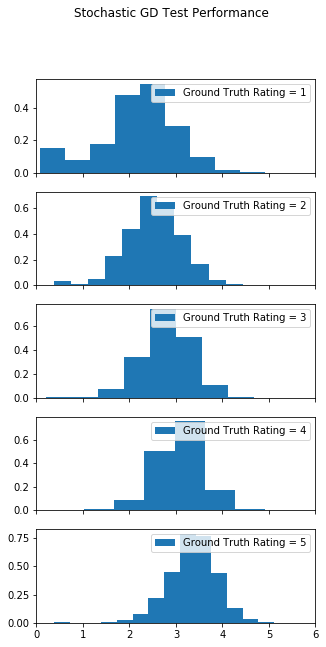

In [65]:
Rhat = np.dot(P, Q.T)
fig, axs = plt.subplots(figsize=[5, 10], nrows=5, ncols=1, sharex=True)
fig.suptitle("Stochastic GD Test Performance")
for idx, ax in enumerate(axs.ravel()):
    vals = Rhat[T == idx+1]
    ax.hist(vals, bins=20, normed=True, label="Ground Truth Rating = %i" %(idx+1))
    ax.legend()
    ax.set_xlim([0, 6])

In [41]:
users,items = R.nonzero()  
print(users,items)

[  0   0   0 ... 942 942 942] [   0    1    2 ... 1187 1227 1329]


In [45]:
P[0, :].shape

(20,)

In [50]:
Q[0, :]

array([0.75322204, 1.44330321, 1.82266452, 0.33902364, 2.61517292,
       2.78102582, 0.77609404, 1.598645  , 1.50096642, 1.87290705,
       1.87219564, 0.08995779, 0.63547328, 2.21916351, 2.84790814,
       2.26700521, 1.53279451, 0.9799713 , 2.09604997, 1.0066126 ])